In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

100


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [23]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [24]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [25]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [26]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1773544,North America,North America,NaN,5870.0,499.0,"+4,604",NaN,18382.0,NaN,3561764,176637.0,1611583.0,NaN,NaN
1,NaN,\n,NaN,NaN,795271,South America,South America,NaN,1212.0,42.0,"+93,876",NaN,13569.0,NaN,2550729,94967.0,1660491.0,NaN,NaN
2,NaN,\n,NaN,NaN,790195,Asia,Asia,NaN,6511.0,133.0,"+4,692",NaN,19406.0,NaN,2636628,63426.0,1783007.0,NaN,NaN
3,NaN,\n,NaN,NaN,857600,Europe,Europe,NaN,7007.0,222.0,"+10,575",NaN,5552.0,NaN,2499811,194211.0,1448000.0,NaN,NaN
4,NaN,\n,NaN,NaN,244450,Africa,Africa,NaN,2324.0,46.0,"+1,425",NaN,956.0,NaN,496034,11695.0,239889.0,NaN,NaN


In [27]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,857600,Europe,Total:,NaN,7007.0,222.0,"+10,575",NaN,5552.0,NaN,2499811,194211.0,1448000.0,NaN,NaN
226,NaN,,NaN,NaN,244450,Africa,Total:,NaN,2324.0,46.0,"+1,425",NaN,956.0,NaN,496034,11695.0,239889.0,NaN,NaN
227,NaN,,NaN,NaN,1224,Australia/Oceania,Total:,NaN,173.0,NaN,NaN,NaN,10.0,NaN,10406,128.0,9054.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,162595,Europe,European Union,300.606054,75.0,3.0,NaN,NaN,2208.0,67994.288716,1310539,133845.0,631461.0,30274492.0,2943.37448


In [28]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1773544,North America,North America,NaN,5870.0,499.0,"+4,604",NaN,18382.0,NaN,3561764,176637.0,1611583.0,NaN,NaN
1,NaN,\n,NaN,NaN,795271,South America,South America,NaN,1212.0,42.0,"+93,876",NaN,13569.0,NaN,2550729,94967.0,1660491.0,NaN,NaN
2,NaN,\n,NaN,NaN,790195,Asia,Asia,NaN,6511.0,133.0,"+4,692",NaN,19406.0,NaN,2636628,63426.0,1783007.0,NaN,NaN
3,NaN,\n,NaN,NaN,857600,Europe,Europe,NaN,7007.0,222.0,"+10,575",NaN,5552.0,NaN,2499811,194211.0,1448000.0,NaN,NaN
4,NaN,\n,NaN,NaN,244450,Africa,Africa,NaN,2324.0,46.0,"+1,425",NaN,956.0,NaN,496034,11695.0,239889.0,NaN,NaN


In [29]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
119,113.0,"1,478","34,447",6,215,Europe,Lithuania,29.0,0.0,0.0,0,"2,721,314",15.0,162933.0,1841,79.0,1547.0,443391.0,677.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


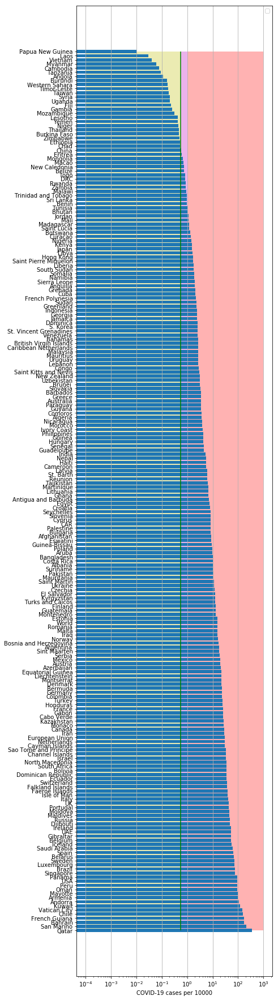

In [30]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


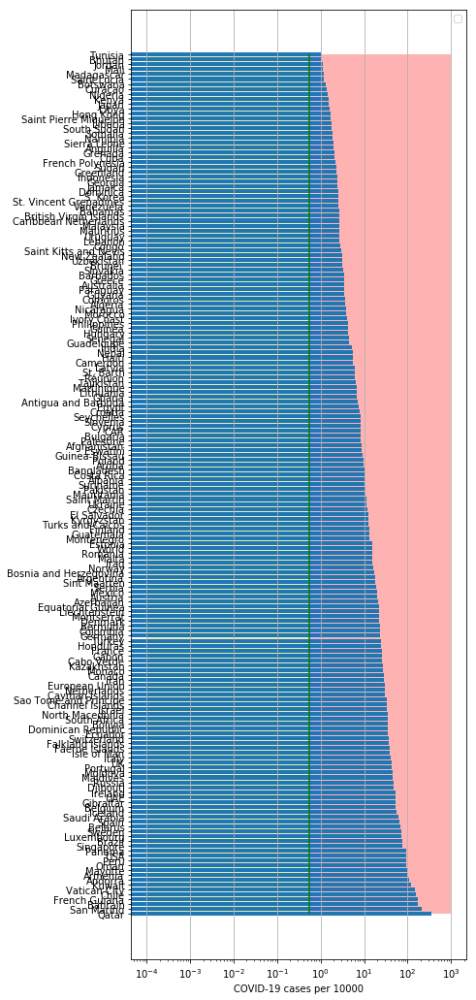

In [31]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

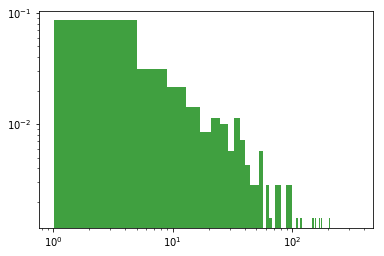

In [32]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [33]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
128 2020-07-02  297183       0  28368.0
129 2020-07-03  297625       0  28385.0
130 2020-07-04  297625       0  28385.0
131 2020-07-05  297625       0  28385.0
132 2020-07-06  298869       0  28388.0
GB
           date   cases  active    death
127 2020-07-02  283757       0  43995.0
128 2020-07-03  284276       0  44131.0
129 2020-07-04  284900       0  44198.0
130 2020-07-05  285416       0  44220.0
131 2020-07-06  285768       0  44236.0
IT
           date   cases  active    death
130 2020-07-02  240961   15060  34818.0
131 2020-07-03  241184   14884  34833.0
132 2020-07-04  241419   14621  34854.0
133 2020-07-05  241611   14642  34861.0
134 2020-07-06  241819   14709  34869.0
LT
           date   cases  active  death     tests
115 2020-07-02  1828.0     199   78.0  436679.0
116 2020-07-03  1831.0     196   79.0  439451.0
117 2020-07-04  1836.0     201   79.0  442242.0
118 2020-07-05  1841.0     215   79.0       NaN
119 2020-07-06  1841.0  

TH
           date   cases  active  death
126 2020-07-02  3180.0    56.0   58.0
127 2020-07-03  3185.0    61.0   58.0
128 2020-07-04  3190.0    61.0   58.0
129 2020-07-05  3195.0    65.0   58.0
130 2020-07-06  3195.0    65.0   58.0
IE
           date  cases   active   death
115 2020-07-02  59394  29740.0  2987.0
116 2020-07-03  60695  30091.0  3036.0
117 2020-07-04  62142  30834.0  3089.0
118 2020-07-05  64958  31798.0  3241.0
119 2020-07-06  64958  31798.0  3241.0
MX
           date   cases   active    death
116 2020-07-02  238511  66729.0  29189.0
117 2020-07-03  245251  68203.0  29843.0
118 2020-07-04  252165  69490.0  30366.0
119 2020-07-05  256848  70605.0  30639.0
120 2020-07-06  261750  70974.0  31119.0
PM
           date  cases   active  death
114 2020-07-02  35237  18125.0  667.0
115 2020-07-03  35995  18352.0  698.0
116 2020-07-04  36983  18502.0  720.0
117 2020-07-05  38149  19416.0  747.0
118 2020-07-06  39334  20528.0  770.0
PU
           date   cases   active    death
117

In [34]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [35]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5585818298557406
intercept: -0.4837015826061877
slope: [0.04864374]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


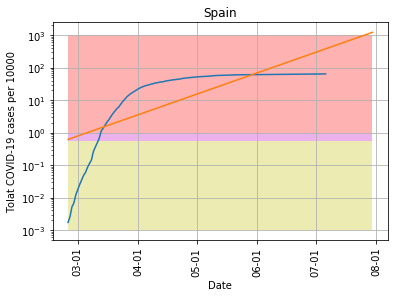

In [36]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-07-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [37]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6967566605940994
intercept: -2.1594022308605867
slope: [0.06010054]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


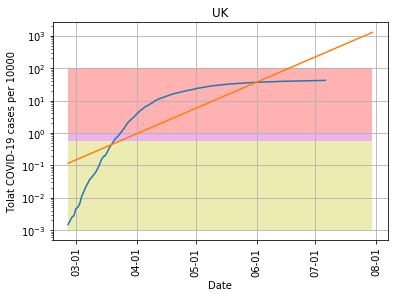

In [38]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-07-30', "pictures/coronaGB.png", model1, 'UK',100)

In [39]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9507333471633671
intercept: 1.4224244501588375
slope: [-0.0379627]


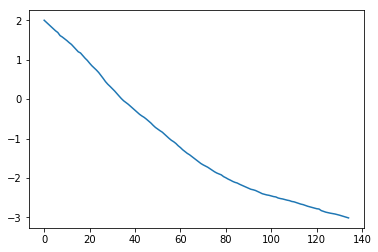

In [40]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


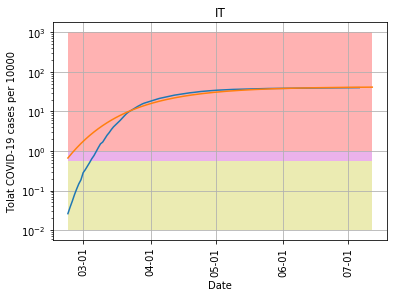

In [41]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [42]:
cs=y_pred11[-1]/10000.*populationIT

In [43]:
cs

248863.58783478063

In [44]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.4911362610036476
intercept: -0.8175532052368797
slope: [0.03166609]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


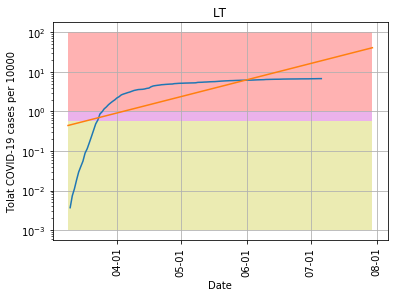

In [45]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-07-30', "pictures/coronaLT.png", model1, 'LT',100)

In [46]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.745453921178705
intercept: -3.911122775399455
slope: [0.06675226]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


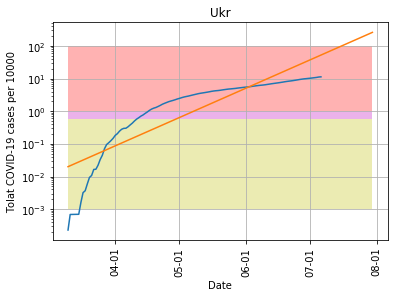

In [47]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-07-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


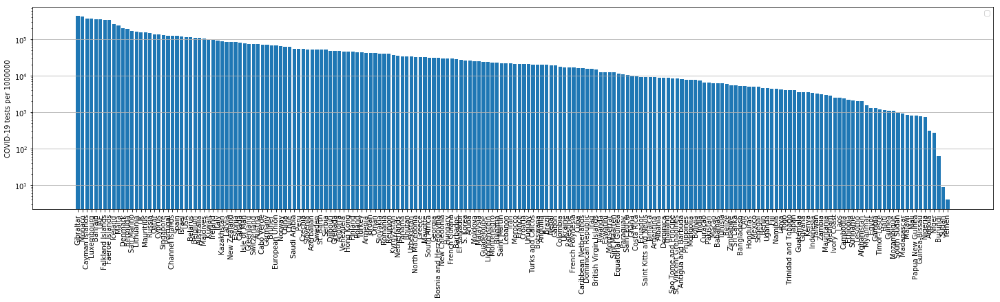

In [48]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [49]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6796241866753565
intercept: -1.537182105433375
slope: [0.06110174]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


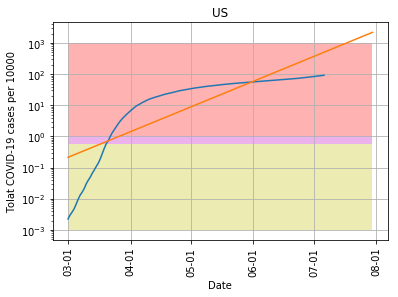

In [50]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-07-30', "pictures/coronaUS.png", model11, 'US',1000)

In [51]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country        0
229  European Union  0.10213


(0, 0.15)

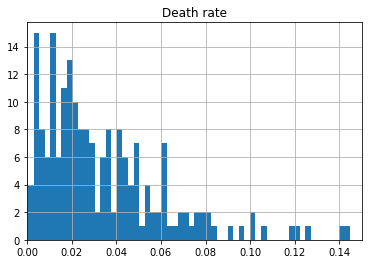

In [52]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

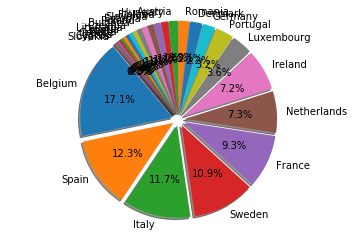

In [53]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [54]:
dfTTh.head()

,Country,Deathsper1Mpop
35,Belgium,843.0
12,Spain,607.0
17,Italy,577.0
30,Sweden,538.0
23,France,458.0


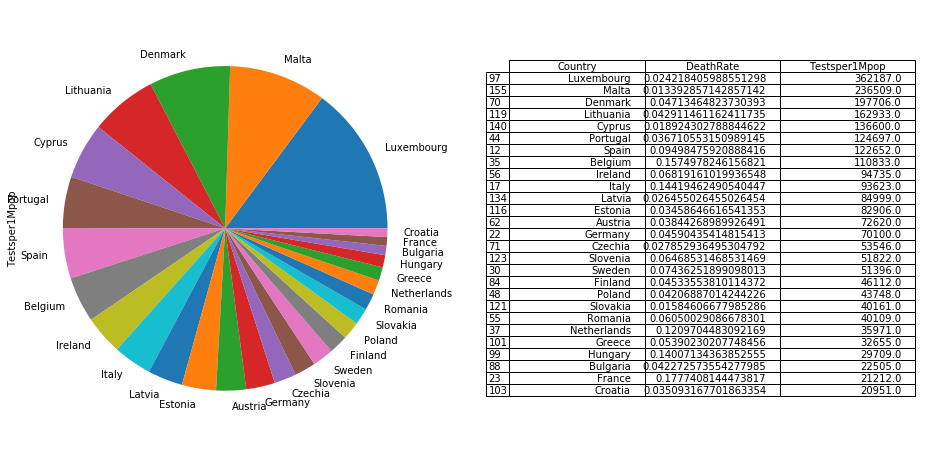

In [55]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

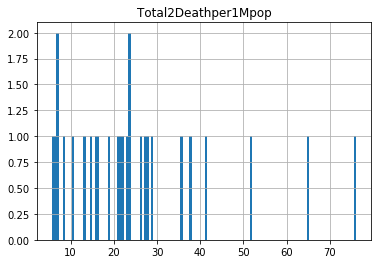

In [56]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [57]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
12,Spain,6392.0,607.0
17,Italy,4000.0,577.0
22,Germany,2364.0,109.0
23,France,2579.0,458.0
30,Sweden,7234.0,538.0


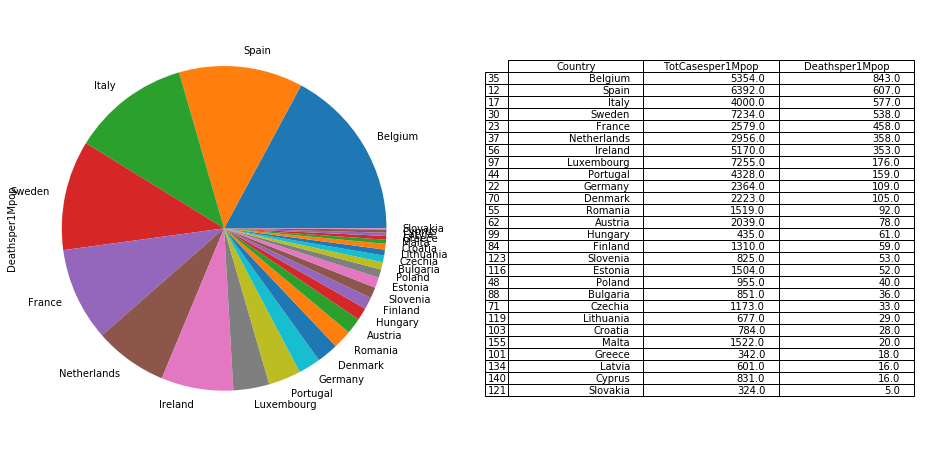

In [58]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [59]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1773544,North America,North America,0.0,5870.0,499.0,"+4,604",0,18382.0,0.0,3561764,176637.0,1611583.0,0.0,0.0
1,0.0,\n,0,0,795271,South America,South America,0.0,1212.0,42.0,"+93,876",0,13569.0,0.0,2550729,94967.0,1660491.0,0.0,0.0
2,0.0,\n,0,0,790195,Asia,Asia,0.0,6511.0,133.0,"+4,692",0,19406.0,0.0,2636628,63426.0,1783007.0,0.0,0.0
3,0.0,\n,0,0,857600,Europe,Europe,0.0,7007.0,222.0,"+10,575",0,5552.0,0.0,2499811,194211.0,1448000.0,0.0,0.0
4,0.0,\n,0,0,244450,Africa,Africa,0.0,2324.0,46.0,"+1,425",0,956.0,0.0,496034,11695.0,239889.0,0.0,0.0


In [60]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
12,Spain,0.052115
17,Italy,0.042725
22,Germany,0.033723
23,France,0.121582
30,Sweden,0.140750


In [61]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.140750
      France             0.121582
 Netherlands             0.082177
     Ireland             0.054573
       Spain             0.052115
     Belgium             0.048307
       Italy             0.042725
     Romania             0.037872
    Bulgaria             0.037814
     Croatia             0.037421
    Portugal             0.034708
     Germany             0.033723
     Finland             0.028409
     Austria             0.028078
     Czechia             0.021906
      Poland             0.021830
  Luxembourg             0.020031
     Estonia             0.018141
    Slovenia             0.015920
     Hungary             0.014642
     Denmark             0.011244
      Greece             0.010473
    Slovakia             0.008068
      Latvia             0.007071
       Malta             0.006435
      Cyprus             0.006083
   Lithuania             0.004155


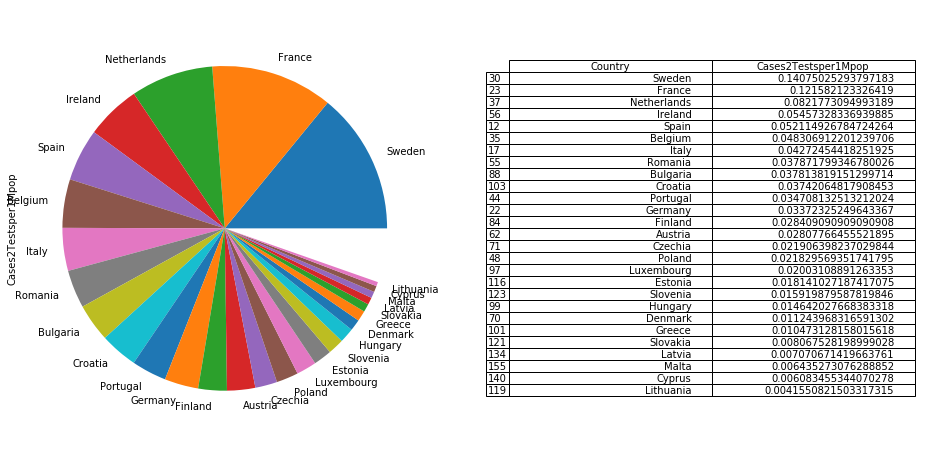

In [62]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [63]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
43,Singapore,0.000576,129506.000000
27,Qatar,0.001325,137513.000000
66,Nepal,0.002192,19472.000000
136,Rwanda,0.002695,12612.000000
168,Botswana,0.003185,20348.000000
52,Bahrain,0.003286,359711.000000
73,Uzbekistan,0.003538,33495.000000
158,Réunion,0.003636,39556.000000
98,Palestine,0.003916,16585.000000
94,French Guiana,0.003957,29147.000000


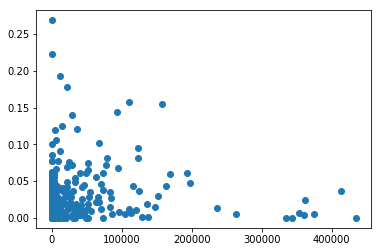

In [64]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


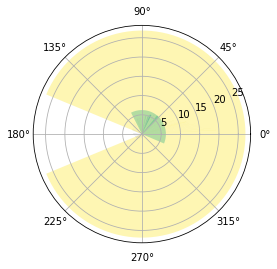

In [65]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

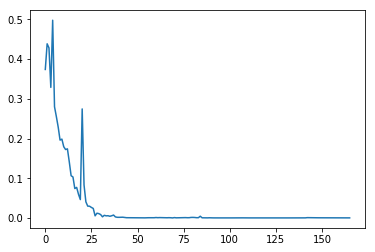

In [66]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [67]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


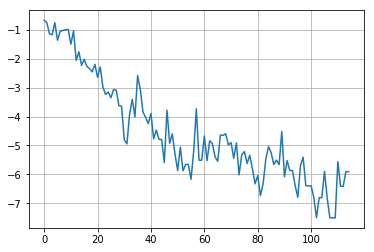

In [68]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

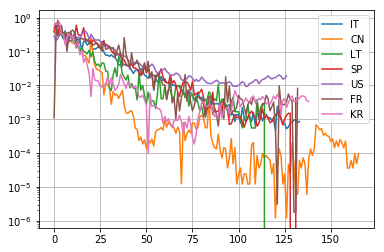

In [69]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

127 127
coefficient of determination: 0.7629729794019121
intercept: -10.565366113562142
slope: [-0.08809381]


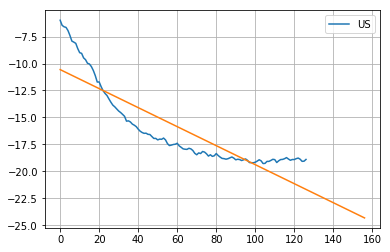

In [70]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [71]:
#np.diff(dfIT["cases"])

134 134
coefficient of determination: 0.8723277589709957
intercept: -10.613576674952673
slope: [-0.08149116]


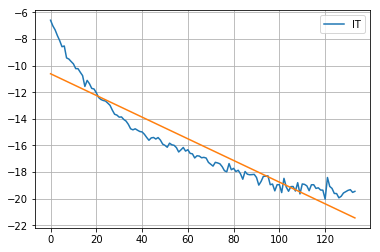

In [72]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [73]:
#model11.coef_

In [74]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

116 116
coefficient of determination: 0.8748029693114884
intercept: -15.593337629982646
slope: [-0.04928052]


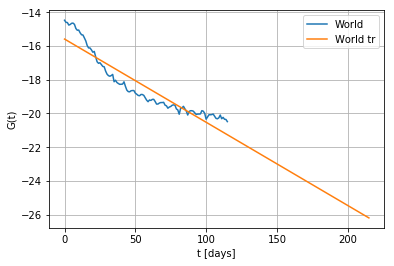

In [75]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

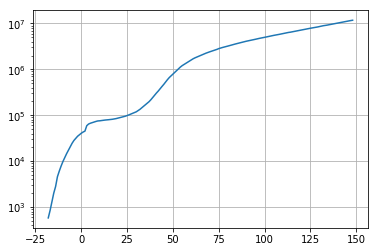

In [76]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [77]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 2.68282840e+07  9.94402715e-01 -1.67212731e+02  1.40168931e-02]


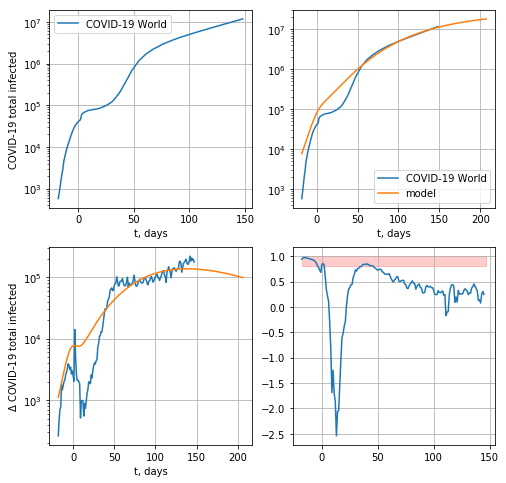

205840.3821888577


In [78]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

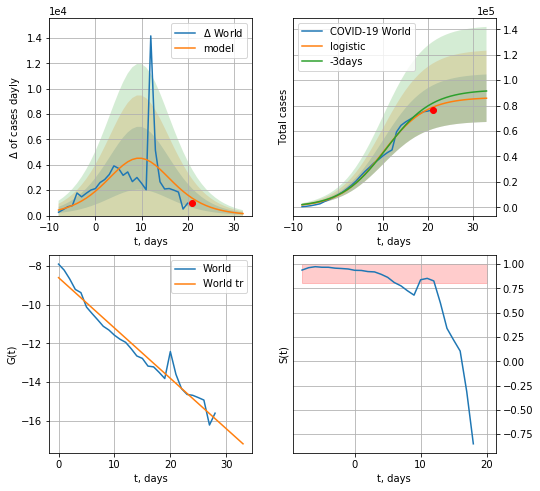

World data at: 2020-07-06
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +12 days
	 deltaDaycases:  159
	 total cases:  85784 ± 18684
	 total death:  3948 ± 2579
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


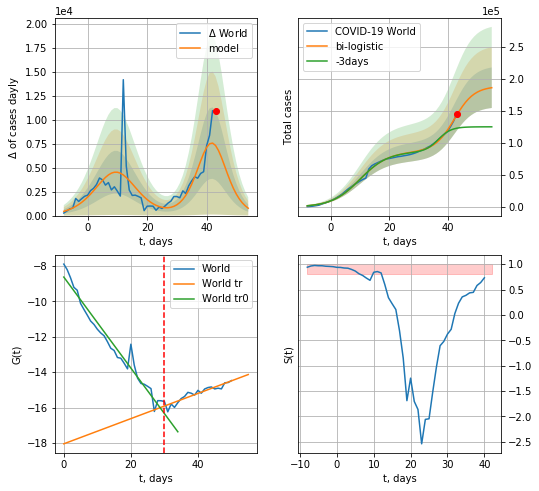

World data at: 2020-07-06
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +12 days
	 deltaDaycases:  767
	 total cases:  186398 ± 31674
	 total death:  8579 ± 4373
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


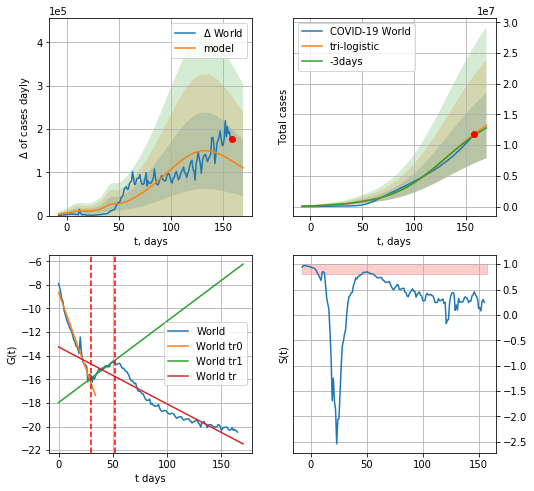

World data at: 2020-07-06
+3 day model MAPE: 0.02210699973849834
model: tri-logistic
coeffs:  [1.45798243e+07 3.82180726e-02 1.29662471e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.40419972798821036
forecast at the end of period: +12 days
	 deltaDaycases:  109870
	 total cases:  13224851 ± 5345481
	 total death:  608679 ± 738083
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.870694
 intercept: -13.258093
 slope: -0.048268


In [79]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*16-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

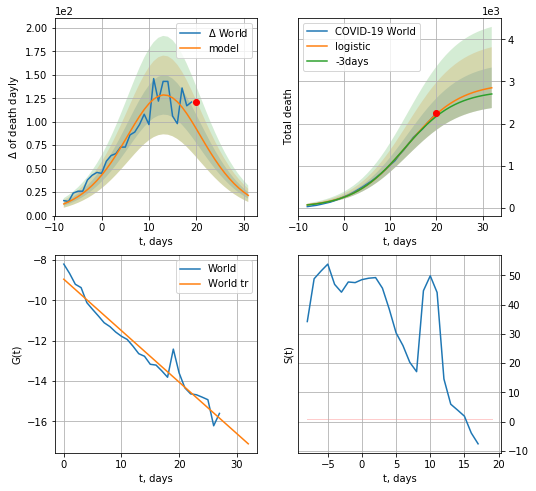

World data at: 2020-07-06
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +12 days
	 total death:  2850 ± 482
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


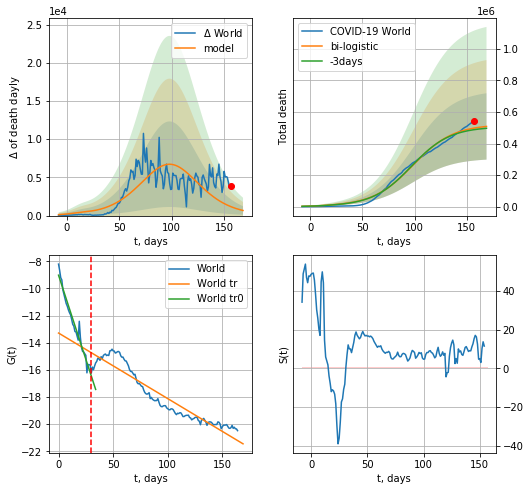

World data at: 2020-07-06
+3 day model MAPE: 0.020760912328793523
model: bi-logistic
coeffs:  [5.18227577e+05 5.19121313e-02 9.83547816e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.41375136172721755
forecast at the end of period: +12 days
	 deltaDaydeath:  669
	 total death:  508289 ± 210305
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.897555
 intercept: -13.289602
 slope: -0.048306


In [80]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [81]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


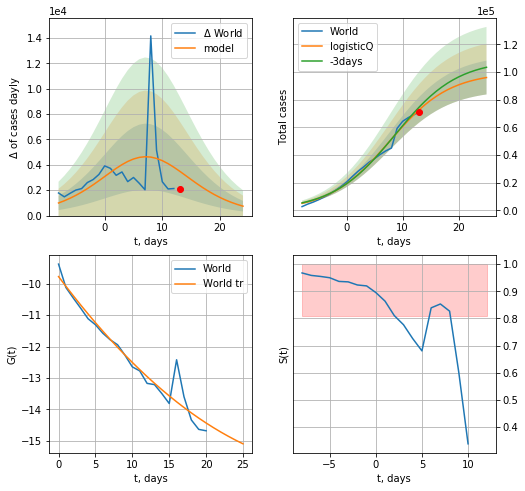

World data at: 2020-07-06
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +12 days
	 deltaDaycases: 742
	 total cases: 96071 ± 12197
	 total death: 4421 ± 1683
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


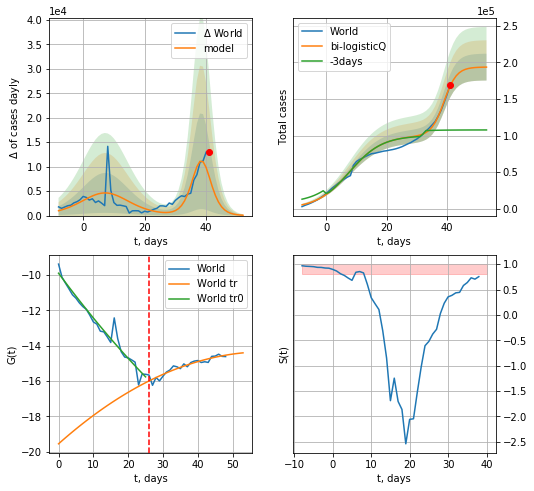

World data at: 2020-07-06
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +12 days
	 deltaDaycases: 73
	 total cases: 193488 ± 18323
	 total death: 8905 ± 2529
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


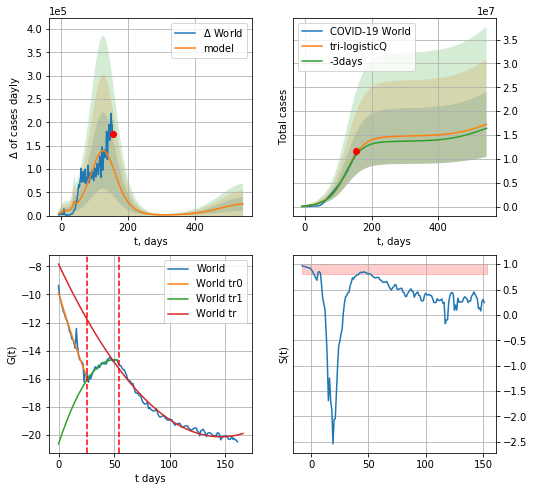

World data at: 2020-07-06
+3 day model MAPE: 0.028937
model: tri-logisticQ
coeffs: [ 1.45575912e+07  2.00431780e-07  1.25616469e+02 -1.90838194e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.394800
forecast at the end of period: +390 days
	 deltaDaycases: 24772
	 total cases: 17242063 ± 6807162
	 total death: 793573 ± 939907
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.979608
 intercept_: -7.842394817673357
 coeffs_: [ 0.         -0.16816917  0.00057582]


In [82]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


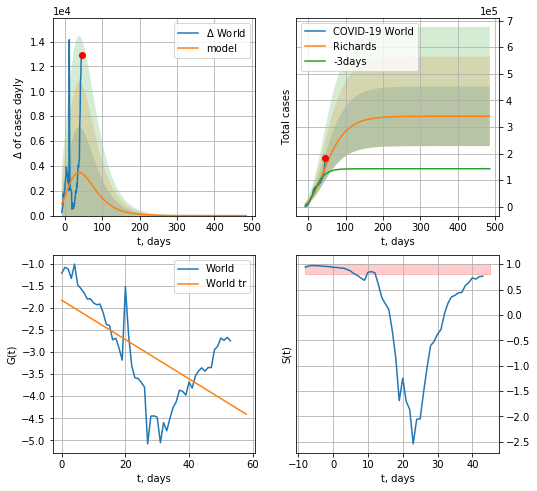

World data at: 2020-07-06
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +440 days
	 deltaDaycases: 0
	 total cases: 340076 ± 111979
	 total death: 15652 ± 15461
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


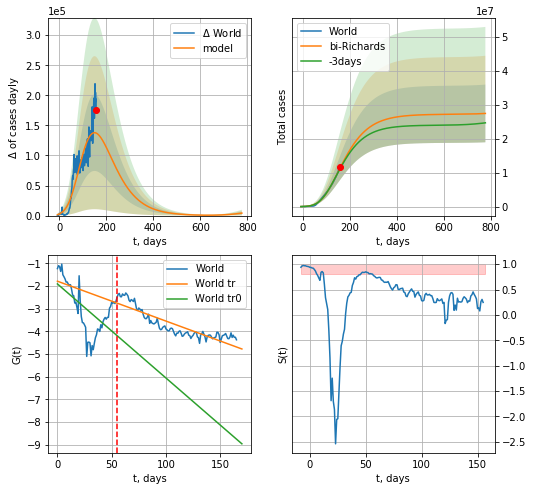

World data at: 2020-07-06
+3 day model MAPE: 0.018603
model: bi-Richards
coeffs: [ 2.69065070e+07  1.36128784e+00 -1.77395909e+02  1.02527164e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.309578
forecast at the end of period: +620 days
	 deltaDaycases: 4109
	 total cases: 27470824 ± 8504351
	 total death: 1264355 ± 1174247
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.356840
 intercept: -1.905439
 slope: -0.041494
trend coefficient of determination: 0.780246
 intercept: -1.784923
 slope: -0.017589


In [83]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

167


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


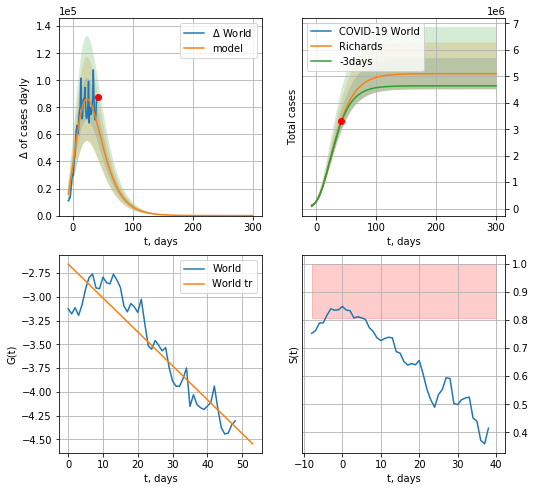

World data at: 2020-07-06
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +260 days
	 deltaDaycases: 0
	 total cases: 5102531 ± 589488
	 total death: 234846 ± 81394
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


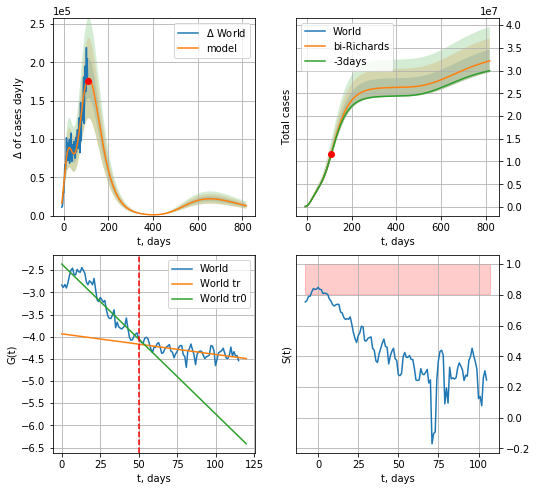

World data at: 2020-07-06
+3 day model MAPE: 0.007242
model: bi-Richards
coeffs: [ 2.12163329e+07  1.10074902e+00 -5.53299021e+01  2.06937214e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.077688
forecast at the end of period: +710 days
	 deltaDaycases: 12763
	 total cases: 32116432 ± 2495053
	 total death: 1478171 ± 344507
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.844595
 intercept: -2.362596
 slope: -0.033777
trend coefficient of determination: 0.371342
 intercept: -3.935503
 slope: -0.004644


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


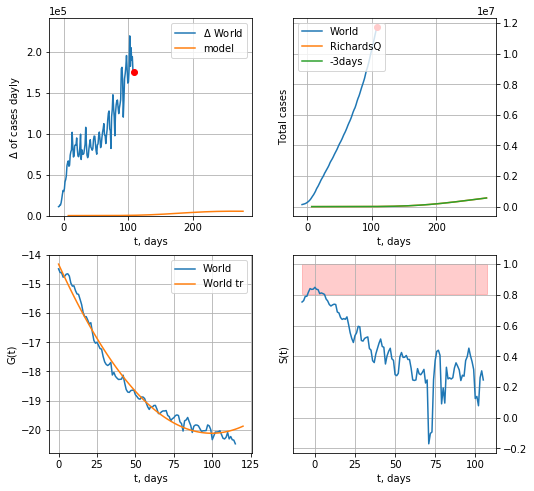

World data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.29689889e+06  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +170 days
	 deltaDaycases: 5292


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [84]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,90*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


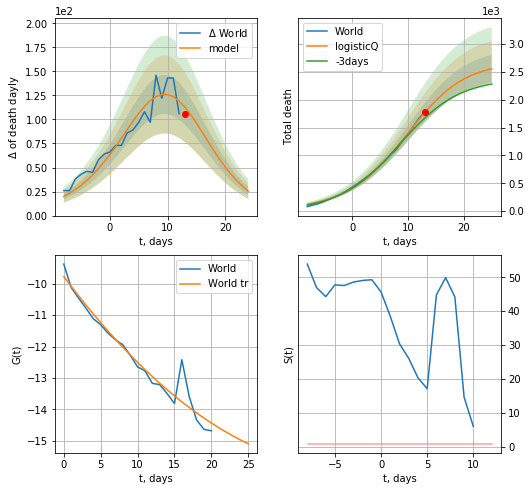

World data at: 2020-07-06
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +12 days
	 total death: 2557 ± 250
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


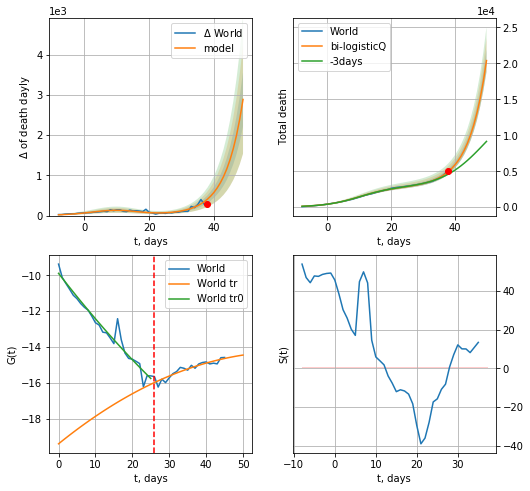

World data at: 2020-07-06
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +12 days
	 total death: 20395 ± 1562
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


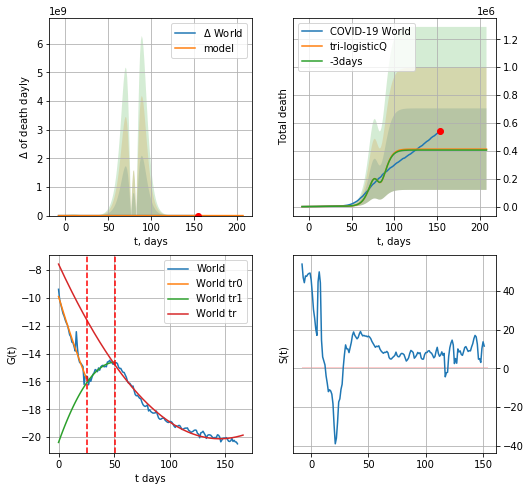

World data at: 2020-07-06
+3 day model MAPE: 0.016672
model: tri-logisticQ
coeffs: [-6.01250095e+06  1.24197603e-03 -1.13088778e+02  7.95188165e+01]
rational stdev: 0.708773
forecast at the end of period: +54 days
	 total death: 412210 ± 292163
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.981923
 intercept_: -7.56319520681193
 coeffs_: [ 0.         -0.17316716  0.00059704]


In [85]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


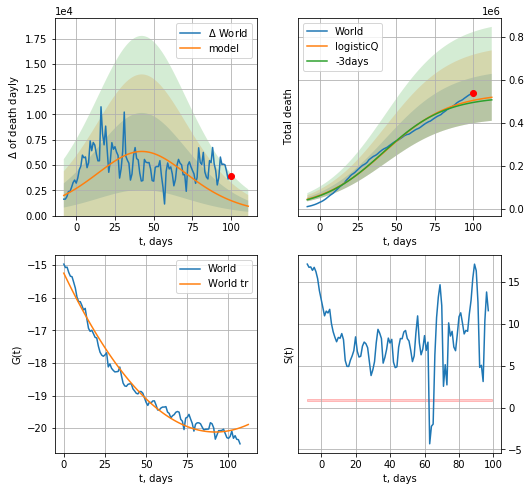

World data at: 2020-07-06
+3 day model MAPE: 0.019581
model: logisticQ
coeffs: [ 5.39375507e+05  2.71211261e-07  4.27731053e+01 -1.73429562e+05]
rational stdev: 0.210053
forecast at the end of period: +12 days
	 total death: 519401 ± 109101
trend coefficient of determination: 0.979609
 intercept_: -15.243821775186222
 coeffs_: [ 0.         -0.10601335  0.00057613]


In [86]:
x = forecastRRR("World",dfW[58:],d1,7*16-dT,1.0,False,cases='death')

In [87]:
#trend(dfSP,'SP',10)

In [88]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
128 2020-07-02  297183       0  28368.0
129 2020-07-03  297625       0  28385.0
130 2020-07-04  298039       0  28385.0
131 2020-07-05  298453       0  28385.0
132 2020-07-06  298869       0  28388.0


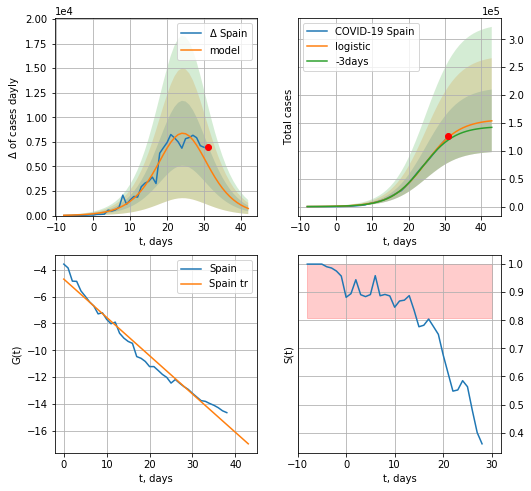

Spain data at: 2020-07-06
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +12 days
	 deltaDaycases:  721
	 total cases:  153856 ± 56140
	 total death:  14614 ± 15997
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


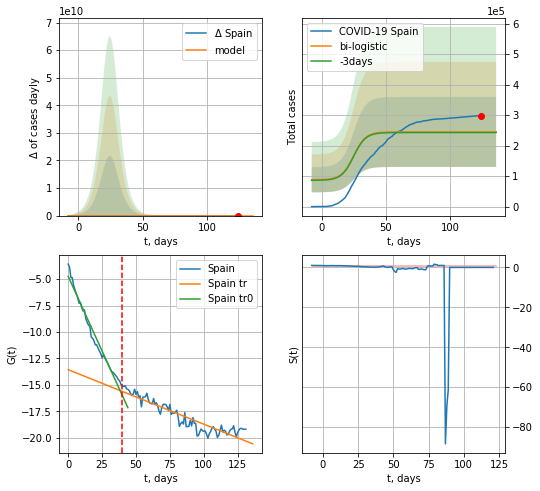

Spain data at: 2020-07-06
+3 day model MAPE: 0.008431911073877444
model: bi-logistic
coeffs:  [ 7.04676894e+04 -6.17268719e+00  1.60166851e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.46872425046019395
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  245042 ± 114857
	 total death:  23275 ± 32728
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.851312
 intercept: -13.556069
 slope: -0.051538


In [90]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*16-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

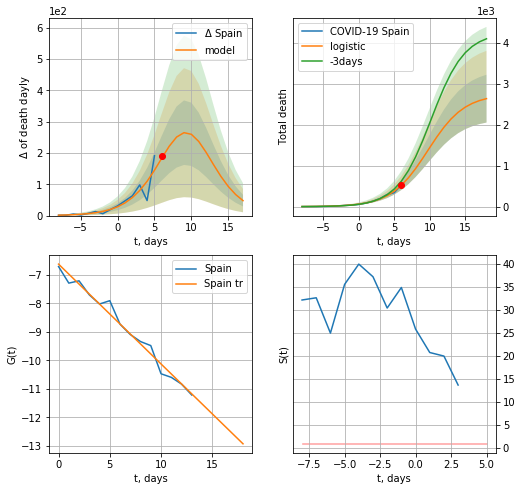

Spain data at: 2020-07-06
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +12 days
	 total death:  2638 ± 584
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


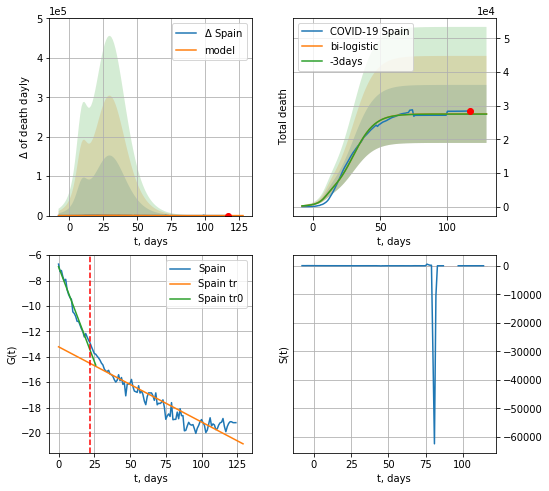

Spain data at: 2020-07-06
+3 day model MAPE: 0.0017648116653253085
model: bi-logistic
coeffs:  [2.47865195e+04 1.24719993e-01 3.00937531e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3129373188100772
forecast at the end of period: +12 days
	 deltaDaydeath:  0
	 total death:  27531 ± 8615
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.877140
 intercept: -13.213511
 slope: -0.059199


In [92]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*16-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


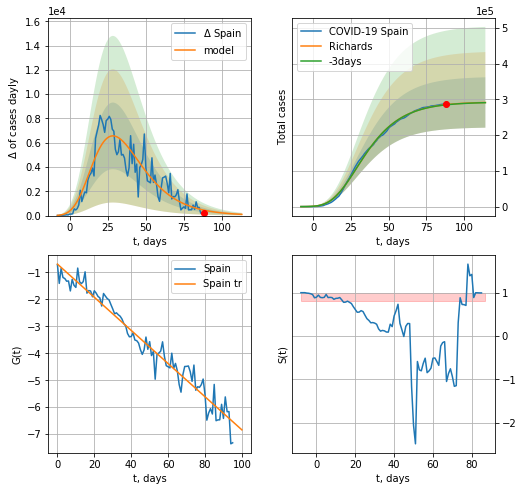

Spain data at: 2020-07-06
+3 day model MAPE: 0.001576
model: Richards
coeffs: [ 2.92623031e+05  8.19006343e+00 -5.10999338e+01  7.47571626e-03]
rational stdev: 0.241957
forecast at the end of period: +26 days
	 deltaDaycases: 100
	 total cases: 291033 ± 70417
	 total death: 27643 ± 20065
trend coefficient of determination: 0.955401
 intercept: -0.697601
 slope: -0.061420


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


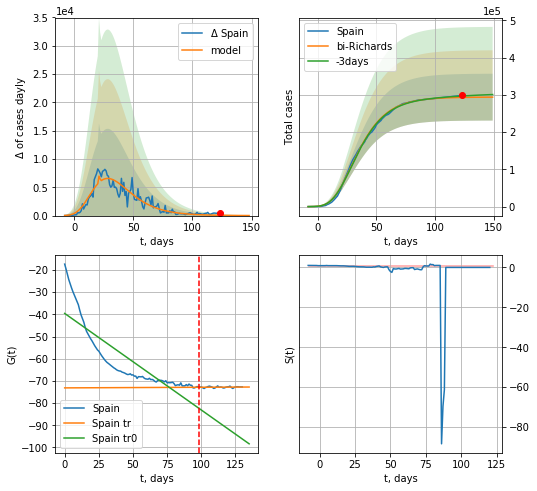

Spain data at: 2020-07-06
+3 day model MAPE: 0.013342
model: bi-Richards
coeffs: [1573.99939959   11.89611629   22.02412192    5.24616755]
rational stdev: 0.213870
forecast at the end of period: +26 days
	 deltaDaycases: 11
	 total cases: 294010 ± 62879
	 total death: 27926 ± 17917
bi-Richards approximation splitting point: 98
trend coefficient of determination: 0.735064
 intercept: -39.582605
 slope: -0.435306
trend coefficient of determination: 0.008977
 intercept: -73.143864
 slope: 0.002846


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp


In [93]:
vL = 98+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*18-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


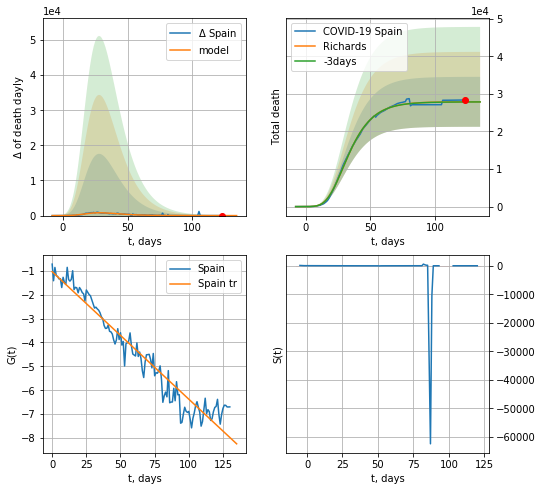

Spain data at: 2020-07-06
+3 day model MAPE: 0.001153
model: Richards
coeffs: [ 2.79091670e+04  8.44284044e+00 -3.04809190e+01  9.35917392e-03]
rational stdev: 0.238265
forecast at the end of period: +12 days
	 total death: 27902 ± 6648
trend coefficient of determination: 0.938034
 intercept: -1.040094
 slope: -0.053333


In [95]:
x = forecastRR('Spain',dfSP[1:],d1,7*16-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


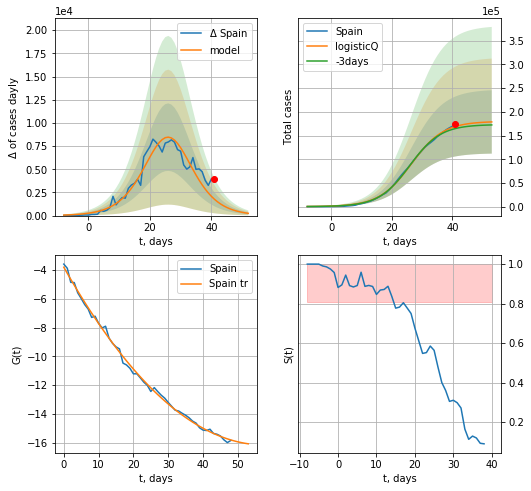

Spain data at: 2020-07-06
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +12 days
	 deltaDaycases: 244
	 total cases: 178754 ± 66840
	 total death: 16978 ± 19045
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


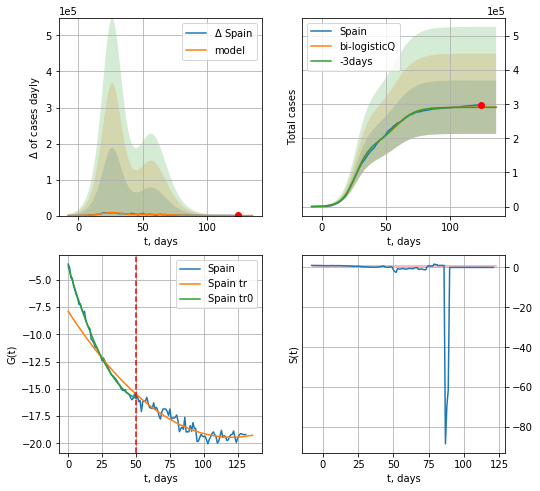

Spain data at: 2020-07-06
+3 day model MAPE: 0.002142
model: bi-logisticQ
coeffs: [ 1.11617243e+05  4.07874091e-07  5.74063406e+01 -3.08916049e+05]
rational stdev: 0.268985
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 291555 ± 78424
	 total death: 27693 ± 22346
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.891007
 intercept_: -7.9037766073219835
 coeffs_: [ 0.         -0.19114003  0.00079258]


In [97]:
x = forecastRRR('Spain',dfSP[:50],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*16-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


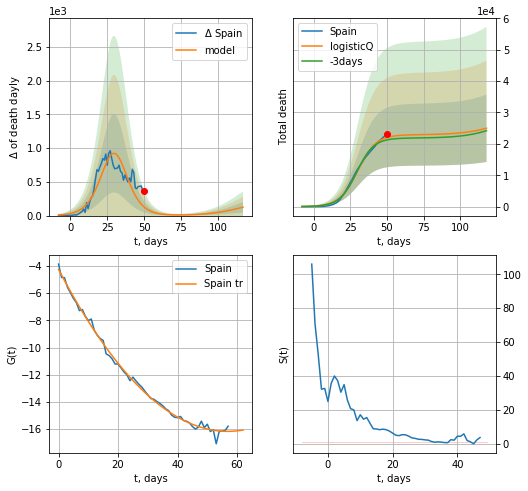

Spain data at: 2020-07-06
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +68 days
	 total death: 24976 ± 10760
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


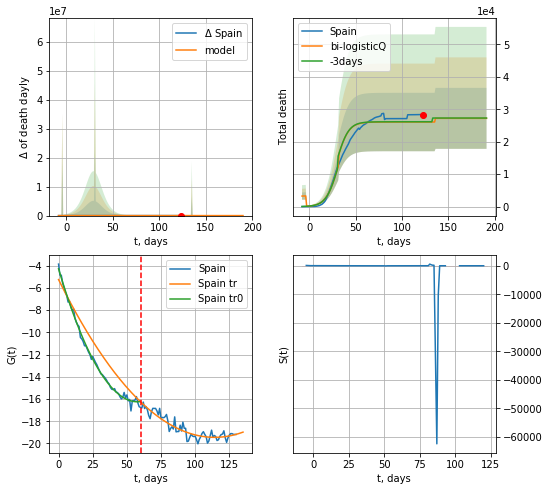

Spain data at: 2020-07-06
+3 day model MAPE: 0.002778
model: bi-logisticQ
coeffs: [3197.9514383    10.37083565   31.08314015   -3.90242804]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.345324
forecast at the end of period: +68 days
	 total death: 27210 ± 9396
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.853304
 intercept_: -5.262410004570301
 coeffs_: [ 0.         -0.24836517  0.00108714]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [98]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


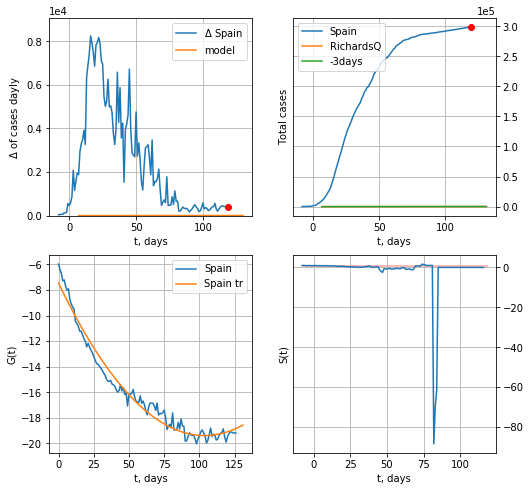

Spain data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.79976480e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +12 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [99]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

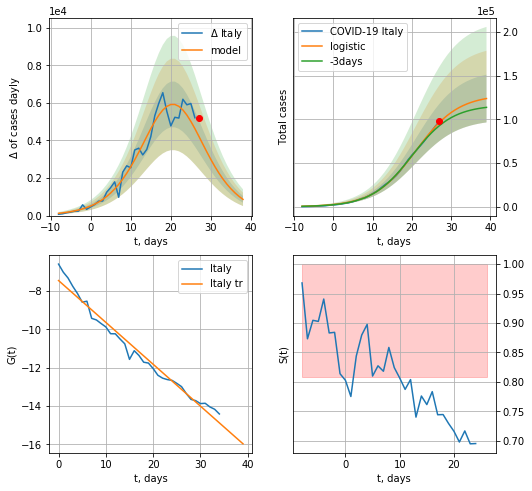

Italy data at: 2020-07-06
+3 day model MAPE: 0.045578378390248614
model: logistic
coeffs:  [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.22065596678975638
forecast at the end of period: +12 days
	 deltaDaycases:  863
	 total cases:  123711 ± 27297
	 total death:  17838 ± 11808
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


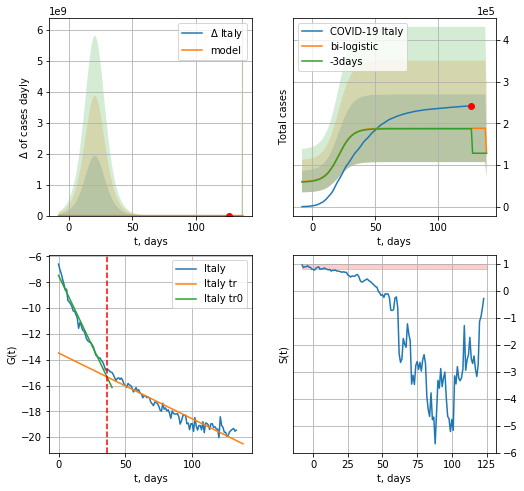

Italy data at: 2020-07-06
+3 day model MAPE: 0.4668194249680219
model: bi-logistic
coeffs:  [ 5.98181422e+04 -1.20656763e+01  1.37619896e+02] [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.43106418460698737
forecast at the end of period: +12 days
	 deltaDaycases:  -59180
	 total cases:  128742 ± 55496
	 total death:  18563 ± 24005
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.925533
 intercept: -13.476725
 slope: -0.050972


In [100]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,16*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,16*7-dT,x,1.0,vL=vL)

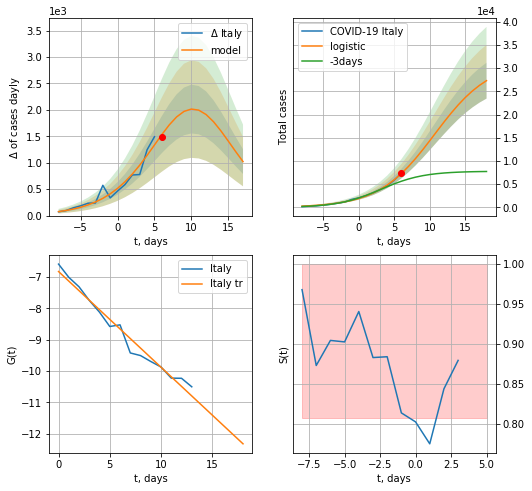

Italy data at: 2020-07-06
+3 day model MAPE: 0.44264442257961345
model: logistic
coeffs:  [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.14147817336323687
forecast at the end of period: +12 days
	 deltaDaycases:  1021
	 total cases:  27311 ± 3863
	 total death:  3938 ± 1671
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


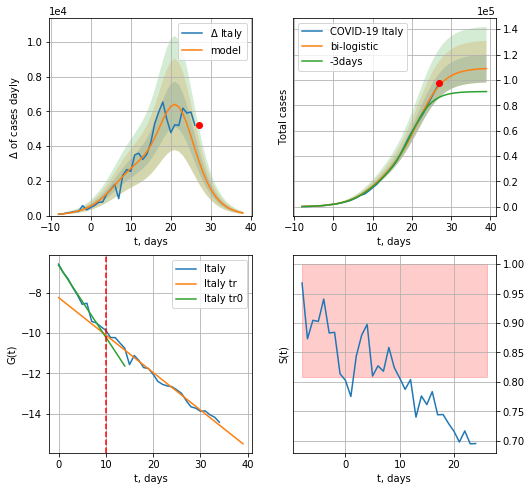

Italy data at: 2020-07-06
+3 day model MAPE: 0.1273932560599292
model: bi-logistic
coeffs:  [7.78644605e+04 3.07215535e-01 2.18188307e+01] [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.10049358500066935
forecast at the end of period: +12 days
	 deltaDaycases:  147
	 total cases:  108945 ± 10948
	 total death:  15709 ± 4735
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


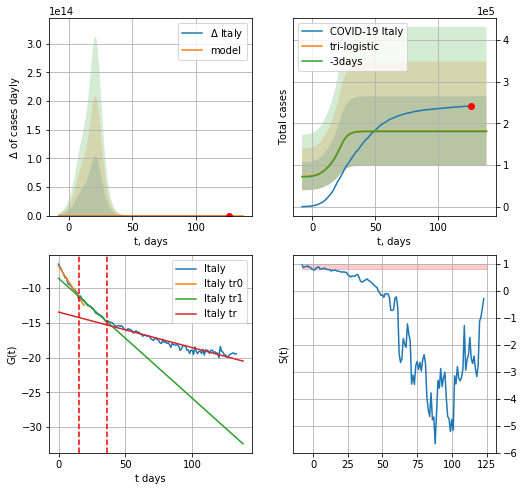

Italy data at: 2020-07-06
+3 day model MAPE: 0.007517992162460077
model: tri-logistic
coeffs:  [ 7.25334506e+04 -5.73506592e+00  1.09461289e+03] [3.14978181e+04 2.56455869e-01 1.06869163e+01 7.78644605e+04
 3.07215535e-01 2.18188307e+01]
forecast rational stdev:  0.45755657153089513
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  181895 ± 83227
	 total death:  26228 ± 36002
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.925533
 intercept: -13.476725
 slope: -0.050972


In [101]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

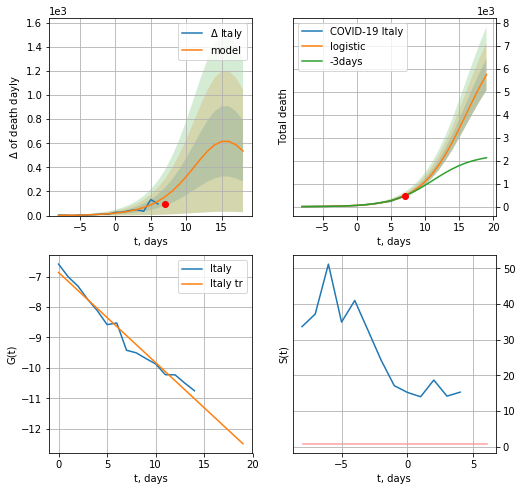

Italy data at: 2020-07-06
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +12 days
	 total death:  5746 ± 690
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


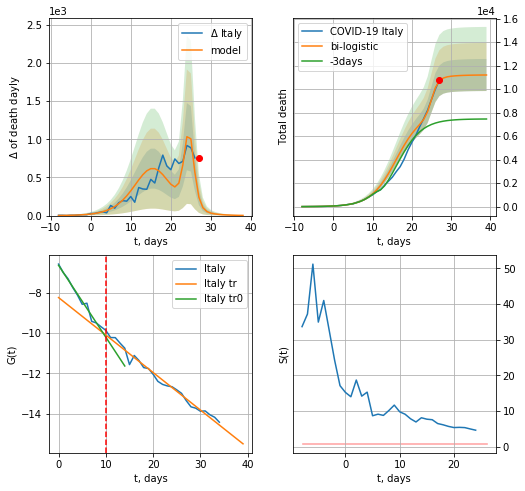

Italy data at: 2020-07-06
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +12 days
	 deltaDaydeath:  2
	 total death:  11204 ± 1364
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


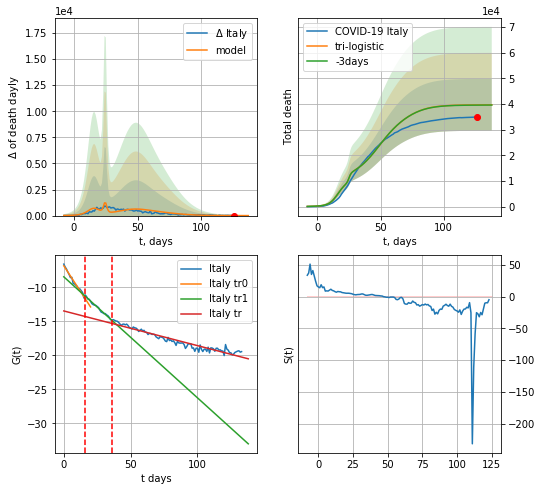

Italy data at: 2020-07-06
+3 day model MAPE: 0.002241381279252229
model: tri-logistic
coeffs:  [2.27642146e+04 1.02670726e-01 4.78633552e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.2551870560022796
forecast at the end of period: +12 days
	 deltaDaydeath:  0
	 total death:  39658 ± 10120
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.925533
 intercept: -13.476725
 slope: -0.050972


In [102]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


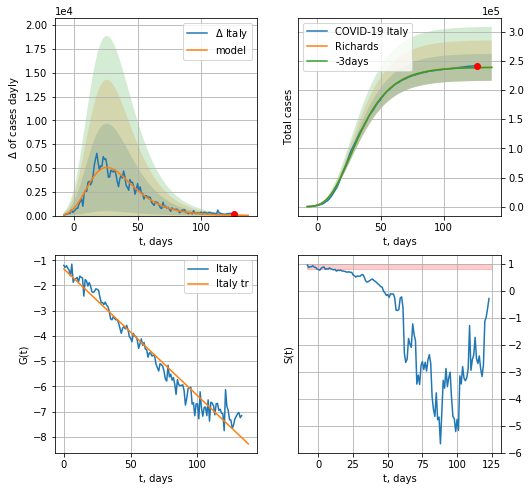

Italy data at: 2020-07-06
+3 day model MAPE: 0.001051
model: Richards
coeffs: [ 2.39276573e+05  6.79187297e+00 -5.63071200e+01  8.49915752e-03]
rational stdev: 0.096649
forecast at the end of period: +12 days
	 deltaDaycases: 22
	 total cases: 238898 ± 23089
	 total death: 34447 ± 9987
trend coefficient of determination: 0.967183
 intercept: -1.339493
 slope: -0.050310


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


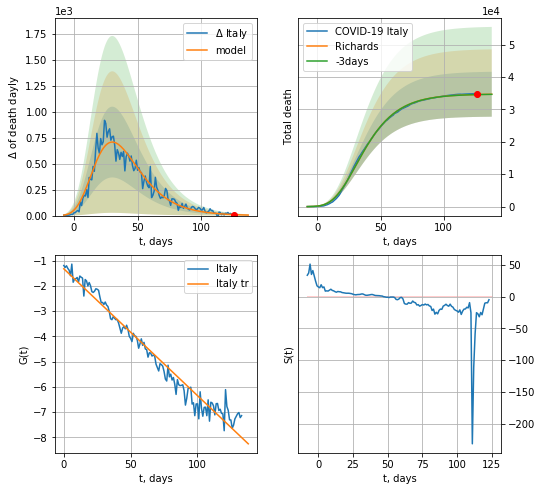

Italy data at: 2020-07-06
+3 day model MAPE: 0.000746
model: Richards
coeffs: [ 3.47565484e+04  8.14063682e+00 -5.89611281e+01  6.83784329e-03]
rational stdev: 0.199795
forecast at the end of period: +12 days
	 total death: 34668 ± 6926
trend coefficient of determination: 0.967218
 intercept: -1.323953
 slope: -0.050258


In [103]:
vL=95
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Italy',dfIT[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


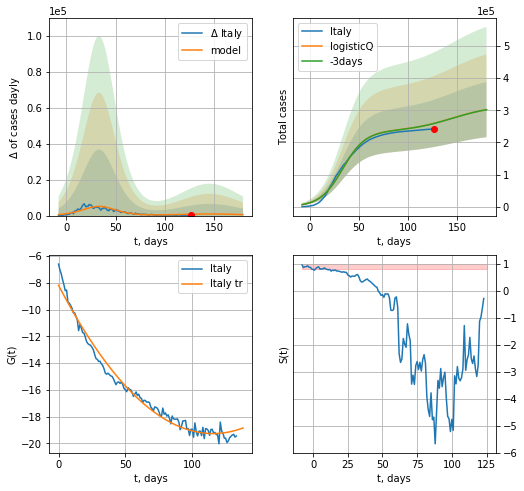

Italy data at: 2020-07-06
+3 day model MAPE: 0.001326
model: logisticQ
coeffs: [ 2.34297614e+05  2.50758062e-07  3.33805503e+01 -3.46805025e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.283980
forecast at the end of period: +54 days
	 deltaDaycases: 545
	 total cases: 302262 ± 85836
	 total death: 43584 ± 37130
trend coefficient of determination: 0.980995
 intercept_: -8.181281160786611
 coeffs_: [ 0.         -0.19205198  0.00083129]


In [104]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


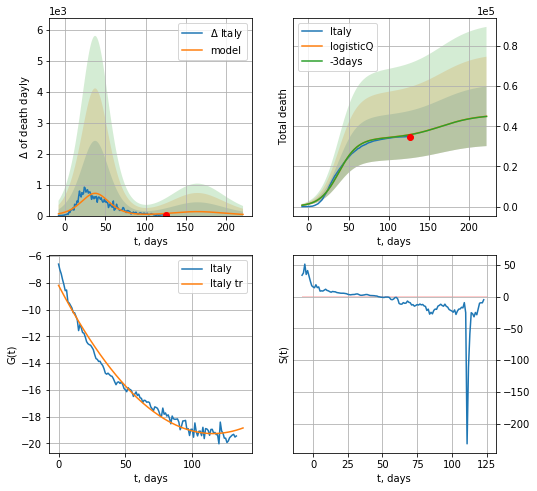

Italy data at: 2020-07-06
+3 day model MAPE: 0.001778
model: logisticQ
coeffs: [ 3.39111215e+04  2.35467827e-07  3.78303781e+01 -3.59832766e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329939
forecast at the end of period: +96 days
	 total death: 44953 ± 14832
trend coefficient of determination: 0.980995
 intercept_: -8.181281160786611
 coeffs_: [ 0.         -0.19205198  0.00083129]


In [105]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [106]:
dT

100

FR
           date     cases  active    death
138 2020-07-02  166378.0   59701  29875.0
139 2020-07-03  166960.0   60007  29893.0
140 2020-07-04  166960.3   60007  29893.0
141 2020-07-05  166960.6   60007  29893.0
142 2020-07-06  168335.0   61107  29920.0


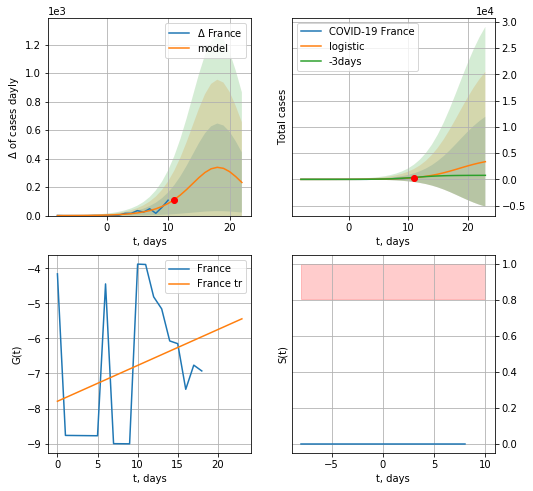

France data at: 2020-07-06
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +12 days
	 deltaDaycases:  232
	 total cases:  3370 ± 8558
	 total death:  599 ± 4562
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


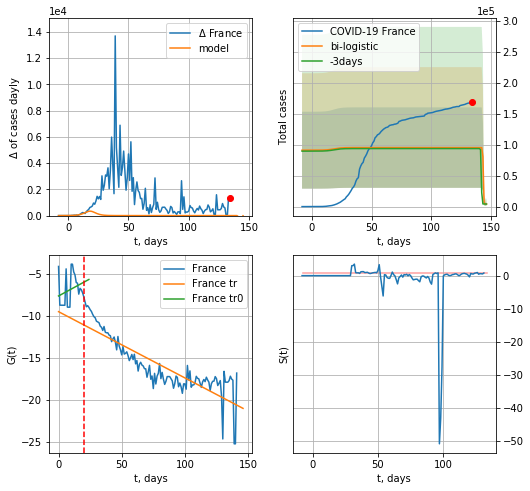

France data at: 2020-07-06
+3 day model MAPE: 0.01655827791312979
model: bi-logistic
coeffs:  [ 9.09431968e+04 -5.47176306e+00  1.43300911e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.6818763003817084
forecast at the end of period: +12 days
	 deltaDaycases:  -8
	 total cases:  4173 ± 2846
	 total death:  741 ± 1515
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.738961
 intercept: -9.537992
 slope: -0.078771


In [107]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,16*7-dT,1.0)
xx = forecast2('France',dfFR,d1,16*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [108]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

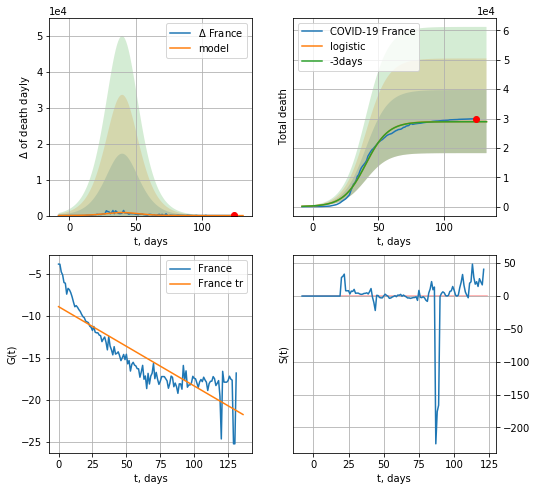

France data at: 2020-07-06
+3 day model MAPE: 0.002071240766573745
model: logistic
coeffs:  [2.89677936e+04 1.18004375e-01 4.04100556e+01]
rational stdev:  0.3711044085967006
forecast at the end of period: +8 days
	 total death:  28967 ± 10749
trend coefficient of determination: 0.768719
 intercept: -8.940192
 slope: -0.094324


In [109]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


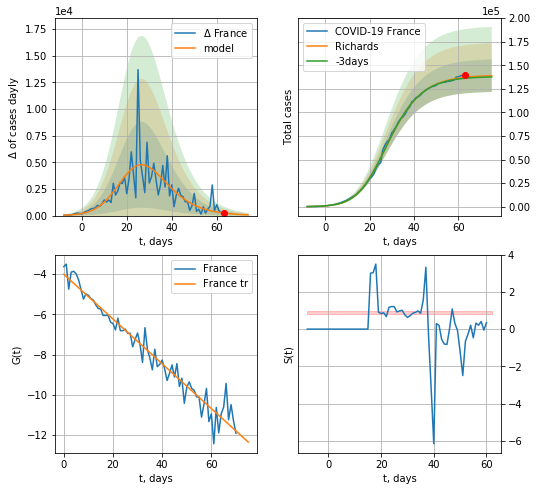

France data at: 2020-07-06
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530079e+05 2.42709630e-01 2.04374273e+01 4.70589839e-01]
rational stdev: 0.124192
forecast at the end of period: +12 days
	 deltaDaycases: 70
	 total cases: 138949 ± 17256
	 total death: 24696 ± 9201
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


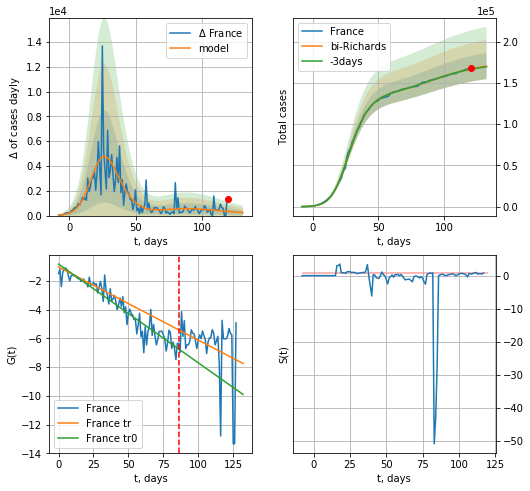

France data at: 2020-07-06
+3 day model MAPE: 0.003088
model: bi-Richards
coeffs: [ 3.74454829e+04  4.15665775e+00 -2.64524862e+01  9.56402711e-03]
rational stdev: 0.092871
forecast at the end of period: +12 days
	 deltaDaycases: 239
	 total cases: 170433 ± 15828
	 total death: 30293 ± 8440
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.903783
 intercept: -0.829781
 slope: -0.068744
trend coefficient of determination: 0.098460
 intercept: -1.033144
 slope: -0.050887


In [110]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


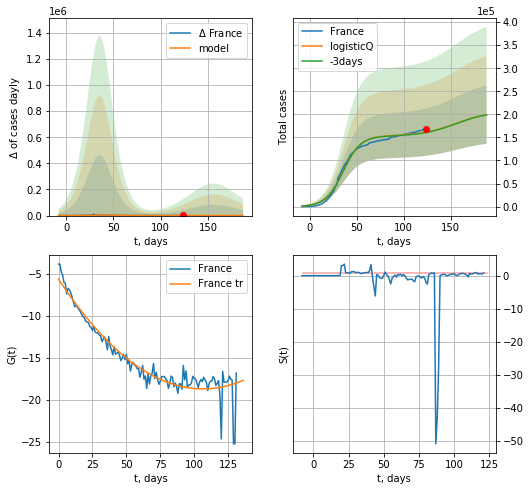

France data at: 2020-07-06
+3 day model MAPE: 0.005230
model: logisticQ
coeffs: [ 1.53402786e+05  2.24634099e-07  3.58026800e+01 -4.78274954e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317523
forecast at the end of period: +64 days
	 deltaDaycases: 383
	 total cases: 199531 ± 63355
	 total death: 35464 ± 33781
trend coefficient of determination: 0.901945
 intercept_: -5.670162042699872
 coeffs_: [ 0.         -0.24525107  0.00115212]


In [111]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


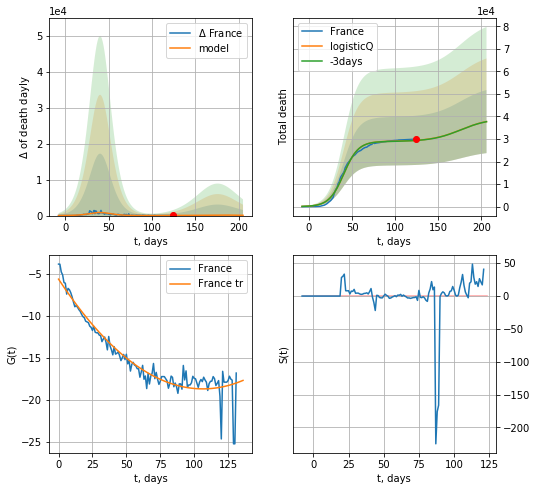

France data at: 2020-07-06
+3 day model MAPE: 0.002095
model: logisticQ
coeffs: [ 2.89677559e+04  3.67422573e-07  4.04107512e+01 -3.21028330e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371163
forecast at the end of period: +82 days
	 total death: 37737 ± 14006
trend coefficient of determination: 0.901945
 intercept_: -5.670162042699872
 coeffs_: [ 0.         -0.24525107  0.00115212]


In [112]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [113]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [114]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
129 2020-07-02  196717    6653  9064.0
130 2020-07-03  197000    6627  9073.0
131 2020-07-04  197418    7037  9081.0
132 2020-07-05  197558    6272  9086.0
133 2020-07-06  198064    6272  9092.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


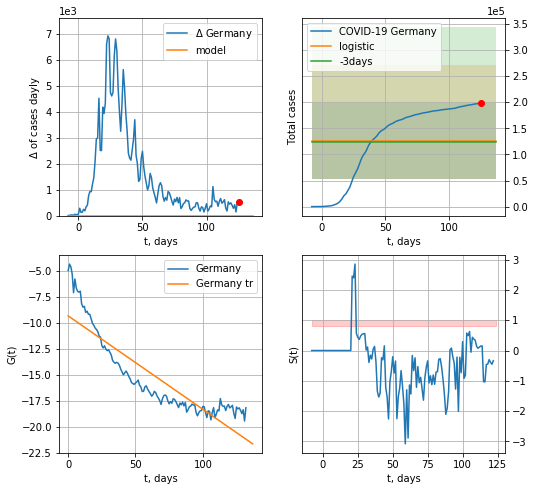

Germany data at: 2020-07-06
+3 day model MAPE: 0.013339198947166645
model: logistic
coeffs:  [ 1.25526186e+05 -4.86519706e+00  1.44951658e+02]
rational stdev:  0.5803594125657658
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  125526 ± 72850
	 total death:  5762 ± 10032
trend coefficient of determination: 0.788246
 intercept: -9.335710
 slope: -0.089758


In [115]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*16-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


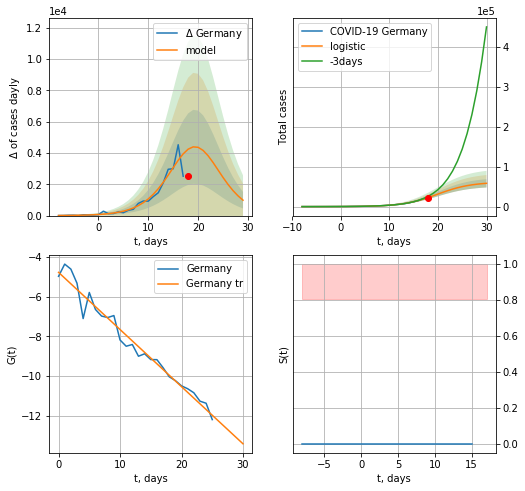

Germany data at: 2020-07-06
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +12 days
	 deltaDaycases:  983
	 total cases:  58367 ± 10396
	 total death:  2679 ± 1431
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


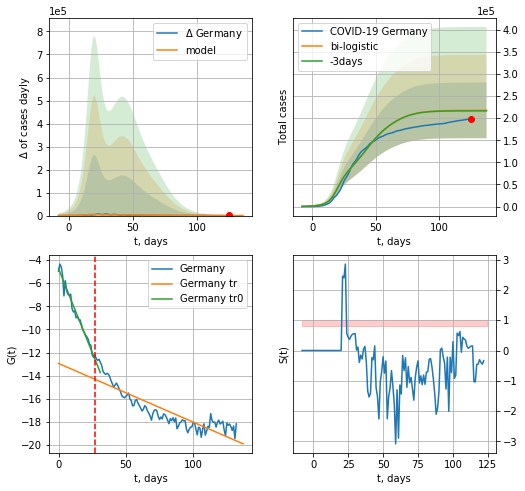

Germany data at: 2020-07-06
+3 day model MAPE: 0.004723055531078314
model: bi-logistic
coeffs:  [1.24718831e+05 1.09236422e-01 4.16773477e+01] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.28915011523865813
forecast at the end of period: +12 days
	 deltaDaycases:  2
	 total cases:  217430 ± 62870
	 total death:  9981 ± 8658
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.782019
 intercept: -12.944118
 slope: -0.050702


In [116]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,16*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*16-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
129 2020-07-02  196717    6653  9064.0
130 2020-07-03  197000    6627  9073.0
131 2020-07-04  197418    7037  9081.0
132 2020-07-05  197558    6272  9086.0
133 2020-07-06  198064    6272  9092.0


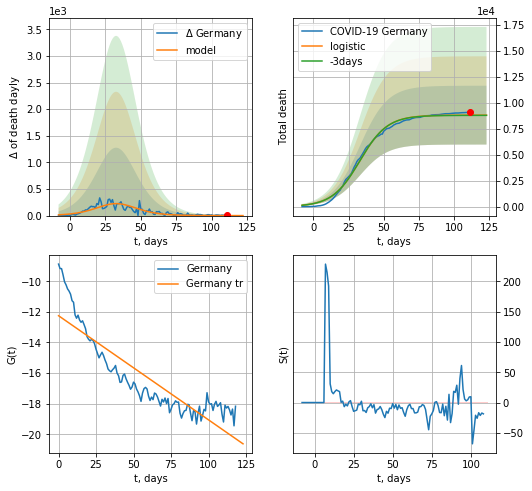

Germany data at: 2020-07-06
+3 day model MAPE: 0.002392282806082984
model: logistic
coeffs:  [8.82293958e+03 1.02113898e-01 3.30380494e+01]
rational stdev:  0.3214763219403473
forecast at the end of period: +12 days
	 total death:  8822 ± 2836
trend coefficient of determination: 0.784155
 intercept: -12.251460
 slope: -0.068045


In [117]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


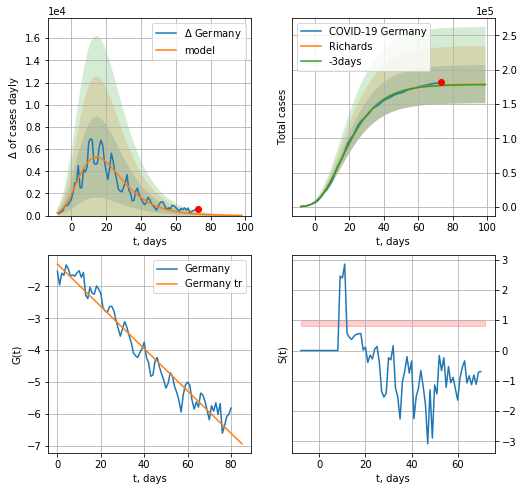

Germany data at: 2020-07-06
+3 day model MAPE: 0.003916
model: Richards
coeffs: [ 1.79110364e+05  9.11571266e+00 -4.38812227e+01  8.82260552e-03]
rational stdev: 0.155516
forecast at the end of period: +26 days
	 deltaDaycases: 17
	 total cases: 178902 ± 27822
	 total death: 8212 ± 3831
trend coefficient of determination: 0.956452
 intercept: -1.304650
 slope: -0.066180


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


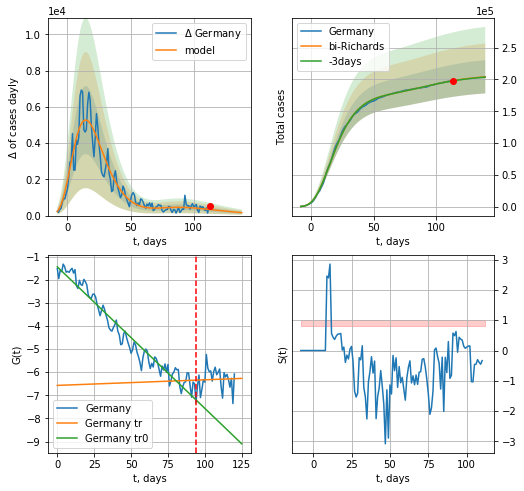

Germany data at: 2020-07-06
+3 day model MAPE: 0.001090
model: bi-Richards
coeffs: [ 2.94138322e+04  4.55563351e+00 -2.76178582e+01  8.65382871e-03]
rational stdev: 0.127729
forecast at the end of period: +26 days
	 deltaDaycases: 163
	 total cases: 204114 ± 26071
	 total death: 9369 ± 3590
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950722
 intercept: -1.445268
 slope: -0.061211
trend coefficient of determination: 0.001493
 intercept: -6.571398
 slope: 0.002421


In [118]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


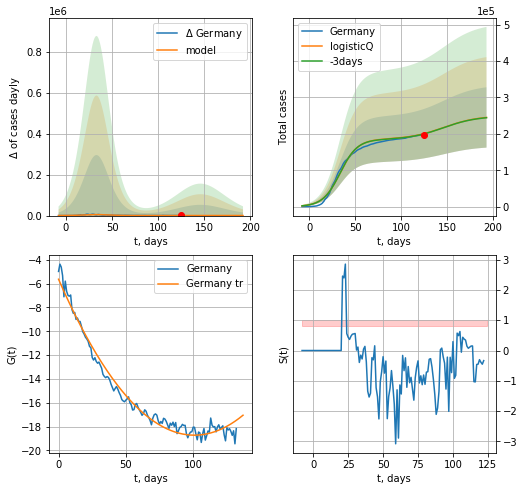

Germany data at: 2020-07-06
+3 day model MAPE: 0.003044
model: logisticQ
coeffs: [ 1.84742256e+05  2.26524732e-07  3.35585711e+01 -4.67363747e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.338450
forecast at the end of period: +68 days
	 deltaDaycases: 252
	 total cases: 245159 ± 82974
	 total death: 11253 ± 11425
trend coefficient of determination: 0.979057
 intercept_: -5.629578544522332
 coeffs_: [ 0.         -0.25950727  0.00128599]


In [119]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


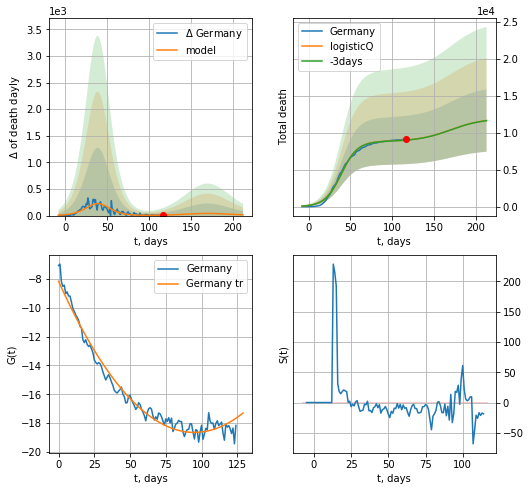

Germany data at: 2020-07-06
+3 day model MAPE: 0.002352
model: logisticQ
coeffs: [ 8.82151584e+03  3.93609618e-07  3.90362133e+01 -2.59838384e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362540
forecast at the end of period: +96 days
	 total death: 11635 ± 4218
trend coefficient of determination: 0.975485
 intercept_: -8.14359049853
 coeffs_: [ 0.         -0.22133648  0.00116524]


In [120]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
123 2020-07-02  2837189  1514613  131485.0
124 2020-07-03  2890588  1522999  132101.0
125 2020-07-04  2935770  1543047  132318.0
126 2020-07-05  2983155  1560897  132571.0
127 2020-07-06  3041035  1582988  132981.0


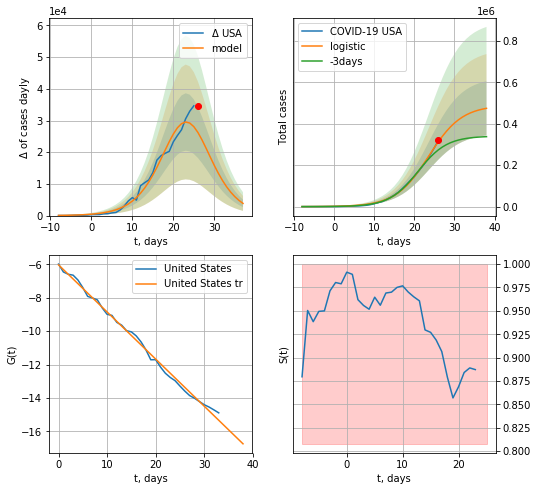

USA data at: 2020-07-06
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +12 days
	 deltaDaycases:  3844
	 total cases:  474431 ± 130976
	 total death:  20746 ± 17182
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


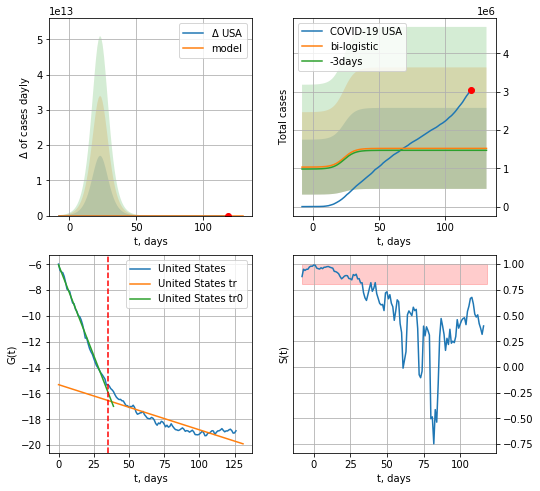

USA data at: 2020-07-06
+3 day model MAPE: 0.03415955952491773
model: bi-logistic
coeffs:  [ 8.24470479e+05 -1.05081573e+01  2.61454310e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6955779840869925
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1519613 ± 1057009
	 total death:  66450 ± 138663
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.797429
 intercept: -15.317052
 slope: -0.034939


In [121]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

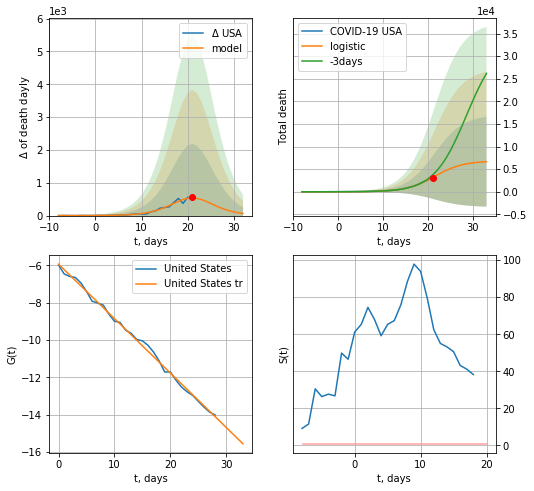

USA data at: 2020-07-06
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +12 days
	 total death:  6659 ± 9941
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


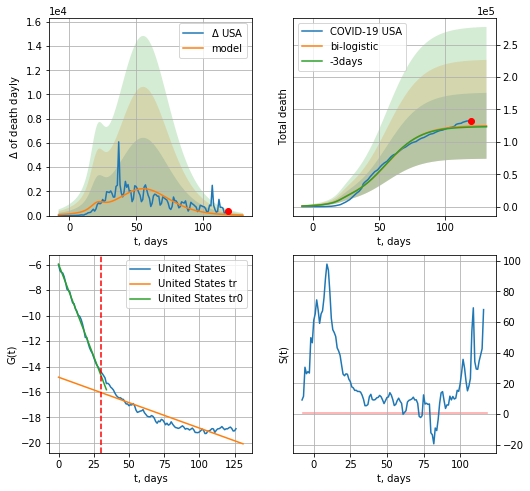

USA data at: 2020-07-06
+3 day model MAPE: 0.011375915762626053
model: bi-logistic
coeffs:  [1.18369764e+05 7.49341460e-02 5.57557819e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.40815219596754077
forecast at the end of period: +12 days
	 deltaDaydeath:  32
	 total death:  124783 ± 50930
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.793747
 intercept: -14.839472
 slope: -0.039969


In [122]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*16-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


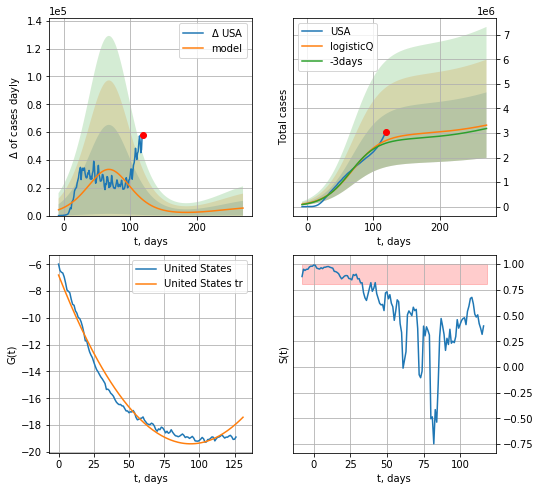

USA data at: 2020-07-06
+3 day model MAPE: 0.041859
model: logisticQ
coeffs: [ 2.94725223e+06  1.40658014e-07  6.82147920e+01 -3.19057132e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.401894
forecast at the end of period: +152 days
	 deltaDaycases: 5398
	 total cases: 3318155 ± 1333545
	 total death: 145099 ± 174943
trend coefficient of determination: 0.979561
 intercept_: -6.8081497972547815
 coeffs_: [ 0.         -0.26844337  0.00143136]


In [123]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


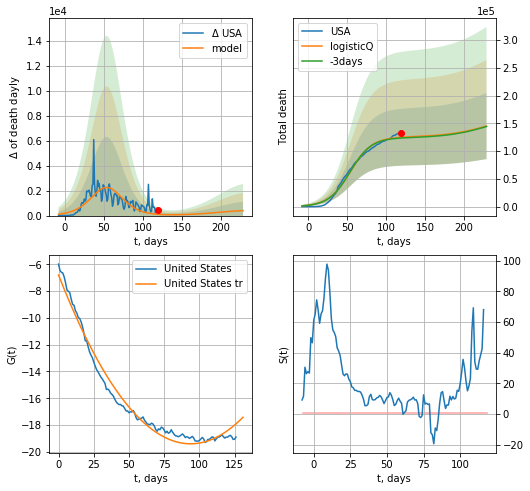

USA data at: 2020-07-06
+3 day model MAPE: 0.011165
model: logisticQ
coeffs: [ 1.25316106e+05  2.21136583e-07  5.39398646e+01 -3.25122506e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410191
forecast at the end of period: +110 days
	 total death: 145067 ± 59505
trend coefficient of determination: 0.979561
 intercept_: -6.8081497972547815
 coeffs_: [ 0.         -0.26844337  0.00143136]


In [124]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


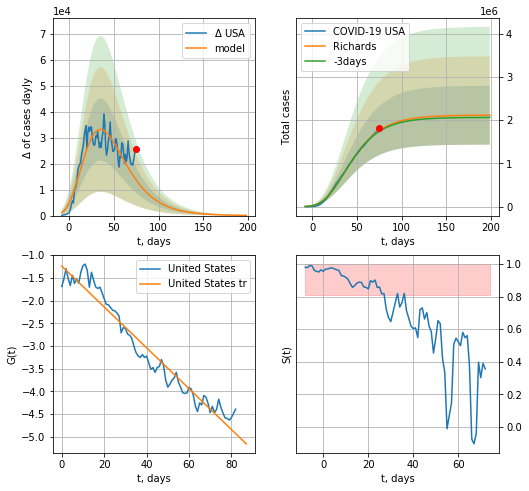

USA data at: 2020-07-06
+3 day model MAPE: 0.011173
model: Richards
coeffs: [ 2.11547108e+06  4.55700208e+00 -7.32276786e+01  9.40292240e-03]
rational stdev: 0.321873
forecast at the end of period: +124 days
	 deltaDaycases: 84
	 total cases: 2113539 ± 680290
	 total death: 92422 ± 89244
trend coefficient of determination: 0.952323
 intercept: -1.242025
 slope: -0.044961


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


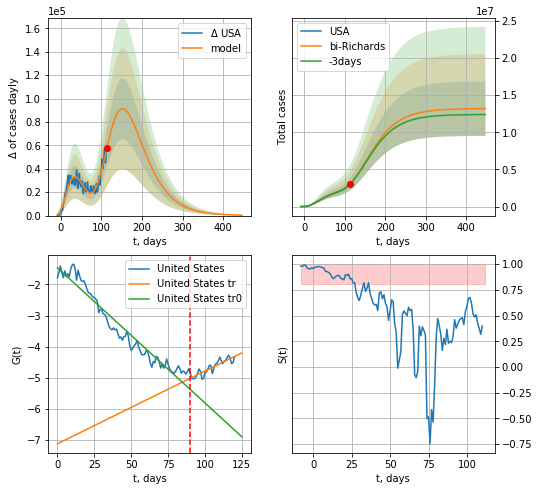

USA data at: 2020-07-06
+3 day model MAPE: 0.002418
model: bi-Richards
coeffs: [ 1.10899837e+07  9.00377863e-01 -1.04928027e+01  2.49999267e-02]
rational stdev: 0.278106
forecast at the end of period: +334 days
	 deltaDaycases: 339
	 total cases: 13190513 ± 3668357
	 total death: 576806 ± 481239
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.944899
 intercept: -1.463131
 slope: -0.043490
trend coefficient of determination: 0.769889
 intercept: -7.124462
 slope: 0.023408


In [125]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*62-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


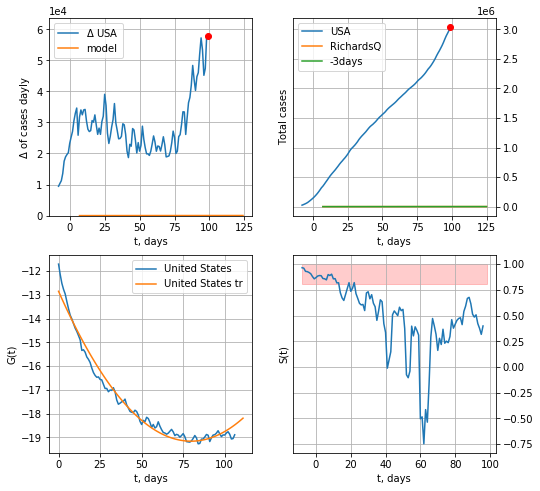

USA data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.52188019e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +26 days
	 deltaDaycases: 30


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [126]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
127 2020-07-02  283757       0  43995.0
128 2020-07-03  284276       0  44131.0
129 2020-07-04  284900       0  44198.0
130 2020-07-05  285416       0  44220.0
131 2020-07-06  285768       0  44236.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


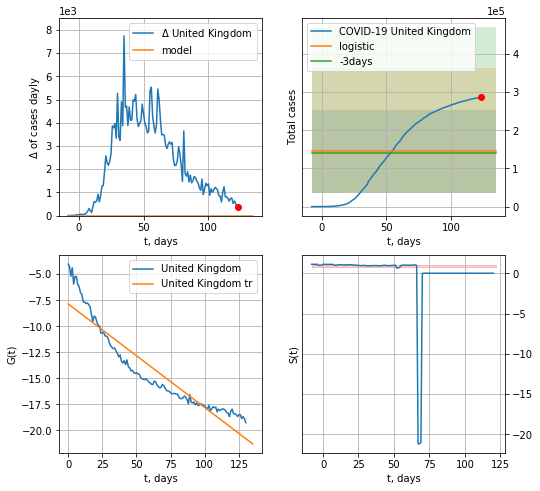

United Kingdom data at: 2020-07-06
+3 day model MAPE: 0.02315820448250593
model: logistic
coeffs:  [ 1.44613887e+05 -8.34004803e+00  2.16806794e+02]
rational stdev:  0.7511451030268764
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  144613 ± 108626
	 total death:  22385 ± 50443
trend coefficient of determination: 0.878018
 intercept: -7.858821
 slope: -0.099496


In [127]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*16-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


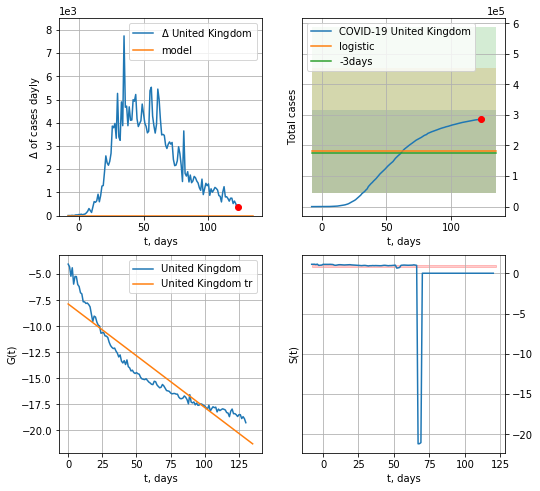

United Kingdom data at: 2020-07-06
+3 day model MAPE: 0.023158204482505967
model: logistic
coeffs:  [ 1.44613887e+05 -8.34004803e+00  2.16806794e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7511451030268764
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  180767 ± 135782
	 total death:  27982 ± 63055
trend coefficient of determination: 0.878018
 intercept: -7.858821
 slope: -0.099496


In [128]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


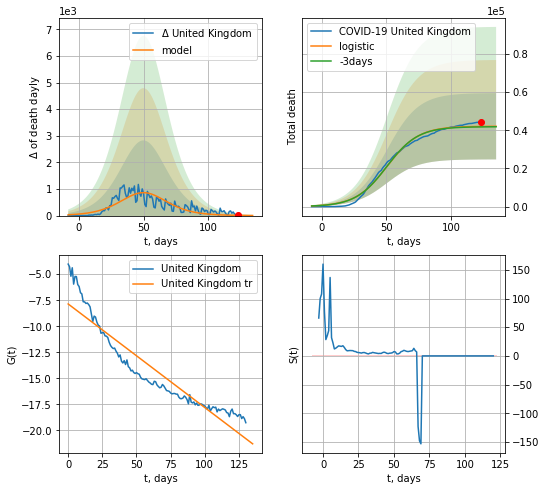

United Kingdom data at: 2020-07-06
+3 day model MAPE: 0.006000170192236199
model: logistic
coeffs:  [4.21293539e+04 8.19582747e-02 5.04184279e+01]
rational stdev:  0.4123852908394676
forecast at the end of period: +12 days
	 total death:  42088 ± 17356
trend coefficient of determination: 0.878018
 intercept: -7.858821
 slope: -0.099496


In [129]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


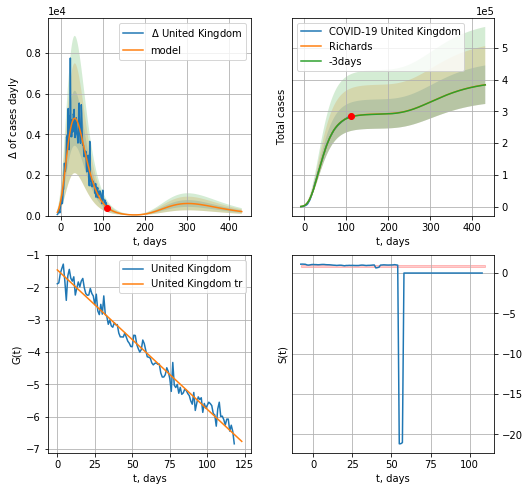

United Kingdom data at: 2020-07-06
+3 day model MAPE: 0.001657
model: Richards
coeffs: [ 2.91980570e+05  3.96855250e+00 -6.61209206e+01  1.12914262e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.157947
forecast at the end of period: +320 days
	 deltaDaycases: 198
	 total cases: 383969 ± 60646
	 total death: 59437 ± 28163
trend coefficient of determination: 0.978048
 intercept: -1.460622
 slope: -0.043134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


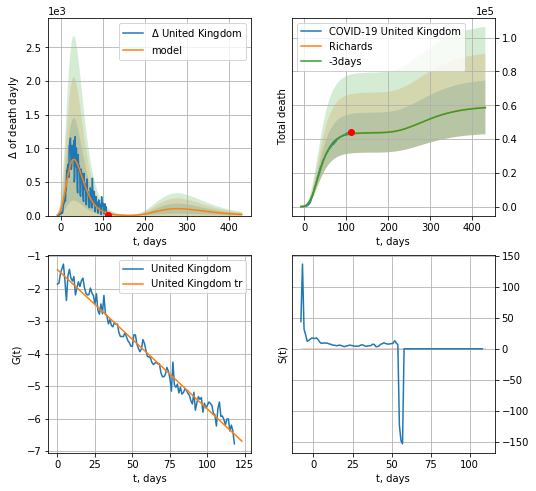

United Kingdom data at: 2020-07-06
+3 day model MAPE: 0.003586
model: Richards
coeffs: [ 4.38533876e+04  8.29547195e+00 -6.63608949e+01  6.26185787e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.270256
forecast at the end of period: +320 days
	 total death: 58744 ± 15876
trend coefficient of determination: 0.977925
 intercept: -1.415894
 slope: -0.042927


In [130]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


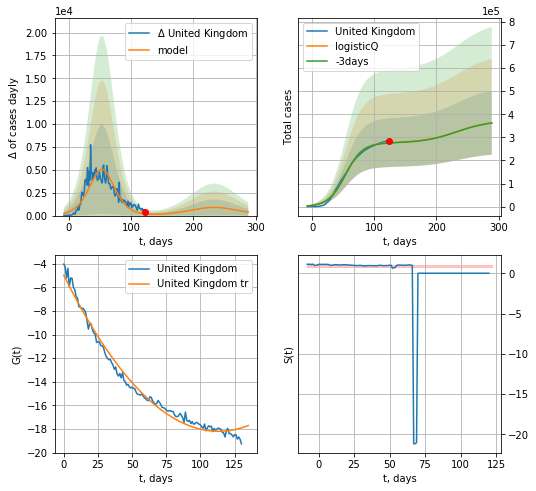

United Kingdom data at: 2020-07-06
+3 day model MAPE: 0.005125
model: logisticQ
coeffs: [ 2.76681120e+05  2.43635037e-07  5.36244033e+01 -2.98952694e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.380946
forecast at the end of period: +166 days
	 deltaDaycases: 374
	 total cases: 363253 ± 138379
	 total death: 56230 ± 64261
trend coefficient of determination: 0.985903
 intercept_: -4.977001524142048
 coeffs_: [ 0.         -0.23353632  0.00103109]


In [131]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


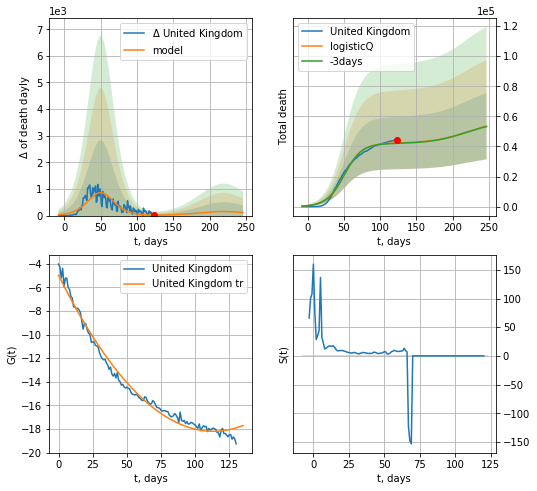

United Kingdom data at: 2020-07-06
+3 day model MAPE: 0.006071
model: logisticQ
coeffs: [ 4.21288352e+04  2.16130776e-07  5.04186094e+01 -3.79020886e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412411
forecast at the end of period: +124 days
	 total death: 53387 ± 22017
trend coefficient of determination: 0.985903
 intercept_: -4.977001524142048
 coeffs_: [ 0.         -0.23353632  0.00103109]


In [132]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [133]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [134]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [135]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [136]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [137]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [138]:
dT

100

DK
           date    cases  active  death
126 2020-07-02  12815.0     440  606.0
127 2020-07-03  12832.0     409  606.0
128 2020-07-04  12832.3     409  606.0
129 2020-07-05  12832.6     409  606.0
130 2020-07-06  12878.0     336  607.0


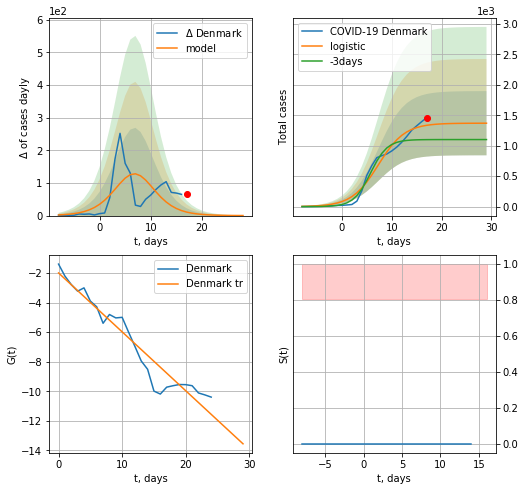

Denmark data at: 2020-07-06
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  64 ± 73
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


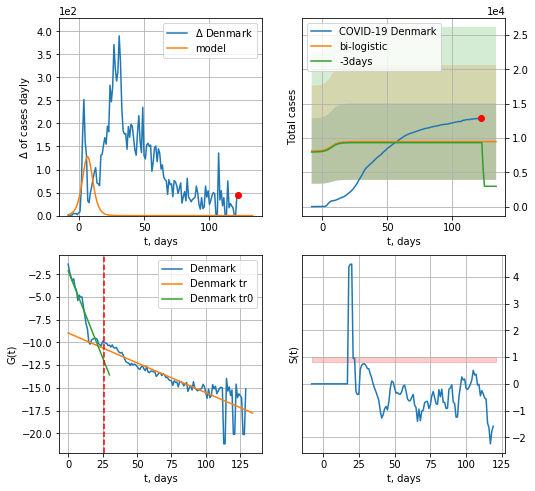

Denmark data at: 2020-07-06
+3 day model MAPE: 0.01734029066731956
model: bi-logistic
coeffs:  [6472.84397317  -19.09535785  137.95744525] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5885814625438847
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  9460 ± 5568
	 total death:  445 ± 785
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.750179
 intercept: -8.960527
 slope: -0.065695


In [139]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*16-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,16*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


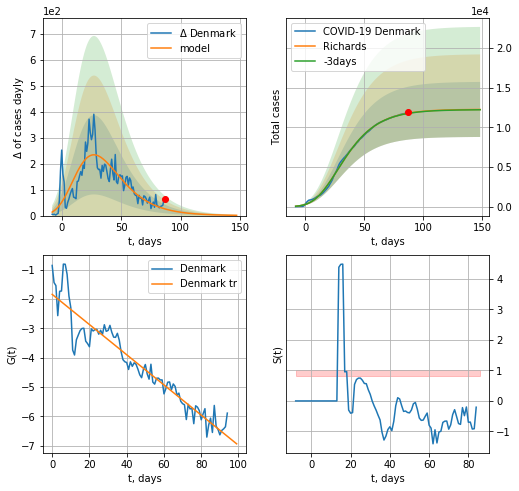

Denmark data at: 2020-07-06
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412632e-01 -2.17374814e+01  7.08529608e-02]
rational stdev: 0.283101
forecast at the end of period: +61 days
	 deltaDaycases: 1
	 total cases: 12246 ± 3467
	 total death: 577 ± 490
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


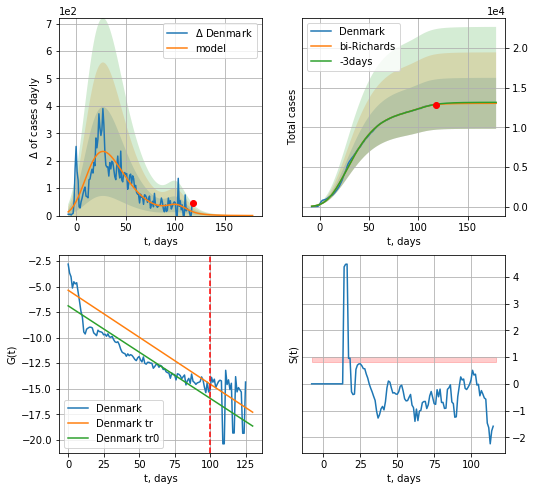

Denmark data at: 2020-07-06
+3 day model MAPE: 0.002966
model: bi-Richards
coeffs: [7.71990145e+02 1.57699599e-01 1.01254922e+02 9.19052550e-01]
rational stdev: 0.246484
forecast at the end of period: +61 days
	 deltaDaycases: 0
	 total cases: 13034 ± 3212
	 total death: 614 ± 454
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.858165
 intercept: -6.888846
 slope: -0.090463
trend coefficient of determination: 0.093108
 intercept: -5.366054
 slope: -0.091771


In [140]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


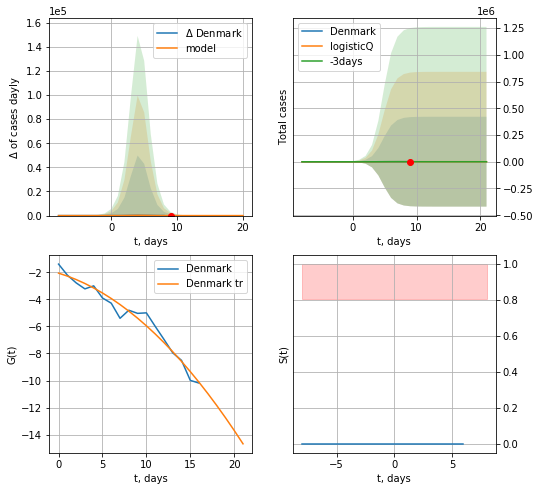

Denmark data at: 2020-07-06
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 40 ± 58472
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


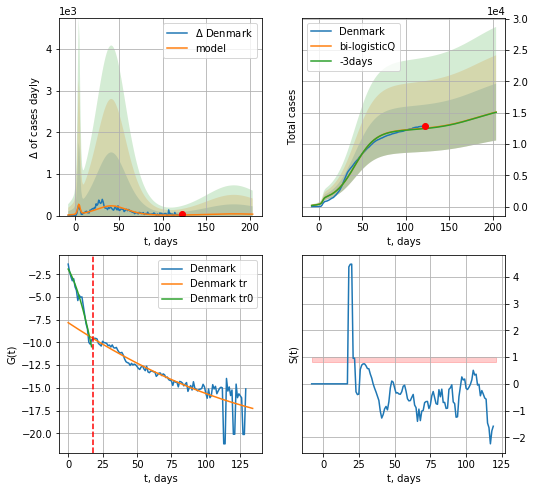

Denmark data at: 2020-07-06
+3 day model MAPE: 0.004725
model: bi-logisticQ
coeffs: [ 1.13551731e+04  1.69700223e-07  4.17523686e+01 -4.85135604e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.300427
forecast at the end of period: +82 days
	 deltaDaycases: 34
	 total cases: 15086 ± 4532
	 total death: 711 ± 640
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.803215
 intercept_: -7.827099596634296
 coeffs_: [ 0.         -0.10007998  0.00022174]


In [141]:
x = forecastRRR('Denmark',dfDK[:18],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
127 2020-07-02  8902.0     513  251.0
128 2020-07-03  8921.0     532  251.0
129 2020-07-04  8926.0     537  251.0
130 2020-07-05  8930.0     541  251.0
131 2020-07-06  8936.0     547  251.0


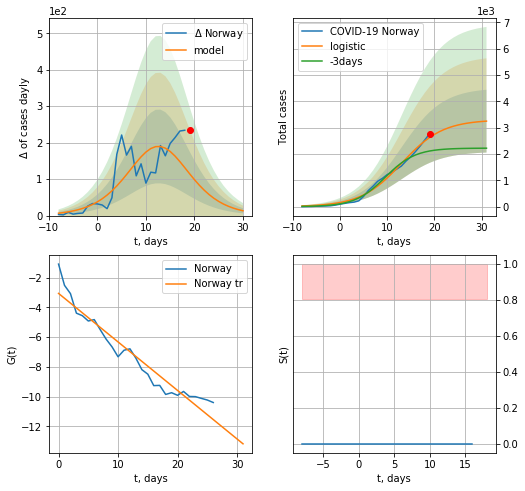

Norway data at: 2020-07-06
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +12 days
	 deltaDaycases:  13
	 total cases:  3246 ± 1192
	 total death:  91 ± 100
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


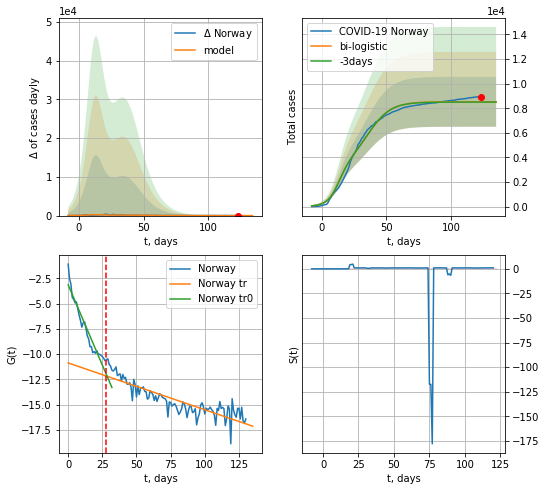

Norway data at: 2020-07-06
+3 day model MAPE: 0.0030513606121375914
model: bi-logistic
coeffs:  [5.22846295e+03 1.12508612e-01 3.57331418e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.23803660324130357
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  8526 ± 2029
	 total death:  239 ± 170
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.745009
 intercept: -10.864238
 slope: -0.046282


In [142]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

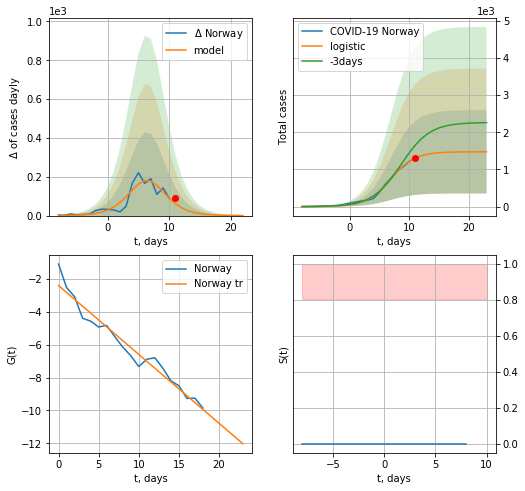

Norway data at: 2020-07-06
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1474 ± 1119
	 total death:  41 ± 93
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


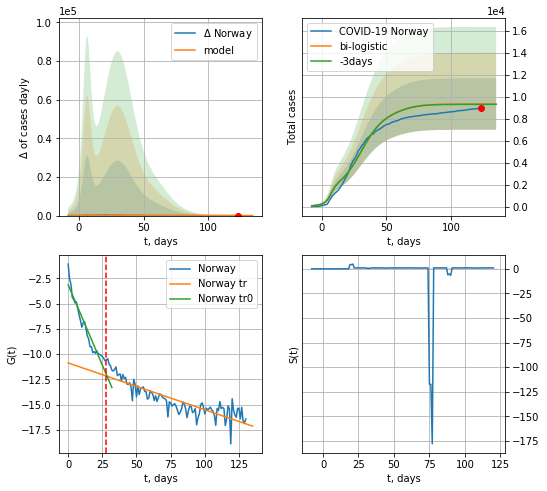

Norway data at: 2020-07-06
+3 day model MAPE: 0.003155779592628302
model: bi-logistic
coeffs:  [6.98973823e+03 1.17514168e-01 3.02563642e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.2505154535358627
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  9338 ± 2339
	 total death:  262 ± 196
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.745009
 intercept: -10.864238
 slope: -0.046282


In [143]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


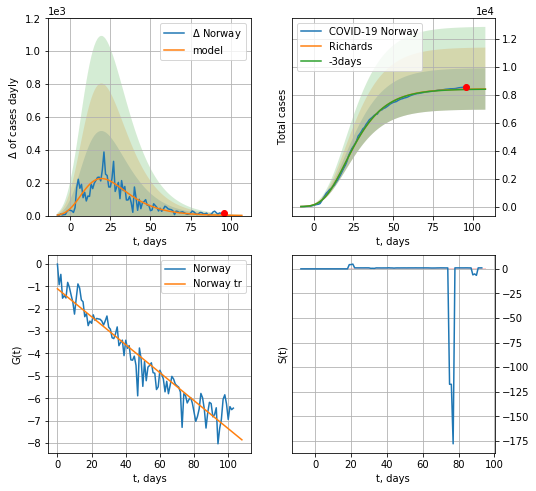

Norway data at: 2020-07-06
+3 day model MAPE: 0.002094
model: Richards
coeffs: [ 8.43838842e+03  7.14084289e+00 -4.28210769e+01  1.02282394e-02]
rational stdev: 0.175948
forecast at the end of period: +12 days
	 deltaDaycases: 1
	 total cases: 8424 ± 1482
	 total death: 236 ± 124
trend coefficient of determination: 0.922155
 intercept: -1.112087
 slope: -0.062445


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


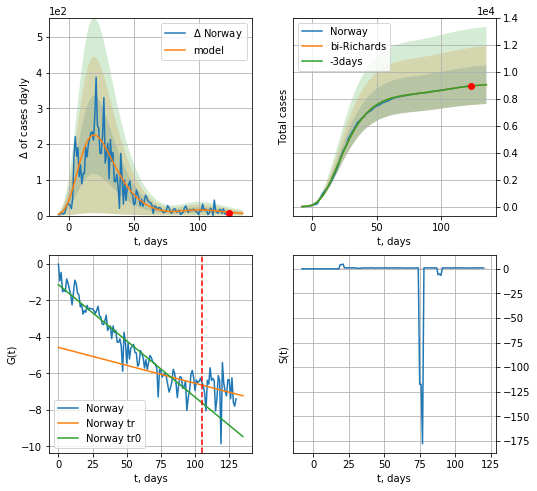

Norway data at: 2020-07-06
+3 day model MAPE: 0.000063
model: bi-Richards
coeffs: [7.18250436e+02 5.53220236e+00 1.82090866e+01 9.79665437e-03]
rational stdev: 0.158098
forecast at the end of period: +12 days
	 deltaDaycases: 6
	 total cases: 9035 ± 1428
	 total death: 253 ± 119
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.918525
 intercept: -1.134495
 slope: -0.061701
trend coefficient of determination: 0.027186
 intercept: -4.577508
 slope: -0.019667


In [144]:
vL = 105
x = forecastRR('Norway',dfNG[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


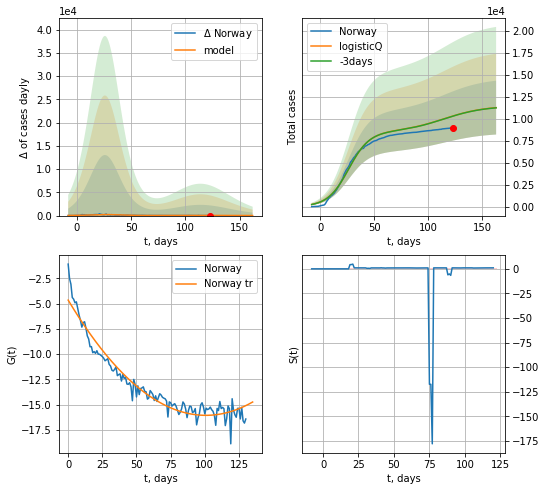

Norway data at: 2020-07-06
+3 day model MAPE: 0.001163
model: logisticQ
coeffs: [ 8.47766359e+03  2.44399653e-07  2.62631515e+01 -4.23477053e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.271767
forecast at the end of period: +40 days
	 deltaDaycases: 10
	 total cases: 11258 ± 3059
	 total death: 316 ± 257
trend coefficient of determination: 0.940219
 intercept_: -4.656090455815432
 coeffs_: [ 0.         -0.22602879  0.0011218 ]


In [145]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


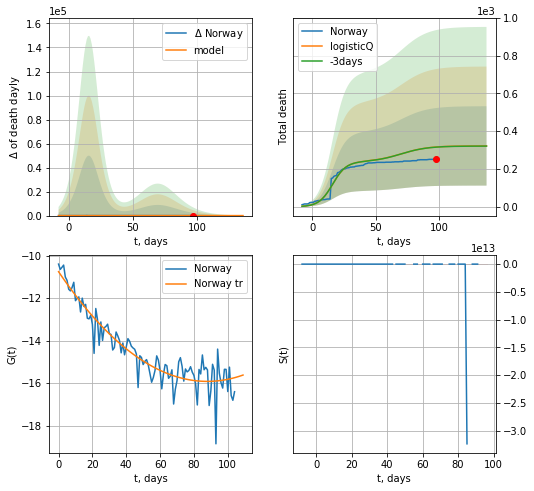

Norway data at: 2020-07-06
+3 day model MAPE: 0.002179
model: logisticQ
coeffs: [ 2.37982681e+02  1.17459622e-06  1.60383708e+01 -1.59308070e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.651731
forecast at the end of period: +40 days
	 total death: 322 ± 209
trend coefficient of determination: 0.864810
 intercept_: -10.757515986390384
 coeffs_: [ 0.         -0.11746956  0.00066843]


In [146]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date    cases  active   death
128 2020-07-02  70639.0       0  5411.0
129 2020-07-03  71419.0       0  5420.0
130 2020-07-04  71419.3       0  5420.0
131 2020-07-05  71419.6       0  5420.0
132 2020-07-06  73061.0       0  5433.0


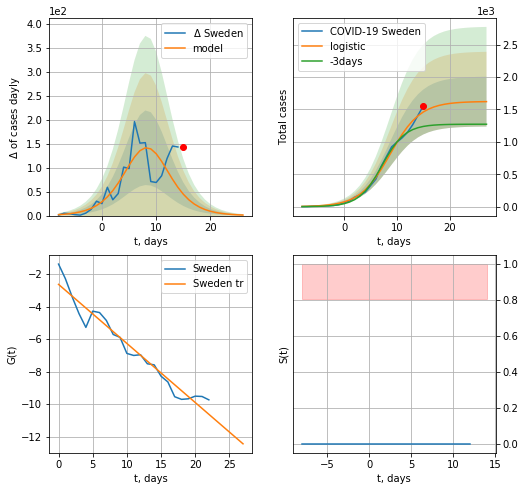

Sweden data at: 2020-07-06
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +12 days
	 deltaDaycases:  1
	 total cases:  1620 ± 384
	 total death:  120 ± 85
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


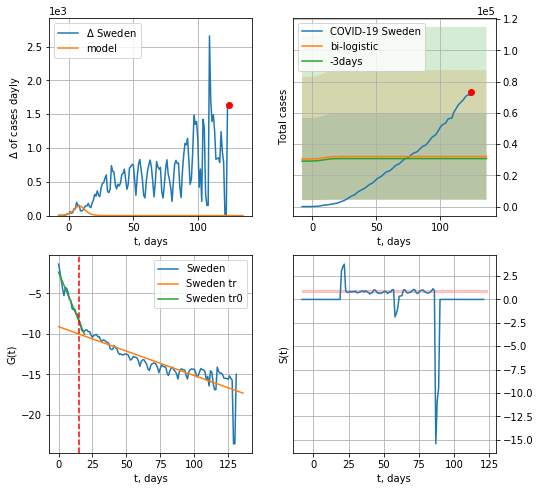

Sweden data at: 2020-07-06
+3 day model MAPE: 0.04317022116633264
model: bi-logistic
coeffs:  [ 2.43492062e+04 -9.73839506e+00  2.47543126e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8625942412087722
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  32059 ± 27654
	 total death:  2384 ± 6169
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.753327
 intercept: -9.101834
 slope: -0.060298


In [147]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[:-9-dT],d1,7*16-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date    cases  active   death
128 2020-07-02  70639.0       0  5411.0
129 2020-07-03  71419.0       0  5420.0
130 2020-07-04  71419.3       0  5420.0
131 2020-07-05  71419.6       0  5420.0
132 2020-07-06  73061.0       0  5433.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


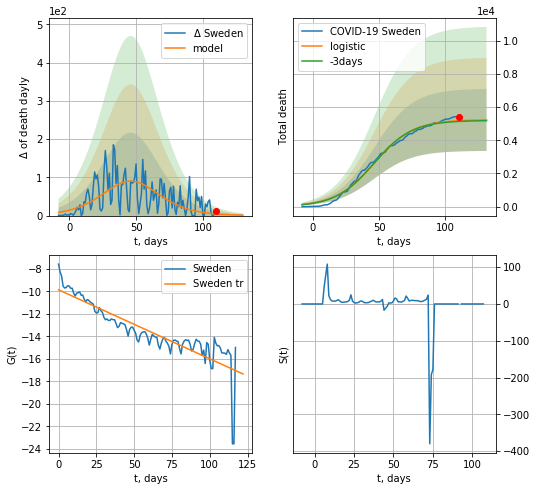

Sweden data at: 2020-07-06
+3 day model MAPE: 0.00821398814637093
model: logistic
coeffs:  [5.24776083e+03 6.87138718e-02 4.63988779e+01]
rational stdev:  0.35760889686700315
forecast at the end of period: +21 days
	 total death:  5232 ± 1871
trend coefficient of determination: 0.758002
 intercept: -9.866865
 slope: -0.061309


In [148]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


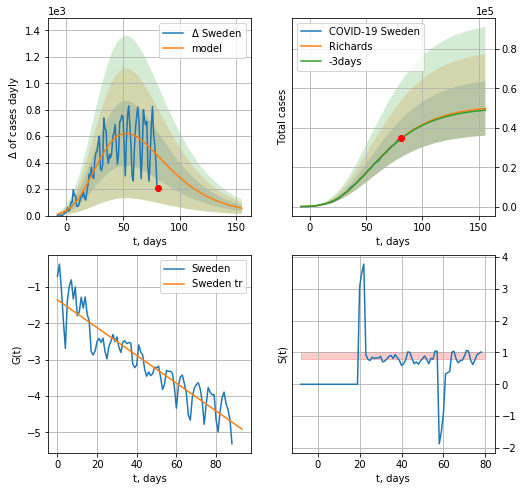

Sweden data at: 2020-07-06
+3 day model MAPE: 0.006125
model: Richards
coeffs: [ 5.15411678e+04  1.71360194e+00 -6.59040825e+01  1.93271263e-02]
rational stdev: 0.276754
forecast at the end of period: +75 days
	 deltaDaycases: 55
	 total cases: 49854 ± 13797
	 total death: 3707 ± 3077
trend coefficient of determination: 0.852284
 intercept: -1.357303
 slope: -0.038160


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


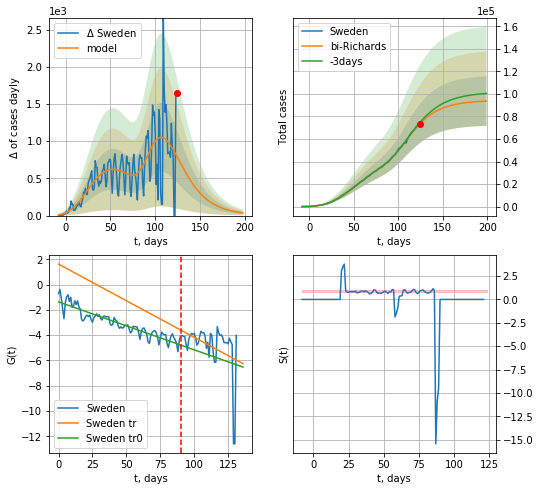

Sweden data at: 2020-07-06
+3 day model MAPE: 0.014172
model: bi-Richards
coeffs: [4.28900694e+04 2.70469025e+00 3.48823758e+01 1.94036425e-02]
rational stdev: 0.234506
forecast at the end of period: +75 days
	 deltaDaycases: 35
	 total cases: 93620 ± 21954
	 total death: 6961 ± 4897
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.854293
 intercept: -1.364207
 slope: -0.037943
trend coefficient of determination: 0.143417
 intercept: 1.624623
 slope: -0.057928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


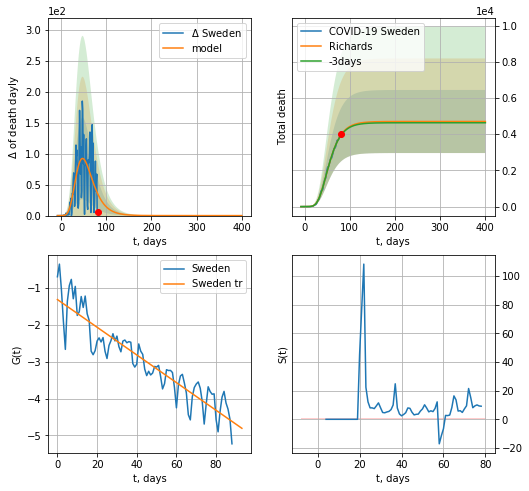

Sweden data at: 2020-07-06
+3 day model MAPE: 0.006769
model: Richards
coeffs: [ 4.70128038e+03  4.77681479e+00 -3.56595016e+01  1.12330349e-02]
rational stdev: 0.370514
forecast at the end of period: +320 days
	 total death: 4701 ± 1741
trend coefficient of determination: 0.849510
 intercept: -1.318621
 slope: -0.037513


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


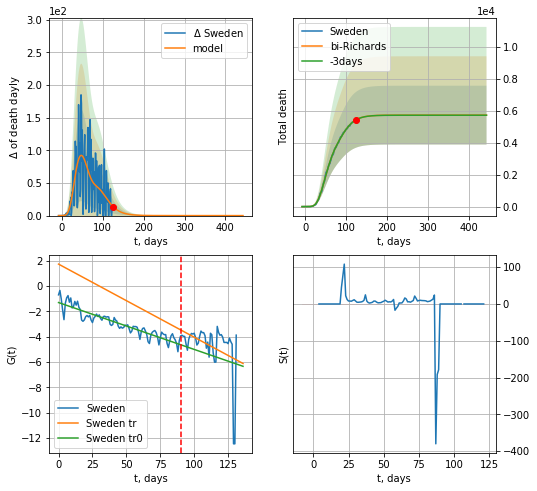

Sweden data at: 2020-07-06
+3 day model MAPE: 0.000452
model: bi-Richards
coeffs: [1.03543763e+03 7.12949710e+00 9.17533813e+00 7.68633438e-03]
rational stdev: 0.321277
forecast at the end of period: +320 days
	 total death: 5736 ± 1843
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.850373
 intercept: -1.307851
 slope: -0.037018
trend coefficient of determination: 0.142510
 intercept: 1.728808
 slope: -0.057718


In [149]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,60*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


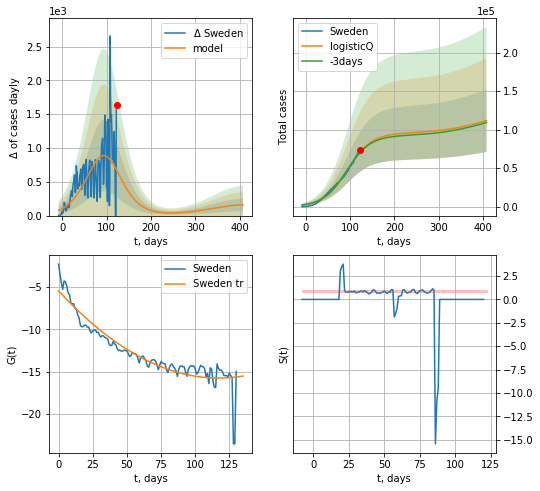

Sweden data at: 2020-07-06
+3 day model MAPE: 0.011890
model: logisticQ
coeffs: [ 9.51081763e+04  2.34031510e-07  9.40099302e+01 -1.59311468e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363820
forecast at the end of period: +285 days
	 deltaDaycases: 157
	 total cases: 111672 ± 40628
	 total death: 8304 ± 9063
trend coefficient of determination: 0.859051
 intercept_: -5.437006600397041
 coeffs_: [ 0.         -0.17624678  0.00075137]


In [150]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


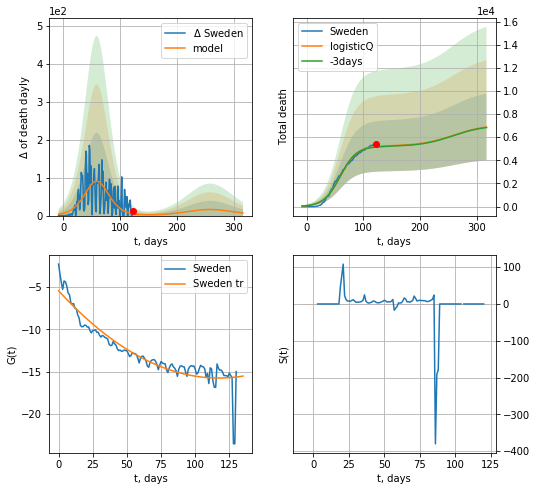

Sweden data at: 2020-07-06
+3 day model MAPE: 0.008309
model: logisticQ
coeffs: [ 5.24076421e+03  2.50338920e-07  5.93526707e+01 -2.76064382e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.419291
forecast at the end of period: +194 days
	 total death: 6880 ± 2885
trend coefficient of determination: 0.859051
 intercept_: -5.437006600397041
 coeffs_: [ 0.         -0.17624678  0.00075137]


In [151]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
162 2020-07-02  83542.0     409  4634.0
163 2020-07-03  83545.0     402  4634.0
164 2020-07-04  83553.0     403  4634.0
165 2020-07-05  83557.0     405  4634.0
166 2020-07-06  83565.0     403  4634.0


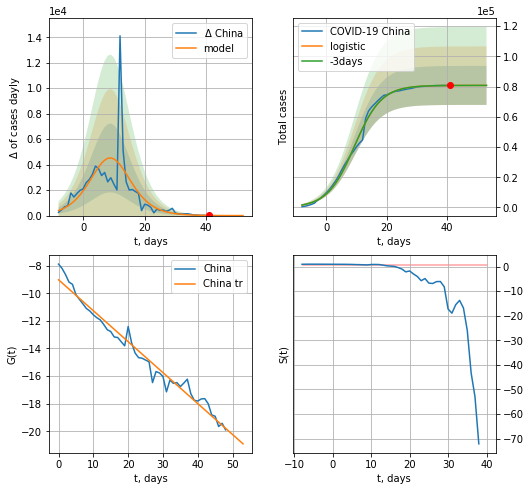

China data at: 2020-07-06
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +12 days
	 deltaDaycases:  1
	 total cases:  80805 ± 12905
	 total death:  4480 ± 2146
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


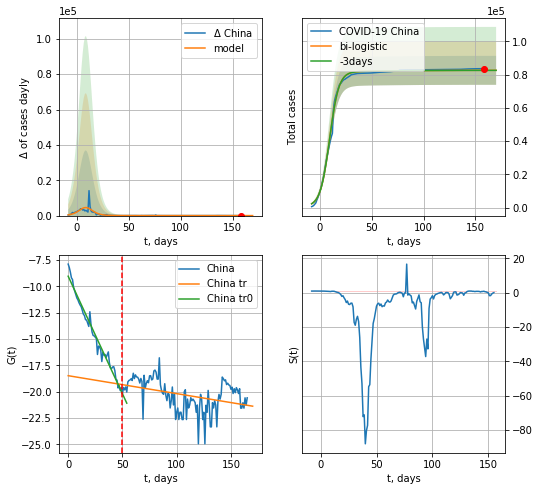

China data at: 2020-07-06
+3 day model MAPE: 0.00029215545684355766
model: bi-logistic
coeffs:  [1.79406037e+03 2.67257417e-02 1.24718946e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10545113983595135
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  82577 ± 8707
	 total death:  4579 ± 1448
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.148749
 intercept: -18.484472
 slope: -0.017032


In [152]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*16-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [153]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

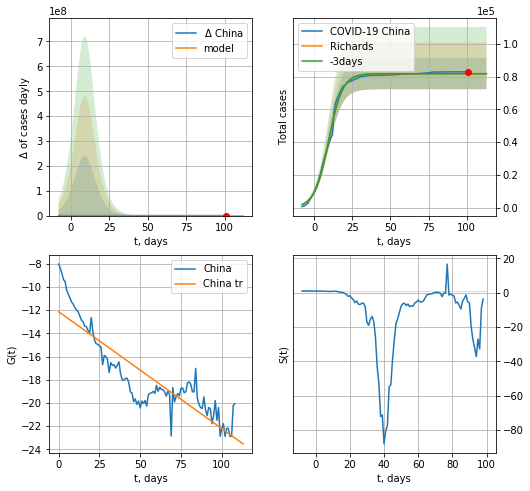

China data at: 2020-07-06
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4534 ± 1584
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


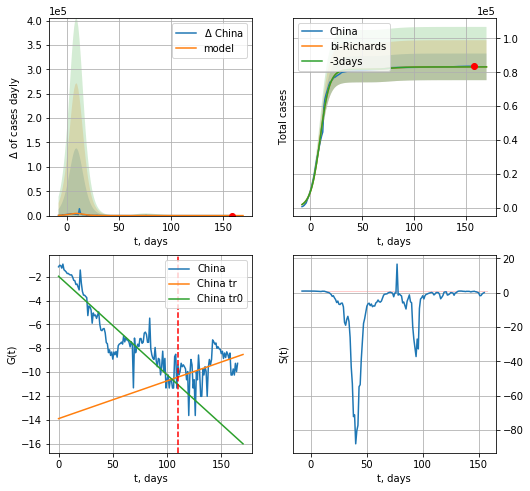

China data at: 2020-07-06
+3 day model MAPE: 0.000478
model: bi-Richards
coeffs: [1.42800585e+03 6.96285476e+01 4.15749672e+00 1.32833486e-03]
rational stdev: 0.094604
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 83201 ± 7871
	 total death: 4613 ± 1309
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.821007
 intercept: -1.966783
 slope: -0.082655
trend coefficient of determination: 0.144178
 intercept: -13.905011
 slope: 0.031638


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [154]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,16*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,16*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

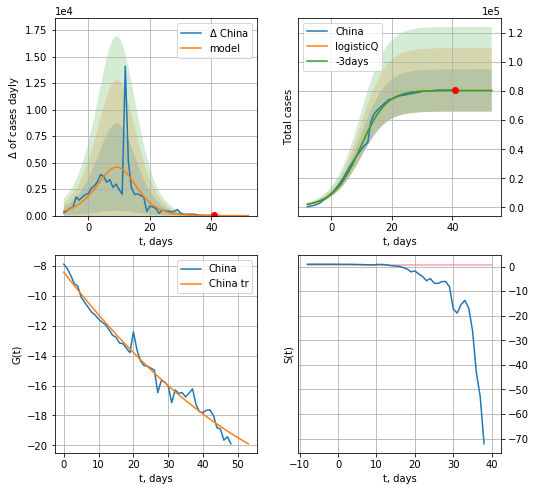

China data at: 2020-07-06
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14556
	 total death: 4459 ± 2421
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


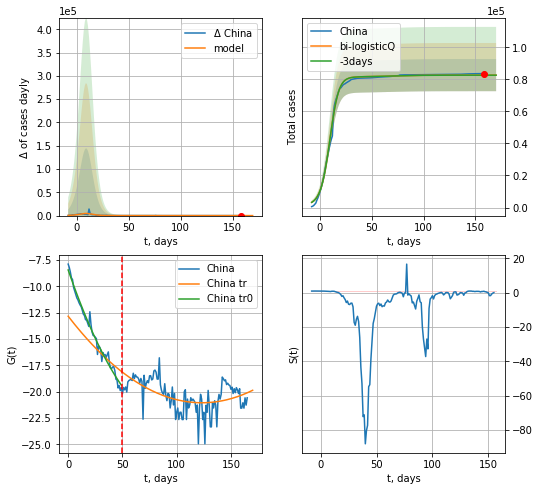

China data at: 2020-07-06
+3 day model MAPE: 0.000407
model: bi-logisticQ
coeffs: [ 2.20762078e+03  3.99978218e-04  2.47809485e+01 -4.27537702e-02]
rational stdev: 0.121411
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 82625 ± 10031
	 total death: 4581 ± 1668
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.283647
 intercept_: -12.835332298244643
 coeffs_: [ 0.         -0.13342677  0.00054138]


In [155]:
x = forecastRRR('China',dfCN[:50],d1,7*16-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)

In [156]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
138 2020-07-02  12967   926.0  282.0
139 2020-07-03  13030   936.0  283.0
140 2020-07-04  13091   976.0  283.0
141 2020-07-05  13137  1005.0  284.0
142 2020-07-06  13181   982.0  285.0


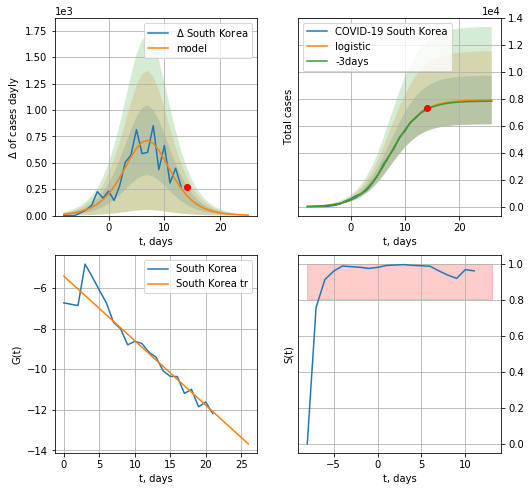

South Korea data at: 2020-07-06
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +12 days
	 deltaDaycases:  4
	 total cases:  7931 ± 1805
	 total death:  171 ± 116
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


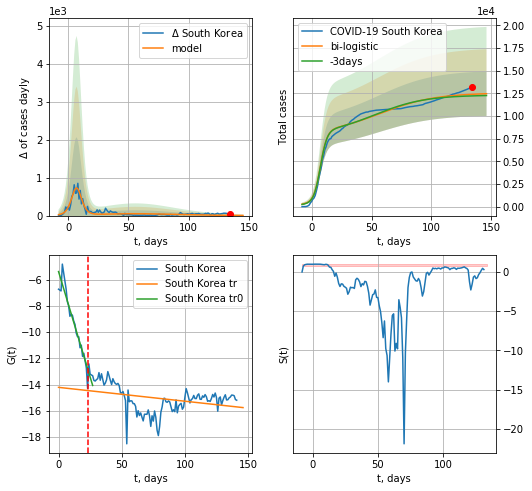

South Korea data at: 2020-07-06
+3 day model MAPE: 0.01476584579530309
model: bi-logistic
coeffs:  [4.62235002e+03 4.30817459e-02 5.62335474e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.1968150168148733
forecast at the end of period: +12 days
	 deltaDaycases:  4
	 total cases:  12468 ± 2454
	 total death:  269 ± 158
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.117803
 intercept: -14.209294
 slope: -0.010556


In [157]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*16-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,16*7-dT,x,1.0,vL=23)

In [158]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

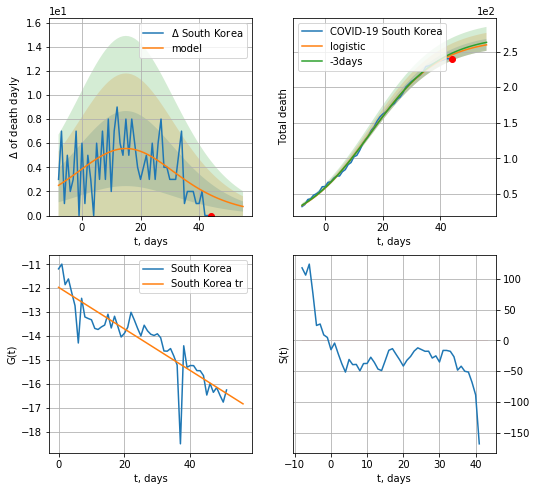

South Korea data at: 2020-07-06
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +12 days
	 total death:  259 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


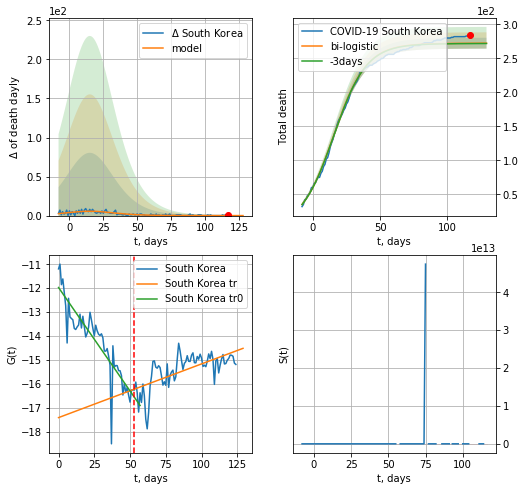

South Korea data at: 2020-07-06
+3 day model MAPE: 0.0016987126933115495
model: bi-logistic
coeffs:  [ 4.1788509   0.0226373  10.33876061] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.029303545302459967
forecast at the end of period: +12 days
	 deltaDaydeath:  0
	 total death:  272 ± 7
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.438316
 intercept: -17.412949
 slope: 0.022452


In [159]:
x = forecast('South Korea',dfKR[17:70],d1,16*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,16*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


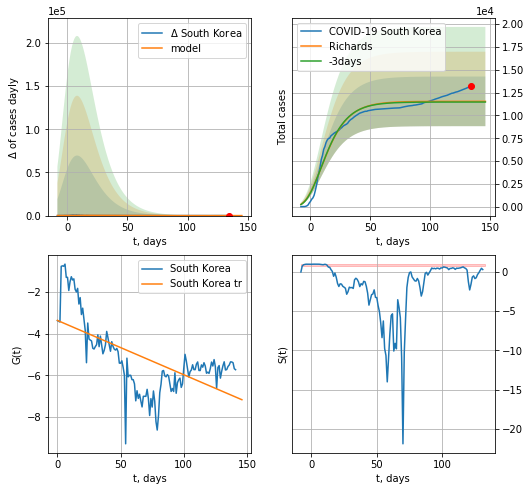

South Korea data at: 2020-07-06
+3 day model MAPE: 0.006525
model: Richards
coeffs: [ 1.15371227e+04  2.64866177e+01 -6.52936274e+01  2.96721309e-03]
rational stdev: 0.235136
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 11536 ± 2712
	 total death: 249 ± 175
trend coefficient of determination: 0.388341
 intercept: -3.368928
 slope: -0.026025


In [160]:
x = forecastRR('South Korea',dfKR[:],d1,16*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


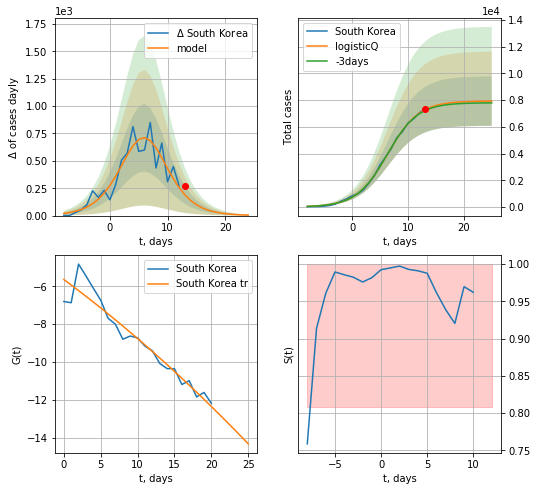

South Korea data at: 2020-07-06
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +12 days
	 deltaDaycases: 4
	 total cases: 7926 ± 1851
	 total death: 171 ± 119
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


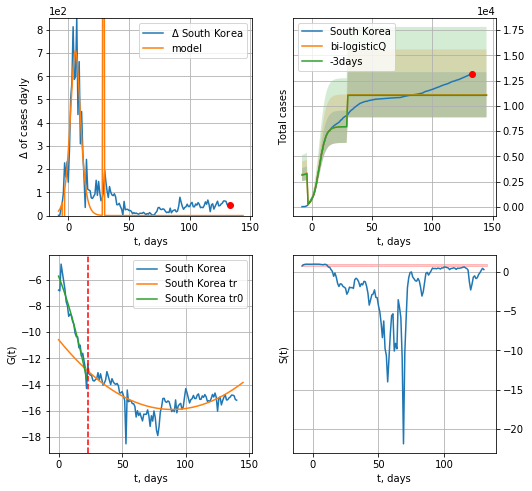

South Korea data at: 2020-07-06
+3 day model MAPE: 0.005228
model: bi-logisticQ
coeffs: [3160.63816042   12.00949911   29.71295619   -3.84065867]
rational stdev: 0.201642
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 11097 ± 2237
	 total death: 239 ± 144
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.540232
 intercept_: -10.57632718693135
 coeffs_: [ 0.         -0.11903077  0.00066592]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [161]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [162]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


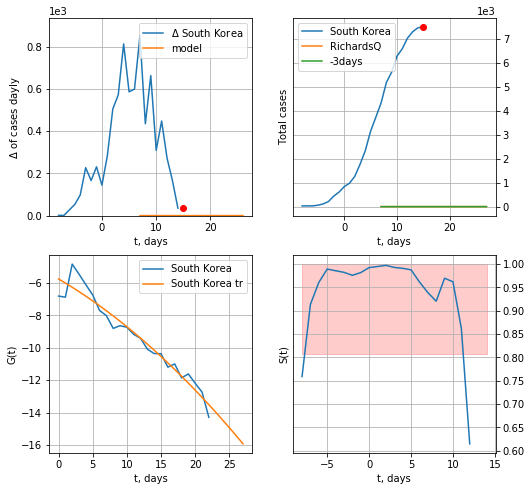

South Korea data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +12 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [163]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


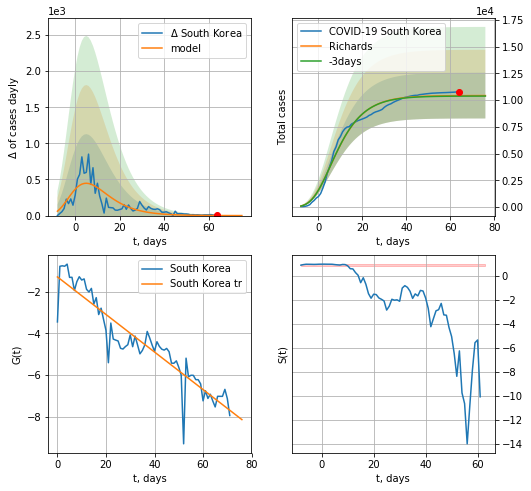

South Korea data at: 2020-07-06
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 10429 ± 2143
	 total death: 225 ± 138
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


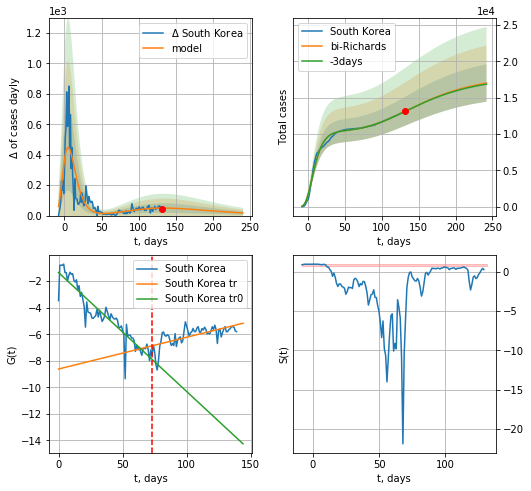

South Korea data at: 2020-07-06
+3 day model MAPE: 0.001133
model: bi-Richards
coeffs: [ 7.65280486e+03  1.64961690e+00 -1.22996021e+02  1.07006240e-02]
rational stdev: 0.151152
forecast at the end of period: +110 days
	 deltaDaycases: 17
	 total cases: 17027 ± 2573
	 total death: 368 ± 166
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865895
 intercept: -1.355505
 slope: -0.089569
trend coefficient of determination: 0.436821
 intercept: -8.619572
 slope: 0.023935


In [164]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,16*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [165]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


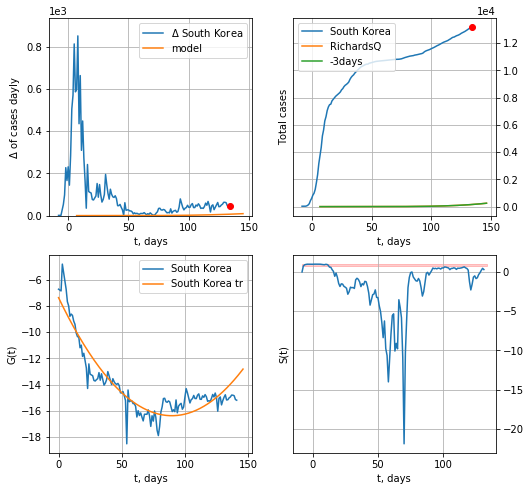

South Korea data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +12 days
	 deltaDaycases: 9


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [166]:
x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
161 2020-07-02  44310.5    4855   26.0
162 2020-07-03  44479.0    4684   26.0
163 2020-07-04  44664.0    4521   26.0
164 2020-07-05  44983.0    4516   26.0
165 2020-07-06  45140.0    4397   26.0


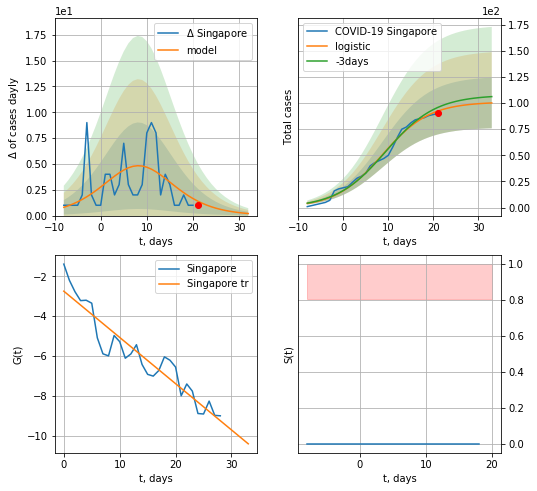

Singapore data at: 2020-07-06
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  100 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


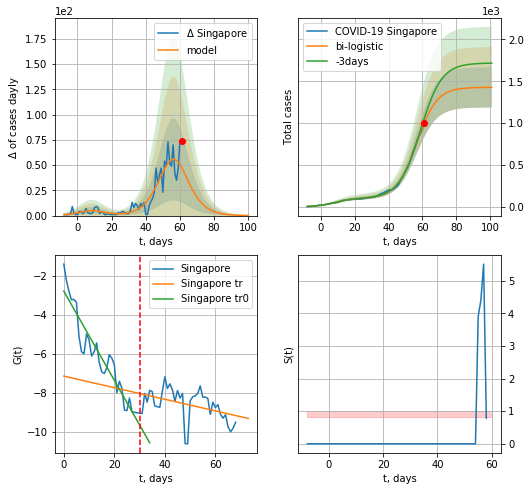

Singapore data at: 2020-07-06
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +40 days
	 deltaDaycases:  0
	 total cases:  1427 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


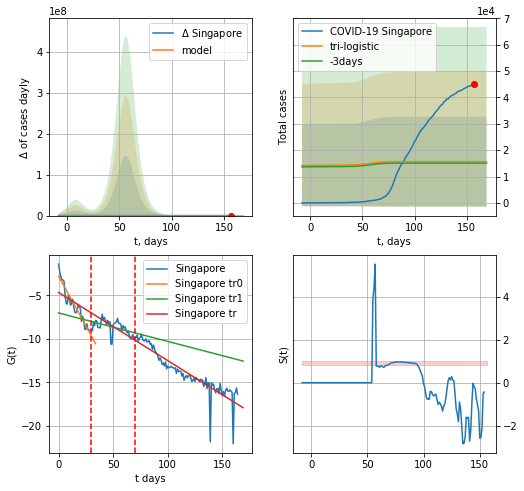

Singapore data at: 2020-07-06
+3 day model MAPE: 0.035668401659882394
model: tri-logistic
coeffs:  [ 1.42199646e+04 -9.63152728e+00  2.38043842e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  1.0886490984750707
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  15647 ± 17035
	 total death:  9 ± 29
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.814273
 intercept: -4.652848
 slope: -0.078512


In [167]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


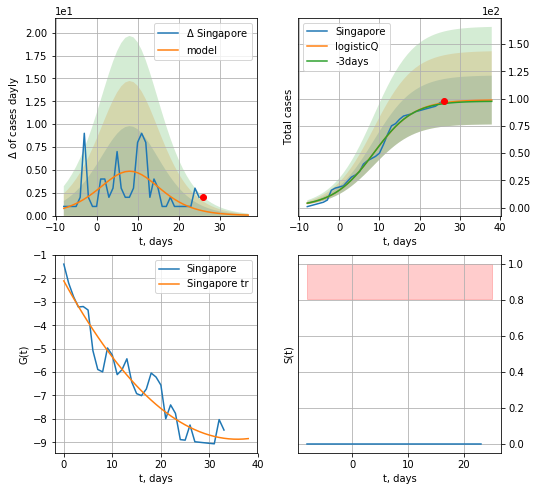

Singapore data at: 2020-07-06
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


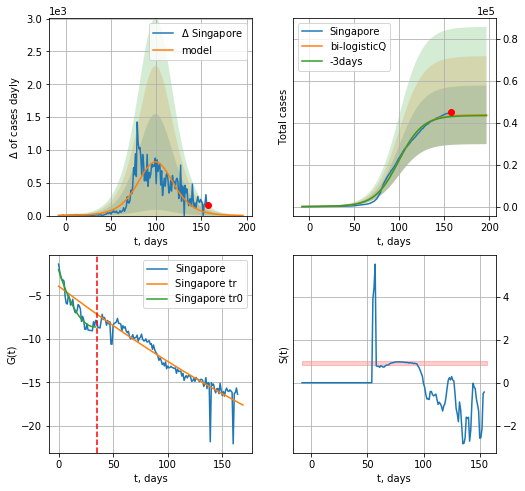

Singapore data at: 2020-07-06
+3 day model MAPE: 0.007948
model: bi-logisticQ
coeffs: [ 4.36820669e+04  2.79437480e-07  9.97227111e+01 -2.67961881e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319223
forecast at the end of period: +40 days
	 deltaDaycases: 2
	 total cases: 43753 ± 13966
	 total death: 25 ± 23
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.903727
 intercept_: -3.91886869018939
 coeffs_: [ 0.00000000e+00 -9.50411385e-02  8.24946447e-05]


In [168]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [169]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

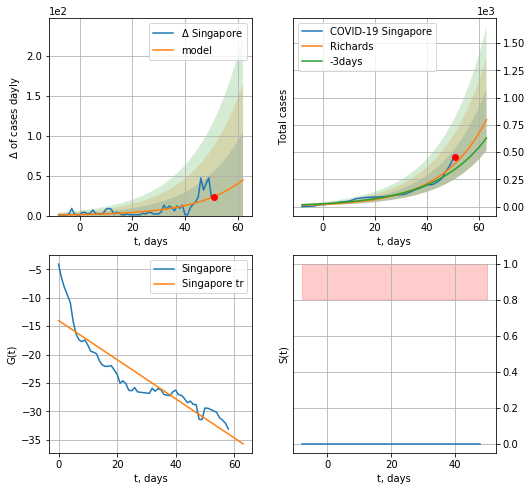

Singapore data at: 2020-07-06
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +12 days
	 deltaDaycases: 44
	 total cases: 798 ± 283
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


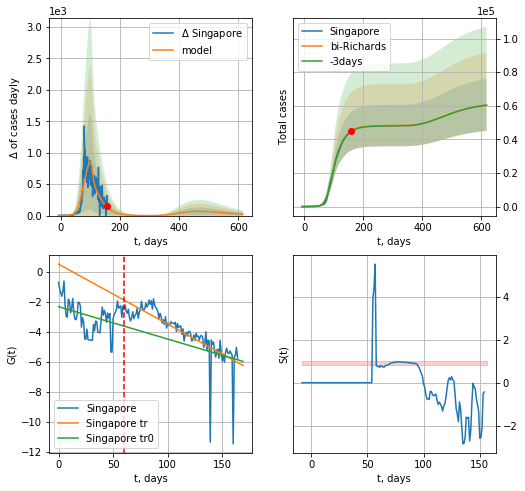

Singapore data at: 2020-07-06
+3 day model MAPE: 0.002725
model: bi-Richards
coeffs: [ 3.89185870e+04  4.90842047e+00 -2.89427649e+01  7.86333439e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.255754
forecast at the end of period: +460 days
	 deltaDaycases: 22
	 total cases: 60500 ± 15473
	 total death: 34 ± 26
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.125263
 intercept: -2.318966
 slope: -0.021614
trend coefficient of determination: 0.623074
 intercept: 0.525472
 slope: -0.040057


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


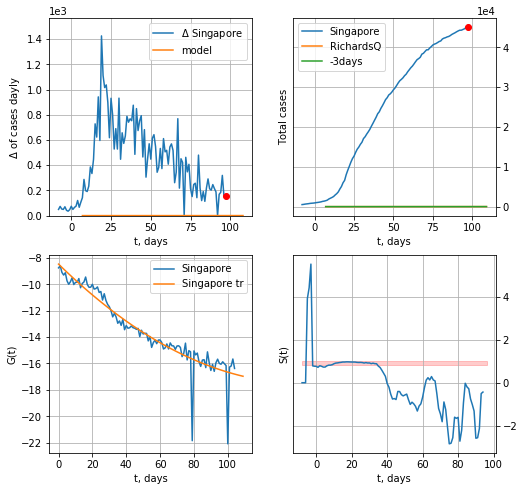

Singapore data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 9.75970661e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +12 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [170]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,16*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
112 2020-07-02  1990.5      79   69.0
113 2020-07-03  1991.0      63   69.0
114 2020-07-04  1993.0      54   69.0
115 2020-07-05  1994.0      50   69.0
116 2020-07-06  1995.0      46   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


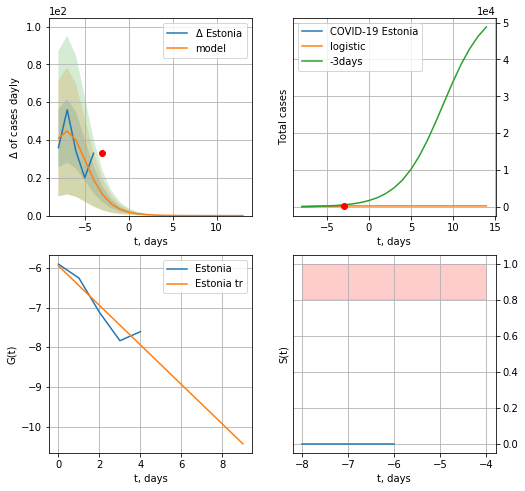

Estonia data at: 2020-07-06
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


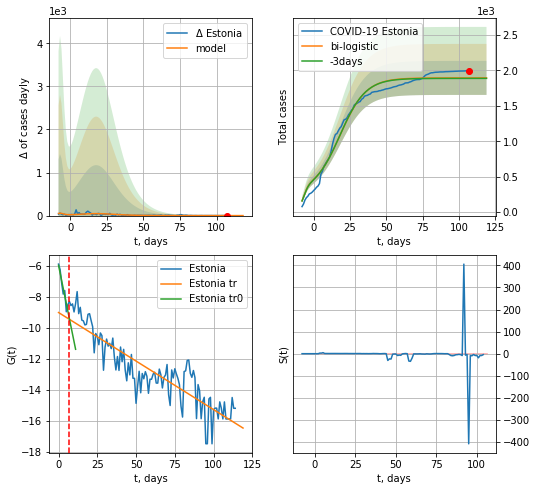

Estonia data at: 2020-07-06
+3 day model MAPE: 0.0034718186443471605
model: bi-logistic
coeffs:  [1.61528430e+03 1.11649685e-01 1.81689477e+01] [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.1265693978969679
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1892 ± 239
	 total death:  65 ± 24
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.781419
 intercept: -9.026097
 slope: -0.062546


In [171]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

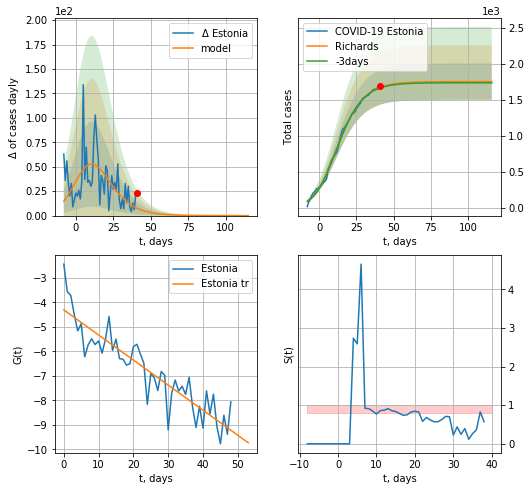

Estonia data at: 2020-07-06
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +75 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 60 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


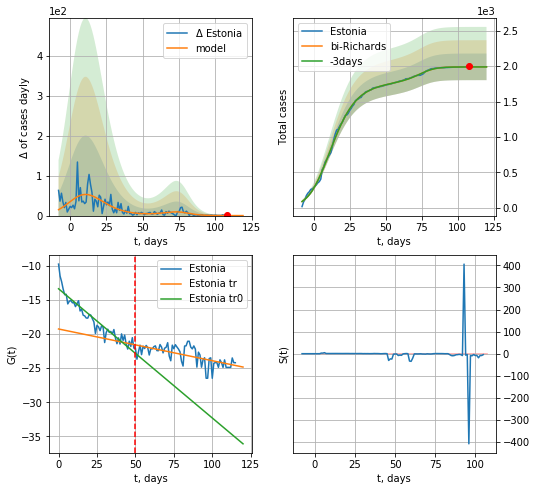

Estonia data at: 2020-07-06
+3 day model MAPE: 0.000675
model: bi-Richards
coeffs: [2.40340364e+02 9.28231421e-02 7.77016956e+01 2.18587615e+00]
rational stdev: 0.094452
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1990 ± 187
	 total death: 68 ± 19
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.888499
 intercept: -13.384467
 slope: -0.189114
trend coefficient of determination: 0.418020
 intercept: -19.272753
 slope: -0.046410


In [172]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*16-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


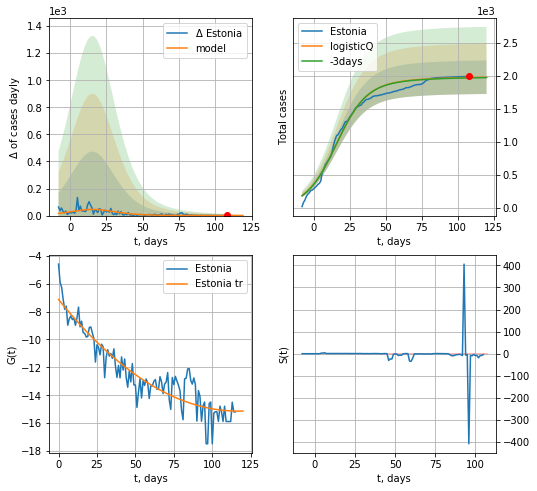

Estonia data at: 2020-07-06
+3 day model MAPE: 0.003015
model: logisticQ
coeffs: [ 1.90323410e+03  1.72576193e-07  1.57377482e+01 -5.50472256e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.128587
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1981 ± 254
	 total death: 68 ± 26
trend coefficient of determination: 0.856546
 intercept_: -7.1311113965864195
 coeffs_: [ 0.         -0.13711545  0.00058696]


In [173]:
x = forecastRRR('Estonia',dfES[:],d1,7*16-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
117 2020-07-02  1122.0     104   30.0
118 2020-07-03  1122.1      95   30.0
119 2020-07-04  1123.0      93   30.0
120 2020-07-05  1127.0      97   30.0
121 2020-07-06  1134.0      96   30.0


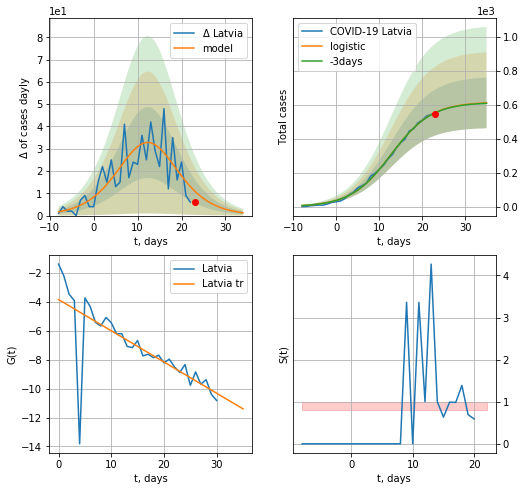

Latvia data at: 2020-07-06
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +12 days
	 deltaDaycases:  1
	 total cases:  610 ± 148
	 total death:  16 ± 11
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


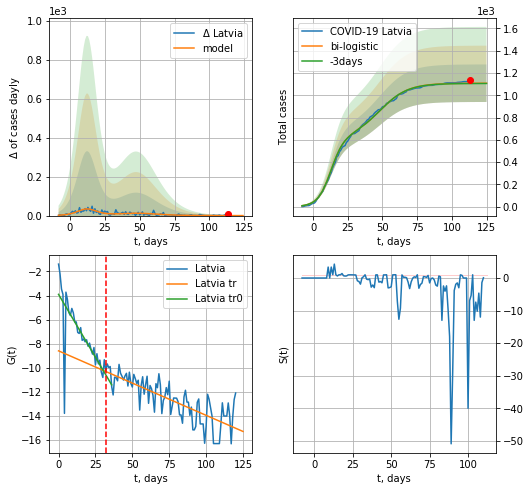

Latvia data at: 2020-07-06
+3 day model MAPE: 0.0021356011671368334
model: bi-logistic
coeffs:  [4.92028018e+02 9.86042812e-02 4.81270475e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.15196851286525143
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1107 ± 168
	 total death:  29 ± 13
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.613413
 intercept: -8.608308
 slope: -0.053692


In [174]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,16*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


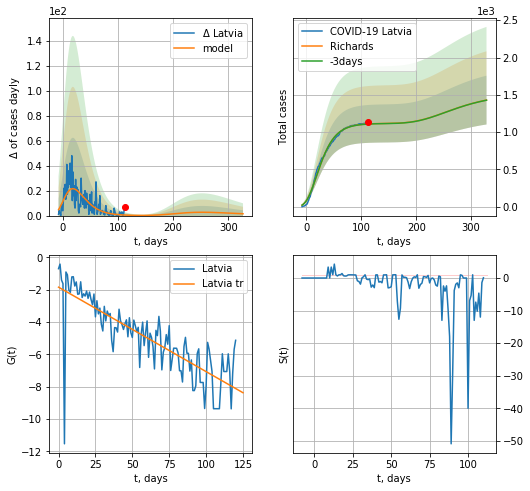

Latvia data at: 2020-07-06
+3 day model MAPE: 0.001685
model: Richards
coeffs: [ 1.11752343e+03  9.46555070e+00 -8.04438885e+01  5.54919631e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.228806
forecast at the end of period: +215 days
	 deltaDaycases: 1
	 total cases: 1429 ± 327
	 total death: 37 ± 25
trend coefficient of determination: 0.651742
 intercept: -1.841324
 slope: -0.052211


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


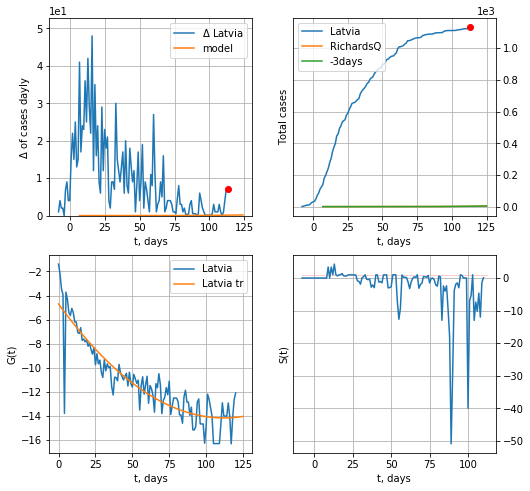

Latvia data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.14660905e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +12 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [175]:
x = forecastRR('Latvia',dfLV[:],d1,7*45-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


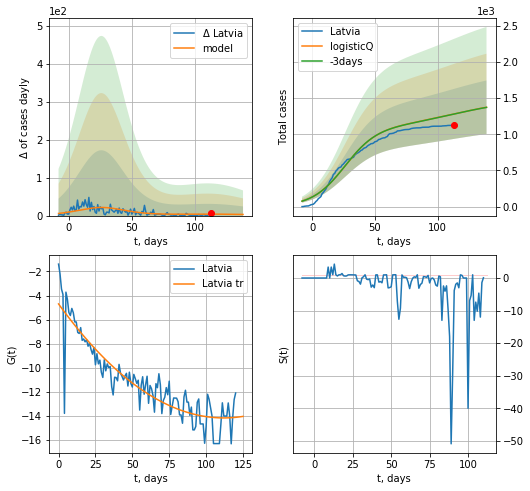

Latvia data at: 2020-07-06
+3 day model MAPE: 0.001333
model: logisticQ
coeffs: [ 1.09150818e+03  1.74485598e-07  2.60879868e+01 -4.42089865e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.269505
forecast at the end of period: +26 days
	 deltaDaycases: 3
	 total cases: 1372 ± 369
	 total death: 36 ± 29
trend coefficient of determination: 0.817645
 intercept_: -4.70292071345099
 coeffs_: [ 0.         -0.16943833  0.00075635]


In [176]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


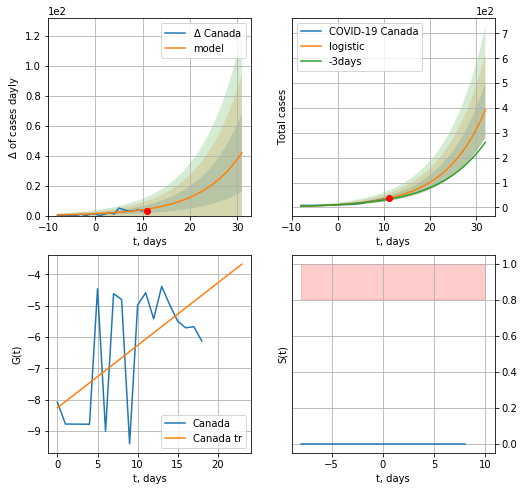

Canada data at: 2020-07-06
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


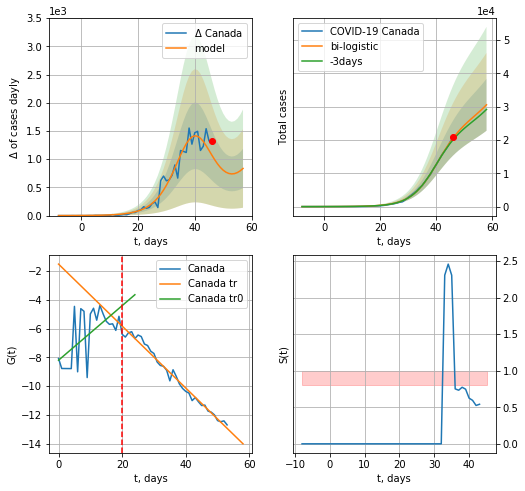

Canada data at: 2020-07-06
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +12 days
	 deltaDaycases:  835
	 total cases:  30568 ± 7792
	 total death:  2508 ± 1918
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


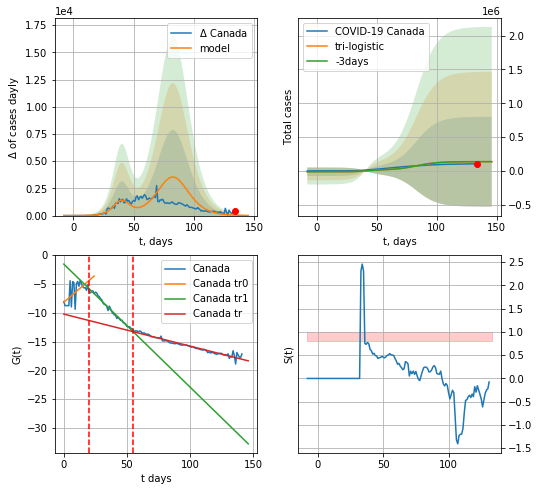

Canada data at: 2020-07-06
+3 day model MAPE: 0.0047726046999185985
model: tri-logistic
coeffs:  [-1.28582985e+04  1.65536425e+00 -2.72584397e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  4.8661074628498335
forecast at the end of period: +12 days
	 deltaDaycases:  11
	 total cases:  136398 ± 663730
	 total death:  11192 ± 163384
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.956994
 intercept: -10.247185
 slope: -0.055532


In [177]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,16*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
138 2020-07-02  104772.0   27783  8642.0
139 2020-07-03  105091.0   27735  8663.0
140 2020-07-04  105317.0   27653  8674.0
141 2020-07-05  105536.0   27613  8684.0
142 2020-07-06  105935.0   27672  8693.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


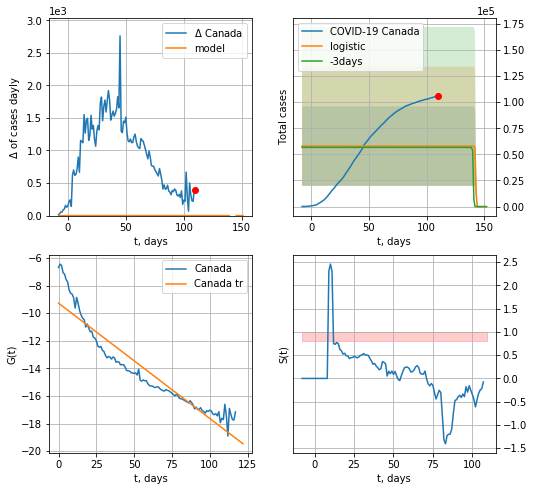

Canada data at: 2020-07-06
+3 day model MAPE: 0.021738089176226133
model: logistic
coeffs:  [ 5.79352185e+04 -4.80977142e+00  1.42744549e+02]
rational stdev:  0.6564890174977858
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.891021
 intercept: -9.275429
 slope: -0.083522


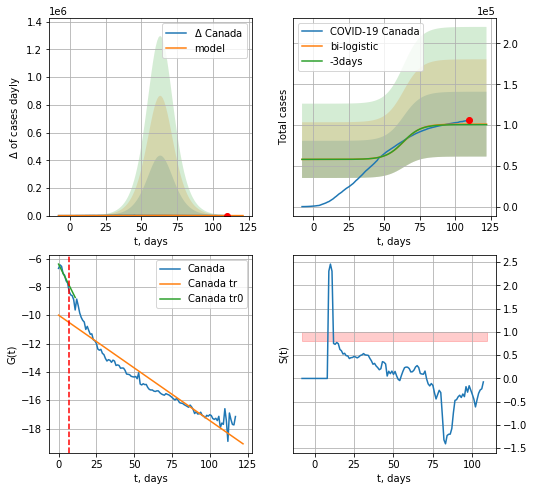

Canada data at: 2020-07-06
+3 day model MAPE: 0.006478082790544086
model: bi-logistic
coeffs:  [4.31634768e+04 1.59579565e-01 6.35960506e+01] [ 5.79352185e+04 -4.80977142e+00  1.42744549e+02]
rational stdev:  0.3927286061723298
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  101094 ± 39702
	 total death:  8295 ± 9773
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.912534
 intercept: -9.994467
 slope: -0.074460


In [178]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,16*7-dT,x,1.,vL=31-24,cases='cases')

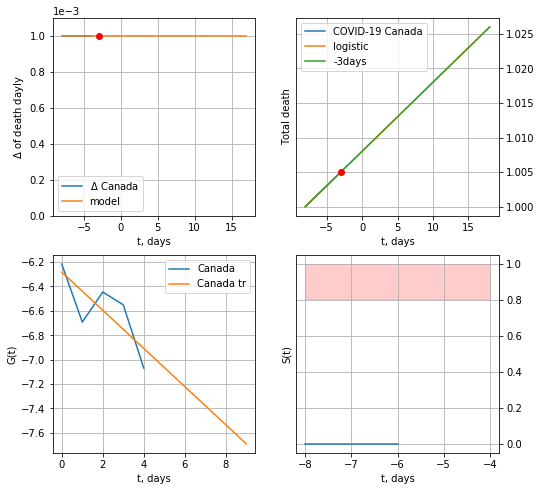

Canada data at: 2020-07-06
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


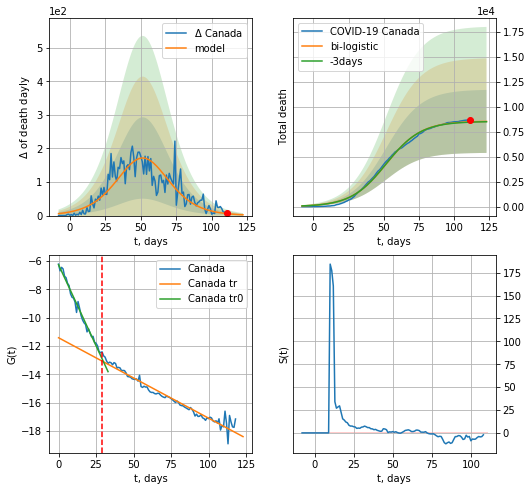

Canada data at: 2020-07-06
+3 day model MAPE: 0.0037305699295423407
model: bi-logistic
coeffs:  [8.57096984e+03 8.01305457e-02 5.17773579e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3697678009226463
forecast at the end of period: +12 days
	 deltaDaydeath:  2
	 total death:  8543 ± 3159
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.958473
 intercept: -11.416314
 slope: -0.056747


In [179]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,16*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


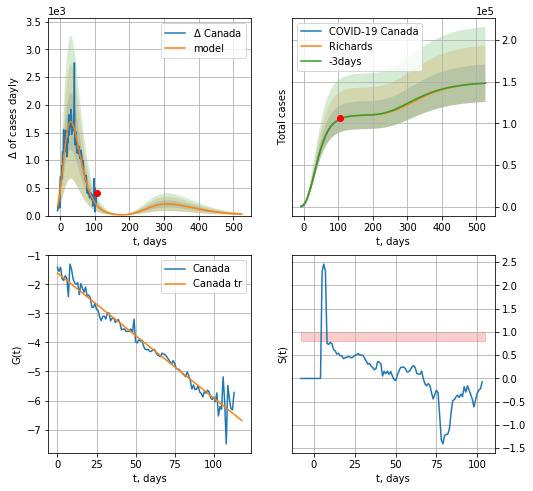

Canada data at: 2020-07-06
+3 day model MAPE: 0.000771
model: Richards
coeffs: [ 1.09998219e+05  3.53047904e+00 -7.36495672e+01  1.19594037e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.151748
forecast at the end of period: +420 days
	 deltaDaycases: 24
	 total cases: 148115 ± 22476
	 total death: 12154 ± 5533
trend coefficient of determination: 0.967849
 intercept: -1.611225
 slope: -0.043031


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


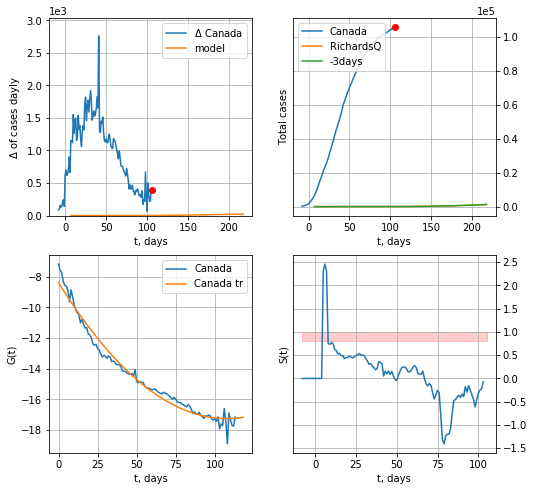

Canada data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 6.29625328e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +112 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [180]:
x = forecastRR('Canada',dfCA[28:],d1,60*7,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


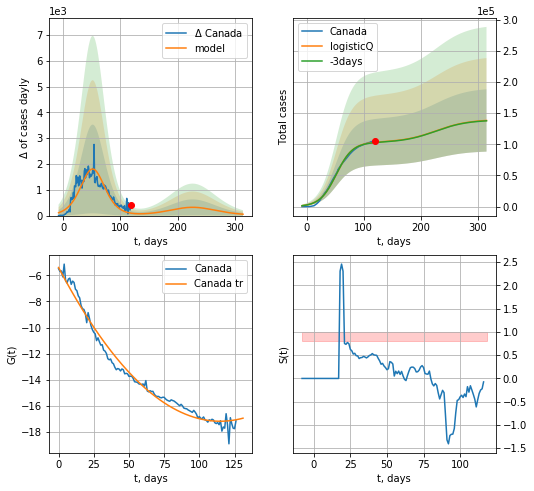

Canada data at: 2020-07-06
+3 day model MAPE: 0.004692
model: logisticQ
coeffs: [ 1.03316702e+05  3.06568510e-07  5.19632518e+01 -2.27839309e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361882
forecast at the end of period: +196 days
	 deltaDaycases: 53
	 total cases: 138347 ± 50065
	 total death: 11352 ± 12324
trend coefficient of determination: 0.983096
 intercept_: -5.402974377305021
 coeffs_: [ 0.         -0.20517826  0.00089386]


In [181]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
122 2020-07-02  42782   13098  1587.0
123 2020-07-03  43156   13134  1598.0
124 2020-07-04  43569   13192  1605.0
125 2020-07-05  43897   13266  1614.0
126 2020-07-06  44129   13343  1620.0


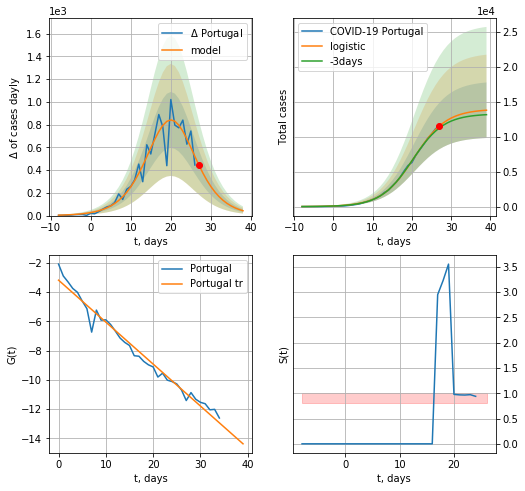

Portugal data at: 2020-07-06
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +12 days
	 deltaDaycases:  42
	 total cases:  13785 ± 3971
	 total death:  506 ± 437
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


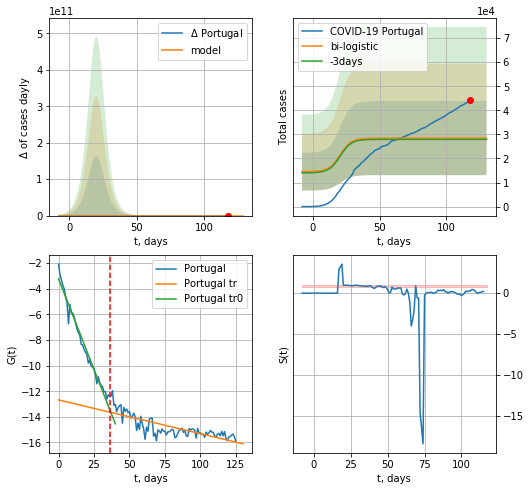

Portugal data at: 2020-07-06
+3 day model MAPE: 0.01980087165530083
model: bi-logistic
coeffs:  [ 1.16330991e+04 -4.64857561e+00  3.75962703e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5404726357764794
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  28484 ± 15395
	 total death:  1045 ± 1694
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.612128
 intercept: -12.679915
 slope: -0.026344


In [182]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,16*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


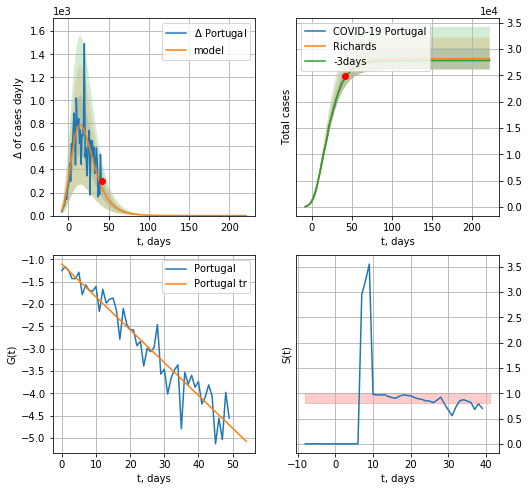

Portugal data at: 2020-07-06
+3 day model MAPE: 0.006186
model: Richards
coeffs: [ 2.81616178e+04  5.39214197e+00 -4.03941749e+01  1.41510332e-02]
rational stdev: 0.071740
forecast at the end of period: +180 days
	 deltaDaycases: 0
	 total cases: 28161 ± 2020
	 total death: 1033 ± 222
trend coefficient of determination: 0.913504
 intercept: -1.105984
 slope: -0.073555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


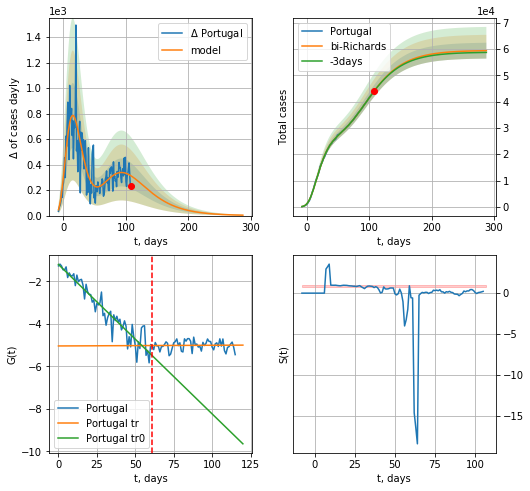

Portugal data at: 2020-07-06
+3 day model MAPE: 0.001601
model: bi-Richards
coeffs: [ 3.13341133e+04  1.58317122e+00 -4.24867285e+01  1.83971513e-02]
rational stdev: 0.050700
forecast at the end of period: +180 days
	 deltaDaycases: 3
	 total cases: 59383 ± 3010
	 total death: 2180 ± 331
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.904461
 intercept: -1.201651
 slope: -0.070321
trend coefficient of determination: 0.000555
 intercept: -5.036662
 slope: 0.000323


In [183]:
vL=61+10
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


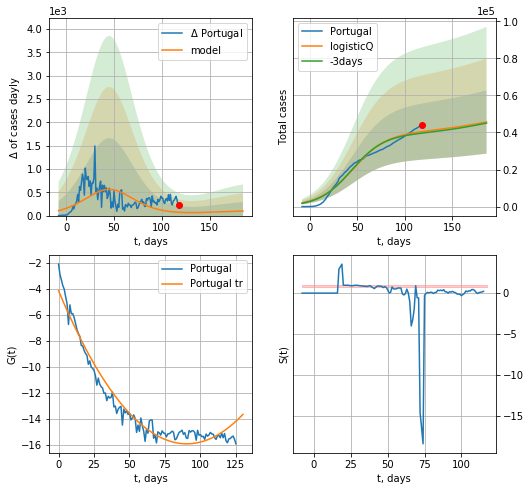

Portugal data at: 2020-07-06
+3 day model MAPE: 0.020838
model: logisticQ
coeffs: [ 3.97858866e+04  1.02872523e-07  4.53124855e+01 -5.44870098e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.374191
forecast at the end of period: +68 days
	 deltaDaycases: 97
	 total cases: 45683 ± 17094
	 total death: 1677 ± 1882
trend coefficient of determination: 0.957533
 intercept_: -4.1353531271037145
 coeffs_: [ 0.         -0.26144032  0.00144707]


In [184]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

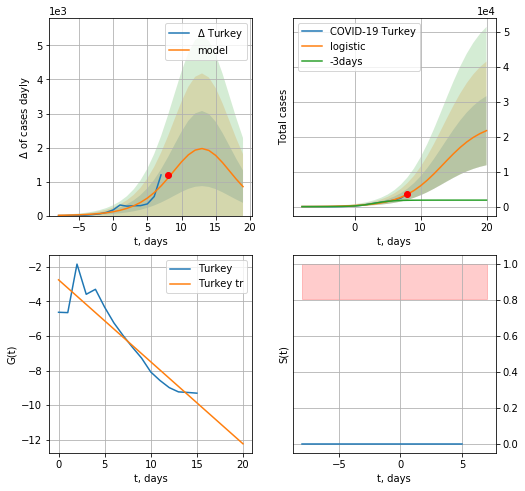

Turkey data at: 2020-07-06
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +12 days
	 deltaDaycases:  850
	 total cases:  21693 ± 9875
	 total death:  549 ± 749
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


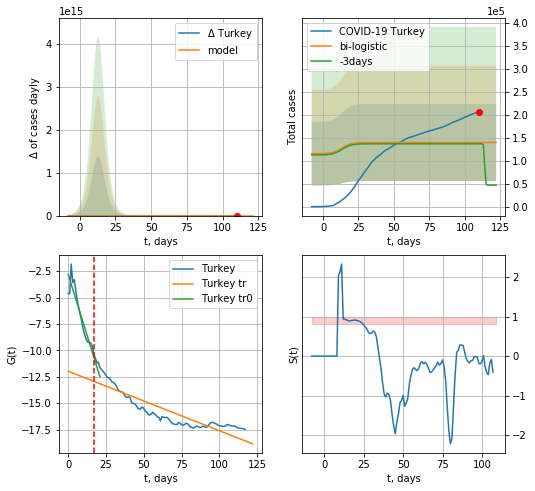

Turkey data at: 2020-07-06
+3 day model MAPE: 0.021104967002183898
model: bi-logistic
coeffs:  [ 9.22542225e+04 -3.98768779e+00  9.57321339e+02] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6009663602371976
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  139584 ± 83885
	 total death:  3536 ± 6375
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.778316
 intercept: -11.979214
 slope: -0.056336


In [185]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*16-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,16*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


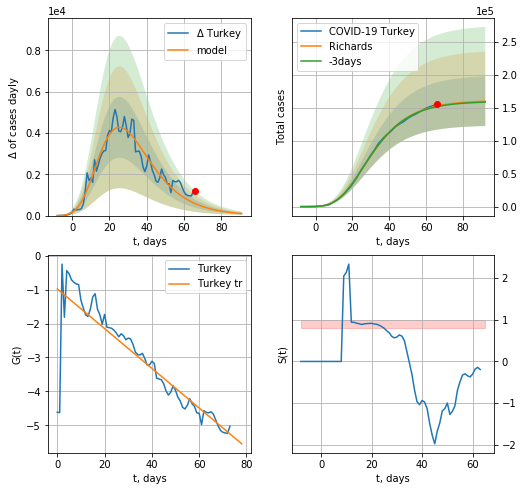

Turkey data at: 2020-07-06
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +26 days
	 deltaDaycases: 98
	 total cases: 159916 ± 37591
	 total death: 4051 ± 2856
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


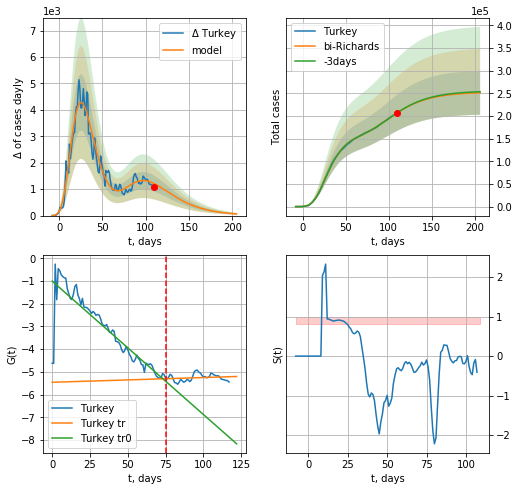

Turkey data at: 2020-07-06
+3 day model MAPE: 0.001246
model: bi-Richards
coeffs: [ 9.14180362e+04  2.37126092e+00 -8.78699793e+00  1.60202766e-02]
rational stdev: 0.192945
forecast at the end of period: +96 days
	 deltaDaycases: 62
	 total cases: 251034 ± 48435
	 total death: 6360 ± 3681
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.784163
 intercept: -1.004400
 slope: -0.058689
trend coefficient of determination: 0.028425
 intercept: -5.455992
 slope: 0.002095


In [186]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


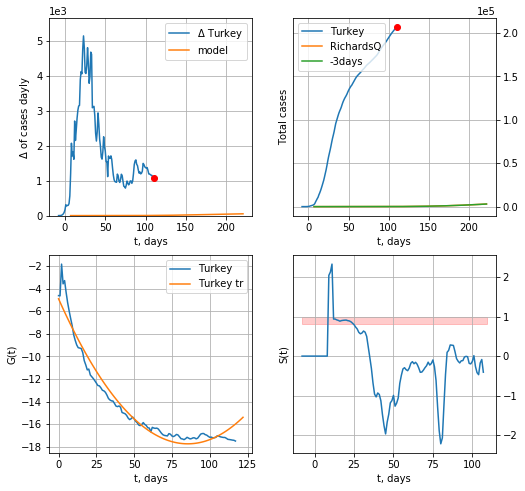

Turkey data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.40696826e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +112 days
	 deltaDaycases: 50


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [187]:
x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


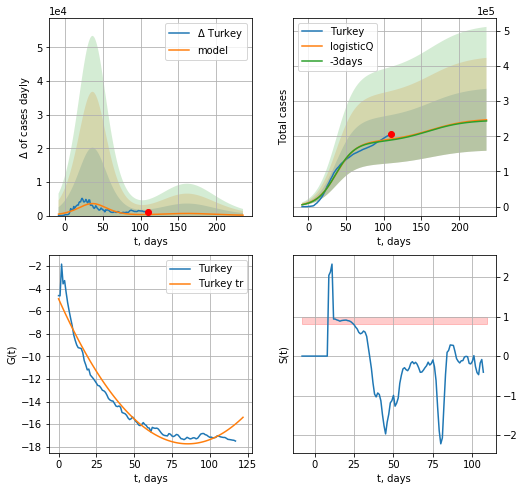

Turkey data at: 2020-07-06
+3 day model MAPE: 0.013786
model: logisticQ
coeffs: [ 1.85046696e+05  1.40053941e-07  3.71197861e+01 -5.47829423e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.356773
forecast at the end of period: +126 days
	 deltaDaycases: 131
	 total cases: 247050 ± 88141
	 total death: 6259 ± 6699
trend coefficient of determination: 0.955460
 intercept_: -4.906449218296414
 coeffs_: [ 0.         -0.30027109  0.00175697]


In [188]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [189]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.026455026455026454

In [190]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
120 2020-07-02  35146.0   11445  1492.0
121 2020-07-03  35405.0   11247  1507.0
122 2020-07-04  35719.0   11080  1512.0
123 2020-07-05  36155.0   10668  1521.0
124 2020-07-06  36155.0   10668  1521.0


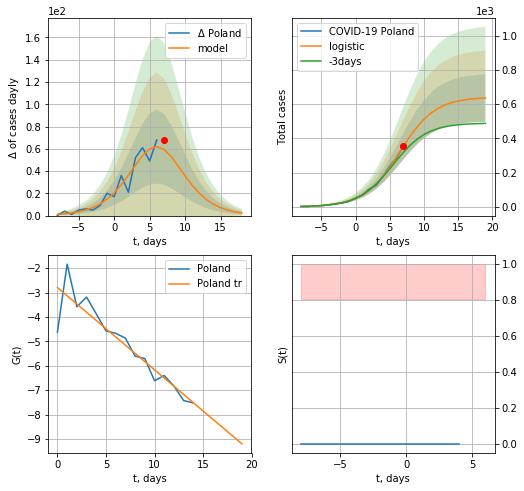

Poland data at: 2020-07-06
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +12 days
	 deltaDaycases:  2
	 total cases:  636 ± 138
	 total death:  26 ± 16
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

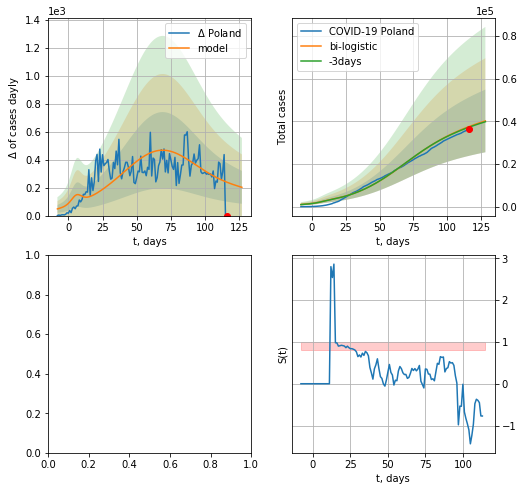

In [192]:
vL=16
vL1=38
dfPL = read_df(pd.DataFrame(),"PL")
x =  forecast('Poland',dfPL[:vL],d1,7*16-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,16*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


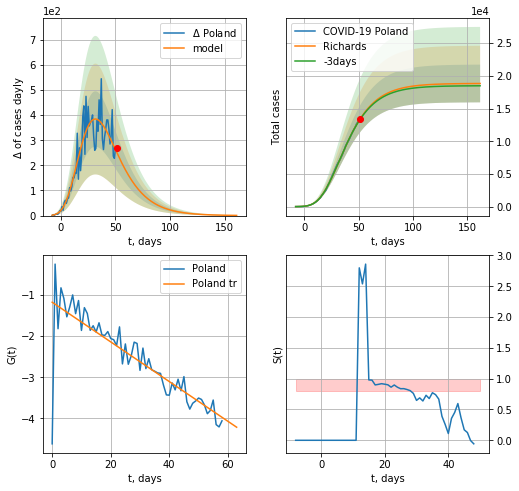

Poland data at: 2020-07-05
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 18828 ± 2884
	 total death: 792 ± 364
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


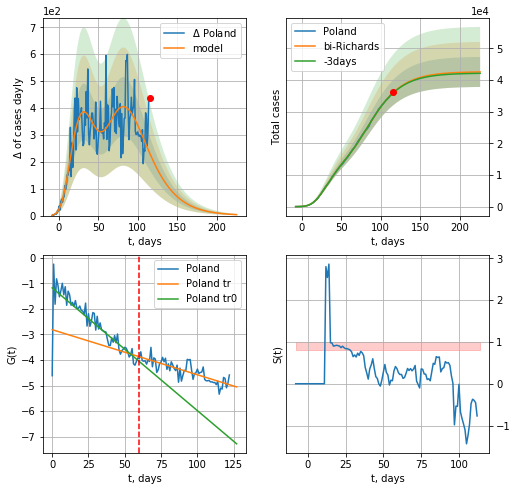

Poland data at: 2020-07-05
+3 day model MAPE: 0.002982
model: bi-Richards
coeffs: [ 2.37932871e+04  2.49415170e+00 -1.37976501e+01  1.63075291e-02]
rational stdev: 0.111451
forecast at the end of period: +111 days
	 deltaDaycases: 3
	 total cases: 42550 ± 4742
	 total death: 1790 ± 598
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.717698
 intercept: -1.180974
 slope: -0.048018
trend coefficient of determination: 0.664902
 intercept: -2.815346
 slope: -0.017639


In [612]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


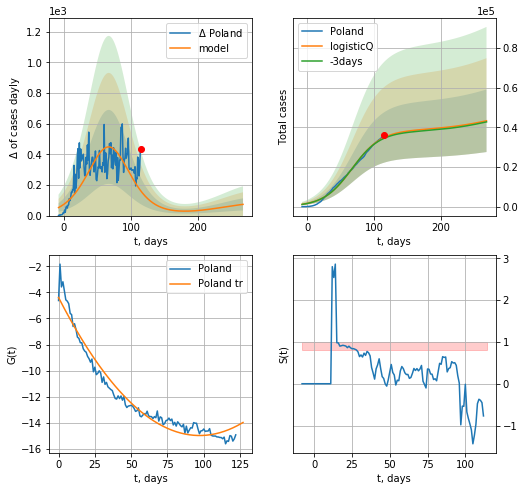

Poland data at: 2020-07-05
+3 day model MAPE: 0.011985
model: logisticQ
coeffs: [ 3.84107326e+04  2.46606390e-07  6.71609372e+01 -1.88708943e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364380
forecast at the end of period: +153 days
	 deltaDaycases: 73
	 total cases: 43293 ± 15775
	 total death: 1821 ± 1990
trend coefficient of determination: 0.958840
 intercept_: -4.392153211224382
 coeffs_: [ 0.         -0.21771516  0.00112083]


In [613]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
131 2020-07-02  27542.0    9618  325.0
132 2020-07-03  28055.0   10060  326.0
133 2020-07-04  29170.0   11024  330.0
134 2020-07-05  30162.0   11856  332.0
135 2020-07-06  31186.0   12717  338.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


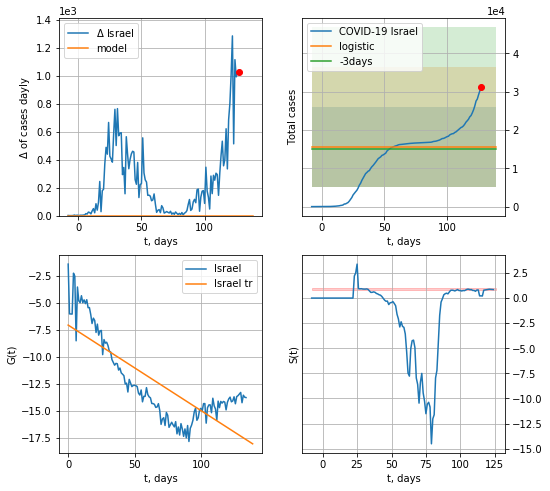

Israel data at: 2020-07-06
+3 day model MAPE: 0.03348024464276753
model: logistic
coeffs:  [ 1.23851035e+04 -5.30274107e+00  1.45562019e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6760383147170206
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  15481 ± 10466
	 total death:  167 ± 338
trend coefficient of determination: 0.629918
 intercept: -7.041728
 slope: -0.079226


In [193]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


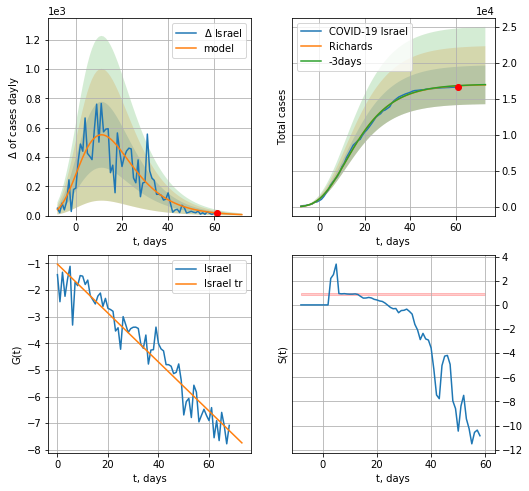

Israel data at: 2020-07-06
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +12 days
	 deltaDaycases: 6
	 total cases: 16977 ± 2685
	 total death: 184 ± 87
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


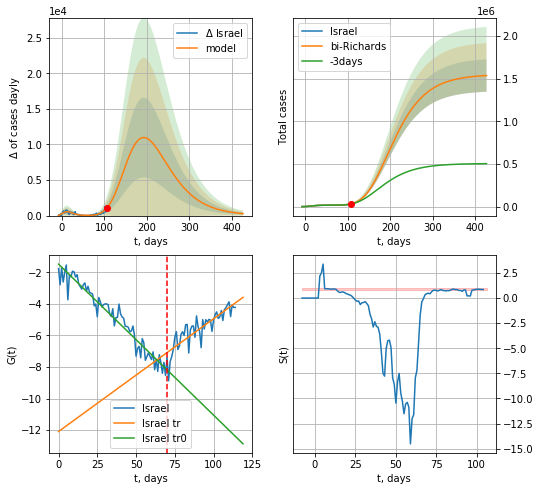

Israel data at: 2020-07-06
+3 day model MAPE: 0.026100
model: bi-Richards
coeffs: [1.53373176e+06 2.58827439e-01 6.66543585e+01 7.80603049e-02]
rational stdev: 0.123646
forecast at the end of period: +320 days
	 deltaDaycases: 273
	 total cases: 1537312 ± 190082
	 total death: 16661 ± 6180
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.937491
 intercept: -1.473950
 slope: -0.095795
trend coefficient of determination: 0.729034
 intercept: -12.093978
 slope: 0.071534


In [194]:
x = forecastRR('Israel',dfIS[20:90],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


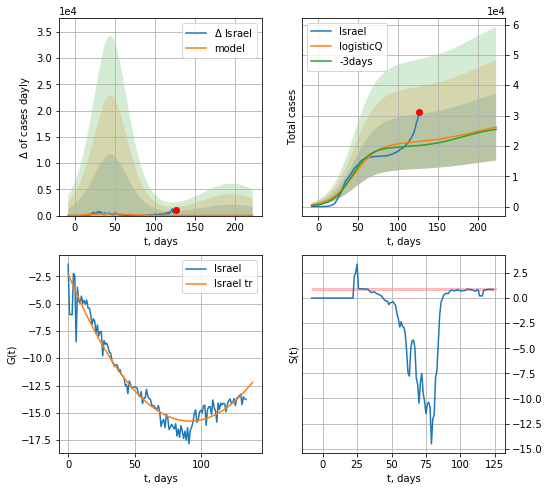

Israel data at: 2020-07-06
+3 day model MAPE: 0.065594
model: logisticQ
coeffs: [ 2.09047029e+04  6.22684330e-08  4.50210742e+01 -1.07664822e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.420757
forecast at the end of period: +96 days
	 deltaDaycases: 51
	 total cases: 26172 ± 11012
	 total death: 283 ± 357
trend coefficient of determination: 0.941144
 intercept_: -2.2962879705505603
 coeffs_: [ 0.         -0.29330882  0.00159764]


In [195]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


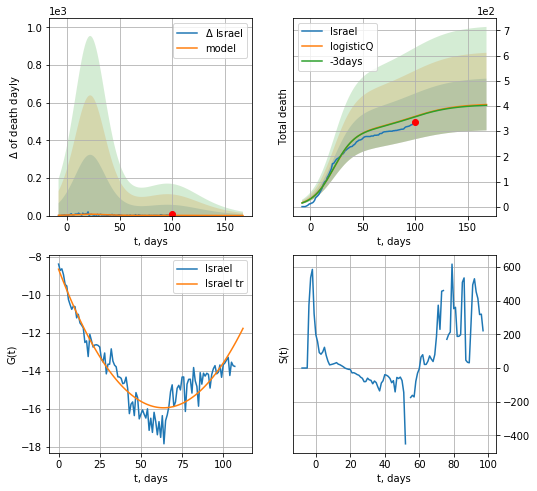

Israel data at: 2020-07-06
+3 day model MAPE: 0.003771
model: logisticQ
coeffs: [ 3.02174193e+02  2.47429689e-07  2.23114688e+01 -3.89226914e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.252856
forecast at the end of period: +68 days
	 total death: 405 ± 102
trend coefficient of determination: 0.889517
 intercept_: -8.651672862008038
 coeffs_: [ 0.         -0.22877817  0.00179443]


In [196]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


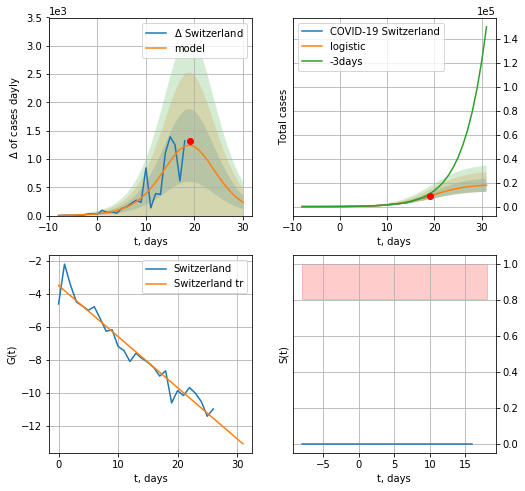

Switzerland data at: 2020-07-06
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +12 days
	 deltaDaycases:  234
	 total cases:  17893 ± 5476
	 total death:  1088 ± 998
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


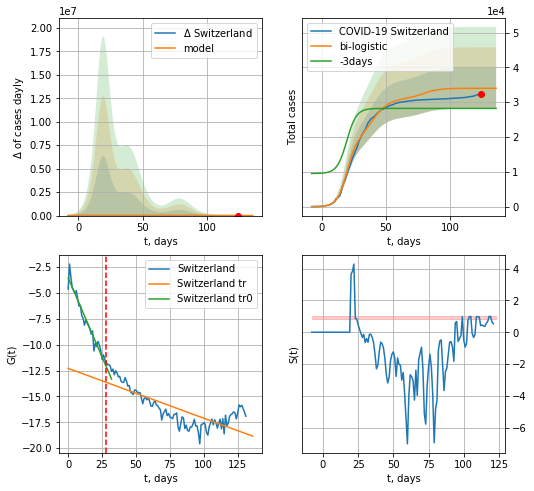

Switzerland data at: 2020-07-06
+3 day model MAPE: 0.20471225955064343
model: bi-logistic
coeffs:  [1.22386812e+04 1.59990934e-01 3.94487288e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.1728788187566345
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  34004 ± 5878
	 total death:  2067 ± 1072
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.619195
 intercept: -12.286346
 slope: -0.048156


In [197]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*16-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*16-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


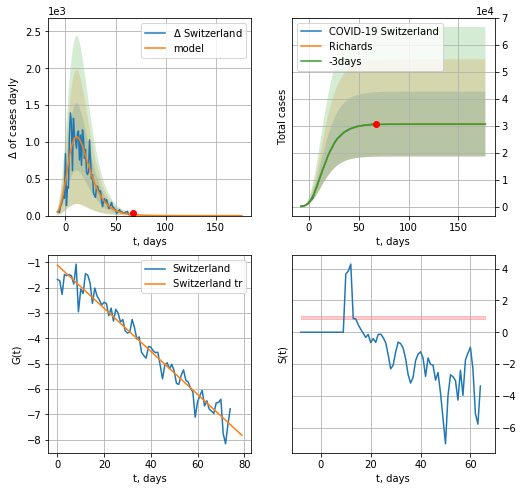

Switzerland data at: 2020-07-06
+3 day model MAPE: 0.000828
model: Richards
coeffs: [ 3.06407782e+04  7.51555694e+00 -3.39977032e+01  1.27179279e-02]
rational stdev: 0.391779
forecast at the end of period: +110 days
	 deltaDaycases: 0
	 total cases: 30640 ± 12004
	 total death: 1863 ± 2189
trend coefficient of determination: 0.957486
 intercept: -1.108794
 slope: -0.084964


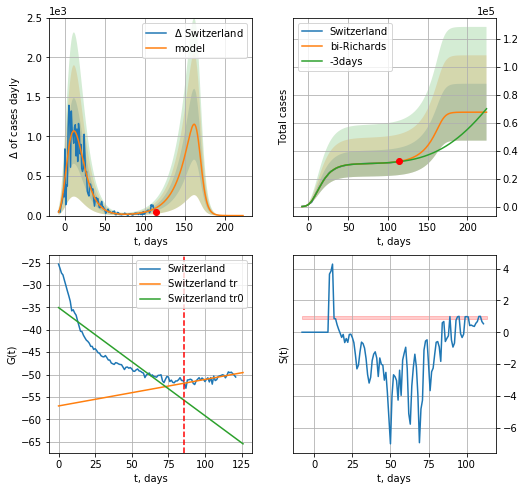

Switzerland data at: 2020-07-06
+3 day model MAPE: 0.006137
model: bi-Richards
coeffs: [3.67946182e+04 5.73442893e-02 1.68244337e+02 4.23913628e+00]
rational stdev: 0.300876
forecast at the end of period: +110 days
	 deltaDaycases: 0
	 total cases: 67435 ± 20289
	 total death: 4100 ± 3700
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.772574
 intercept: -35.022825
 slope: -0.241752
trend coefficient of determination: 0.580142
 intercept: -57.014448
 slope: 0.059254


In [203]:
iL = 10
vL = 86 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


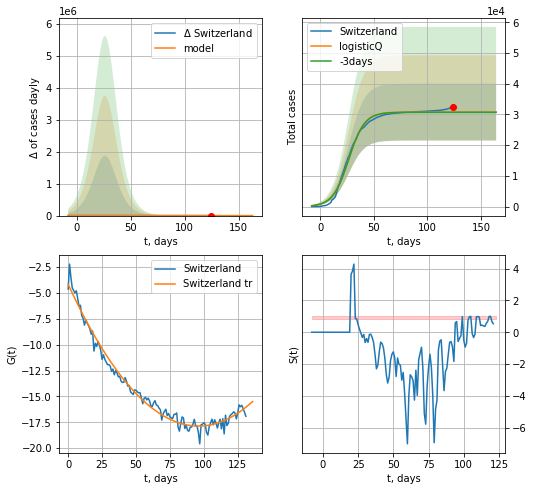

Switzerland data at: 2020-07-06
+3 day model MAPE: 0.002224
model: logisticQ
coeffs: [ 3.07725158e+04  5.08318614e-07  2.65352891e+01 -2.66496268e+05]
rational stdev: 0.300324
forecast at the end of period: +40 days
	 deltaDaycases: 0
	 total cases: 30772 ± 9241
	 total death: 1871 ± 1685
trend coefficient of determination: 0.980497
 intercept_: -4.173210060564401
 coeffs_: [ 0.         -0.28501262  0.00148362]


In [204]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [205]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
114 2020-07-02  45887.0   24649  1185.0
115 2020-07-03  46763.0   24993  1212.0
116 2020-07-04  47677.0   25335  1227.0
117 2020-07-05  49043.0   26078  1262.0
118 2020-07-06  49607.0   26131  1283.0


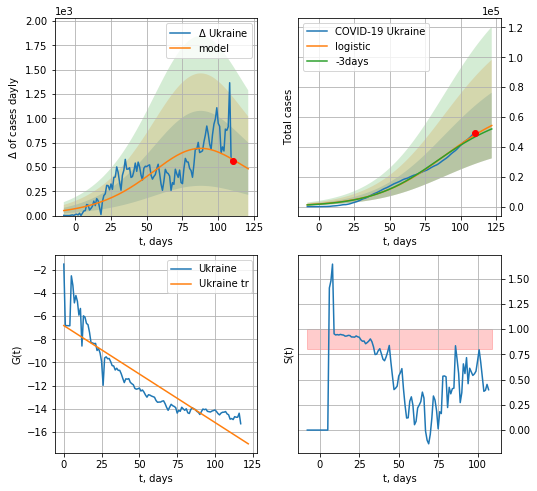

Ukraine data at: 2020-07-06
+3 day model MAPE: 0.030261087630913282
model: logistic
coeffs:  [6.49841614e+04 4.14649007e-02 8.70354215e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.4053567634888243
forecast at the end of period: +12 days
	 deltaDaycases:  481
	 total cases:  54316 ± 22017
	 total death:  1404 ± 1707
trend coefficient of determination: 0.806831
 intercept: -6.813335
 slope: -0.083694


In [206]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


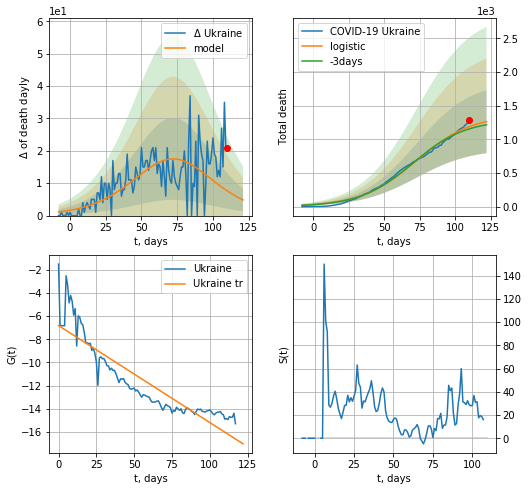

Ukraine data at: 2020-07-06
+3 day model MAPE: 0.02986915258038288
model: logistic
coeffs:  [1.36256930e+03 5.14384887e-02 7.25215096e+01]
rational stdev:  0.3713200999056064
forecast at the end of period: +12 days
	 total death:  1263 ± 469
trend coefficient of determination: 0.806831
 intercept: -6.813335
 slope: -0.083694


In [207]:
x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


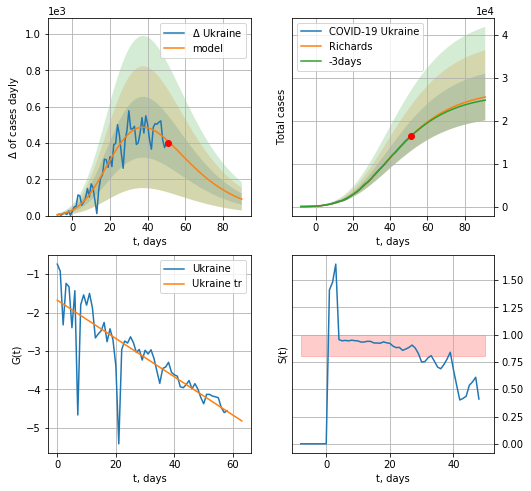

Ukraine data at: 2020-07-06
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +40 days
	 deltaDaycases: 90
	 total cases: 25503 ± 5439
	 total death: 659 ± 421
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


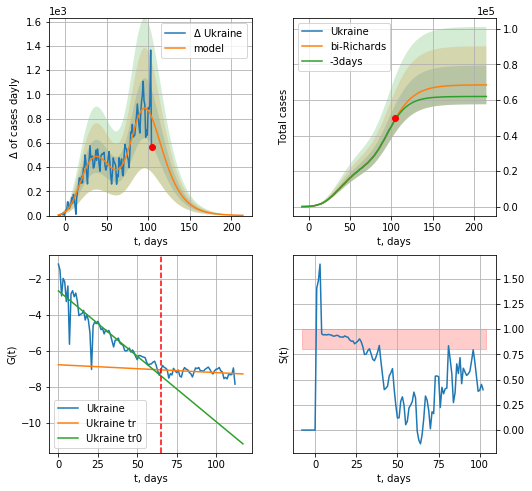

Ukraine data at: 2020-07-06
+3 day model MAPE: 0.010820
model: bi-Richards
coeffs: [4.12236139e+04 2.00618850e-01 7.89349660e+01 3.10578387e-01]
rational stdev: 0.158885
forecast at the end of period: +110 days
	 deltaDaycases: 1
	 total cases: 68507 ± 10884
	 total death: 1771 ± 844
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.832412
 intercept: -2.660155
 slope: -0.072537
trend coefficient of determination: 0.079893
 intercept: -6.758775
 slope: -0.004361


In [208]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


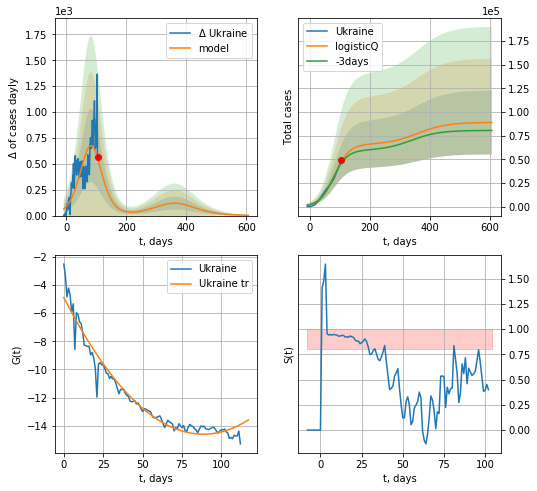

Ukraine data at: 2020-07-06
+3 day model MAPE: 0.034534
model: logisticQ
coeffs: [ 6.56962629e+04  2.84758058e-07  8.26213305e+01 -1.44119831e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379027
forecast at the end of period: +502 days
	 deltaDaycases: 2
	 total cases: 88822 ± 33666
	 total death: 2297 ± 2611
trend coefficient of determination: 0.956711
 intercept_: -4.890551780690263
 coeffs_: [ 0.         -0.21943788  0.00123958]


In [209]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [210]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

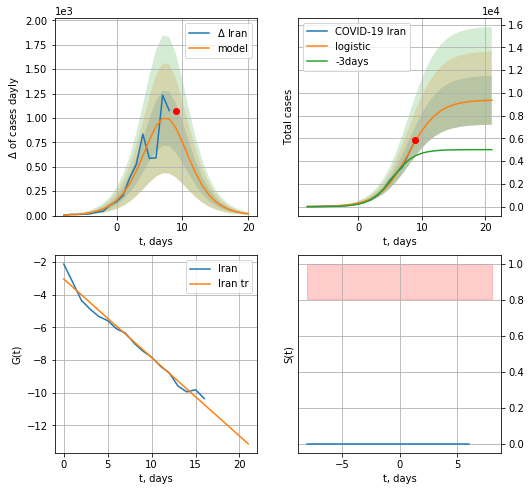

Iran data at: 2020-07-06
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +12 days
	 deltaDaycases:  18
	 total cases:  9351 ± 2148
	 total death:  451 ± 310
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


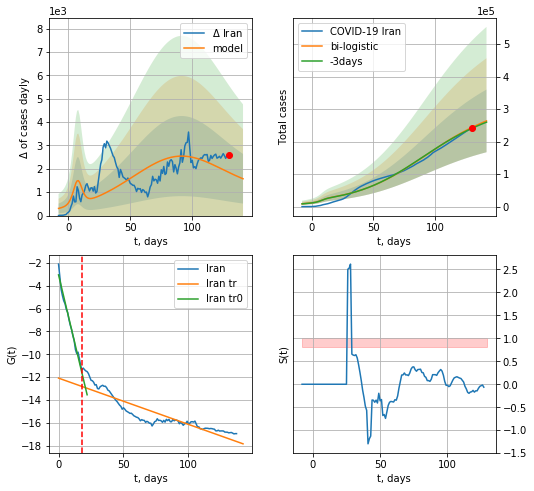

Iran data at: 2020-07-06
+3 day model MAPE: 0.011663969796041538
model: bi-logistic
coeffs:  [2.77913575e+05 3.52266529e-02 8.98274531e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.36548777381872966
forecast at the end of period: +12 days
	 deltaDaycases:  1576
	 total cases:  263713 ± 96384
	 total death:  12728 ± 13955
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.812331
 intercept: -12.082509
 slope: -0.040430


In [211]:
x = forecast('Iran',dfIN[:18],d1,7*16-dT)
xx = forecast2('Iran',dfIN[:],d1,16*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


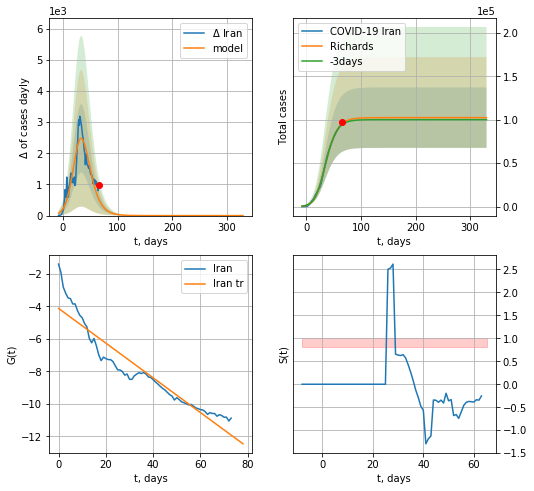

Iran data at: 2020-07-06
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +264 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4946 ± 5044
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


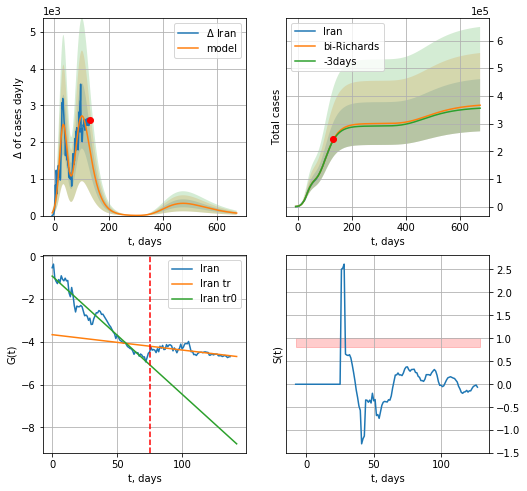

Iran data at: 2020-07-06
+3 day model MAPE: 0.008329
model: bi-Richards
coeffs: [ 1.97715947e+05  2.88670813e+00 -1.41828878e+01  1.28688474e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.257536
forecast at the end of period: +544 days
	 deltaDaycases: 68
	 total cases: 366274 ± 94328
	 total death: 17678 ± 13658
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949245
 intercept: -0.923274
 slope: -0.055272
trend coefficient of determination: 0.470295
 intercept: -3.664628
 slope: -0.007187


In [212]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,92*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


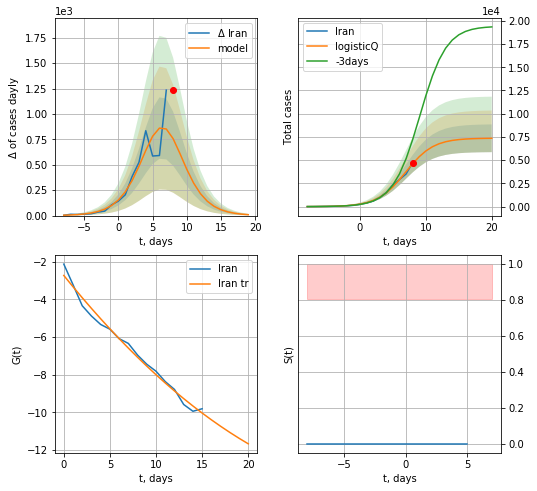

Iran data at: 2020-07-06
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +12 days
	 deltaDaycases: 8
	 total cases: 7354 ± 1492
	 total death: 354 ± 215
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


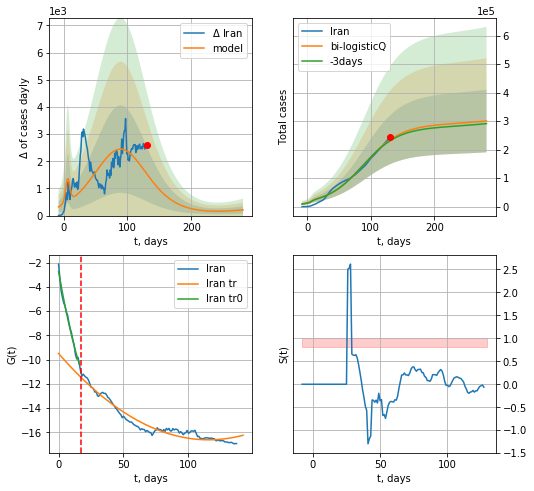

Iran data at: 2020-07-06
+3 day model MAPE: 0.015428
model: bi-logisticQ
coeffs: [ 2.80477169e+05  1.57756224e-07  8.94489653e+01 -2.20372900e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.366030
forecast at the end of period: +152 days
	 deltaDaycases: 209
	 total cases: 300574 ± 110019
	 total death: 14507 ± 15930
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.946667
 intercept_: -9.496384485549859
 coeffs_: [ 0.         -0.12340794  0.00053407]


In [213]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active    death
124 2020-07-02  661165.0  222504   9683.0
125 2020-07-03  667883.0  220131   9859.0
126 2020-07-04  674515.0  217609  10027.0
127 2020-07-05  687862.0  223237  10296.0
128 2020-07-06  694230.0  219856  10494.0


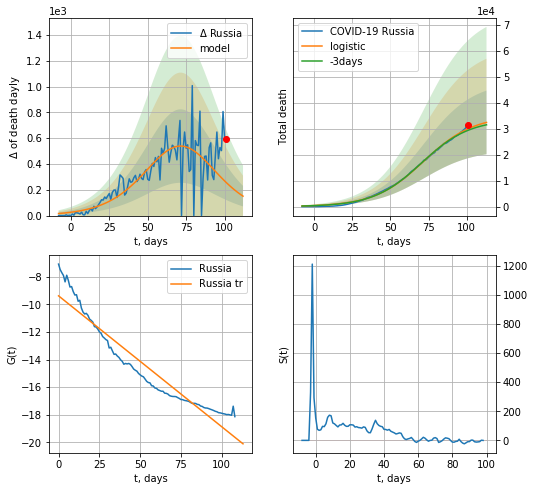

Russia data at: 2020-07-06
+3 day model MAPE: 0.021168070154569184
model: logistic
coeffs:  [3.50140523e+04 6.16033254e-02 7.18536854e+01]
rational stdev:  0.37832705431829816
forecast at the end of period: +12 days
	 total death:  32442 ± 12273
trend coefficient of determination: 0.912494
 intercept: -9.379355
 slope: -0.094986


In [214]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,16*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


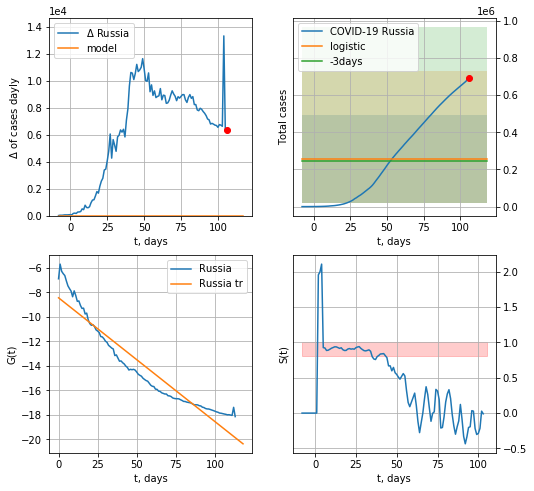

Russia data at: 2020-07-06
+3 day model MAPE: 0.04674464575078721
model: logistic
coeffs:  [ 2.57024409e+05 -7.27689483e+00  1.88640863e+02]
rational stdev:  0.9209312984935805
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  257024 ± 236701
	 total death:  3885 ± 10733
trend coefficient of determination: 0.909913
 intercept: -8.451140
 slope: -0.100920


In [215]:
x = forecast('Russia',dfRS[14:],d1,16*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


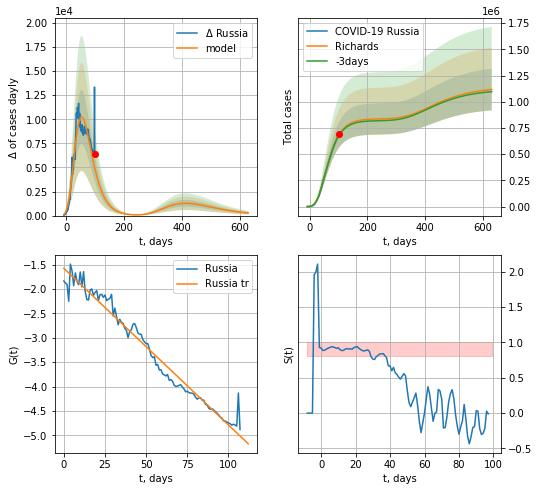

Russia data at: 2020-07-06
+3 day model MAPE: 0.008636
model: Richards
coeffs: [ 8.37712575e+05  2.36848455e+00 -7.31304326e+01  1.41370108e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.178138
forecast at the end of period: +530 days
	 deltaDaycases: 270
	 total cases: 1116782 ± 198941
	 total death: 16881 ± 9021
trend coefficient of determination: 0.970382
 intercept: -1.573183
 slope: -0.032155


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


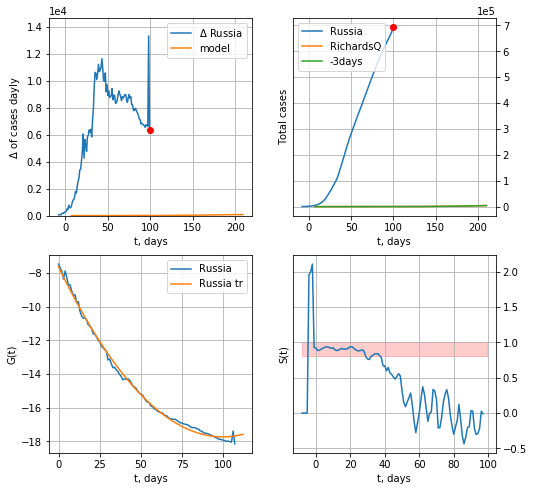

Russia data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.43452012e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +110 days
	 deltaDaycases: 80


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [216]:
x = forecastRR('Russia',dfRS[20:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


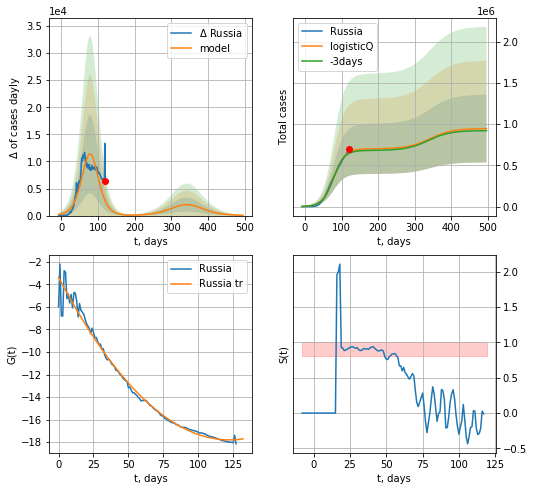

Russia data at: 2020-07-06
+3 day model MAPE: 0.018713
model: logisticQ
coeffs: [ 6.99465391e+05  3.76859806e-07  7.83917000e+01 -1.72504413e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434538
forecast at the end of period: +376 days
	 deltaDaycases: 52
	 total cases: 945614 ± 410905
	 total death: 14293 ± 18632
trend coefficient of determination: 0.983369
 intercept_: -3.3779412312044172
 coeffs_: [ 0.         -0.23579425  0.00096414]


In [217]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
162 2020-07-02  18874.0    1127  975.0
163 2020-07-03  19068.0    1226  976.0
164 2020-07-04  19282.0    1346  977.0
165 2020-07-05  19522.0    1495  977.0
166 2020-07-06  19775.0    1674  977.0


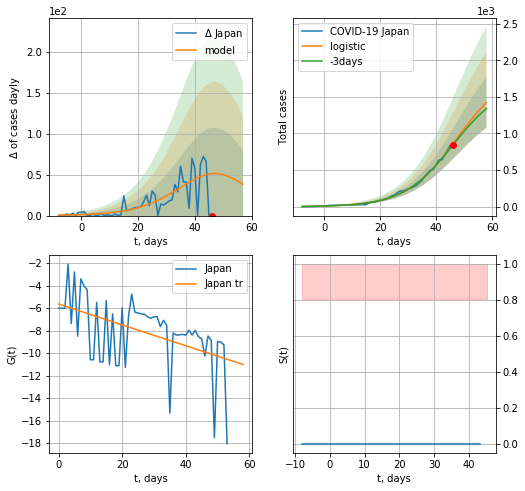

Japan data at: 2020-07-06
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +12 days
	 deltaDaycases:  38
	 total cases:  1422 ± 344
	 total death:  70 ± 50
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


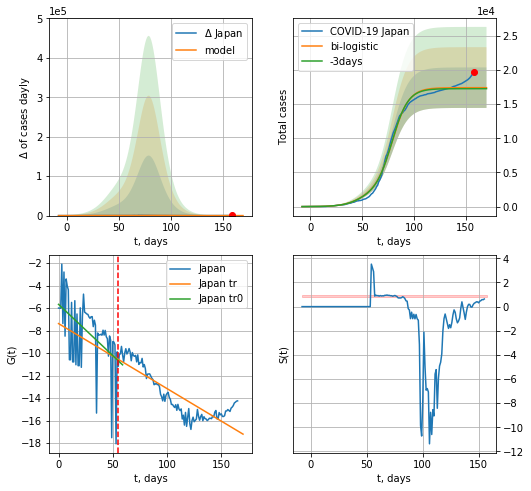

Japan data at: 2020-07-06
+3 day model MAPE: 0.008375071479276101
model: bi-logistic
coeffs:  [1.55476742e+04 1.25741139e-01 7.90786657e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.1703380321737345
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  17414 ± 2966
	 total death:  860 ± 439
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.733835
 intercept: -7.382145
 slope: -0.057802


In [218]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*16-dT)
    xx = forecast2('Japan',dfJP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

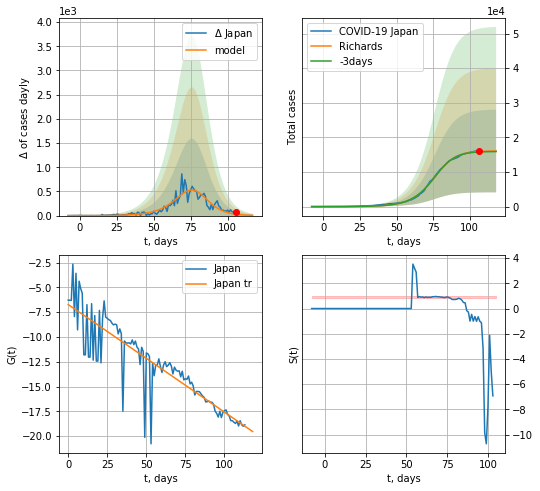

Japan data at: 2020-07-06
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +12 days
	 deltaDaycases: 5
	 total cases: 16069 ± 11945
	 total death: 793 ± 1768
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


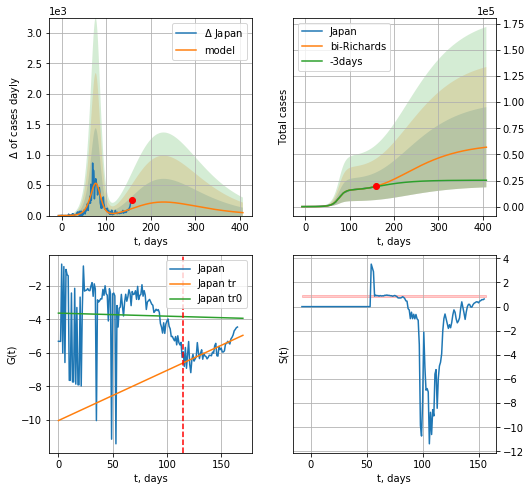

Japan data at: 2020-07-06
+3 day model MAPE: 0.020660
model: bi-Richards
coeffs: [ 4.44600594e+04  1.30122551e+00 -1.03503915e+02  1.05259343e-02]
rational stdev: 0.675173
forecast at the end of period: +250 days
	 deltaDaycases: 48
	 total cases: 56897 ± 38415
	 total death: 2811 ± 5693
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.000871
 intercept: -3.636983
 slope: -0.001807
trend coefficient of determination: 0.547781
 intercept: -10.024857
 slope: 0.029809


In [221]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


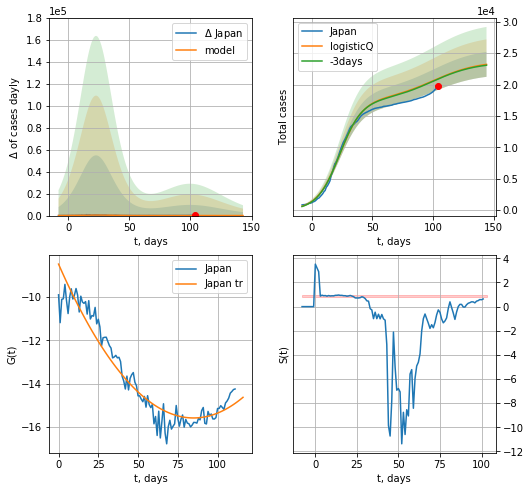

Japan data at: 2020-07-06
+3 day model MAPE: 0.003612
model: logisticQ
coeffs: [ 1.75375213e+04  3.91797557e-07  2.30459892e+01 -2.73185973e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.085591
forecast at the end of period: +40 days
	 deltaDaycases: 27
	 total cases: 23205 ± 1986
	 total death: 1146 ± 294
trend coefficient of determination: 0.919583
 intercept_: -8.471557859011885
 coeffs_: [ 0.         -0.16774881  0.00098792]


In [222]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


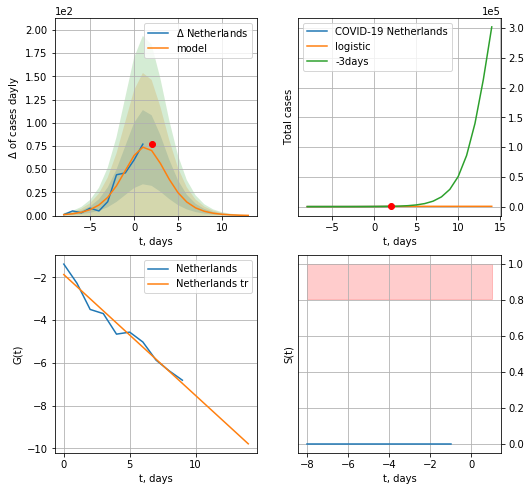

Netherlands data at: 2020-07-06
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  58 ± 41
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


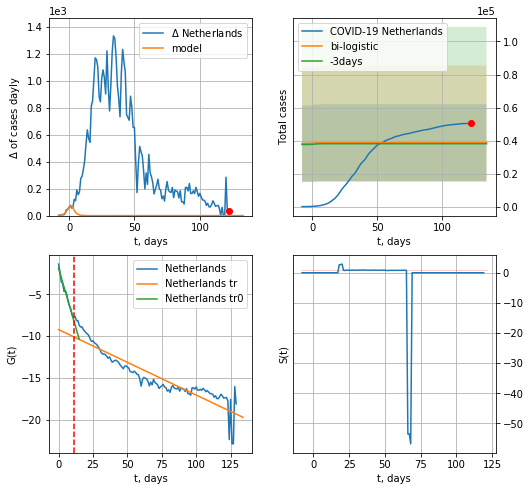

Netherlands data at: 2020-07-06
+3 day model MAPE: 0.015005615968942747
model: bi-logistic
coeffs:  [ 3.05400880e+04 -5.96296069e+00  1.73340094e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.6049355790744592
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  38662 ± 23388
	 total death:  4677 ± 8487
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.841745
 intercept: -9.210037
 slope: -0.078237


In [223]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,16*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date    cases  active   death
126 2020-07-02  50335.0       0  6113.0
127 2020-07-03  50335.3       0  6113.0
128 2020-07-04  50335.6       0  6113.0
129 2020-07-05  50621.0       0  6127.0
130 2020-07-06  50657.0       0  6128.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


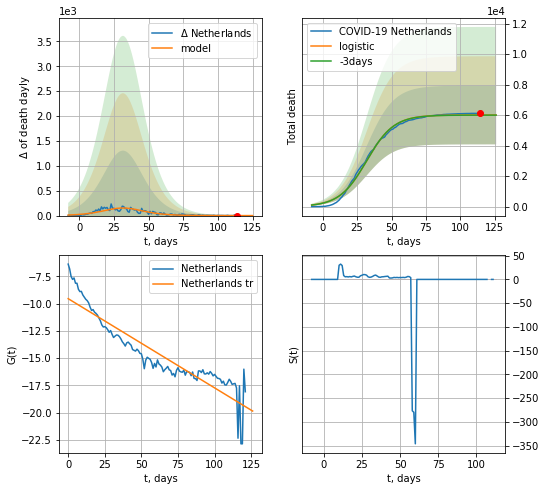

Netherlands data at: 2020-07-06
+3 day model MAPE: 0.0013668030099959316
model: logistic
coeffs:  [6.00902575e+03 1.01409076e-01 3.19472289e+01]
rational stdev:  0.3204571747832974
forecast at the end of period: +12 days
	 total death:  6008 ± 1925
trend coefficient of determination: 0.844296
 intercept: -9.546670
 slope: -0.081795


In [224]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


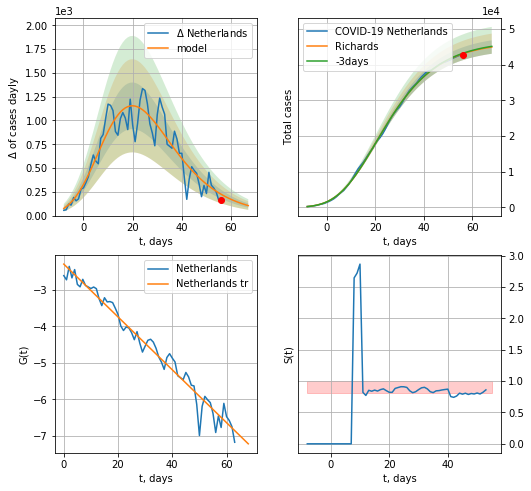

Netherlands data at: 2020-07-06
+3 day model MAPE: 0.002844
model: Richards
coeffs: [ 4.63265250e+04  4.86732663e-01 -5.76573628e+00  1.49500456e-01]
rational stdev: 0.041831
forecast at the end of period: +12 days
	 deltaDaycases: 105
	 total cases: 44906 ± 1878
	 total death: 5432 ± 681
trend coefficient of determination: 0.968459
 intercept: -2.292784
 slope: -0.072448


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


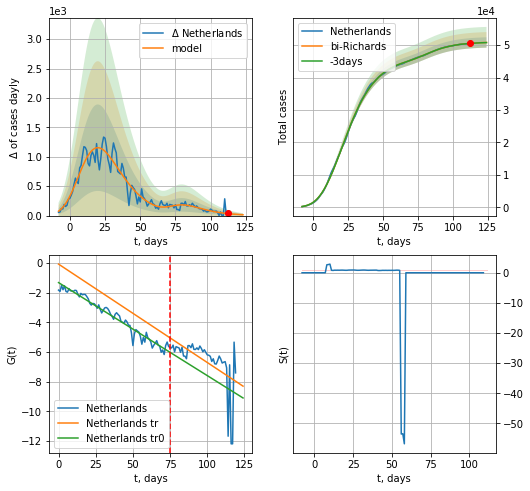

Netherlands data at: 2020-07-06
+3 day model MAPE: 0.000605
model: bi-Richards
coeffs: [4.64230588e+03 5.82917459e+00 3.24594784e+01 1.44498295e-02]
rational stdev: 0.031420
forecast at the end of period: +12 days
	 deltaDaycases: 14
	 total cases: 50802 ± 1596
	 total death: 6145 ± 579
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.960938
 intercept: -1.322980
 slope: -0.062692
trend coefficient of determination: 0.309654
 intercept: -0.077711
 slope: -0.066315


In [225]:
iL = 10
vL = 75 +iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


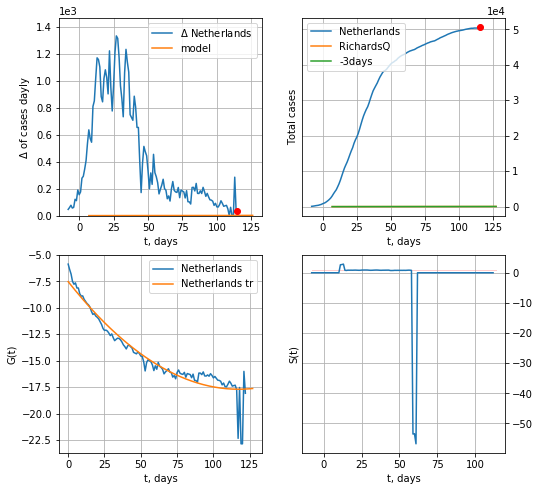

Netherlands data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.85848799e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +12 days
	 deltaDaycases: 1


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [227]:
x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


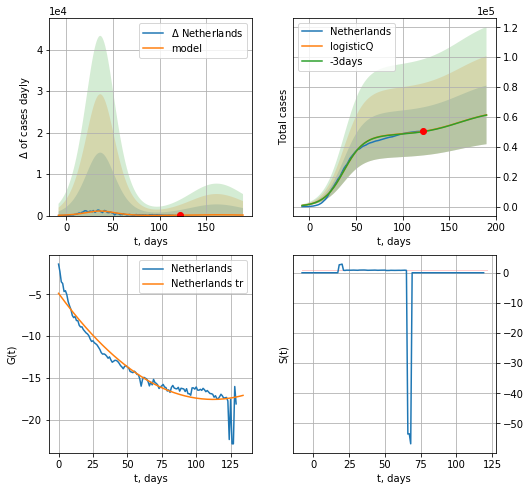

Netherlands data at: 2020-07-06
+3 day model MAPE: 0.003596
model: logisticQ
coeffs: [ 4.79665528e+04  2.44699142e-07  3.69949266e+01 -3.74455297e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319601
forecast at the end of period: +68 days
	 deltaDaycases: 131
	 total cases: 61389 ± 19620
	 total death: 7426 ± 7120
trend coefficient of determination: 0.920861
 intercept_: -4.876349918854768
 coeffs_: [ 0.         -0.22591624  0.00100677]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


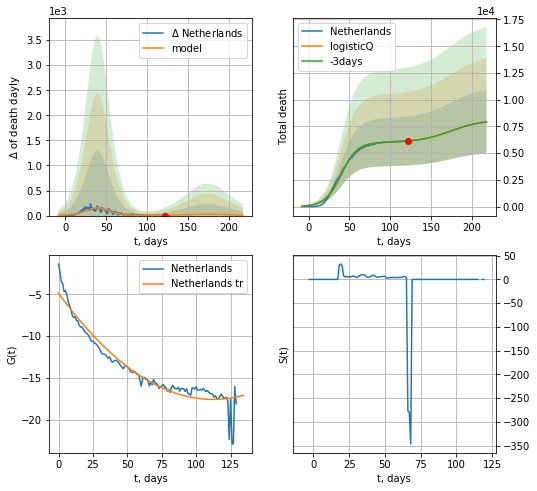

Netherlands data at: 2020-07-06
+3 day model MAPE: 0.001349
model: logisticQ
coeffs: [ 6.00779430e+03  3.82657090e-07  3.99453583e+01 -2.65545753e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.372990
forecast at the end of period: +96 days
	 total death: 7931 ± 2958
trend coefficient of determination: 0.920861
 intercept_: -4.876349918854768
 coeffs_: [ 0.         -0.22591624  0.00100677]


In [228]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [229]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


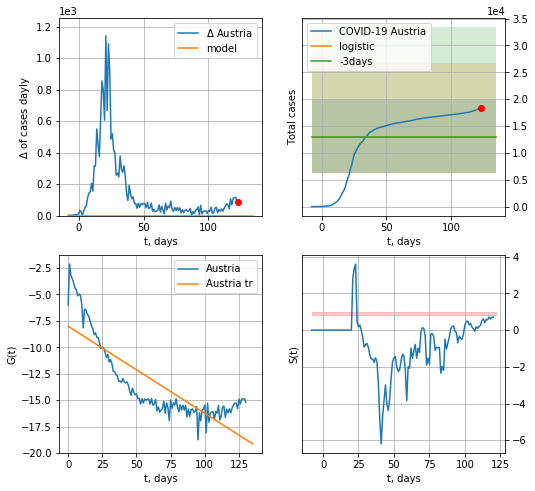

Austria data at: 2020-07-06
+3 day model MAPE: 0.011494427064531498
model: logistic
coeffs:  [12272.91674242   -53.96448463   243.45593938]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5213996567237309
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  13039 ± 6799
	 total death:  501 ± 783
trend coefficient of determination: 0.686047
 intercept: -8.010350
 slope: -0.082411


In [230]:
x = forecast('Austria',dfAT[:],d1,7*16-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


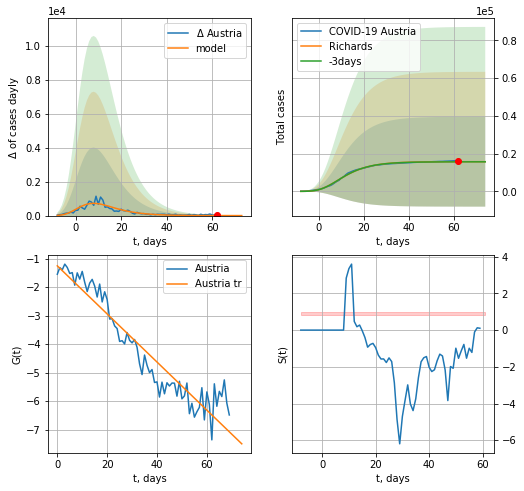

Austria data at: 2020-07-06
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373335e+04  1.43837183e+01 -2.95009845e+01  8.70431827e-03]
rational stdev: 1.513265
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 15733 ± 23808
	 total death: 604 ± 2742
trend coefficient of determination: 0.902787
 intercept: -1.255749
 slope: -0.084344


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


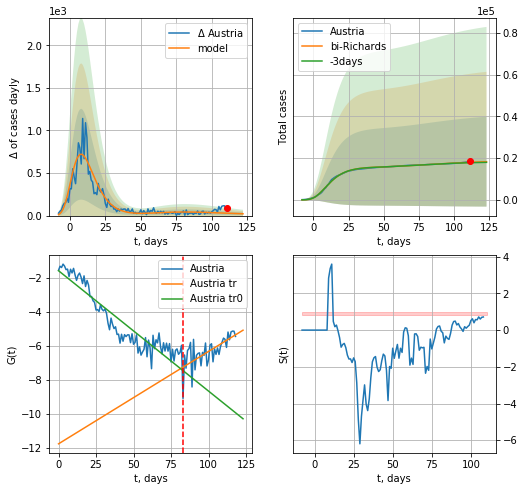

Austria data at: 2020-07-06
+3 day model MAPE: 0.011565
model: bi-Richards
coeffs: [ 3.20250019e+03  6.52785936e+00 -6.46760514e+01  5.44624776e-03]
rational stdev: 1.176828
forecast at the end of period: +12 days
	 deltaDaycases: 21
	 total cases: 18276 ± 21507
	 total death: 702 ± 2478
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.868029
 intercept: -1.565619
 slope: -0.070781
trend coefficient of determination: 0.437272
 intercept: -11.745731
 slope: 0.054327


In [231]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


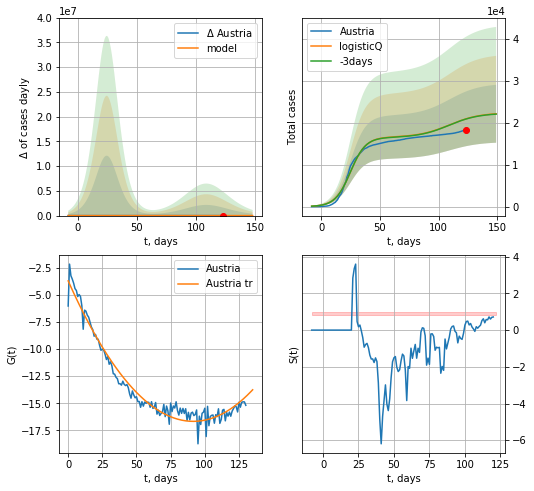

Austria data at: 2020-07-06
+3 day model MAPE: 0.001837
model: logisticQ
coeffs: [ 1.65605383e+04  3.06681725e-07  2.50545806e+01 -5.00007407e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311801
forecast at the end of period: +26 days
	 deltaDaycases: 19
	 total cases: 22165 ± 6911
	 total death: 852 ± 796
trend coefficient of determination: 0.963713
 intercept_: -3.6780488961725055
 coeffs_: [ 0.         -0.28391646  0.00155005]


In [232]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
123 2020-07-02  61598.0   34793  9761.0
124 2020-07-03  61727.0   34889  9765.0
125 2020-07-04  61838.0   34976  9771.0
126 2020-07-05  62016.0   35154  9771.0
127 2020-07-06  62058.0   35193  9774.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


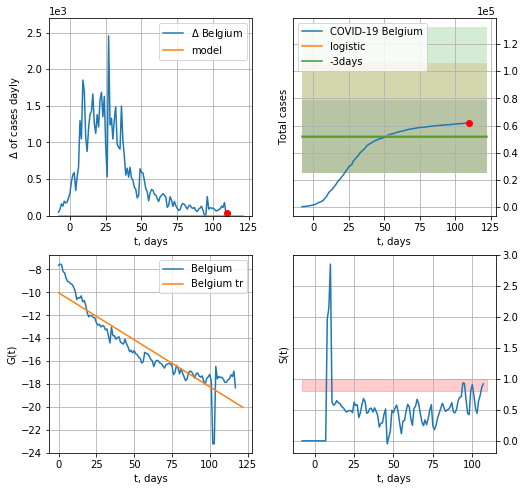

Belgium data at: 2020-07-06
+3 day model MAPE: 0.012887941561768118
model: logistic
coeffs:  [ 4.15354949e+04 -8.32171062e+00  2.67006744e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.5182054287589357
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  51919 ± 26904
	 total death:  8177 ± 12712
trend coefficient of determination: 0.840164
 intercept: -10.036797
 slope: -0.082074


In [233]:
vL=9
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[vL:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date    cases  active   death
123 2020-07-02  61598.0   34793  9761.0
124 2020-07-03  61727.0   34889  9765.0
125 2020-07-04  61838.0   34976  9771.0
126 2020-07-05  62016.0   35154  9771.0
127 2020-07-06  62058.0   35193  9774.0


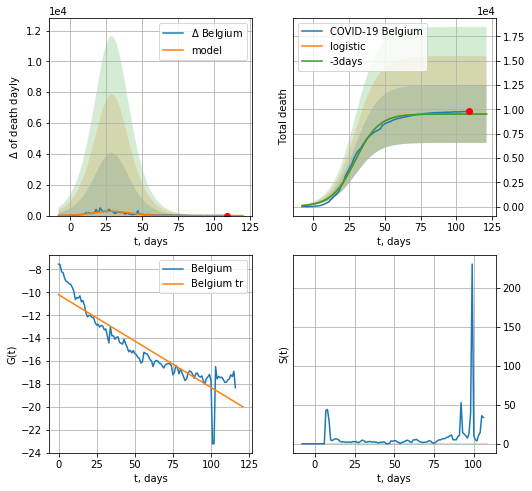

Belgium data at: 2020-07-06
+3 day model MAPE: 0.0017576438617942485
model: logistic
coeffs:  [9.52571917e+03 1.20826319e-01 2.92855155e+01]
rational stdev:  0.312784303785955
forecast at the end of period: +12 days
	 total death:  9525 ± 2979
trend coefficient of determination: 0.837838
 intercept: -10.200518
 slope: -0.081019


In [234]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


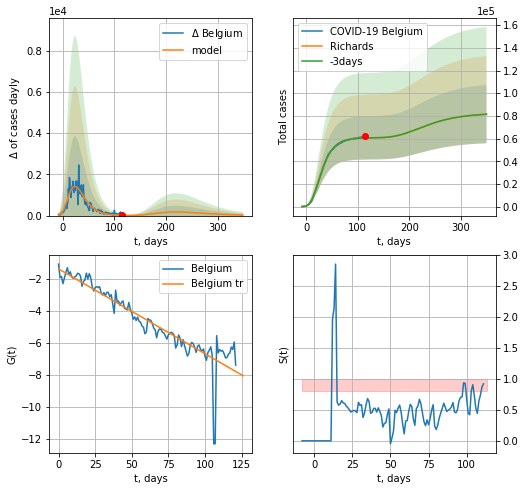

Belgium data at: 2020-07-06
+3 day model MAPE: 0.002127
model: Richards
coeffs: [ 6.07718694e+04  7.94258490e+00 -5.19235972e+01  7.99422733e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.314502
forecast at the end of period: +236 days
	 deltaDaycases: 26
	 total cases: 81528 ± 25640
	 total death: 12840 ± 12114
trend coefficient of determination: 0.835698
 intercept: -1.379218
 slope: -0.052936


In [235]:
x = forecastRR('Belgium',dfBG[5:],d1,48*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


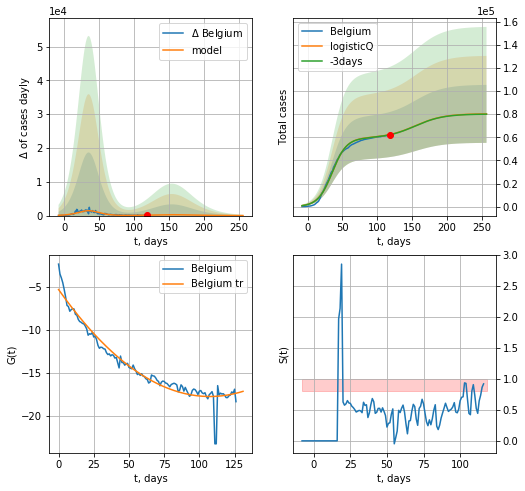

Belgium data at: 2020-07-06
+3 day model MAPE: 0.002804
model: logisticQ
coeffs: [ 5.93783847e+04  3.11158081e-07  3.54571064e+01 -3.12458330e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312670
forecast at the end of period: +138 days
	 deltaDaycases: 6
	 total cases: 80269 ± 25097
	 total death: 12642 ± 11858
trend coefficient of determination: 0.943085
 intercept_: -5.318235863213564
 coeffs_: [ 0.         -0.23120723  0.00107633]


In [236]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [237]:
dfBZ.tail()

,date,cases,active,death
128,2020-07-02,1501353.0,523216,61990.0
129,2020-07-03,1543341.0,501472,63254.0
130,2020-07-04,1578376.0,535396,64365.0
131,2020-07-05,1604585.0,561070,64900.0
132,2020-07-06,1626071.0,488286,65556.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


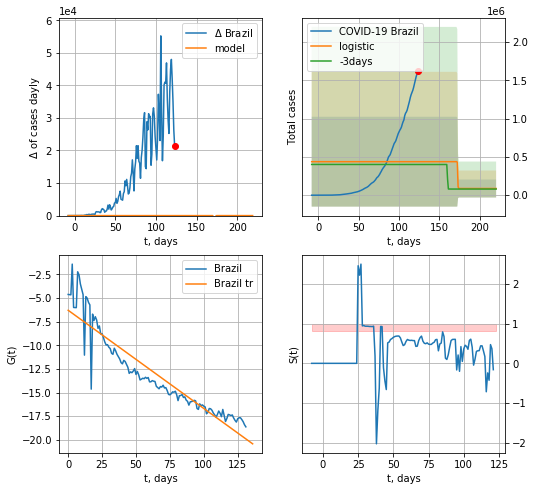

Brazil data at: 2020-07-06
+3 day model MAPE: 0.08987492829061416
model: logistic
coeffs:  [ 3.50505902e+05 -6.81404975e+00  1.72602098e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3402648109535462
forecast at the end of period: +96 days
	 deltaDaycases:  0
	 total cases:  87626 ± 117442
	 total death:  3532 ± 14201
trend coefficient of determination: 0.867608
 intercept: -6.299418
 slope: -0.103847


In [238]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


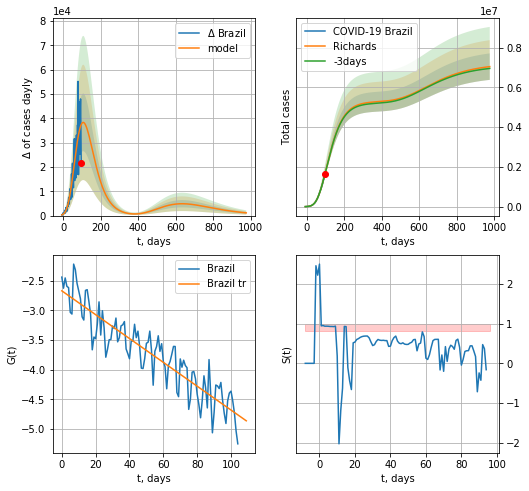

Brazil data at: 2020-07-06
+3 day model MAPE: 0.001070
model: Richards
coeffs: [ 5.29706209e+06  3.14292073e-01 -2.81432113e+01  6.46082643e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.094554
forecast at the end of period: +880 days
	 deltaDaycases: 1126
	 total cases: 7047113 ± 666334
	 total death: 284108 ± 80590
trend coefficient of determination: 0.825622
 intercept: -2.669703
 slope: -0.020115


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


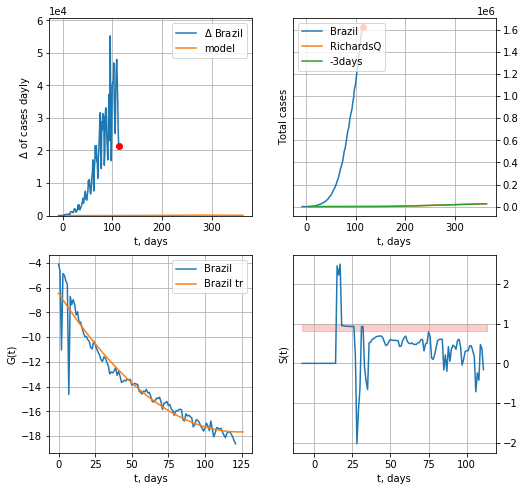

Brazil data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.54597654e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +250 days
	 deltaDaycases: 92


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [240]:
x = forecastRR('Brazil',dfBZ[27:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


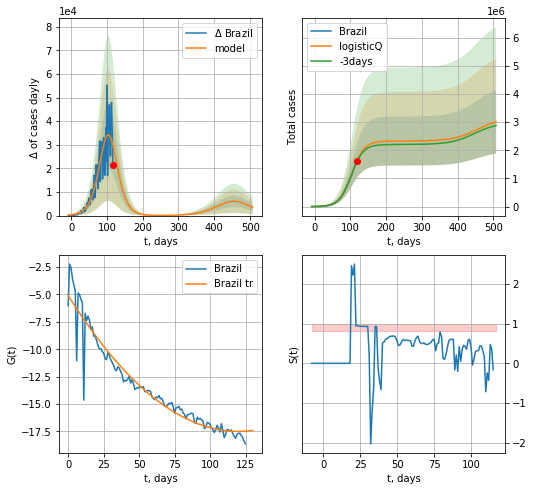

Brazil data at: 2020-07-06
+3 day model MAPE: 0.017968
model: logisticQ
coeffs: [ 2.32658040e+06  1.18691086e-06  1.04369301e+02 -4.94249554e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373387
forecast at the end of period: +390 days
	 deltaDaycases: 3507
	 total cases: 3008440 ± 1123312
	 total death: 121287 ± 135861
trend coefficient of determination: 0.925749
 intercept_: -5.087181307517497
 coeffs_: [ 0.         -0.20689509  0.00086247]


In [241]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [242]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
138 2020-07-02  8066.0     830  104.0
139 2020-07-03  8260.0     837  104.0
140 2020-07-04  8443.0     940  104.0
141 2020-07-05  8586.0    1060  106.0
142 2020-07-06  8755.0    1194  106.0


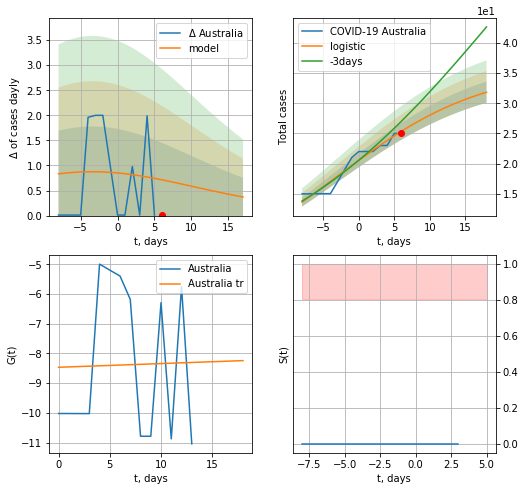

Australia data at: 2020-07-06
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  31 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


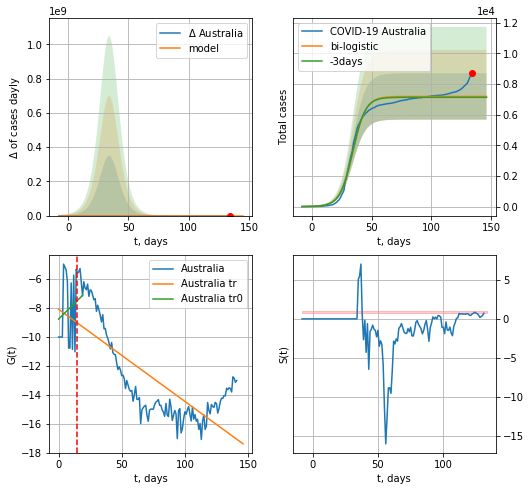

Australia data at: 2020-07-06
+3 day model MAPE: 0.008002131948930338
model: bi-logistic
coeffs:  [7.16198252e+03 1.84198560e-01 3.44598230e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.2100462159976006
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  7197 ± 1511
	 total death:  87 ± 54
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.573787
 intercept: -8.109229
 slope: -0.063578


In [243]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,16*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,16*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


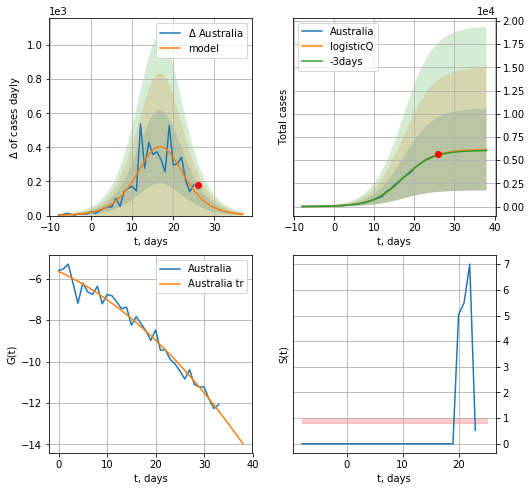

Australia data at: 2020-07-06
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +12 days
	 deltaDaycases: 7
	 total cases: 6142 ± 4402
	 total death: 74 ± 159
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


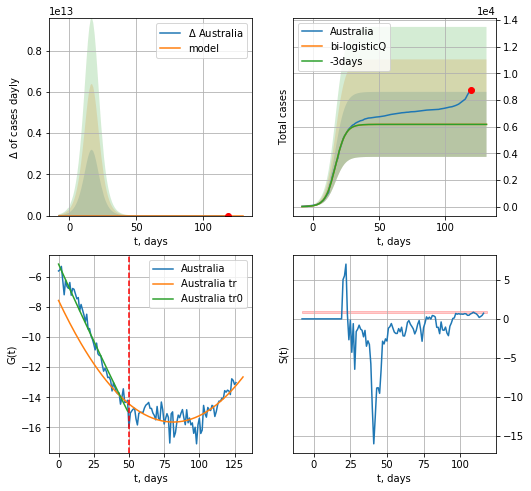

Australia data at: 2020-07-06
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-2.49332548 -0.7180105  25.44510371  0.630074  ]
rational stdev: 0.394869
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2435
	 total death: 74 ± 87
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.543623
 intercept_: -7.565320137514275
 coeffs_: [ 0.         -0.19844108  0.00121871]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [244]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

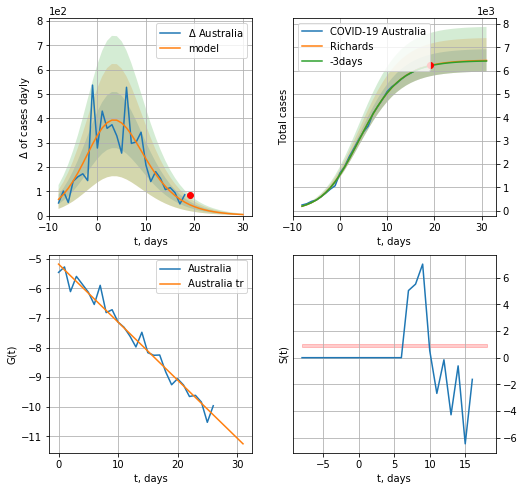

Australia data at: 2020-07-06
+3 day model MAPE: 0.002710
model: Richards
coeffs: [6.45320716e+03 3.35380984e-01 1.97655249e+00 6.50083452e-01]
rational stdev: 0.074371
forecast at the end of period: +12 days
	 deltaDaycases: 4
	 total cases: 6435 ± 478
	 total death: 77 ± 17
trend coefficient of determination: 0.972984
 intercept: -5.180623
 slope: -0.195819


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


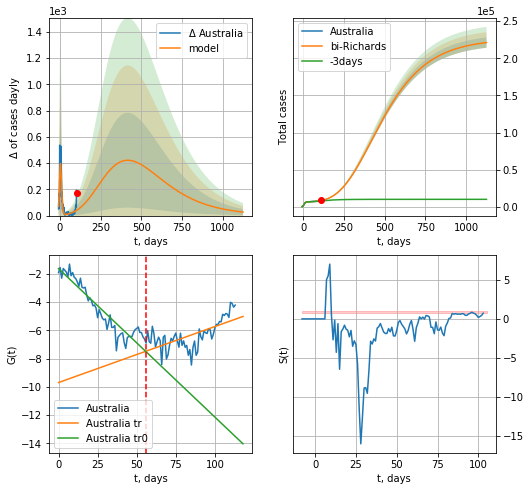

Australia data at: 2020-07-06
+3 day model MAPE: 0.042249
model: bi-Richards
coeffs: [ 2.19790621e+05  1.79216787e-01 -2.48054244e+02  2.95429045e-02]
rational stdev: 0.031743
forecast at the end of period: +1020 days
	 deltaDaycases: 26
	 total cases: 221152 ± 7019
	 total death: 2677 ± 254
bi-Richards approximation splitting point: 56
trend coefficient of determination: 0.881159
 intercept: -1.632595
 slope: -0.105134
trend coefficient of determination: 0.422242
 intercept: -9.700107
 slope: 0.039653


In [253]:
iL = 28
vL = 56+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,160*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
126 2020-07-02  8643.0      85  121.0
127 2020-07-03  8648.0      81  121.0
128 2020-07-04  8658.0      76  121.0
129 2020-07-05  8668.0      71  121.0
130 2020-07-06  8668.0      71  121.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

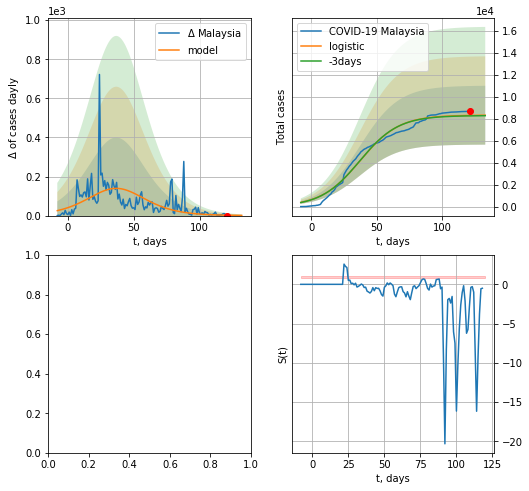

In [256]:
dfML = read_df(pd.DataFrame(),"ML")
x = forecast('Malaysia',dfML[1:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

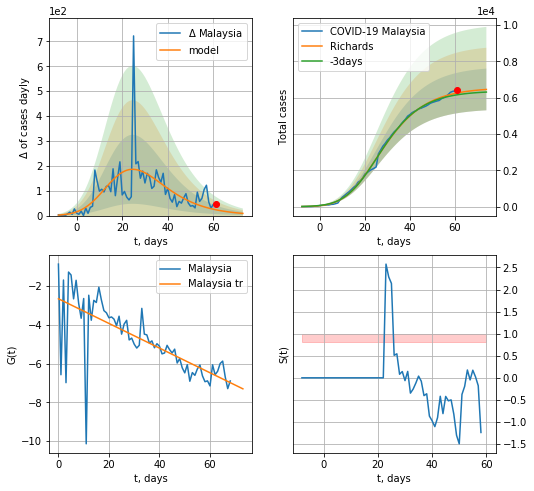

Malaysia data at: 2020-07-05
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +13 days
	 deltaDaycases: 8
	 total cases: 6458 ± 1148
	 total death: 90 ± 48
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


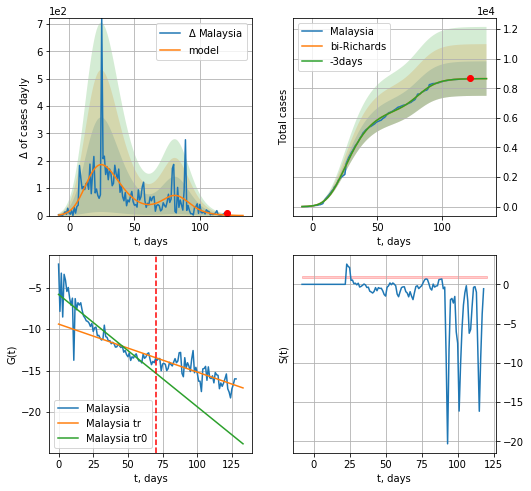

Malaysia data at: 2020-07-05
+3 day model MAPE: 0.000603
model: bi-Richards
coeffs: [2.10151037e+03 1.30265563e-01 8.20253022e+01 1.01936095e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.134526
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 8656 ± 1164
	 total death: 120 ± 48
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.807504
 intercept: -5.808017
 slope: -0.135632
trend coefficient of determination: 0.568839
 intercept: -9.392461
 slope: -0.057949


In [679]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


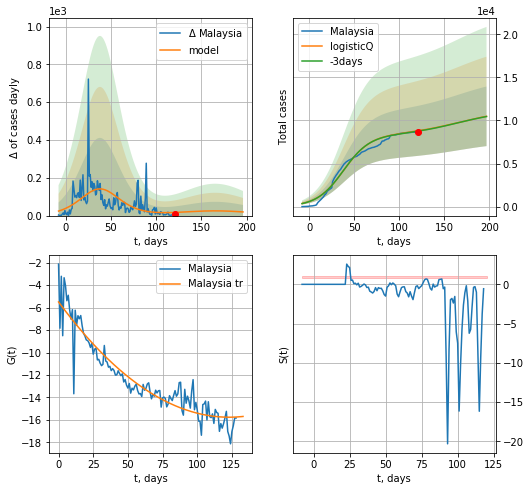

Malaysia data at: 2020-07-05
+3 day model MAPE: 0.004339
model: logisticQ
coeffs: [ 8.30491906e+03  1.18831982e-07  3.80939669e+01 -5.67406386e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329996
forecast at the end of period: +76 days
	 deltaDaycases: 19
	 total cases: 10483 ± 3459
	 total death: 146 ± 144
trend coefficient of determination: 0.874867
 intercept_: -5.491657615901003
 coeffs_: [ 0.         -0.16701111  0.00067914]


In [680]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
125 2020-07-02  1530.3      18   22.0
126 2020-07-03  1530.6      18   22.0
127 2020-07-04  1533.0      21   22.0
128 2020-07-05  1534.0      22   22.0
129 2020-07-06  1536.0      22   22.0


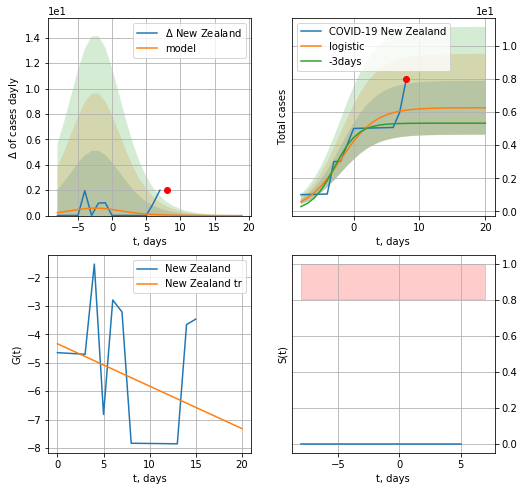

New Zealand data at: 2020-07-06
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


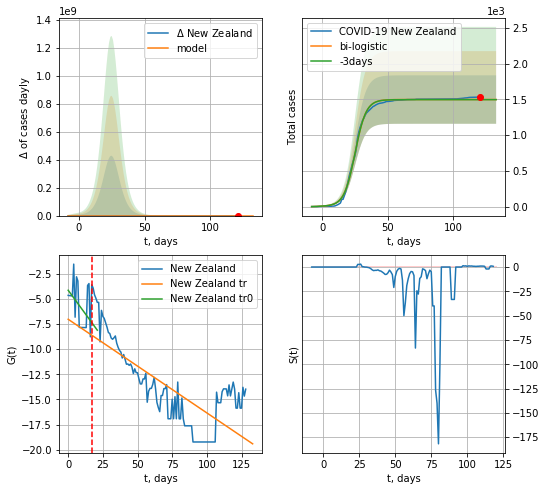

New Zealand data at: 2020-07-06
+3 day model MAPE: 0.0009526029151344597
model: bi-logistic
coeffs:  [1.49151785e+03 2.38338913e-01 2.51949877e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.22599649800463062
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1497 ± 338
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.577022
 intercept: -7.022412
 slope: -0.093214


In [257]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,16*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

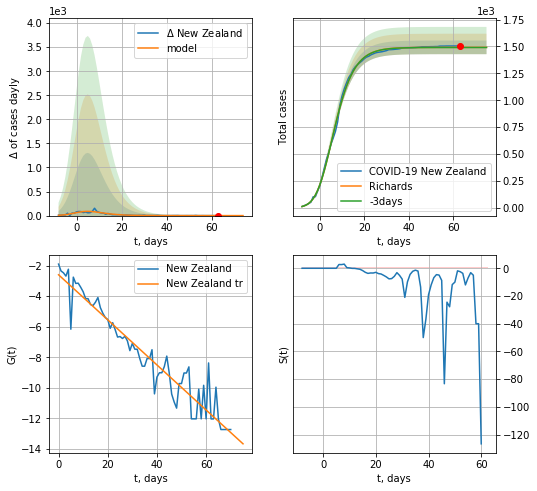

New Zealand data at: 2020-07-06
+3 day model MAPE: 0.000854
model: Richards
coeffs: [ 1.49158630e+03  5.64402224e-01 -5.41494471e-01  3.30453174e-01]
rational stdev: 0.042486
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1491 ± 63
	 total death: 21 ± 2
trend coefficient of determination: 0.916494
 intercept: -2.603090
 slope: -0.147473


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


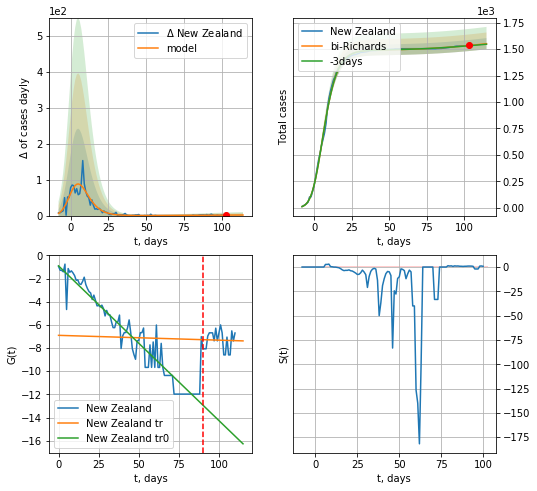

New Zealand data at: 2020-07-06
+3 day model MAPE: 0.001437
model: bi-Richards
coeffs: [ 3.31112577e+02  2.07281497e+00 -1.62298187e+02  7.56209756e-03]
rational stdev: 0.034055
forecast at the end of period: +12 days
	 deltaDaycases: 1
	 total cases: 1551 ± 52
	 total death: 22 ± 2
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.914509
 intercept: -0.901121
 slope: -0.133660
trend coefficient of determination: 0.000941
 intercept: -6.901130
 slope: -0.004166


In [258]:
vL = 90 + 18
x = forecastRR('New Zealand',dfZL[18:vL-18],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[18:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-18)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


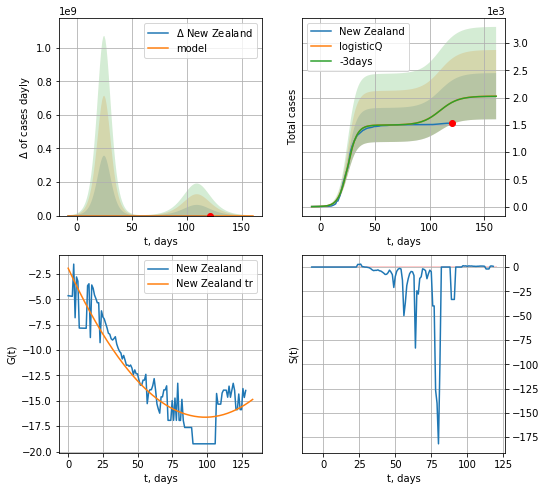

New Zealand data at: 2020-07-06
+3 day model MAPE: 0.000533
model: logisticQ
coeffs: [ 1.49799531e+03  1.87015710e-06  2.51477914e+01 -1.26234713e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.209091
forecast at the end of period: +40 days
	 deltaDaycases: 0
	 total cases: 2027 ± 423
	 total death: 29 ± 18
trend coefficient of determination: 0.853598
 intercept_: -1.9364401212770126
 coeffs_: [ 0.         -0.29699531  0.00150212]


In [259]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
125 2020-07-02  62698.0   13555  405.0
126 2020-07-03  62997.0   12676  412.0
127 2020-07-04  63270.0   12183  418.0
128 2020-07-05  63554.0   12260  423.0
129 2020-07-06  63804.0   12255  429.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


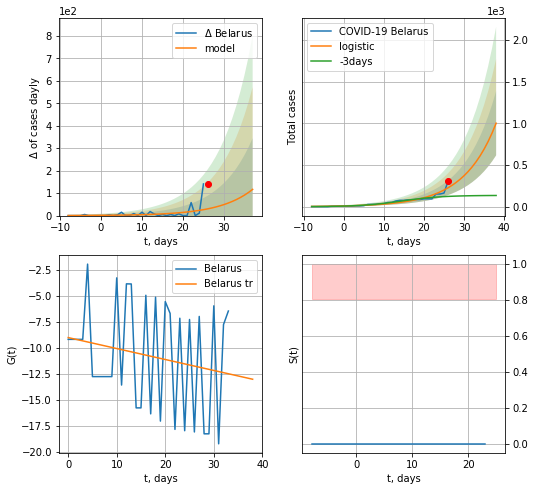

Belarus data at: 2020-07-06
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +12 days
	 deltaDaycases:  116
	 total cases:  1000 ± 384
	 total death:  6 ± 6
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


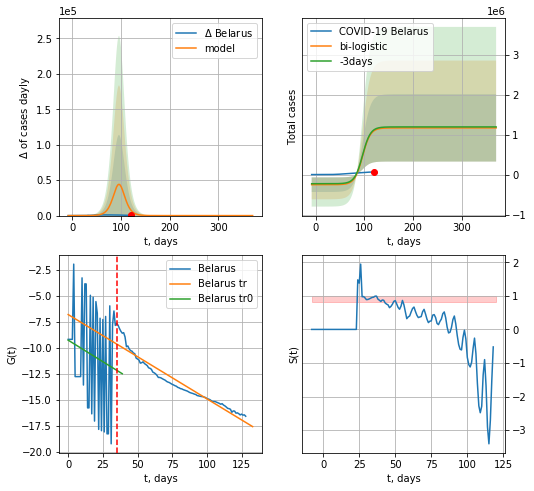

Belarus data at: 2020-07-06
+3 day model MAPE: 0.021463448713207673
model: bi-logistic
coeffs:  [-2.53563459e+05  2.97526096e+01 -6.86358155e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.7211551944475909
forecast at the end of period: +250 days
	 deltaDaycases:  0
	 total cases:  1168416 ± 842609
	 total death:  7856 ± 16996
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.931297
 intercept: -6.825656
 slope: -0.081042


In [260]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*16-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
125 2020-07-02  62698.0   13555  405.0
126 2020-07-03  62997.0   12676  412.0
127 2020-07-04  63270.0   12183  418.0
128 2020-07-05  63554.0   12260  423.0
129 2020-07-06  63804.0   12255  429.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


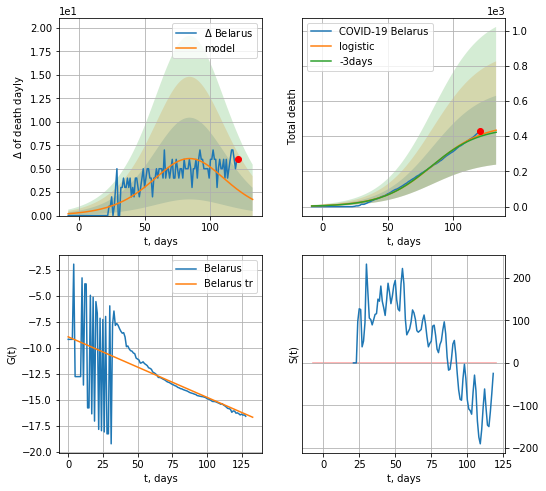

Belarus data at: 2020-07-06
+3 day model MAPE: 0.02140111536743768
model: logistic
coeffs:  [4.68985999e+02 5.19038548e-02 8.45936611e+01]
rational stdev:  0.45072856674322104
forecast at the end of period: +12 days
	 total death:  433 ± 195
trend coefficient of determination: 0.374499
 intercept: -8.967298
 slope: -0.058148


In [261]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


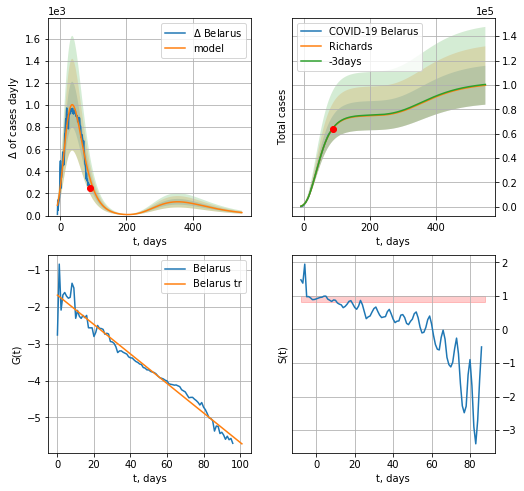

Belarus data at: 2020-07-06
+3 day model MAPE: 0.003210
model: Richards
coeffs: [ 7.48953810e+04  2.57407238e+00 -7.89523442e+01  1.42391374e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.159991
forecast at the end of period: +460 days
	 deltaDaycases: 27
	 total cases: 99751 ± 15959
	 total death: 670 ± 321
trend coefficient of determination: 0.965894
 intercept: -1.688266
 slope: -0.039854


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


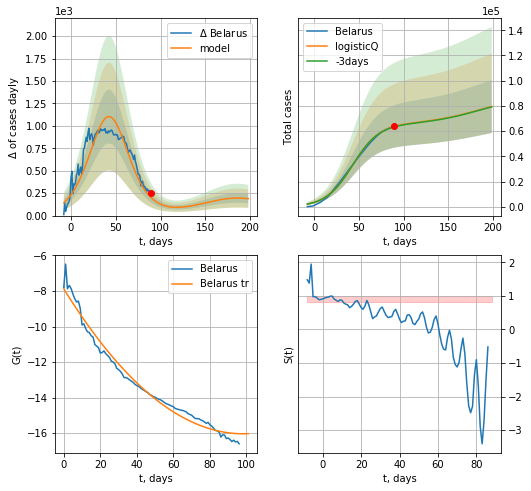

Belarus data at: 2020-07-06
+3 day model MAPE: 0.004799
model: logisticQ
coeffs: [ 6.55621118e+04  5.29084367e-07  4.28234636e+01 -1.26505586e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.264385
forecast at the end of period: +110 days
	 deltaDaycases: 188
	 total cases: 79550 ± 21031
	 total death: 534 ± 423
trend coefficient of determination: 0.979036
 intercept_: -7.879814528169158
 coeffs_: [ 0.         -0.16614534  0.00084562]


In [262]:
x = forecastRR('Belarus',dfBR[32:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


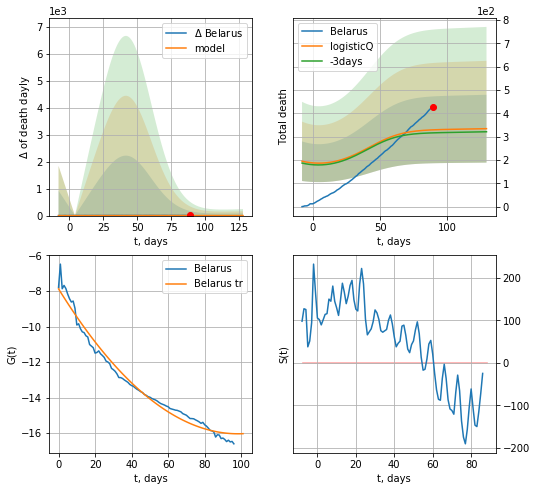

Belarus data at: 2020-07-06
+3 day model MAPE: 0.040723
model: logisticQ
coeffs: [ 2.79114821e+02  7.49587467e-04  9.95009495e+00 -9.42083633e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433980
forecast at the end of period: +40 days
	 total death: 334 ± 145
trend coefficient of determination: 0.979036
 intercept_: -7.879814528169158
 coeffs_: [ 0.         -0.16614534  0.00084562]


In [263]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

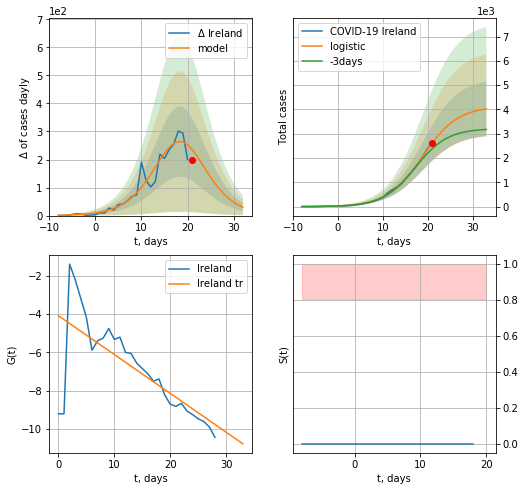

Ireland data at: 2020-07-06
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +12 days
	 deltaDaycases:  29
	 total cases:  4022 ± 1125
	 total death:  274 ± 229
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


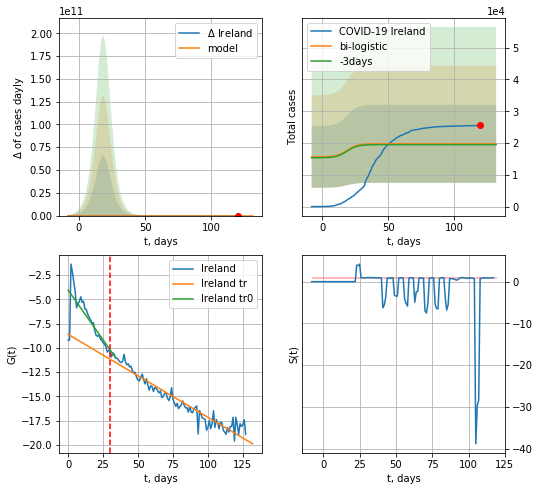

Ireland data at: 2020-07-06
+3 day model MAPE: 0.013586117036156165
model: bi-logistic
coeffs:  [ 1.24994196e+04 -1.04548129e+01  2.63368670e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6204651729730061
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  19751 ± 12255
	 total death:  1346 ± 2505
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.926662
 intercept: -8.616395
 slope: -0.085325


In [264]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,16*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


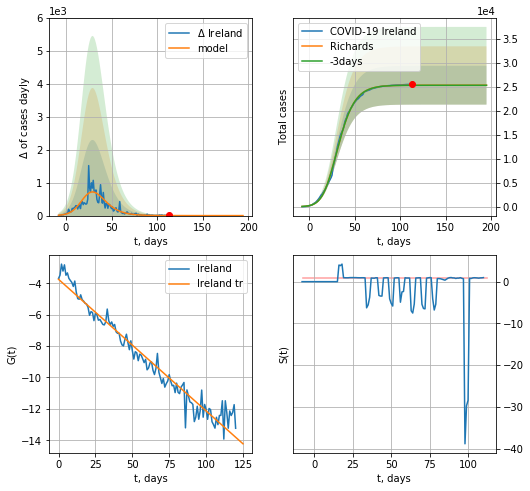

Ireland data at: 2020-07-06
+3 day model MAPE: 0.000708
model: Richards
coeffs: [2.53309885e+04 2.11845928e-01 2.08882775e+01 4.40805108e-01]
rational stdev: 0.159835
forecast at the end of period: +82 days
	 deltaDaycases: 0
	 total cases: 25330 ± 4048
	 total death: 1727 ± 828
trend coefficient of determination: 0.956726
 intercept: -3.748037
 slope: -0.083813


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


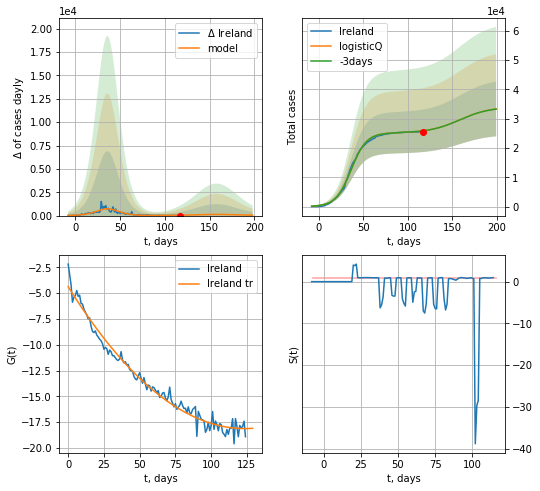

Ireland data at: 2020-07-06
+3 day model MAPE: 0.001031
model: logisticQ
coeffs: [ 2.51216679e+04  7.31479532e-07  3.62643169e+01 -1.59066584e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.280230
forecast at the end of period: +82 days
	 deltaDaycases: 40
	 total cases: 33276 ± 9325
	 total death: 2269 ± 1907
trend coefficient of determination: 0.979131
 intercept_: -4.383968540213074
 coeffs_: [ 0.         -0.22219969  0.00089853]


In [265]:
ivL = 7
vL = 90 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
121 2020-07-02  284541   29374  5920.0
122 2020-07-03  288089   28695  6051.0
123 2020-07-04  291847   28210  6192.0
124 2020-07-05  295532   28192  6308.0
125 2020-07-06  298557   27802  6384.0


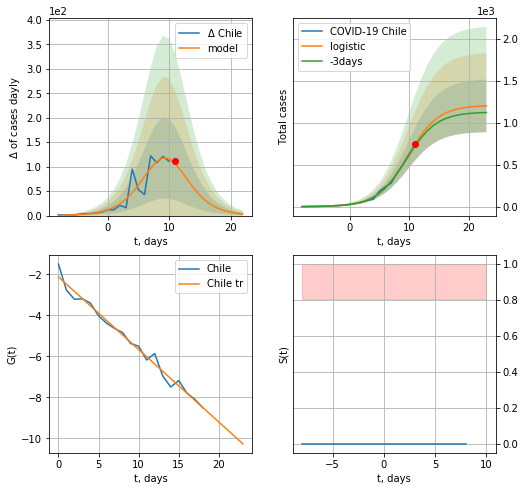

Chile data at: 2020-07-06
+3 day model MAPE: 0.03908987806693812
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +12 days
	 deltaDaycases:  3
	 total cases:  1200 ± 313
	 total death:  25 ± 19
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


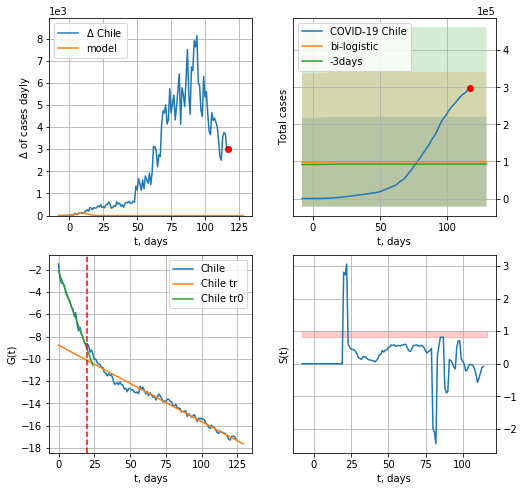

Chile data at: 2020-07-06
+3 day model MAPE: 0.07091646453901077
model: bi-logistic
coeffs:  [ 7.84599633e+04 -1.73436158e+01  4.25416310e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2197808038304205
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  99282 ± 121102
	 total death:  2122 ± 7765
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.963603
 intercept: -8.774758
 slope: -0.068645


In [266]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*16-dT)
xx = forecast2('Chile',dfCL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


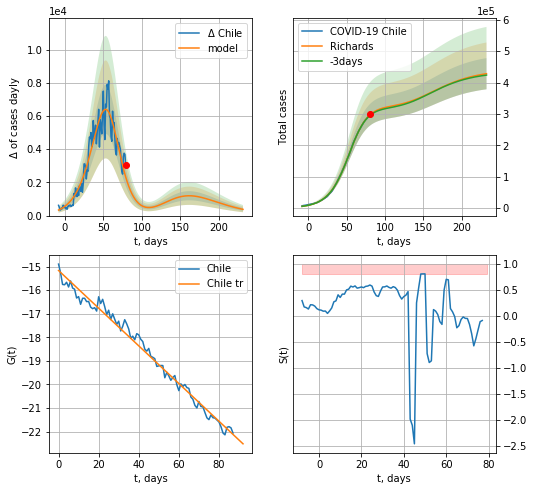

Chile data at: 2020-07-06
+3 day model MAPE: 0.006627
model: Richards
coeffs: [3.24058488e+05 6.36663196e-02 5.71969585e+01 1.38593347e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.116103
forecast at the end of period: +152 days
	 deltaDaycases: 375
	 total cases: 428287 ± 49725
	 total death: 9158 ± 3189
trend coefficient of determination: 0.985860
 intercept: -15.165928
 slope: -0.079947


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


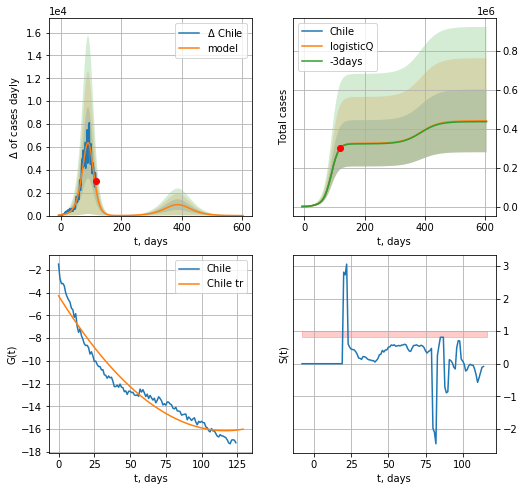

Chile data at: 2020-07-06
+3 day model MAPE: 0.004406
model: logisticQ
coeffs: [ 3.24709425e+05  1.72871080e-04  8.87858903e+01 -3.63699888e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365562
forecast at the end of period: +488 days
	 deltaDaycases: 2
	 total cases: 439647 ± 160718
	 total death: 9400 ± 10308
trend coefficient of determination: 0.947005
 intercept_: -4.283986350589389
 coeffs_: [ 0.         -0.20304111  0.00086924]


In [269]:
vL = 20+10
x = forecastRR('Chile',dfCL[37:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

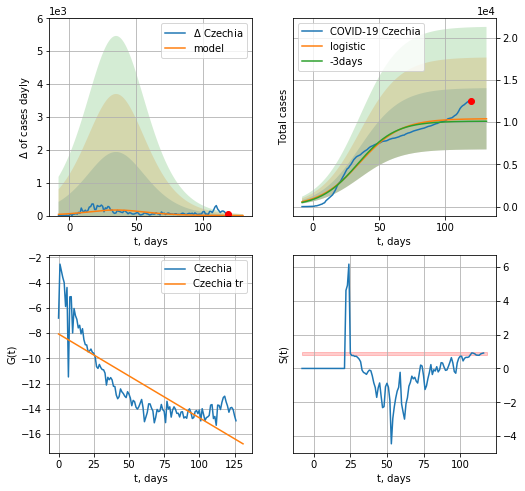

Czechia data at: 2020-07-06
+3 day model MAPE: 0.02768134657183268
model: logistic
coeffs:  [1.04227336e+04 6.51901219e-02 3.54938959e+01]
rational stdev:  0.34874292873868756
forecast at the end of period: +12 days
	 deltaDaycases:  1
	 total cases:  10402 ± 3627
	 total death:  289 ± 302
trend coefficient of determination: 0.653287
 intercept: -8.068135
 slope: -0.066449


In [270]:
x = forecast('Czechia',dfCH[:],d1,16*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


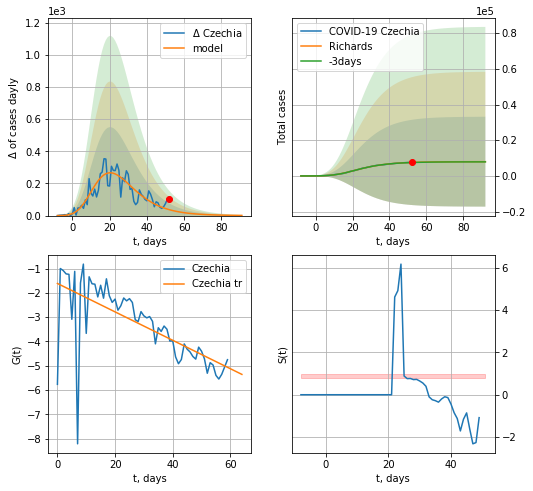

Czechia data at: 2020-07-06
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936728e+03  1.90702295e+00 -1.17113715e+01  4.87284384e-02]
rational stdev: 3.153560
forecast at the end of period: +40 days
	 deltaDaycases: 1
	 total cases: 7978 ± 25161
	 total death: 222 ± 2100
trend coefficient of determination: 0.449014
 intercept: -1.614154
 slope: -0.058414


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


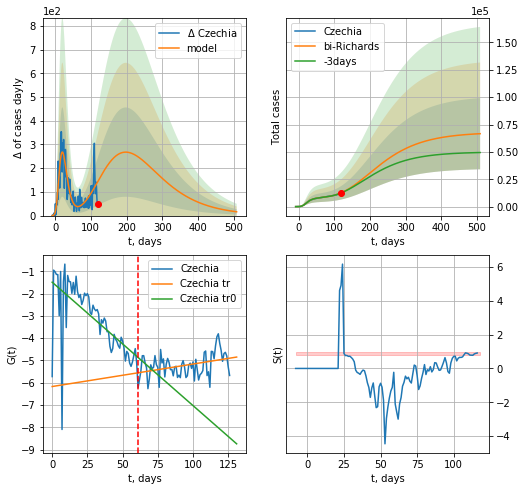

Czechia data at: 2020-07-06
+3 day model MAPE: 0.008128
model: bi-Richards
coeffs: [ 5.99772631e+04  6.83269125e-01 -1.30338049e+02  1.79171597e-02]
rational stdev: 0.488126
forecast at the end of period: +390 days
	 deltaDaycases: 16
	 total cases: 66646 ± 32531
	 total death: 1856 ± 2717
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.429252
 intercept: -1.491388
 slope: -0.055368
trend coefficient of determination: 0.132443
 intercept: -6.173506
 slope: 0.010094


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


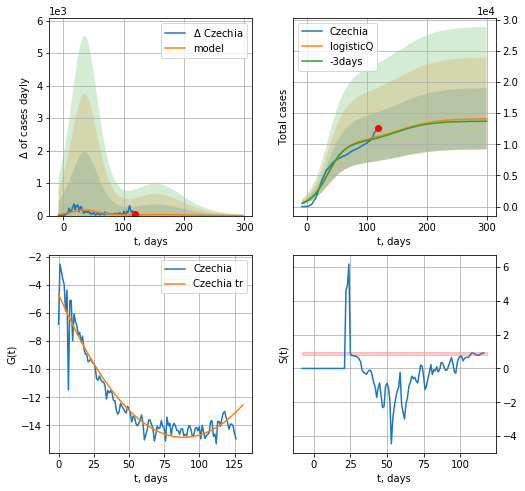

Czechia data at: 2020-07-06
+3 day model MAPE: 0.019081
model: logisticQ
coeffs: [ 1.04228457e+04  7.96219602e-08  3.54960276e+01 -8.18417258e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348773
forecast at the end of period: +180 days
	 deltaDaycases: 1
	 total cases: 14082 ± 4911
	 total death: 392 ± 410
trend coefficient of determination: 0.919268
 intercept_: -4.674033697122918
 coeffs_: [ 0.         -0.2293688   0.00129302]


In [271]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

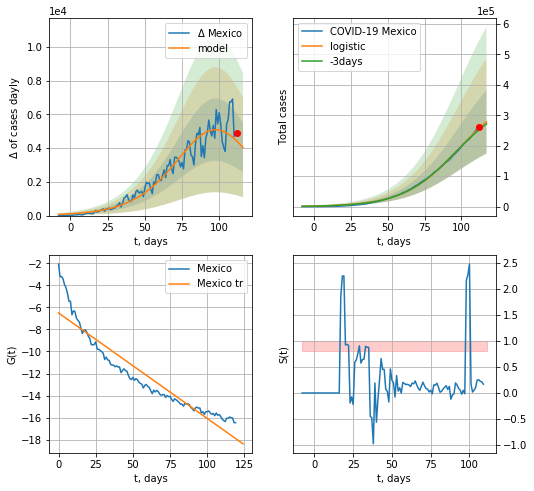

Mexico data at: 2020-07-06
+3 day model MAPE: 0.019576505658794586
model: logistic
coeffs:  [3.75293138e+05 5.40063293e-02 9.78255164e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37342065698806604
forecast at the end of period: +5 days
	 deltaDaycases:  4037
	 total cases:  278284 ± 103917
	 total death:  33084 ± 37062
trend coefficient of determination: 0.887379
 intercept: -6.512538
 slope: -0.095663


In [272]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


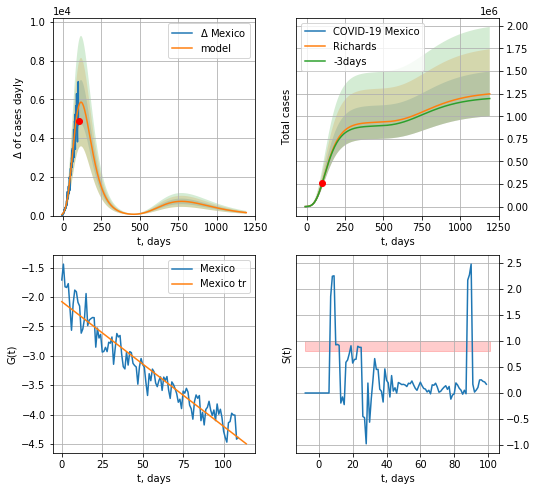

Mexico data at: 2020-07-06
+3 day model MAPE: 0.004159
model: Richards
coeffs: [ 9.35101937e+05  5.21199778e-01 -7.95907714e+01  3.31880081e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.198183
forecast at the end of period: +1090 days
	 deltaDaycases: 153
	 total cases: 1246990 ± 247131
	 total death: 148252 ± 88142
trend coefficient of determination: 0.914792
 intercept: -2.079484
 slope: -0.021209


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


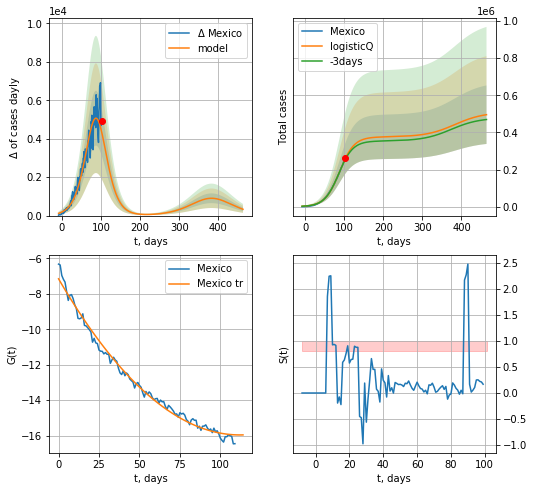

Mexico data at: 2020-07-06
+3 day model MAPE: 0.019783
model: logisticQ
coeffs: [ 3.75741569e+05  1.10143098e-06  8.78761239e+01 -4.89023055e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318253
forecast at the end of period: +362 days
	 deltaDaycases: 328
	 total cases: 495492 ± 157691
	 total death: 58908 ± 56242
trend coefficient of determination: 0.989630
 intercept_: -7.15147451631187
 coeffs_: [ 0.         -0.1572271   0.00070159]


In [273]:
x = forecastRR('Mexico',dfMX[10:],d1,170*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
115 2020-07-02  1828.0     199   78.0  436679.0
116 2020-07-03  1831.0     196   79.0  439451.0
117 2020-07-04  1836.0     201   79.0  442242.0
118 2020-07-05  1841.0     215   79.0       NaN
119 2020-07-06  1841.0     215   79.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


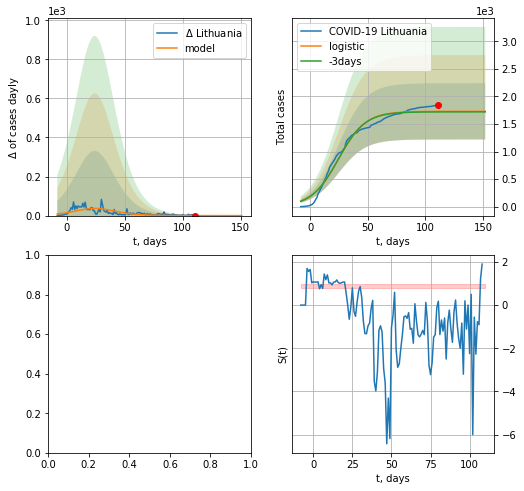

In [274]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [275]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [276]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

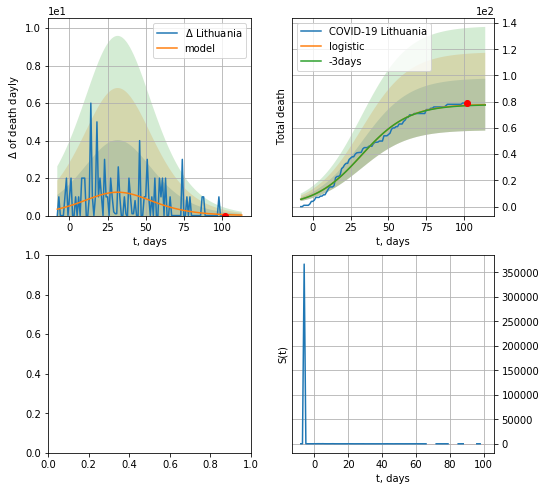

In [277]:
x = forecast('Lithuania',dfLT[9:],d1,7*16-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


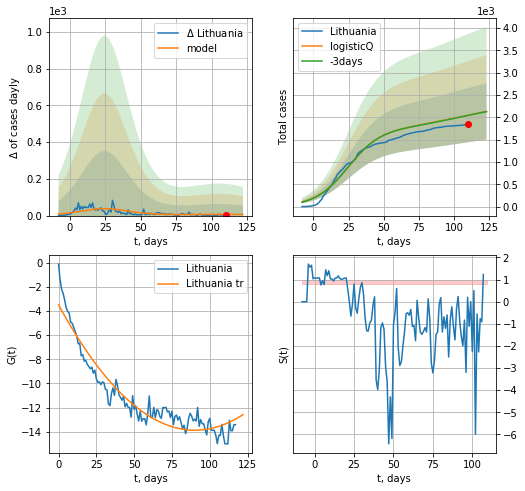

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.002185
model: logisticQ
coeffs: [ 1.72637458e+03  1.54029613e-07  2.46651665e+01 -5.55903111e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.296143
forecast at the end of period: +13 days
	 deltaDaycases: 5
	 total cases: 2130 ± 630
	 total death: 91 ± 80
trend coefficient of determination: 0.910336
 intercept_: -3.484369161612732
 coeffs_: [ 0.         -0.23061485  0.00127869]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


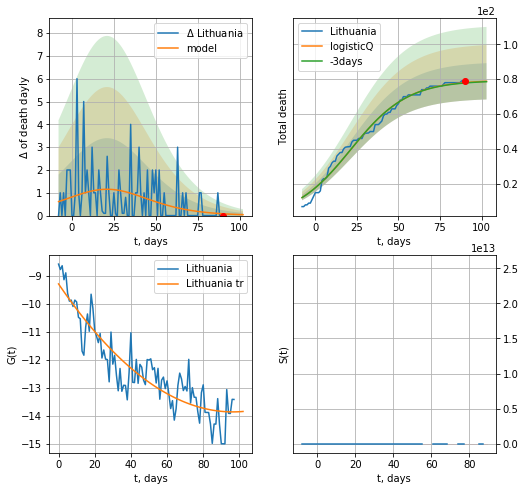

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.002474
model: logisticQ
coeffs: [ 7.94622943e+01  3.66832307e-07  2.13644047e+01 -1.58336505e+05]
rational stdev: 0.131891
forecast at the end of period: +13 days
	 total death: 78 ± 10
trend coefficient of determination: 0.824080
 intercept_: -9.298570460735519
 coeffs_: [ 0.         -0.09486708  0.00049211]


In [707]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


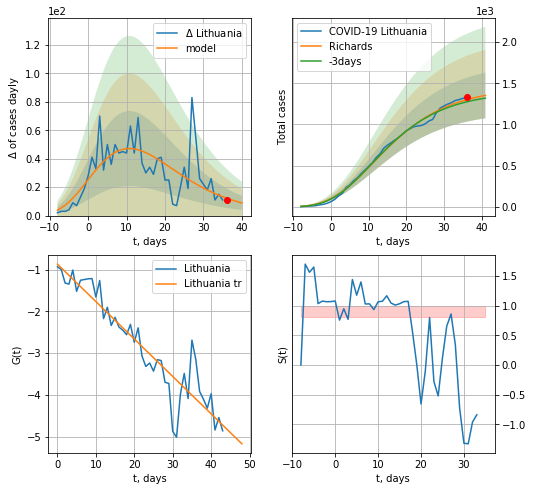

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +5 days
	 deltaDaycases: 8
	 total cases: 1352 ± 277
	 total death: 58 ± 35
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


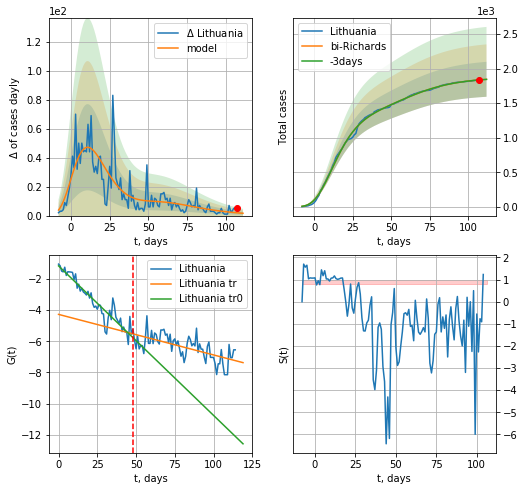

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.000681
model: bi-Richards
coeffs: [4.23793057e+02 6.09551655e-01 1.52250587e+01 8.53818953e-02]
rational stdev: 0.136975
forecast at the end of period: +5 days
	 deltaDaycases: 1
	 total cases: 1844 ± 252
	 total death: 79 ± 32
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.885754
 intercept: -1.167158
 slope: -0.095886
trend coefficient of determination: 0.409217
 intercept: -4.277462
 slope: -0.026004


In [708]:
vL = 48+3
x = forecastRR('Lithuania',dfLT[3:vL-3],d1,15*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,15*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-3)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


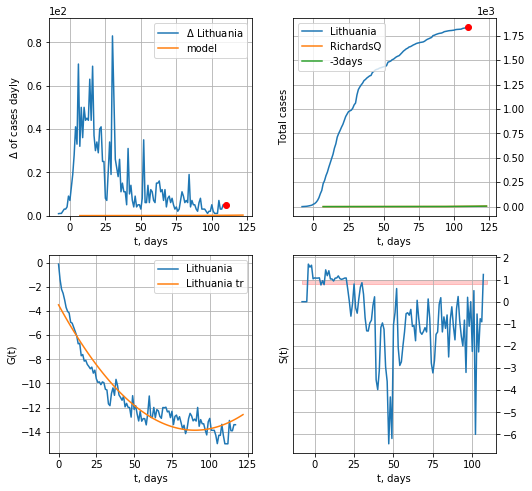

Lithuania data at: 2020-07-05
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 4.54139979e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +13 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [709]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
117 2020-07-02  4395.0     273  110.0
118 2020-07-03  4447.0     321  110.0
119 2020-07-04  4476.0     350  110.0
120 2020-07-05  4522.0     396  110.0
121 2020-07-06  4542.0     416  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


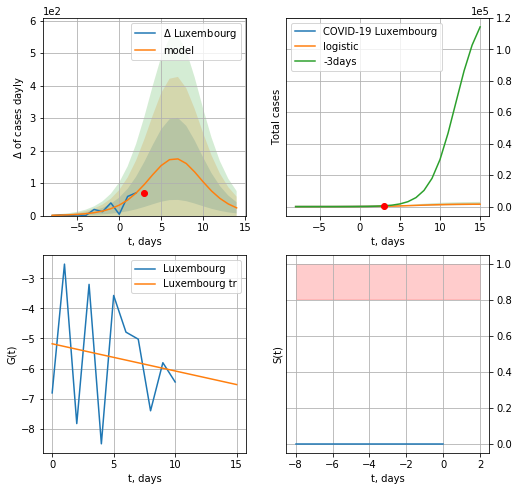

Luxembourg data at: 2020-07-06
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +12 days
	 deltaDaycases:  23
	 total cases:  1519 ± 488
	 total death:  36 ± 34
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


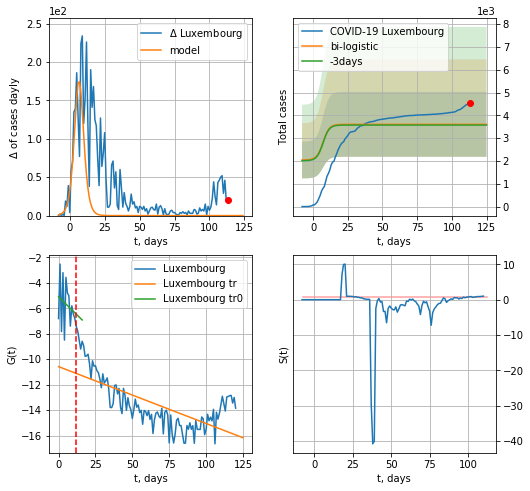

Luxembourg data at: 2020-07-06
+3 day model MAPE: 0.008991482456816845
model: bi-logistic
coeffs:  [1816.97665043   -6.93478578  252.40797393] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.39432965656942254
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  3607 ± 1422
	 total death:  87 ± 102
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.476679
 intercept: -10.582906
 slope: -0.044702


In [278]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,16*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,16*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


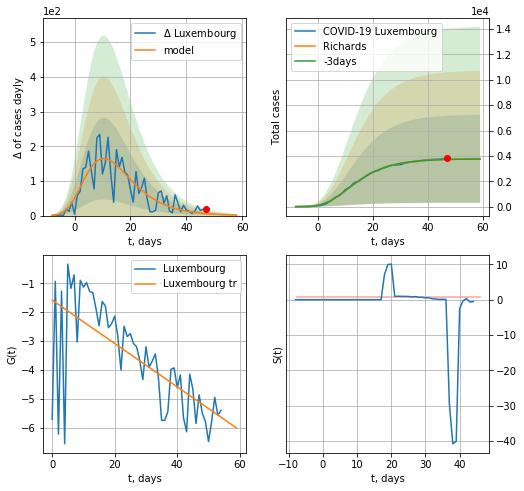

Luxembourg data at: 2020-07-06
+3 day model MAPE: 0.005356
model: Richards
coeffs: [ 3.78502225e+03  1.91067654e+01 -3.19452380e+01  6.20573313e-03]
rational stdev: 0.918930
forecast at the end of period: +12 days
	 deltaDaycases: 1
	 total cases: 3772 ± 3466
	 total death: 91 ± 250
trend coefficient of determination: 0.450994
 intercept: -1.583354
 slope: -0.075162


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


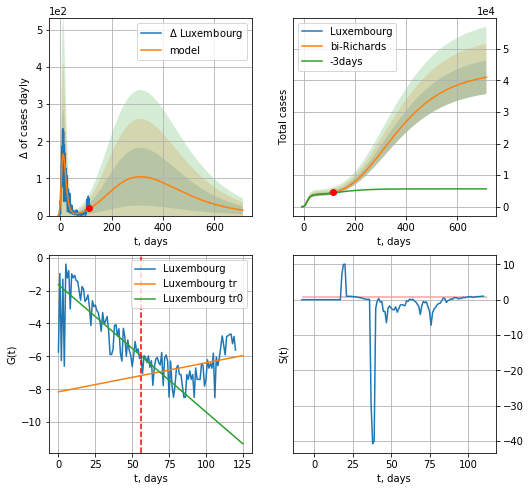

Luxembourg data at: 2020-07-06
+3 day model MAPE: 0.024646
model: bi-Richards
coeffs: [ 3.92481094e+04  3.20094432e-01 -2.01984154e+02  2.29135418e-02]
rational stdev: 0.129760
forecast at the end of period: +600 days
	 deltaDaycases: 14
	 total cases: 41003 ± 5320
	 total death: 993 ± 386
bi-Richards approximation splitting point: 56
trend coefficient of determination: 0.482668
 intercept: -1.641683
 slope: -0.077395
trend coefficient of determination: 0.105229
 intercept: -8.154835
 slope: 0.017644


In [290]:
vL = 56
x = forecastRR("Luxembourg",dfLX[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


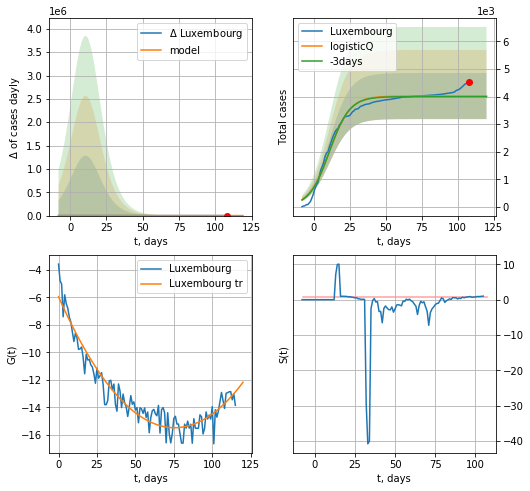

Luxembourg data at: 2020-07-06
+3 day model MAPE: 0.005899
model: logisticQ
coeffs: [ 4.01702800e+03  3.21819291e-07  1.10807247e+01 -4.36782875e+05]
rational stdev: 0.208072
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 4017 ± 835
	 total death: 97 ± 60
trend coefficient of determination: 0.918645
 intercept_: -5.948408264076172
 coeffs_: [ 0.         -0.25230399  0.00167047]


In [291]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
124 2020-07-02  59468.0  26797.0  4639.0
125 2020-07-03  60657.0  27566.0  4700.0
126 2020-07-04  61535.0  28259.0  4769.0
127 2020-07-05  61958.0  28455.0  4781.0
128 2020-07-06  62380.0  28687.0  4821.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


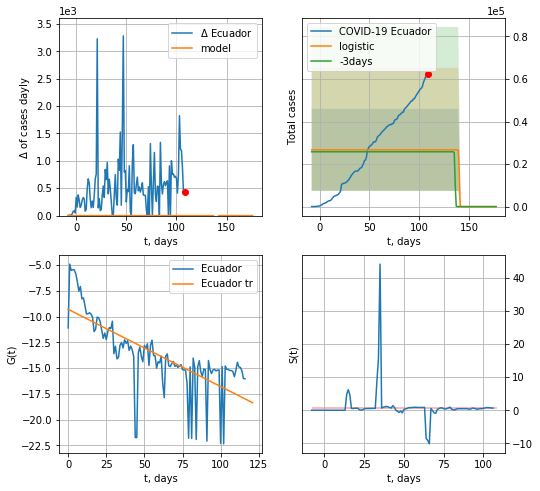

Ecuador data at: 2020-07-06
+3 day model MAPE: 0.035683470744755016
model: logistic
coeffs:  [ 2.66973988e+04 -4.90294916e+00  1.40108957e+02]
rational stdev:  0.7216210570576082
forecast at the end of period: +68 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.527883
 intercept: -9.291238
 slope: -0.074990


In [292]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


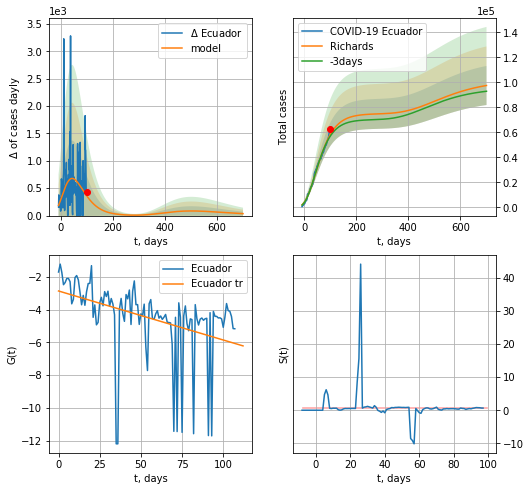

Ecuador data at: 2020-07-06
+3 day model MAPE: 0.023850
model: Richards
coeffs: [ 7.49679553e+04  1.57121665e+00 -1.22703819e+02  1.57810160e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.160169
forecast at the end of period: +600 days
	 deltaDaycases: 35
	 total cases: 97528 ± 15621
	 total death: 7537 ± 3621
trend coefficient of determination: 0.164447
 intercept: -2.870982
 slope: -0.029851


In [293]:
x = forecastRR("Ecuador",dfED[20:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


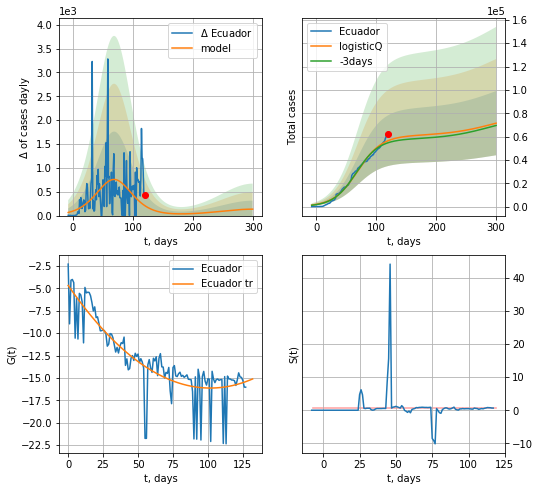

Ecuador data at: 2020-07-06
+3 day model MAPE: 0.032910
model: logisticQ
coeffs: [ 6.07154633e+04  1.75464812e-07  6.87891041e+01 -2.83755223e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384533
forecast at the end of period: +180 days
	 deltaDaycases: 134
	 total cases: 71490 ± 27490
	 total death: 5525 ± 6373
trend coefficient of determination: 0.726394
 intercept_: -4.678430251568848
 coeffs_: [ 0.         -0.22531061  0.00110784]


In [294]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
128 2020-07-02  7241.5     213  328.0
129 2020-07-03  7242.0     213  329.0
130 2020-07-04  7248.0     219  329.0
131 2020-07-05  7253.0     224  329.0
132 2020-07-06  7257.0     228  329.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


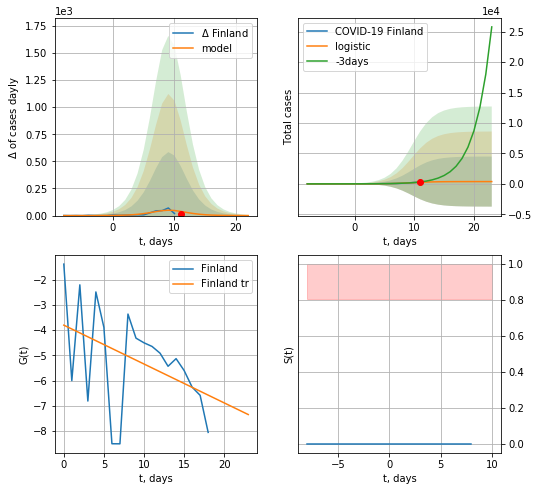

Finland data at: 2020-07-06
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  372 ± 4112
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


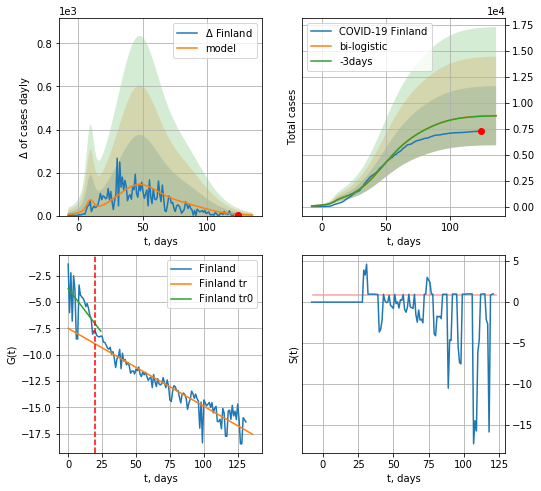

Finland data at: 2020-07-06
+3 day model MAPE: 0.0019124255297539726
model: bi-logistic
coeffs:  [6.73809439e+03 8.22068551e-02 4.69371187e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.32512464114830597
forecast at the end of period: +12 days
	 deltaDaycases:  2
	 total cases:  8767 ± 2850
	 total death:  397 ± 387
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.897952
 intercept: -7.491739
 slope: -0.074058


In [295]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*16-dT)
xx = forecast2("Finland",dfFI[:],d1,16*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


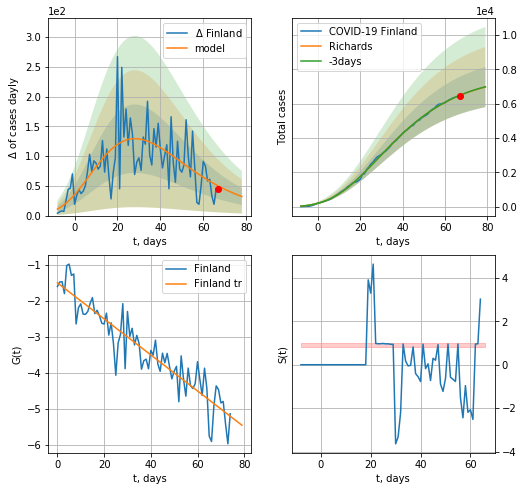

Finland data at: 2020-07-06
+3 day model MAPE: 0.001636
model: Richards
coeffs: [ 7.67975998e+03  2.65386989e+00 -5.92221329e+01  1.73850507e-02]
rational stdev: 0.167365
forecast at the end of period: +12 days
	 deltaDaycases: 32
	 total cases: 6965 ± 1165
	 total death: 315 ± 158
trend coefficient of determination: 0.854396
 intercept: -1.508202
 slope: -0.049971


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


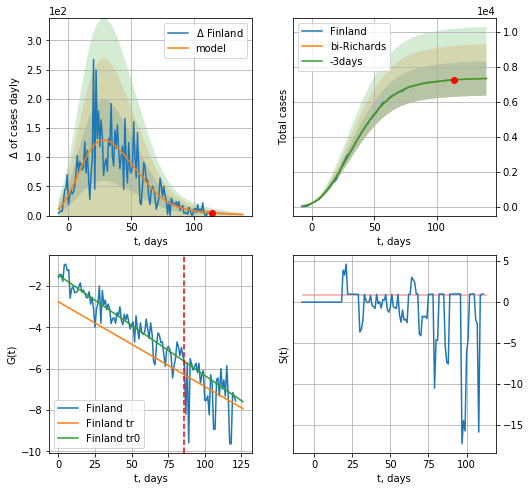

Finland data at: 2020-07-06
+3 day model MAPE: 0.000061
model: bi-Richards
coeffs: [-3.02643841e+02  1.14594946e+01  5.05382713e+00  5.97745350e-03]
rational stdev: 0.133883
forecast at the end of period: +26 days
	 deltaDaycases: 1
	 total cases: 7337 ± 982
	 total death: 332 ± 133
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.874883
 intercept: -1.469229
 slope: -0.048593
trend coefficient of determination: 0.129176
 intercept: -2.761720
 slope: -0.041022


In [297]:
vL = 86 + 10
x = forecastRR("Finland",dfFI[10:vL-10],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


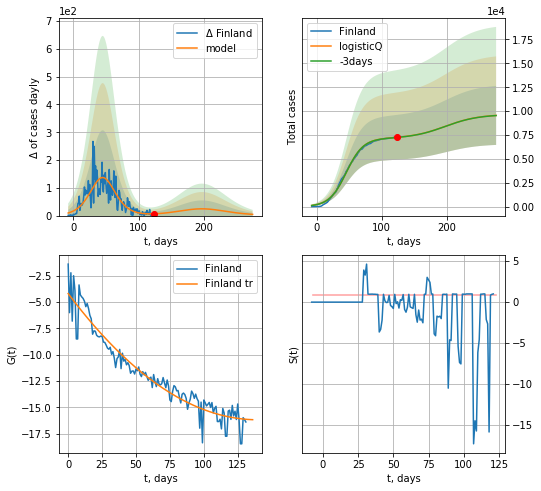

Finland data at: 2020-07-06
+3 day model MAPE: 0.001751
model: logisticQ
coeffs: [ 7.13910059e+03  3.63103991e-07  4.53289926e+01 -2.11045373e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.323478
forecast at the end of period: +152 days
	 deltaDaycases: 4
	 total cases: 9550 ± 3089
	 total death: 432 ± 419
trend coefficient of determination: 0.922796
 intercept_: -4.187930718901818
 coeffs_: [ 0.         -0.17169838  0.0006144 ]


In [298]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
114 2020-07-02   5315  2281.0  232.0
115 2020-07-03   5497  2366.0  239.0
116 2020-07-04   5677  2538.0  241.0
117 2020-07-05   5740  2579.0  246.0
118 2020-07-06   5914  2664.0  250.0


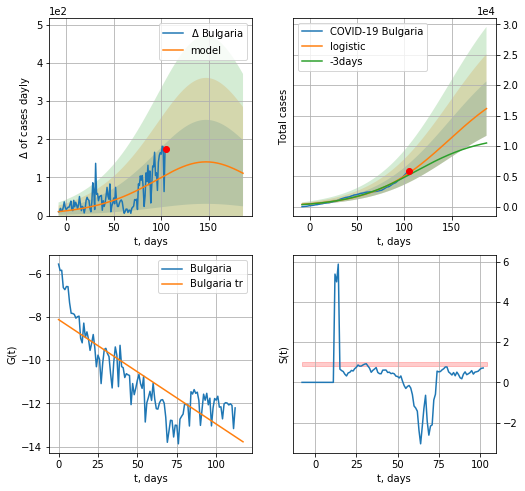

Bulgaria data at: 2020-07-06
+3 day model MAPE: 0.05975581417644193
model: logistic
coeffs:  [2.20369094e+04 2.55655096e-02 1.47563227e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.27712894414733447
forecast at the end of period: +82 days
	 deltaDaycases:  111
	 total cases:  16147 ± 4474
	 total death:  682 ± 567
trend coefficient of determination: 0.705056
 intercept: -8.125875
 slope: -0.048310


In [299]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


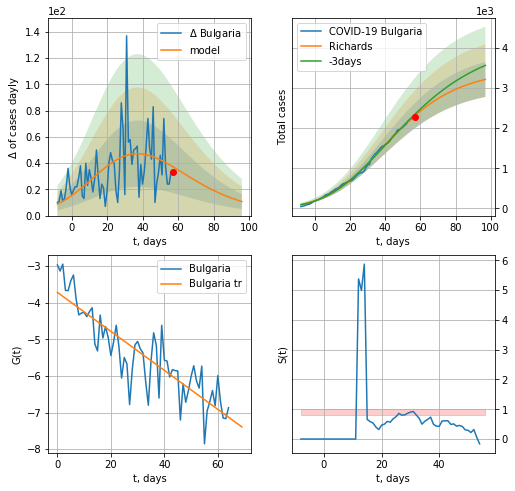

Bulgaria data at: 2020-07-06
+3 day model MAPE: 0.017234
model: Richards
coeffs: [3.47700933e+03 1.26494372e-01 1.24703961e+01 3.39631762e-01]
rational stdev: 0.135837
forecast at the end of period: +40 days
	 deltaDaycases: 10
	 total cases: 3219 ± 437
	 total death: 136 ± 55
trend coefficient of determination: 0.758376
 intercept: -3.716230
 slope: -0.053312


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


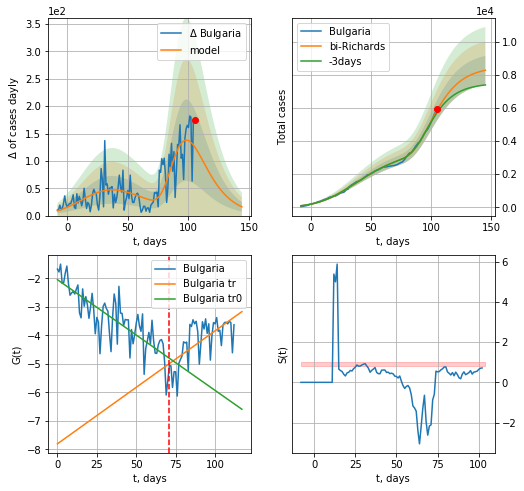

Bulgaria data at: 2020-07-06
+3 day model MAPE: 0.027841
model: bi-Richards
coeffs: [5.03503721e+03 5.97643669e+00 3.54283155e+01 1.16532992e-02]
rational stdev: 0.105400
forecast at the end of period: +40 days
	 deltaDaycases: 15
	 total cases: 8272 ± 871
	 total death: 349 ± 110
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.674030
 intercept: -2.046679
 slope: -0.038863
trend coefficient of determination: 0.436602
 intercept: -7.806991
 slope: 0.039644


In [300]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,20*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


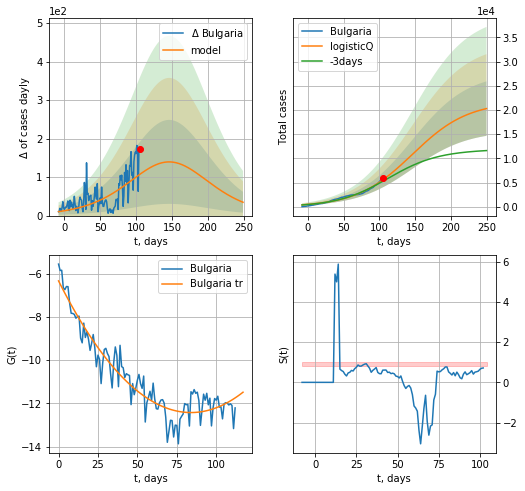

Bulgaria data at: 2020-07-06
+3 day model MAPE: 0.058043
model: logisticQ
coeffs: [ 2.16113403e+04  9.03535321e-07  1.46254348e+02 -2.83837023e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.277213
forecast at the end of period: +145 days
	 deltaDaycases: 34
	 total cases: 20281 ± 5622
	 total death: 857 ± 712
trend coefficient of determination: 0.896556
 intercept_: -6.337995019085433
 coeffs_: [ 0.         -0.1449547   0.00086291]


In [301]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
126 2020-07-02  3180.0    56.0   58.0
127 2020-07-03  3185.0    61.0   58.0
128 2020-07-04  3190.0    61.0   58.0
129 2020-07-05  3195.0    65.0   58.0
130 2020-07-06  3195.0    65.0   58.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


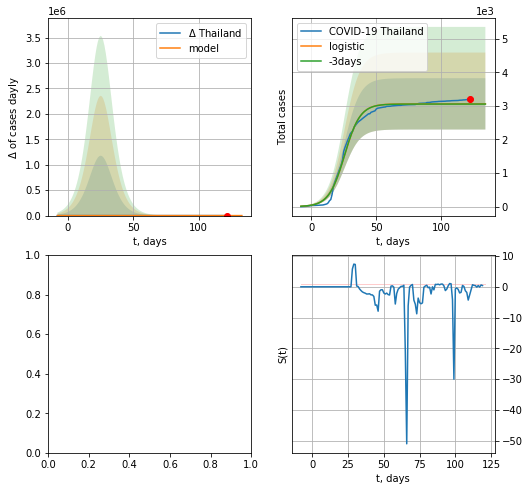

In [302]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [303]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


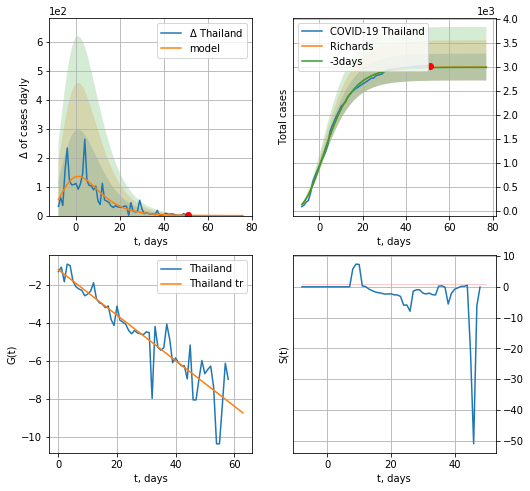

Thailand data at: 2020-07-06
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +26 days
	 deltaDaycases: 0
	 total cases: 2995 ± 279
	 total death: 54 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

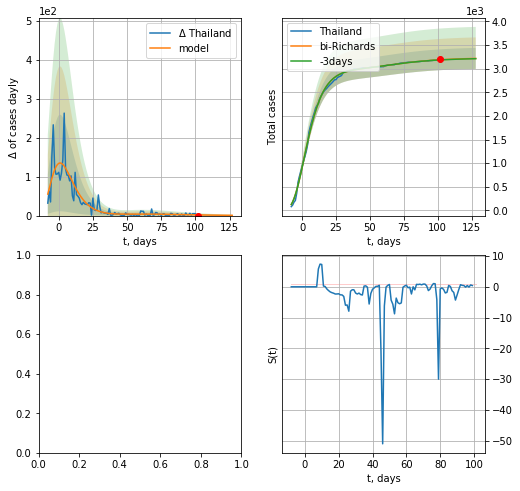

In [304]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


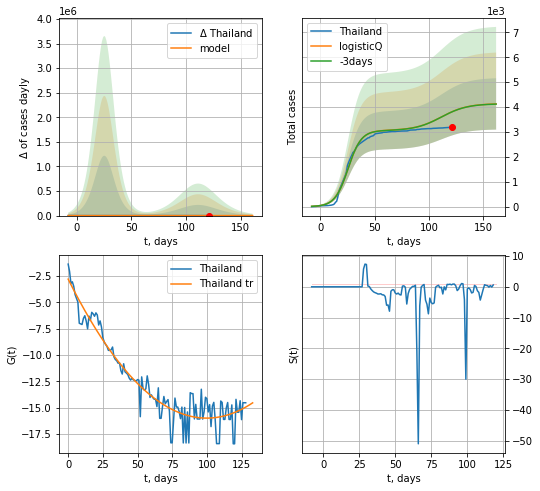

Thailand data at: 2020-07-05
+3 day model MAPE: 0.000752
model: logisticQ
coeffs: [ 3.05962998e+03  5.24444726e-07  2.55744537e+01 -3.15588324e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.249892
forecast at the end of period: +41 days
	 deltaDaycases: 1
	 total cases: 4127 ± 1031
	 total death: 74 ± 55
trend coefficient of determination: 0.914012
 intercept_: -2.8098181938452633
 coeffs_: [ 0.         -0.26386358  0.00132098]


In [729]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

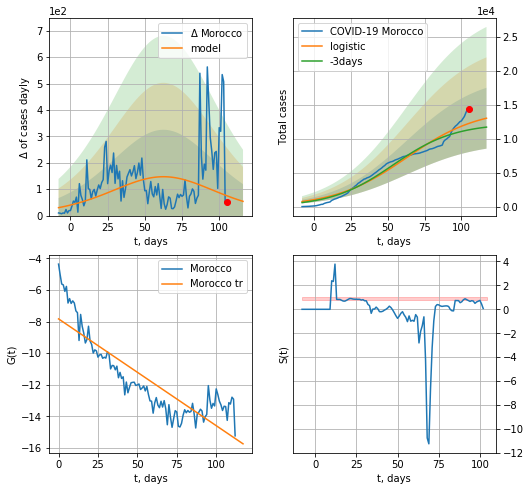

Morocco data at: 2020-07-06
+3 day model MAPE: 0.08597856682423403
model: logistic
coeffs:  [1.44848512e+04 4.06483209e-02 6.29882831e+01]
rational stdev:  0.3438535933104446
forecast at the end of period: +12 days
	 deltaDaycases:  53
	 total cases:  13034 ± 4481
	 total death:  214 ± 220
trend coefficient of determination: 0.754731
 intercept: -7.829728
 slope: -0.067596


In [305]:
x = forecast("Morocco",dfMR[5:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


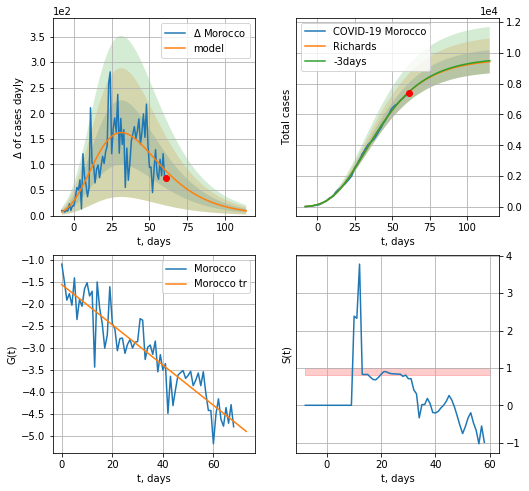

Morocco data at: 2020-07-06
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62196675e+03  2.25668236e+00 -5.19496574e+01  2.05516980e-02]
rational stdev: 0.079909
forecast at the end of period: +54 days
	 deltaDaycases: 9
	 total cases: 9421 ± 752
	 total death: 155 ± 37
trend coefficient of determination: 0.846109
 intercept: -1.563197
 slope: -0.045646


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


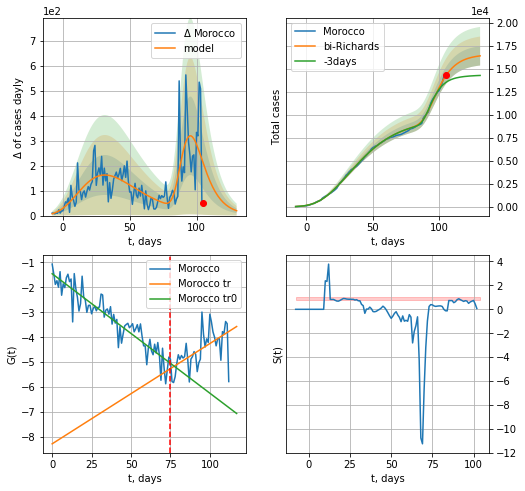

Morocco data at: 2020-07-06
+3 day model MAPE: 0.060187
model: bi-Richards
coeffs: [7.03793838e+03 9.67719659e+00 5.78853322e+01 1.19677931e-02]
rational stdev: 0.063939
forecast at the end of period: +26 days
	 deltaDaycases: 19
	 total cases: 16441 ± 1051
	 total death: 270 ± 51
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.861204
 intercept: -1.455718
 slope: -0.047850
trend coefficient of determination: 0.346595
 intercept: -8.269729
 slope: 0.040170


In [306]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


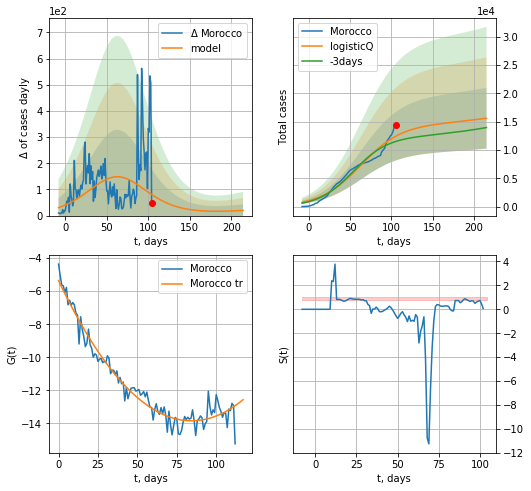

Morocco data at: 2020-07-06
+3 day model MAPE: 0.081598
model: logisticQ
coeffs: [ 1.44815118e+04  1.26863686e-07  6.29762051e+01 -3.20352080e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343864
forecast at the end of period: +110 days
	 deltaDaycases: 19
	 total cases: 15623 ± 5372
	 total death: 257 ± 265
trend coefficient of determination: 0.955055
 intercept_: -5.356741567354914
 coeffs_: [ 0.         -0.20127455  0.00119357]


In [307]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

RM
           date    cases  active   death
127 2020-07-02  27746.0  5626.0  1687.0
128 2020-07-03  28166.0  6913.0  1708.0
129 2020-07-04  28582.0  6997.0  1731.0
130 2020-07-05  29223.0  7242.0  1768.0
131 2020-07-06  29223.0  7242.0  1768.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

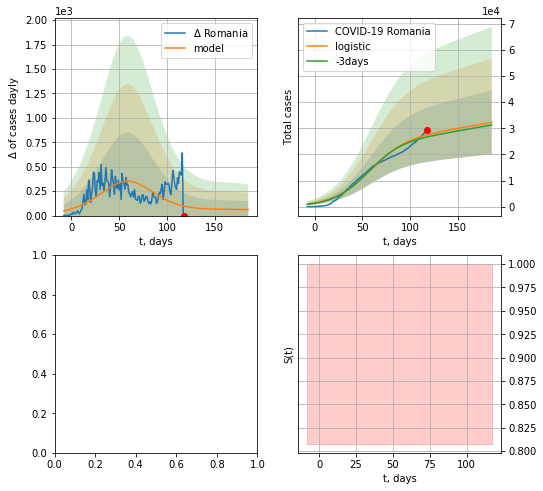

In [309]:
dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


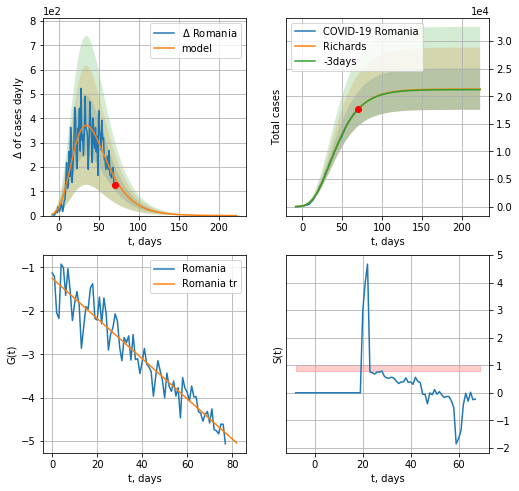

Romania data at: 2020-07-05
+3 day model MAPE: 0.002257
model: Richards
coeffs: [ 2.13025472e+04  3.80217834e+00 -5.67257576e+01  1.25517845e-02]
rational stdev: 0.176275
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 21299 ± 3754
	 total death: 1288 ± 681
trend coefficient of determination: 0.908515
 intercept: -1.251895
 slope: -0.046188


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


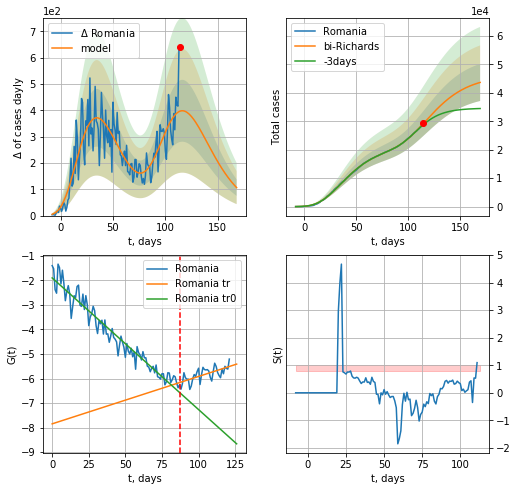

Romania data at: 2020-07-05
+3 day model MAPE: 0.015490
model: bi-Richards
coeffs: [2.48301407e+04 3.27960106e-01 7.27787453e+01 1.34891650e-01]
rational stdev: 0.149089
forecast at the end of period: +55 days
	 deltaDaycases: 106
	 total cases: 43637 ± 6505
	 total death: 2640 ± 1180
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.939534
 intercept: -1.899080
 slope: -0.053661
trend coefficient of determination: 0.448583
 intercept: -7.846174
 slope: 0.019318


In [734]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,22*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


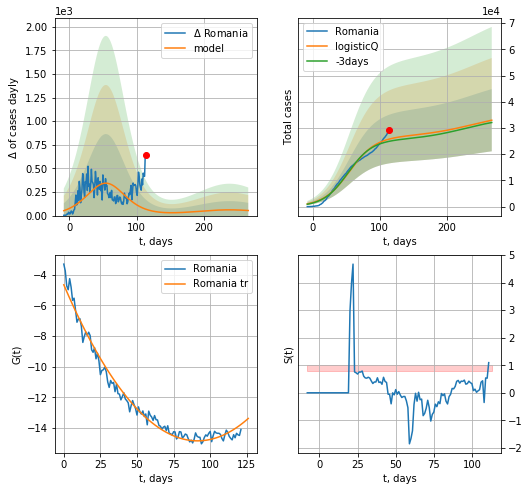

Romania data at: 2020-07-05
+3 day model MAPE: 0.034487
model: logisticQ
coeffs: [ 2.66041249e+04  1.37485582e-07  5.47953445e+01 -3.73594318e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359869
forecast at the end of period: +153 days
	 deltaDaycases: 53
	 total cases: 32957 ± 11860
	 total death: 1993 ± 2151
trend coefficient of determination: 0.980025
 intercept_: -4.65017708764728
 coeffs_: [ 0.         -0.2230907   0.00122056]


In [735]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [736]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
145 2020-07-02  1295336  158991  133481.0
146 2020-07-03  1299510  160692  133614.0
147 2020-07-04  1302059  161413  133687.0
148 2020-07-05  1304731  161088  133771.0
149 2020-07-06  1310539  162595  133845.0


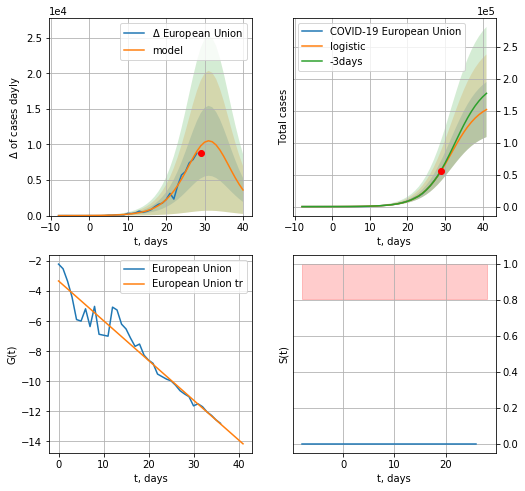

European Union data at: 2020-07-06
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +12 days
	 deltaDaycases:  3602
	 total cases:  151892 ± 43107
	 total death:  15512 ± 13206
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


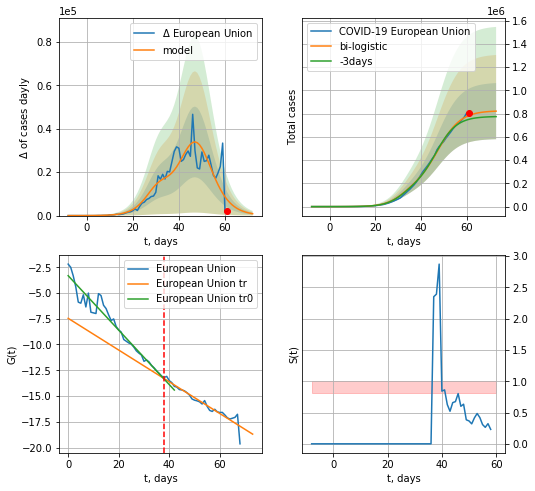

European Union data at: 2020-07-06
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +12 days
	 deltaDaycases:  877
	 total cases:  821269 ± 241526
	 total death:  83876 ± 74000
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


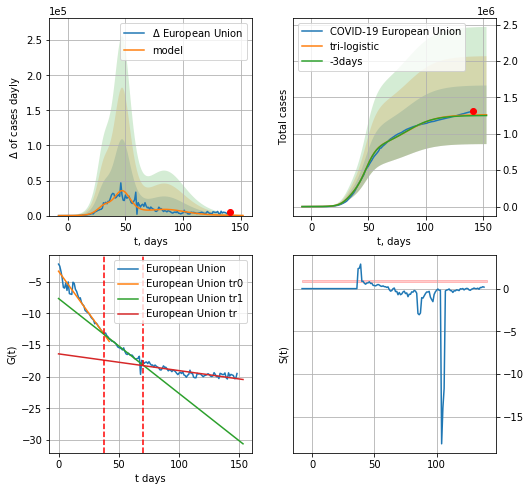

European Union data at: 2020-07-06
+3 day model MAPE: 0.007794889185949442
model: tri-logistic
coeffs:  [4.38187338e+05 8.06016409e-02 8.46404429e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.31904292891104463
forecast at the end of period: +12 days
	 deltaDaycases:  147
	 total cases:  1261641 ± 402517
	 total death:  128851 ± 123327
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.703836
 intercept: -16.397352
 slope: -0.026490


In [310]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,16*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,16*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


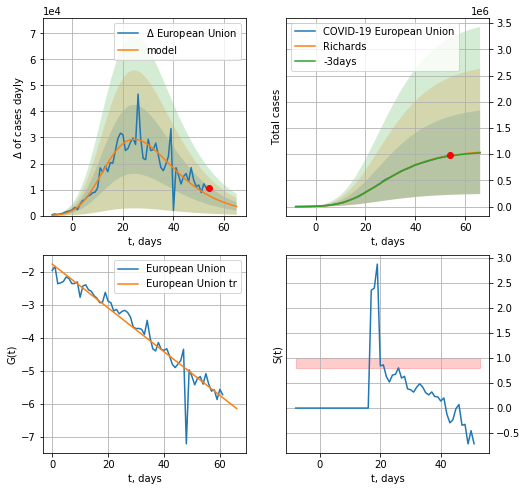

European Union data at: 2020-07-06
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +12 days
	 deltaDaycases: 3526
	 total cases: 1037015 ± 797030
	 total death: 105910 ± 244201
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


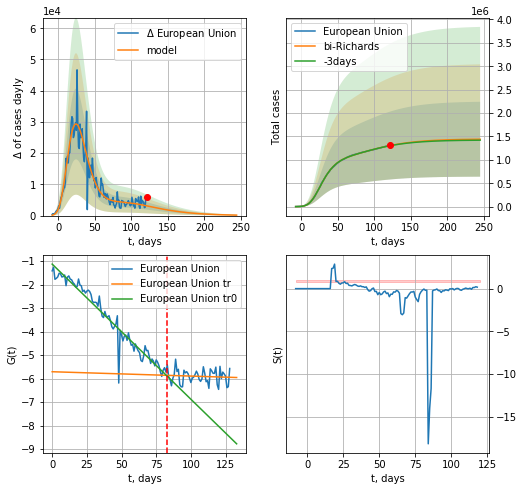

European Union data at: 2020-07-06
+3 day model MAPE: 0.002732
model: bi-Richards
coeffs: [ 3.63292310e+05  2.73704278e+00 -6.42767992e+01  1.03967586e-02]
rational stdev: 0.555568
forecast at the end of period: +124 days
	 deltaDaycases: 149
	 total cases: 1440427 ± 800255
	 total death: 147110 ± 245188
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943637
 intercept: -1.124197
 slope: -0.057488
trend coefficient of determination: 0.006811
 intercept: -5.703127
 slope: -0.001848


In [311]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


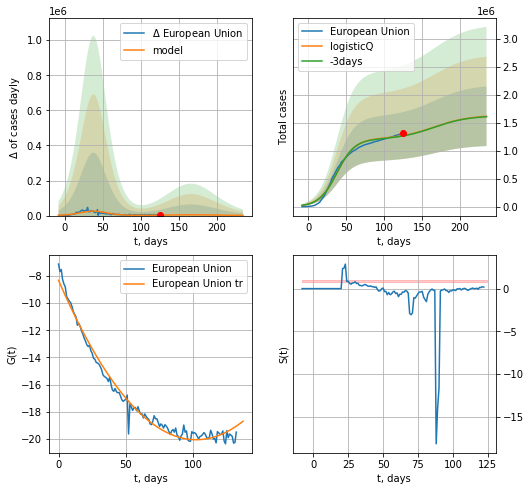

European Union data at: 2020-07-06
+3 day model MAPE: 0.005562
model: logisticQ
coeffs: [ 1.20904282e+06  1.80049247e-07  3.81085158e+01 -4.71830493e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329721
forecast at the end of period: +110 days
	 deltaDaycases: 885
	 total cases: 1615850 ± 532779
	 total death: 165026 ± 163237
trend coefficient of determination: 0.982026
 intercept_: -8.319914727078976
 coeffs_: [ 0.         -0.22994558  0.00112524]


In [312]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


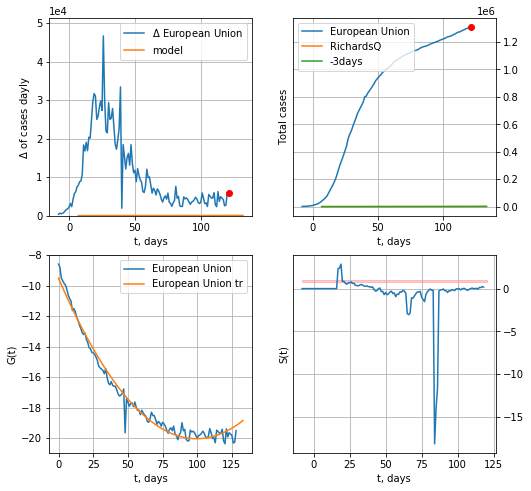

European Union data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.42779548e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: nan
forecast at the end of period: +12 days
	 deltaDaycases: 53


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [313]:
x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [287]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [288]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [289]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [290]:
#dfIC[:]

IC
           date   cases  active  death
123 2020-07-02  1850.0      12   10.0
124 2020-07-03  1855.0      13   10.0
125 2020-07-04  1860.0      17   10.0
126 2020-07-05  1863.0      20   10.0
127 2020-07-06  1866.0      16   10.0


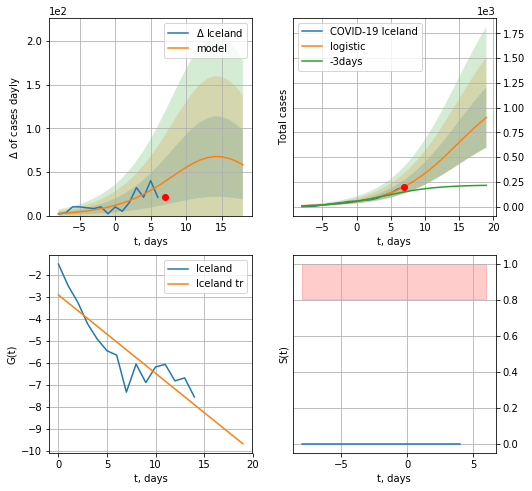

Iceland data at: 2020-07-06
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +12 days
	 deltaDaycases:  58
	 total cases:  902 ± 304
	 total death:  4 ± 4
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


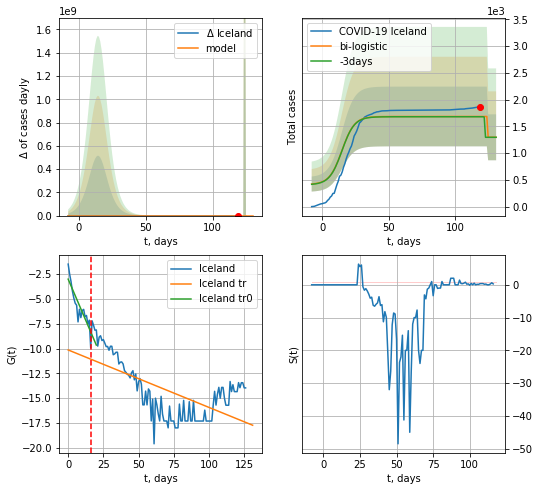

Iceland data at: 2020-07-06
+3 day model MAPE: 0.0030675494390688274
model: bi-logistic
coeffs:  [388.94773298 -15.30834506 124.51093747] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.3310346721919346
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1296 ± 429
	 total death:  6 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.407038
 intercept: -10.144654
 slope: -0.057846


In [314]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


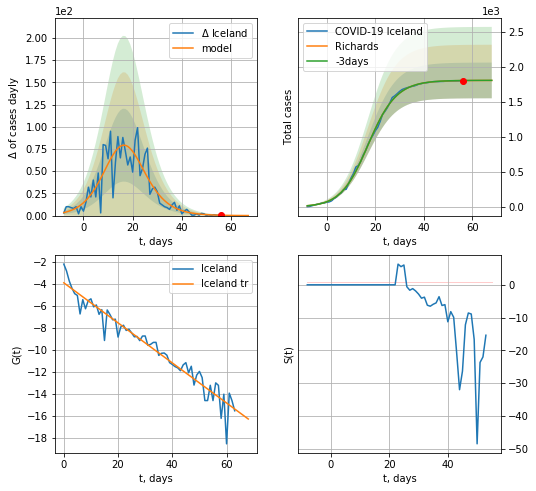

Iceland data at: 2020-07-06
+3 day model MAPE: 0.000574
model: Richards
coeffs: [1.80664071e+03 1.96329707e-01 1.60140797e+01 8.56236679e-01]
rational stdev: 0.141183
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1806 ± 255
	 total death: 9 ± 3
trend coefficient of determination: 0.937183
 intercept: -3.923109
 slope: -0.181532


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


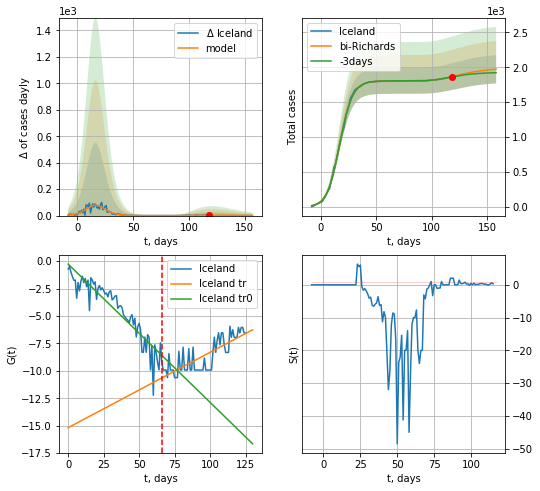

Iceland data at: 2020-07-06
+3 day model MAPE: 0.002500
model: bi-Richards
coeffs: [1.88821840e+02 3.40034734e+00 4.61676517e+01 1.62261140e-02]
rational stdev: 0.102564
forecast at the end of period: +40 days
	 deltaDaycases: 1
	 total cases: 1972 ± 202
	 total death: 10 ± 3
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.839136
 intercept: -0.273113
 slope: -0.125926
trend coefficient of determination: 0.614320
 intercept: -15.170386
 slope: 0.068592


In [315]:
vL = 66
x = forecastRR("Iceland",dfIC[1:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[1:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


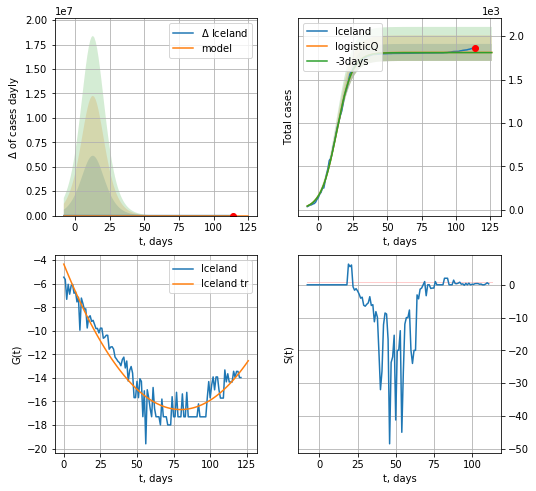

Iceland data at: 2020-07-06
+3 day model MAPE: 0.001095
model: logisticQ
coeffs: [ 1.81211167e+03  3.41671453e-06  1.34141446e+01 -5.12109568e+04]
rational stdev: 0.054132
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1812 ± 98
	 total death: 9 ± 1
trend coefficient of determination: 0.917566
 intercept_: -4.332313235368762
 coeffs_: [ 0.         -0.30955501  0.00193972]


In [316]:
x = forecastRRR("Iceland",dfIC[5:],d1,16*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active  death
114 2020-07-02  35237  18125.0  667.0
115 2020-07-03  35995  18352.0  698.0
116 2020-07-04  36983  18502.0  720.0
117 2020-07-05  38149  19416.0  747.0
118 2020-07-06  39334  20528.0  770.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


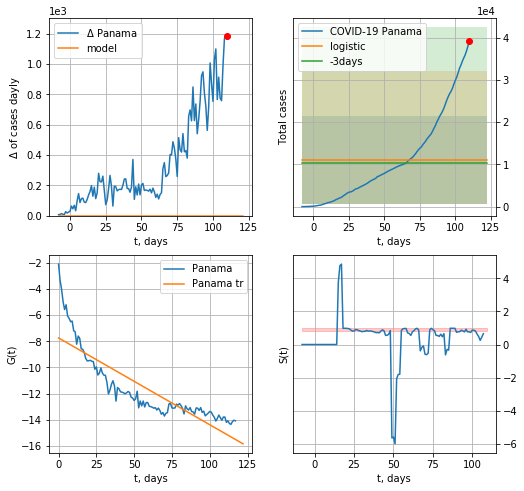

Panama data at: 2020-07-06
+3 day model MAPE: 0.06790790065425073
model: logistic
coeffs:  [ 1.10313781e+04 -9.06308941e+00  2.43445249e+02]
rational stdev:  0.9533891206247299
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  11031 ± 10517
	 total death:  215 ± 614
trend coefficient of determination: 0.740513
 intercept: -7.743815
 slope: -0.066362


In [317]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


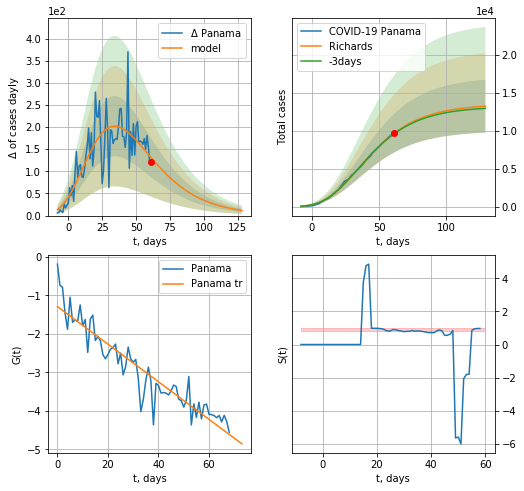

Panama data at: 2020-07-06
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +68 days
	 deltaDaycases: 11
	 total cases: 13211 ± 3476
	 total death: 258 ± 203
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


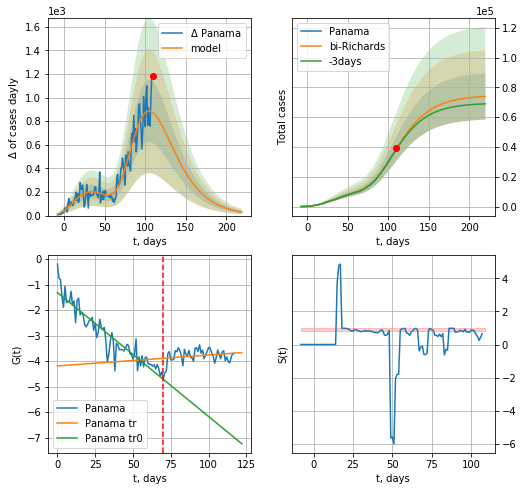

Panama data at: 2020-07-06
+3 day model MAPE: 0.010017
model: bi-Richards
coeffs: [6.12220019e+04 1.96357945e+00 3.93973623e+00 1.95812788e-02]
rational stdev: 0.210334
forecast at the end of period: +110 days
	 deltaDaycases: 30
	 total cases: 73937 ± 15551
	 total death: 1447 ± 913
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874635
 intercept: -1.308127
 slope: -0.048674
trend coefficient of determination: 0.049848
 intercept: -4.188995
 slope: 0.004289


In [318]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


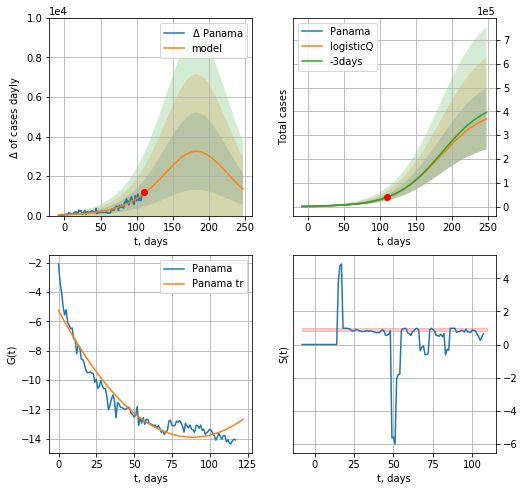

Panama data at: 2020-07-06
+3 day model MAPE: 0.002828
model: logisticQ
coeffs: [ 4.15984324e+05  2.43256570e-06  1.82655576e+02 -1.26699797e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348726
forecast at the end of period: +138 days
	 deltaDaycases: 1340
	 total cases: 368711 ± 128579
	 total death: 7217 ± 7550
trend coefficient of determination: 0.929485
 intercept_: -5.255037388087722
 coeffs_: [ 0.         -0.19509497  0.00110029]


In [319]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

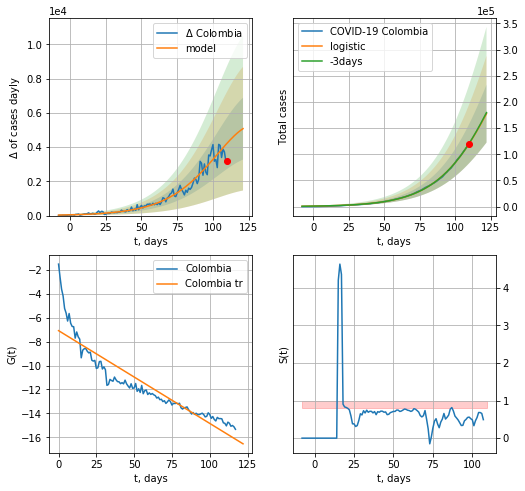

Colombia data at: 2020-07-06
+3 day model MAPE: 0.004671391096152048
model: logistic
coeffs:  [4.54280271e+05 4.72081271e-02 1.31394887e+02]
rational stdev:  0.3109446305205878
forecast at the end of period: +12 days
	 deltaDaycases:  5079
	 total cases:  177579 ± 55217
	 total death:  6215 ± 5797
trend coefficient of determination: 0.842193
 intercept: -7.073192
 slope: -0.077654


In [320]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,16*7-dT)

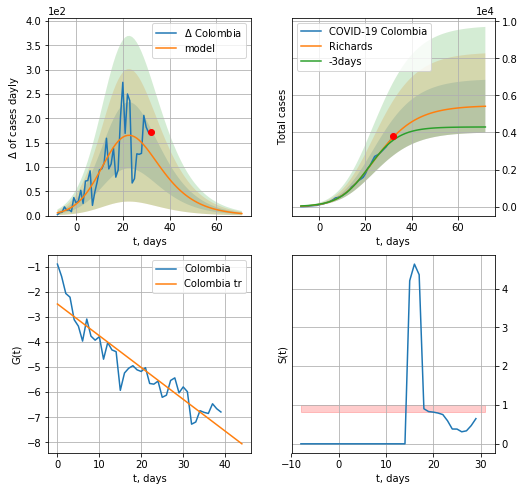

Colombia data at: 2020-07-06
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45323700e+03 2.23852153e-01 1.50939189e+01 4.47628300e-01]
rational stdev: 0.263661
forecast at the end of period: +40 days
	 deltaDaycases: 4
	 total cases: 5412 ± 1427
	 total death: 189 ± 149
trend coefficient of determination: 0.864435
 intercept: -2.485434
 slope: -0.126591


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


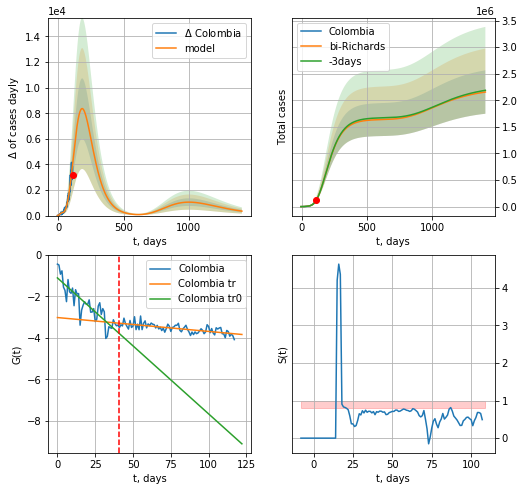

Colombia data at: 2020-07-06
+3 day model MAPE: 0.000943
model: bi-Richards
coeffs: [ 1.63550322e+06  3.69573992e-01 -4.77262463e+01  3.83375177e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.189437
forecast at the end of period: +1300 days
	 deltaDaycases: 348
	 total cases: 2156645 ± 408549
	 total death: 75485 ± 42899
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.762918
 intercept: -1.110919
 slope: -0.065493
trend coefficient of determination: 0.455239
 intercept: -3.020758
 slope: -0.006678


In [321]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,200*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


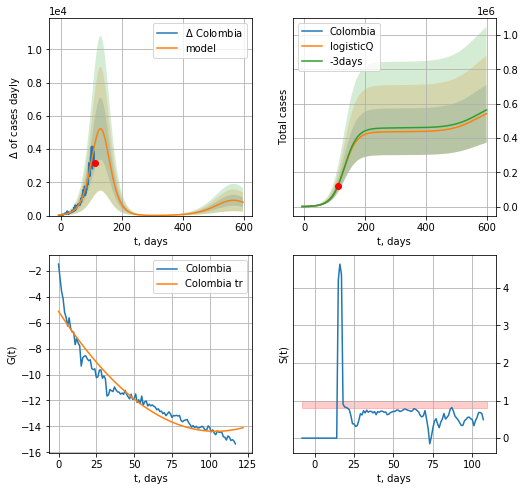

Colombia data at: 2020-07-06
+3 day model MAPE: 0.004185
model: logisticQ
coeffs: [ 4.35664255e+05  5.45974172e-06  1.29905232e+02 -8.65797457e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311851
forecast at the end of period: +488 days
	 deltaDaycases: 803
	 total cases: 540759 ± 168636
	 total death: 18927 ± 17707
trend coefficient of determination: 0.936891
 intercept_: -5.140122174299993
 coeffs_: [ 0.         -0.1776429   0.00085462]


In [322]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active  death
120 2020-07-02  14657.0  3387.0  928.0
121 2020-07-03  15070.0  3301.0  937.0
122 2020-07-04  15500.0  3373.0  946.0
123 2020-07-05  15941.0  3497.0  952.0
124 2020-07-06  16404.0  3561.0  959.0


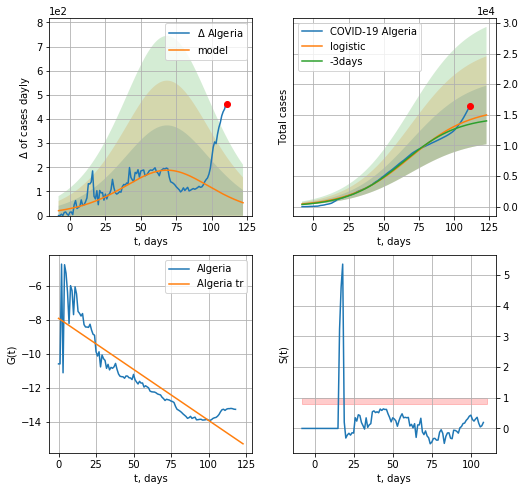

Algeria data at: 2020-07-06
+3 day model MAPE: 0.05438931145415644
model: logistic
coeffs:  [1.61921967e+04 4.64592971e-02 6.89373158e+01]
rational stdev:  0.31987091813162644
forecast at the end of period: +12 days
	 deltaDaycases:  53
	 total cases:  14977 ± 4790
	 total death:  875 ± 839
trend coefficient of determination: 0.784202
 intercept: -7.920119
 slope: -0.060008


In [323]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,16*7-dT)
#dfAG

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


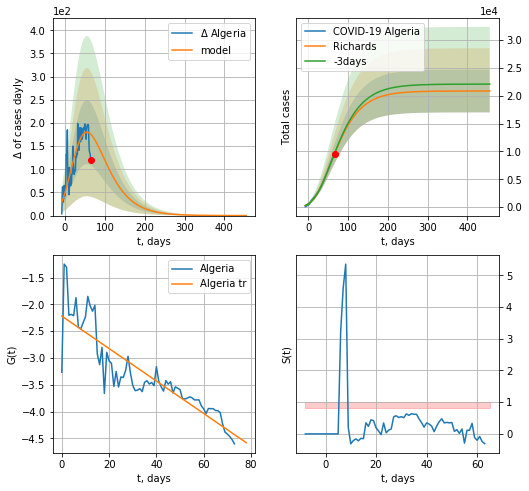

Algeria data at: 2020-07-06
+3 day model MAPE: 0.008186
model: Richards
coeffs: [ 2.08625851e+04  9.79673977e-01 -1.01161081e+02  2.42501114e-02]
rational stdev: 0.184006
forecast at the end of period: +390 days
	 deltaDaycases: 0
	 total cases: 20861 ± 3838
	 total death: 1219 ± 672
trend coefficient of determination: 0.777640
 intercept: -2.218091
 slope: -0.030315


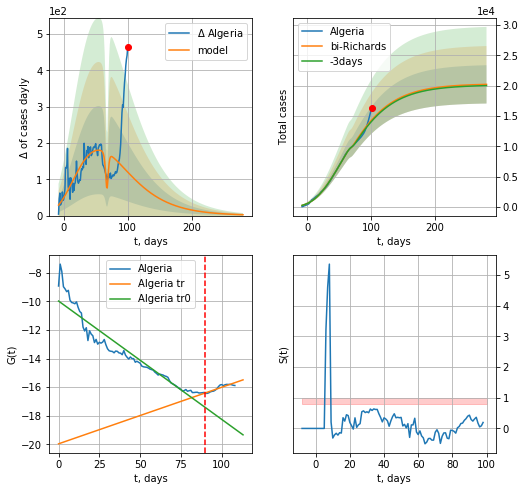

Algeria data at: 2020-07-06
+3 day model MAPE: 0.014647
model: bi-Richards
coeffs: [-543.3492142     0.63082652   68.35008688    1.26943531]
rational stdev: 0.155945
forecast at the end of period: +180 days
	 deltaDaycases: 2
	 total cases: 20221 ± 3153
	 total death: 1182 ± 552
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.908977
 intercept: -9.977295
 slope: -0.082867
trend coefficient of determination: 0.818010
 intercept: -19.969407
 slope: 0.039612


In [328]:
vL = 90+15
x = forecastRR("Algeria",dfAR[15:vL-15],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[15:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


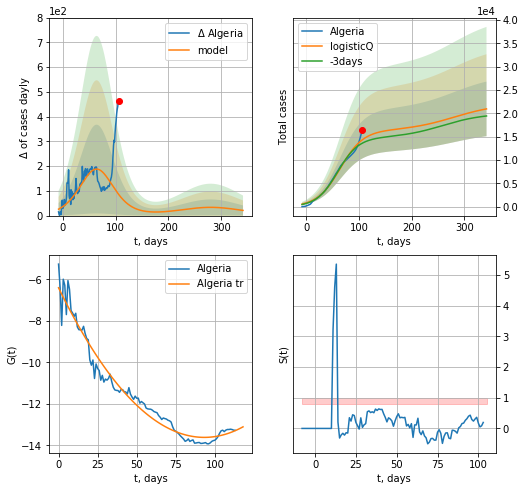

Algeria data at: 2020-07-06
+3 day model MAPE: 0.053701
model: logisticQ
coeffs: [ 1.63066052e+04  2.78232894e-07  6.43151277e+01 -1.64927113e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.279248
forecast at the end of period: +236 days
	 deltaDaycases: 21
	 total cases: 20961 ± 5853
	 total death: 1225 ± 1026
trend coefficient of determination: 0.963778
 intercept_: -6.409596669125131
 coeffs_: [ 0.         -0.15448565  0.00082839]


In [329]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date  cases   active   death
115 2020-07-02  59394  29740.0  2987.0
116 2020-07-03  60695  30091.0  3036.0
117 2020-07-04  62142  30834.0  3089.0
118 2020-07-05  64958  31798.0  3241.0
119 2020-07-06  64958  31798.0  3241.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

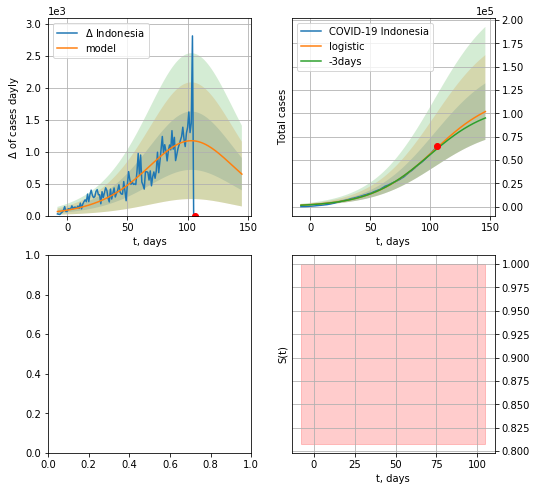

In [331]:
dfIE = read_df(pd.DataFrame(),"IE")
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
x = forecastRR("Indonesia",dfIE[6:],d1,224*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


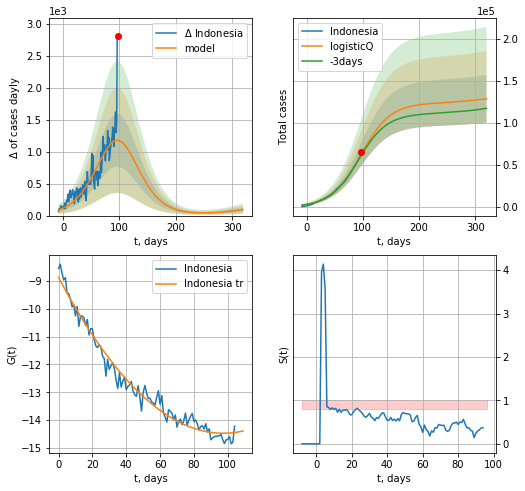

Indonesia data at: 2020-07-05
+3 day model MAPE: 0.020721
model: logisticQ
coeffs: [ 1.23288449e+05  2.02672927e-06  9.63238460e+01 -1.87687097e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.221279
forecast at the end of period: +223 days
	 deltaDaycases: 93
	 total cases: 128887 ± 28520
	 total death: 6430 ± 4268
trend coefficient of determination: 0.975560
 intercept_: -8.866080033373077
 coeffs_: [ 0.         -0.11534022  0.00059291]


In [758]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date  cases   active   death
117 2020-07-02  38805  26858.0  1274.0
118 2020-07-03  40336  27983.0  1280.0
119 2020-07-04  41830  29087.0  1290.0
120 2020-07-05  46333  32845.0  1303.0
121 2020-07-06  46333  32845.0  1303.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


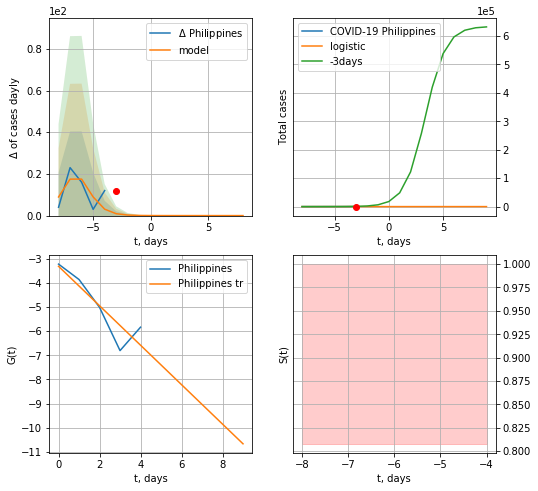

Philippines data at: 2020-07-06
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

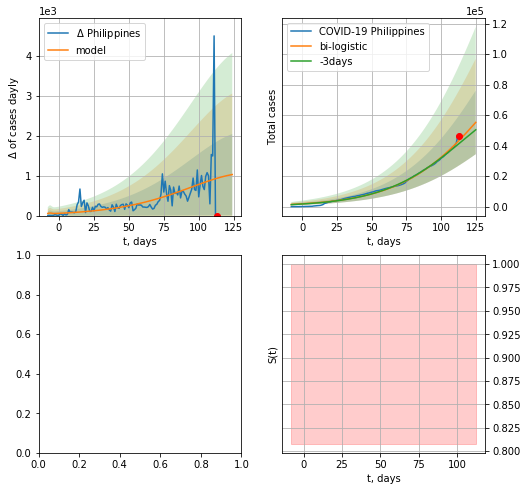

In [333]:
vL=10
vL1=25
dfPH = read_df(pd.DataFrame(),"PH")
x = forecast("Philippines",dfPH[4:vL],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,16*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


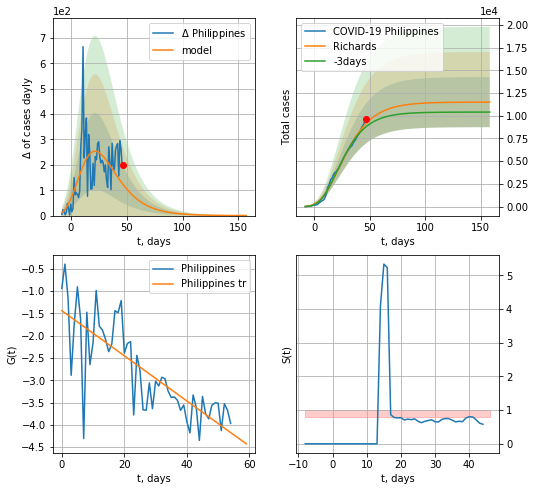

Philippines data at: 2020-07-05
+3 day model MAPE: 0.044209
model: Richards
coeffs: [ 1.15018278e+04  6.61454462e+00 -5.57256966e+01  9.11064046e-03]
rational stdev: 0.239775
forecast at the end of period: +111 days
	 deltaDaycases: 0
	 total cases: 11498 ± 2757
	 total death: 323 ± 232
trend coefficient of determination: 0.622666
 intercept: -1.437831
 slope: -0.050660


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


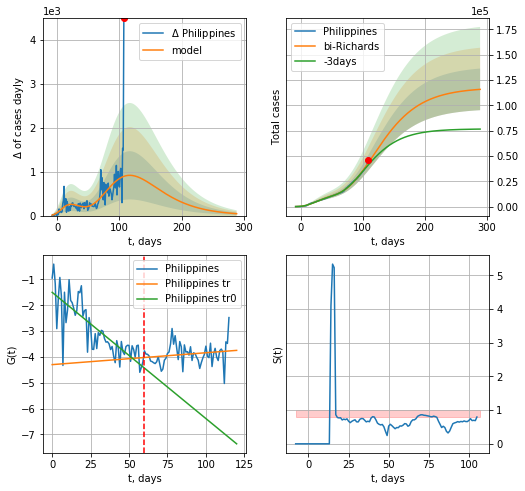

Philippines data at: 2020-07-05
+3 day model MAPE: 0.048380
model: bi-Richards
coeffs: [ 1.06182582e+05  1.72611648e+00 -6.47717458e+01  1.36651978e-02]
rational stdev: 0.177550
forecast at the end of period: +181 days
	 deltaDaycases: 43
	 total cases: 115853 ± 20569
	 total death: 3258 ± 1735
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.654377
 intercept: -1.500827
 slope: -0.048837
trend coefficient of determination: 0.032787
 intercept: -4.297337
 slope: 0.004593


In [761]:
vL = 60 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


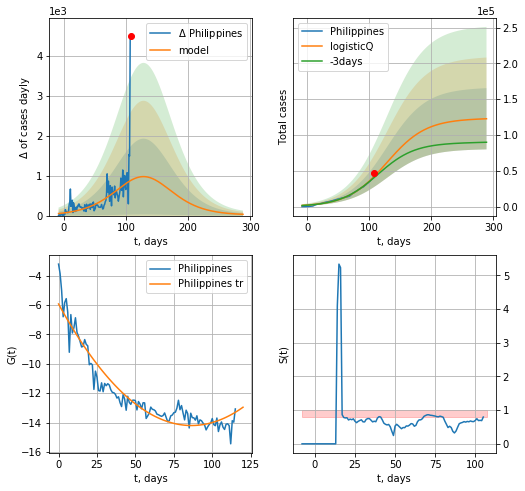

Philippines data at: 2020-07-05
+3 day model MAPE: 0.040827
model: logisticQ
coeffs: [ 1.22804929e+05  1.64623448e-06  1.28567127e+02 -1.91914374e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348494
forecast at the end of period: +181 days
	 deltaDaycases: 32
	 total cases: 122665 ± 42748
	 total death: 3449 ± 3605
trend coefficient of determination: 0.910373
 intercept_: -5.933164494707164
 coeffs_: [ 0.         -0.1912883   0.00110618]


In [762]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
124 2020-07-02  3458.0    1892  192.0
125 2020-07-03  3486.0    1920  192.0
126 2020-07-04  3511.0    1945  192.0
127 2020-07-05  3519.0    1953  192.0
128 2020-07-06  3562.0    1996  192.0


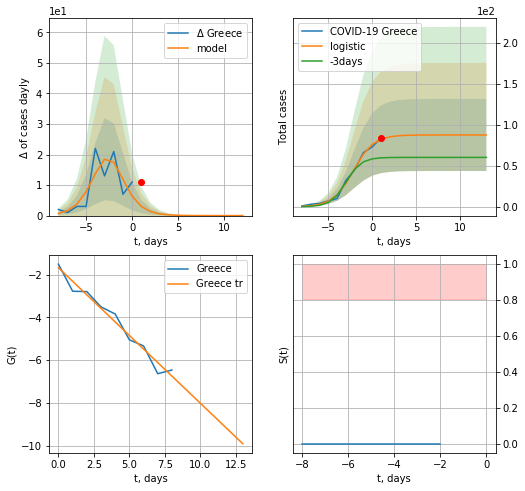

Greece data at: 2020-07-06
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


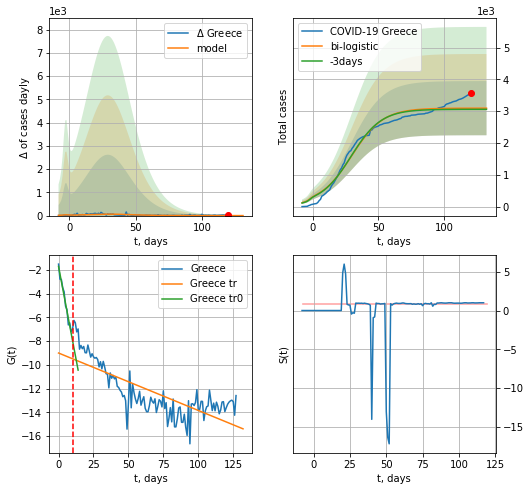

Greece data at: 2020-07-06
+3 day model MAPE: 0.011347375865625906
model: bi-logistic
coeffs:  [3.00721445e+03 8.40064778e-02 2.95828697e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.275056852160109
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  3094 ± 851
	 total death:  166 ± 136
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.587676
 intercept: -9.004464
 slope: -0.048443


In [334]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,16*7-dT)
xx = forecast2("Greece",dfGC[:],d1,16*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


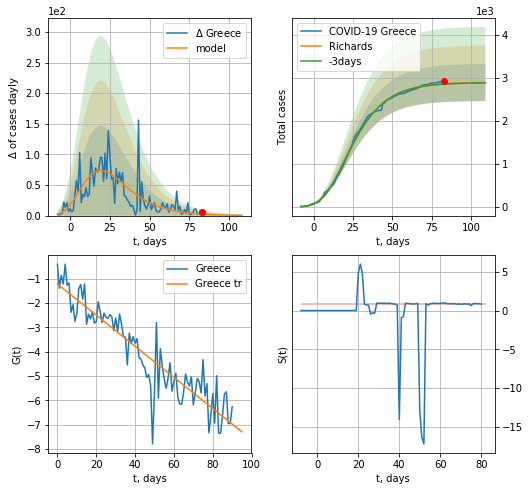

Greece data at: 2020-07-06
+3 day model MAPE: 0.003283
model: Richards
coeffs: [ 2.89327821e+03  7.32575617e+00 -4.72776749e+01  9.49188322e-03]
rational stdev: 0.149150
forecast at the end of period: +26 days
	 deltaDaycases: 0
	 total cases: 2887 ± 430
	 total death: 155 ± 69
trend coefficient of determination: 0.838381
 intercept: -1.223029
 slope: -0.063896


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


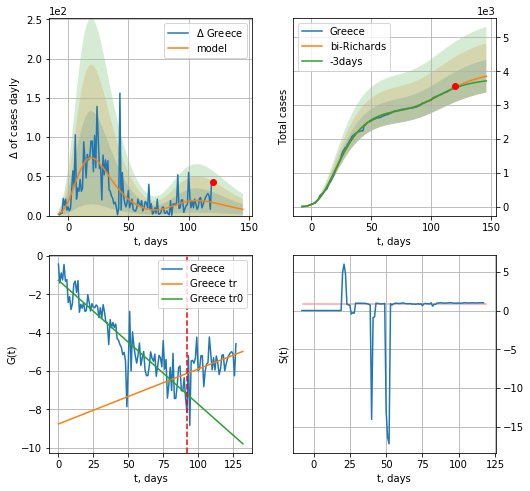

Greece data at: 2020-07-06
+3 day model MAPE: 0.008616
model: bi-Richards
coeffs: [1.15333162e+03 2.16741732e+00 2.10683748e+01 2.05948866e-02]
rational stdev: 0.126035
forecast at the end of period: +26 days
	 deltaDaycases: 8
	 total cases: 3852 ± 485
	 total death: 207 ± 78
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.844910
 intercept: -1.269415
 slope: -0.064645
trend coefficient of determination: 0.116374
 intercept: -8.767900
 slope: 0.028689


In [335]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


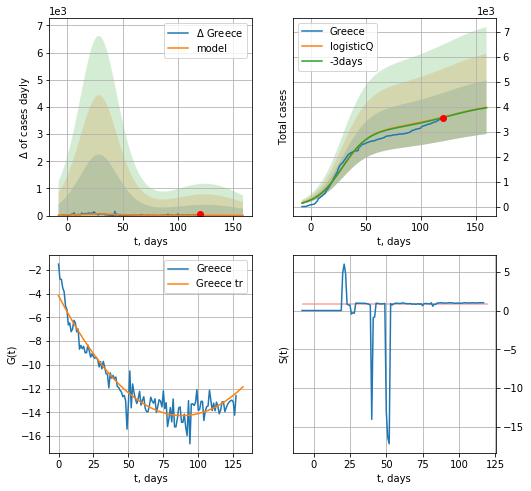

Greece data at: 2020-07-06
+3 day model MAPE: 0.005029
model: logisticQ
coeffs: [ 3.09990327e+03  1.26677339e-07  2.88207064e+01 -6.42128689e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.269615
forecast at the end of period: +40 days
	 deltaDaycases: 7
	 total cases: 3981 ± 1073
	 total death: 214 ± 173
trend coefficient of determination: 0.915815
 intercept_: -4.175219829869015
 coeffs_: [ 0.         -0.2281354   0.00128751]


In [336]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
118 2020-07-02  4166.0     858  587.0
119 2020-07-03  4172.0     832  588.0
120 2020-07-04  4174.0     801  589.0
121 2020-07-05  4189.0     740  589.0
122 2020-07-06  4205.0     742  589.0


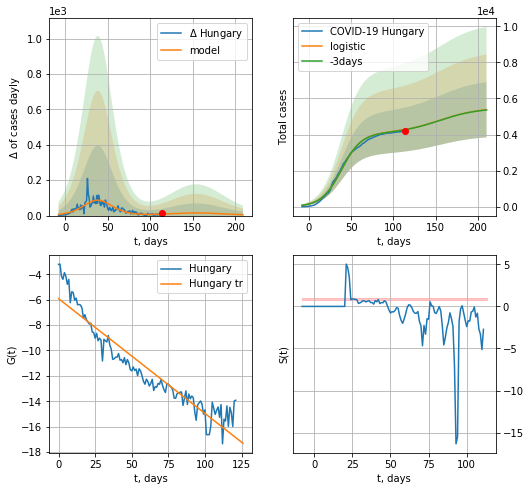

Hungary data at: 2020-07-06
+3 day model MAPE: 0.0027401752778270956
model: logistic
coeffs:  [4.06840702e+03 8.53372872e-02 3.85538489e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.28489200044375806
forecast at the end of period: +96 days
	 deltaDaycases:  4
	 total cases:  5371 ± 1530
	 total death:  752 ± 642
trend coefficient of determination: 0.896409
 intercept: -5.917859
 slope: -0.090405


In [337]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


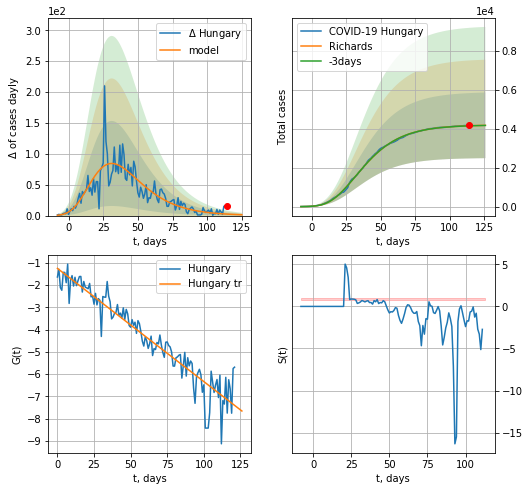

Hungary data at: 2020-07-06
+3 day model MAPE: 0.000912
model: Richards
coeffs: [ 4.20584879e+03  3.92335948e+00 -4.60945586e+01  1.39986167e-02]
rational stdev: 0.403783
forecast at the end of period: +12 days
	 deltaDaycases: 1
	 total cases: 4182 ± 1688
	 total death: 585 ± 708
trend coefficient of determination: 0.895039
 intercept: -1.243156
 slope: -0.050940


In [338]:
vL = 99
x = forecastRR("Hungary",dfHG[:],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR("Hungary",dfHG[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


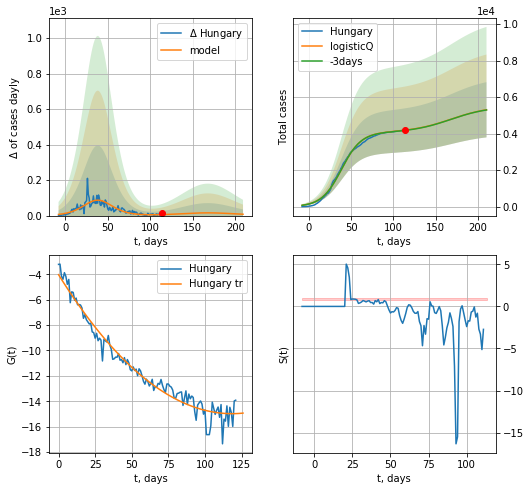

Hungary data at: 2020-07-06
+3 day model MAPE: 0.002932
model: logisticQ
coeffs: [ 4.06835647e+03  3.24349947e-07  3.85544673e+01 -2.62989549e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.284984
forecast at the end of period: +96 days
	 deltaDaycases: 7
	 total cases: 5304 ± 1511
	 total death: 743 ± 635
trend coefficient of determination: 0.962563
 intercept_: -4.031273598514895
 coeffs_: [ 0.         -0.18473685  0.00077961]


In [339]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


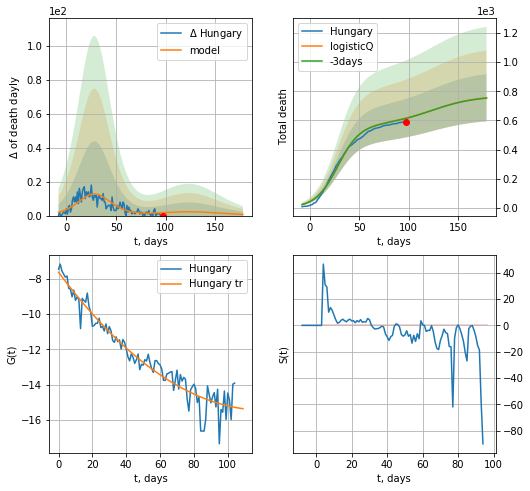

Hungary data at: 2020-07-06
+3 day model MAPE: 0.003173
model: logisticQ
coeffs: [ 5.69471844e+02  3.31945512e-07  2.84242371e+01 -2.67690010e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214738
forecast at the end of period: +82 days
	 total death: 755 ± 162
trend coefficient of determination: 0.930204
 intercept_: -7.638475462841613
 coeffs_: [ 0.         -0.12839727  0.00052799]


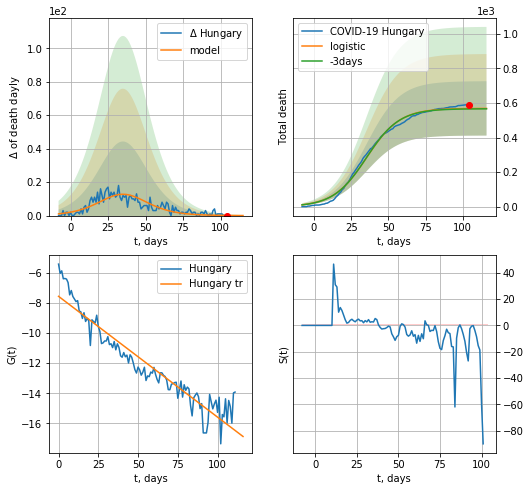

Hungary data at: 2020-07-06
+3 day model MAPE: 0.004346301529366009
model: logistic
coeffs:  [5.68892364e+02 8.96449521e-02 3.54044308e+01]
rational stdev:  0.2761212178067682
forecast at the end of period: +12 days
	 total death:  568 ± 156
trend coefficient of determination: 0.898451
 intercept: -7.564110
 slope: -0.080158


In [340]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,16*7-dT,cases='death')

MT
           date  cases  active  death
116 2020-07-02  671.1      13    9.0
117 2020-07-03  672.0      13    9.0
118 2020-07-04  672.1      12    9.0
119 2020-07-05  672.2      11    9.0
120 2020-07-06  672.3      11    9.0


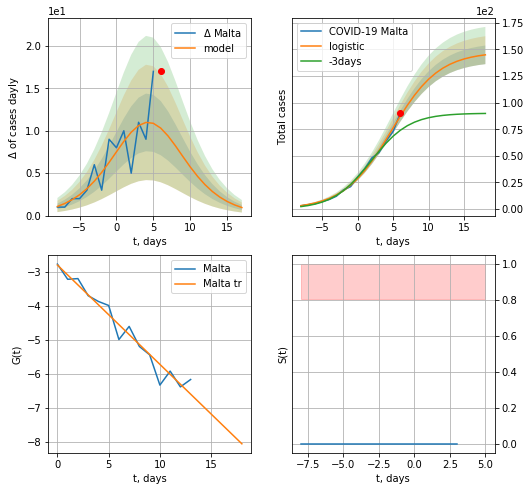

Malta data at: 2020-07-06
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  144 ± 8
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


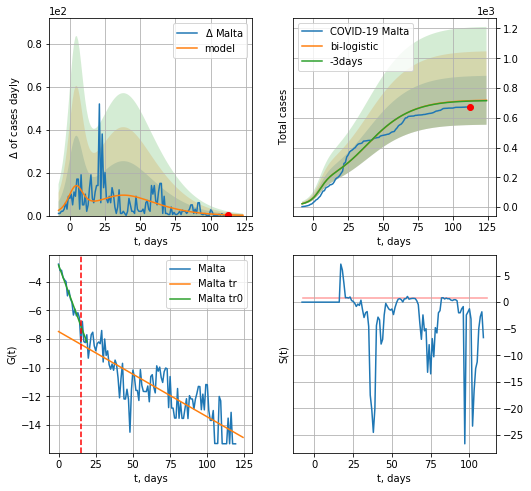

Malta data at: 2020-07-06
+3 day model MAPE: 0.0036285097480881576
model: bi-logistic
coeffs:  [5.08366205e+02 7.14878419e-02 3.74649069e+01] [147.79636191   0.29837112   4.7799048 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.22907606088174806
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  717 ± 164
	 total death:  9 ± 6
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.710759
 intercept: -7.483489
 slope: -0.059595


In [342]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*16-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


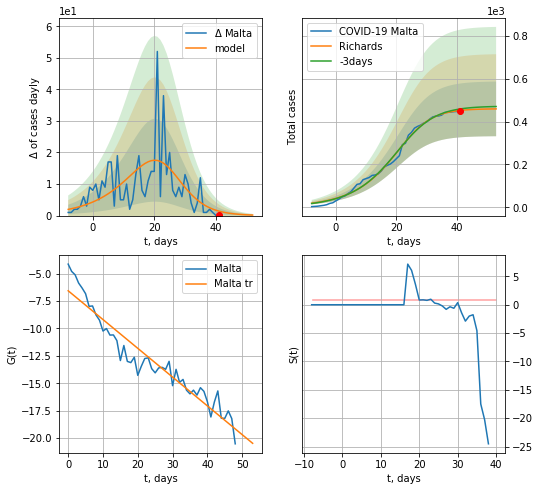

Malta data at: 2020-07-06
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 459 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


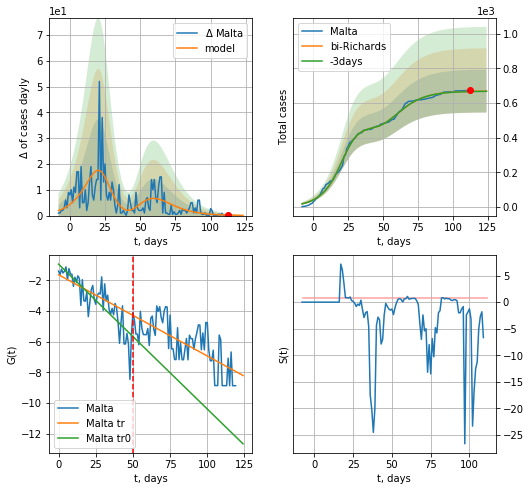

Malta data at: 2020-07-06
+3 day model MAPE: 0.001734
model: bi-Richards
coeffs: [2.08842764e+02 1.16784174e+01 3.43906878e+00 7.41932134e-03]
rational stdev: 0.184467
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 668 ± 123
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.728912
 intercept: -0.939426
 slope: -0.094419
trend coefficient of determination: 0.481563
 intercept: -1.633147
 slope: -0.052922


In [343]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


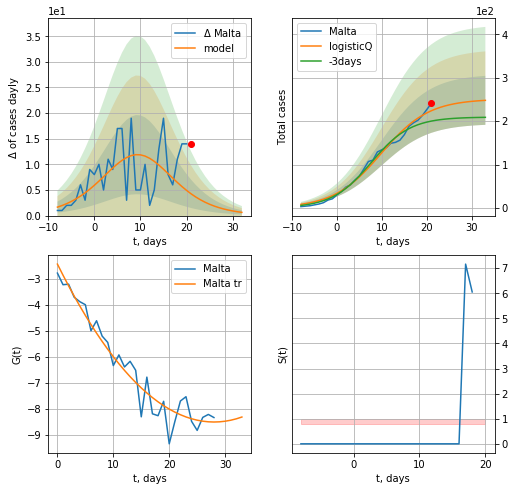

Malta data at: 2020-07-06
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 247 ± 56
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


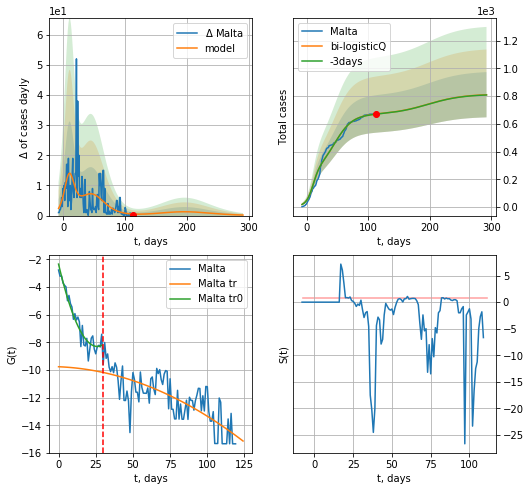

Malta data at: 2020-07-06
+3 day model MAPE: 0.001914
model: bi-logisticQ
coeffs: [ 4.17155553e+02  1.82762808e-07  4.51292630e+01 -3.75712386e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.201355
forecast at the end of period: +180 days
	 deltaDaycases: 0
	 total cases: 810 ± 163
	 total death: 10 ± 6
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.578358
 intercept_: -9.756761824835504
 coeffs_: [ 0.         -0.0043719  -0.00031367]


In [344]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
114 2020-07-02  1700.0   206.0   28.0
115 2020-07-03  1720.0   226.0   28.0
116 2020-07-04  1749.0   255.0   28.0
117 2020-07-05  1765.0   271.0   28.0
118 2020-07-06  1767.0   266.0   28.0


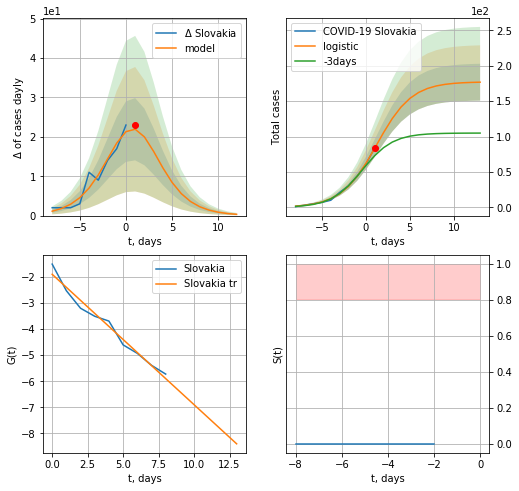

Slovakia data at: 2020-07-06
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  176 ± 26
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


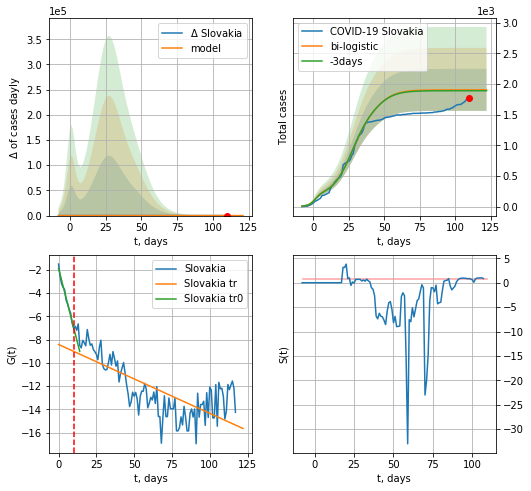

Slovakia data at: 2020-07-06
+3 day model MAPE: 0.007482228371787227
model: bi-logistic
coeffs:  [1.38112470e+03 1.44996369e-01 2.70130306e+01] [177.28786794   0.4996723    1.23158092]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.1796809325629727
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1903 ± 342
	 total death:  30 ± 16
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.552321
 intercept: -8.421414
 slope: -0.059274


In [345]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


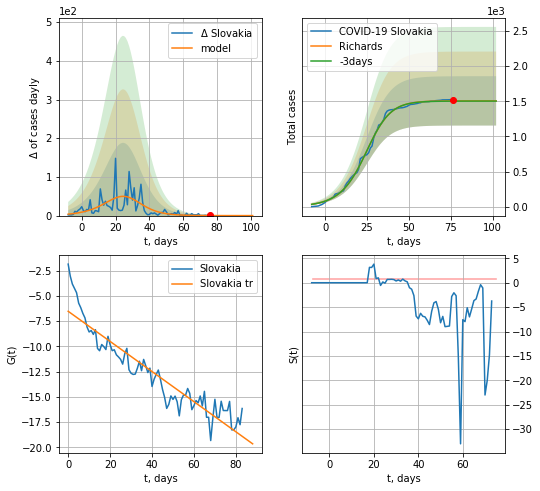

Slovakia data at: 2020-07-06
+3 day model MAPE: 0.002066
model: Richards
coeffs: [1.50610865e+03 1.09508318e-01 2.68945088e+01 1.32920214e+00]
rational stdev: 0.232989
forecast at the end of period: +26 days
	 deltaDaycases: 0
	 total cases: 1506 ± 350
	 total death: 23 ± 16
trend coefficient of determination: 0.871466
 intercept: -6.535200
 slope: -0.149062


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


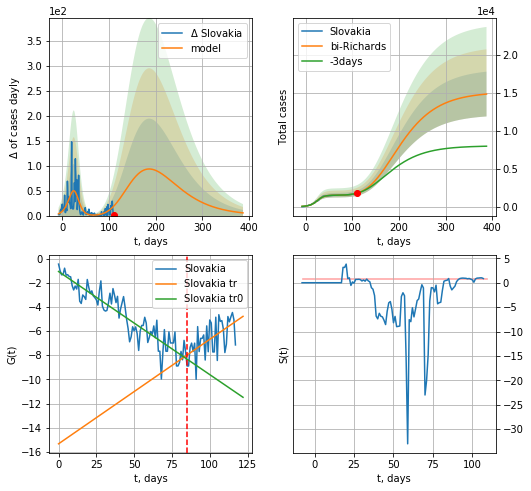

Slovakia data at: 2020-07-06
+3 day model MAPE: 0.006286
model: bi-Richards
coeffs: [1.36072203e+04 3.90227069e-01 2.91404154e+01 4.90598333e-02]
rational stdev: 0.198874
forecast at the end of period: +278 days
	 deltaDaycases: 5
	 total cases: 14828 ± 2949
	 total death: 234 ± 139
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.850845
 intercept: -1.072741
 slope: -0.085347
trend coefficient of determination: 0.317962
 intercept: -15.336536
 slope: 0.086500


In [346]:
vL = 85
x = forecastRR("Slovakia",dfSL[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,54*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


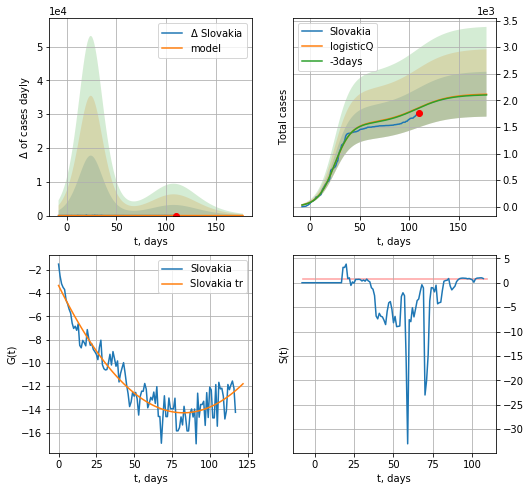

Slovakia data at: 2020-07-06
+3 day model MAPE: 0.003418
model: logisticQ
coeffs: [ 1.56846611e+03  8.07293737e-07  2.47473325e+01 -1.46551483e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199471
forecast at the end of period: +68 days
	 deltaDaycases: 0
	 total cases: 2115 ± 421
	 total death: 33 ± 19
trend coefficient of determination: 0.898140
 intercept_: -3.343863237135583
 coeffs_: [ 0.         -0.2654022   0.00160702]


In [347]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
119 2020-07-02  1634.0   139.0  111.0
120 2020-07-03  1650.0   155.0  111.0
121 2020-07-04  1679.0   184.0  111.0
122 2020-07-05  1716.0   221.0  111.0
123 2020-07-06  1716.0   221.0  111.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


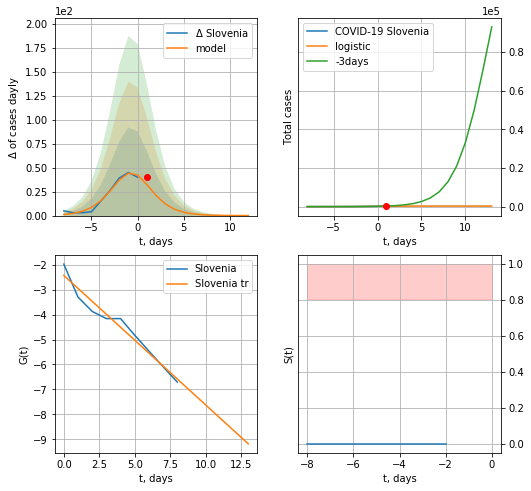

Slovenia data at: 2020-07-06
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  261 ± 138
	 total death:  16 ± 25
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


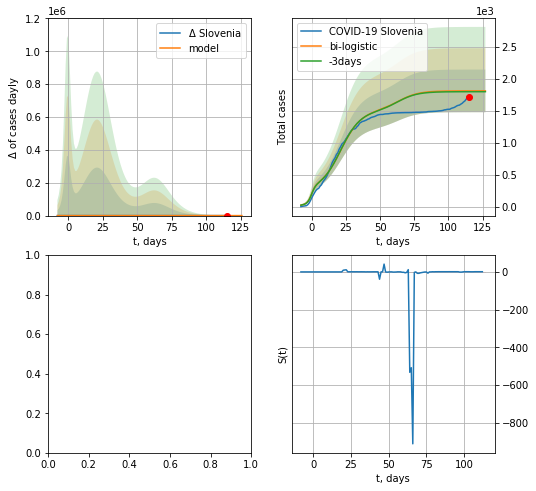

In [348]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


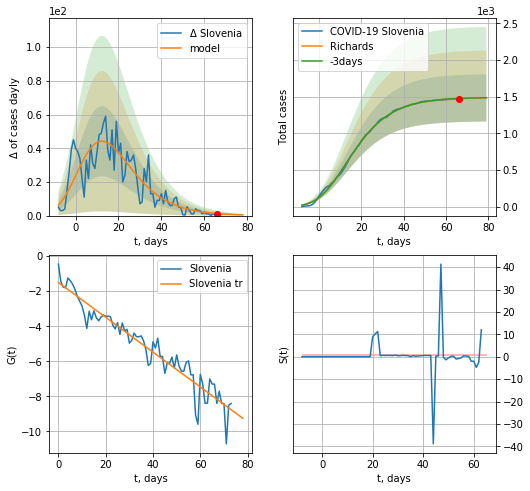

Slovenia data at: 2020-07-05
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1483 ± 322
	 total death: 95 ± 61
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


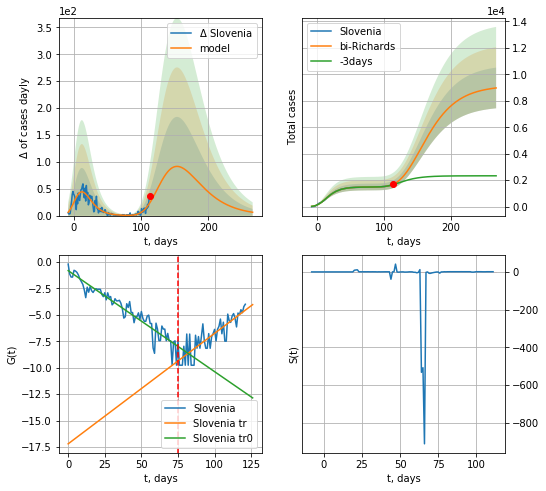

Slovenia data at: 2020-07-05
+3 day model MAPE: 0.023288
model: bi-Richards
coeffs: [7.67376585e+03 1.41780959e+00 3.92749138e+01 2.31260155e-02]
rational stdev: 0.171435
forecast at the end of period: +153 days
	 deltaDaycases: 6
	 total cases: 8975 ± 1538
	 total death: 580 ± 298
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.904819
 intercept: -0.837855
 slope: -0.095324
trend coefficient of determination: 0.707022
 intercept: -17.181235
 slope: 0.104234


In [782]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


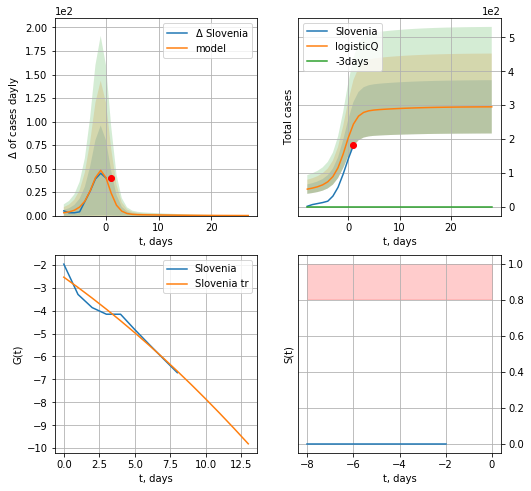

Slovenia data at: 2020-07-05
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 294 ± 78
	 total death: 19 ± 15
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


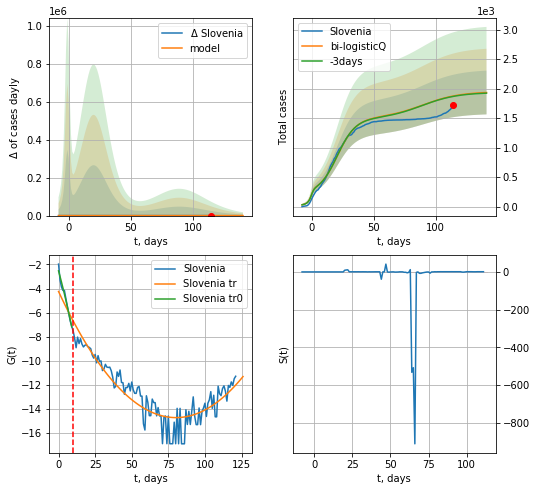

Slovenia data at: 2020-07-05
+3 day model MAPE: 0.003716
model: bi-logisticQ
coeffs: [ 1.27688293e+03  3.62092464e-07  2.05153840e+01 -3.67591286e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.191589
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1933 ± 370
	 total death: 125 ± 71
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.829587
 intercept_: -4.2474226902889605
 coeffs_: [ 0.         -0.26099061  0.00162652]


In [783]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
114 2020-07-02  15195  1996.0  287.0
115 2020-07-03  15504  2142.0  298.0
116 2020-07-04  15829  2459.0  306.0
117 2020-07-05  16131  2756.0  311.0
118 2020-07-06  16420  2737.0  317.0


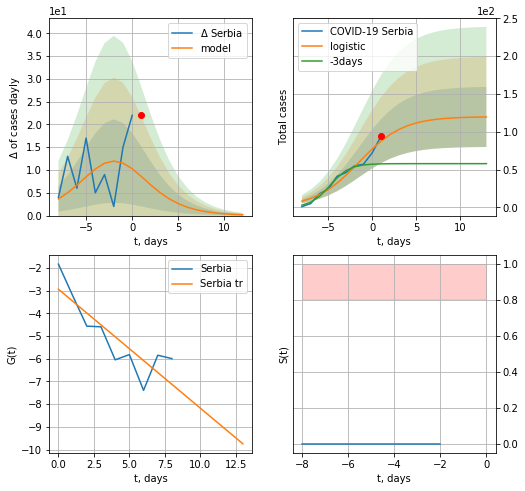

Serbia data at: 2020-07-06
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


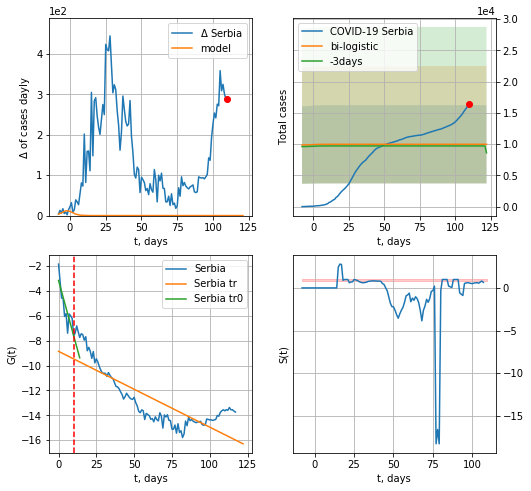

Serbia data at: 2020-07-06
+3 day model MAPE: 0.02705723527499702
model: bi-logistic
coeffs:  [ 7.88106203e+03 -2.83636466e+00  1.26677369e+02] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6278144134440723
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  9971 ± 6260
	 total death:  192 ± 361
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.673268
 intercept: -8.857075
 slope: -0.061027


In [349]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,16*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


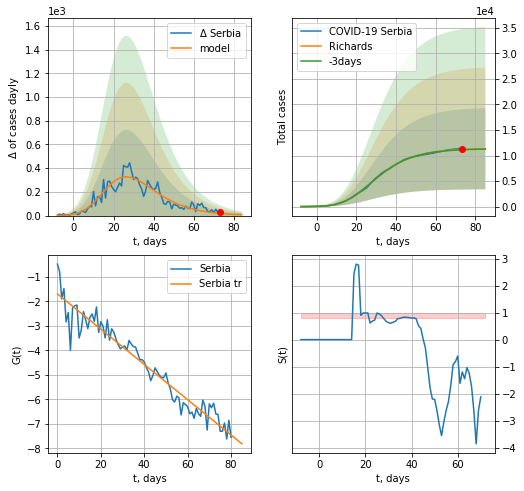

Serbia data at: 2020-07-06
+3 day model MAPE: 0.005935
model: Richards
coeffs: [1.14293254e+04 5.20642407e-01 5.14901126e+00 1.61282517e-01]
rational stdev: 0.700960
forecast at the end of period: +12 days
	 deltaDaycases: 7
	 total cases: 11342 ± 7950
	 total death: 218 ± 458
trend coefficient of determination: 0.932302
 intercept: -1.698040
 slope: -0.071957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


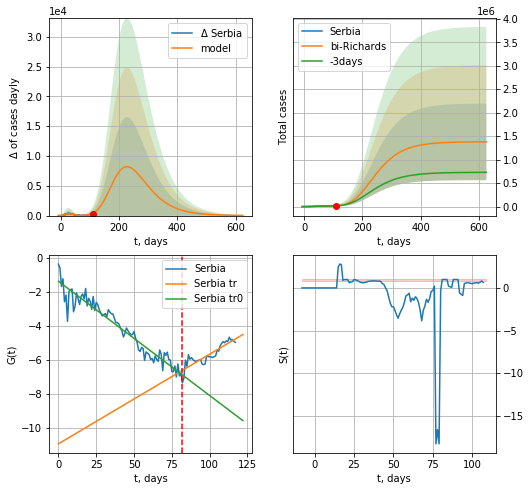

Serbia data at: 2020-07-06
+3 day model MAPE: 0.010491
model: bi-Richards
coeffs: [1.36956761e+06 1.77317147e-01 9.03922918e+01 9.62259560e-02]
rational stdev: 0.591410
forecast at the end of period: +516 days
	 deltaDaycases: 26
	 total cases: 1379469 ± 815831
	 total death: 26631 ± 47249
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.924621
 intercept: -1.385586
 slope: -0.067140
trend coefficient of determination: 0.773708
 intercept: -10.938679
 slope: 0.052664


In [350]:
vL=82
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,88*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


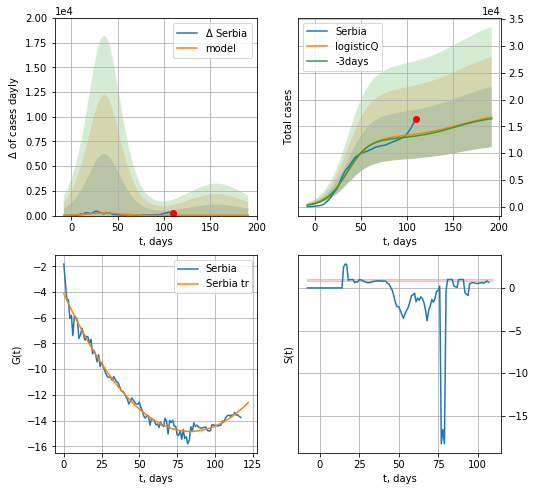

Serbia data at: 2020-07-06
+3 day model MAPE: 0.027448
model: logisticQ
coeffs: [ 1.29934614e+04  1.37131350e-07  3.60289301e+01 -5.92572766e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.336203
forecast at the end of period: +82 days
	 deltaDaycases: 29
	 total cases: 16706 ± 5616
	 total death: 322 ± 324
trend coefficient of determination: 0.979755
 intercept_: -4.130481746191868
 coeffs_: [ 0.         -0.25578824  0.00152848]


In [351]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
124 2020-07-02  2912.0   647.0  110.0
125 2020-07-03  3008.0   728.0  112.0
126 2020-07-04  3094.0   798.0  113.0
127 2020-07-05  3151.0   842.0  113.0
128 2020-07-06  3220.0   897.0  113.0


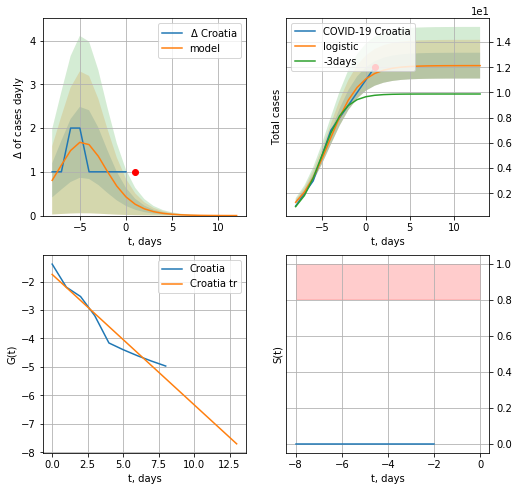

Croatia data at: 2020-07-06
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


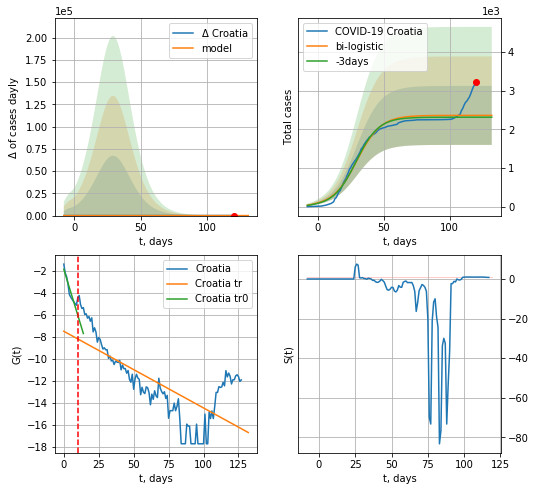

Croatia data at: 2020-07-06
+3 day model MAPE: 0.02033279137967372
model: bi-logistic
coeffs:  [2.34626594e+03 1.10333199e-01 2.95894159e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.323150606155903
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  2358 ± 762
	 total death:  82 ± 79
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.495474
 intercept: -7.496675
 slope: -0.069796


In [352]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


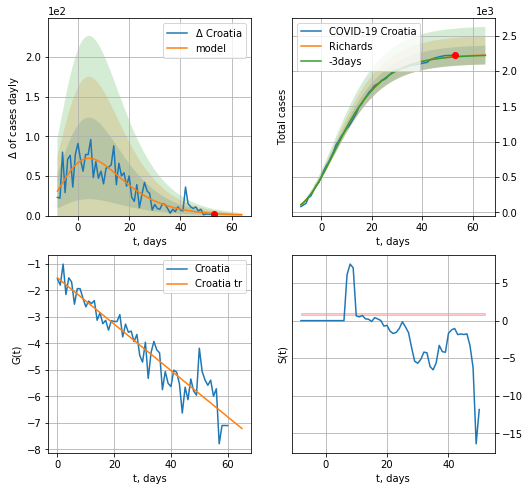

Croatia data at: 2020-07-06
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963101e+03  7.95190714e+00 -4.62548924e+01  1.10914885e-02]
rational stdev: 0.059686
forecast at the end of period: +12 days
	 deltaDaycases: 1
	 total cases: 2228 ± 133
	 total death: 78 ± 13
trend coefficient of determination: 0.897394
 intercept: -1.522031
 slope: -0.087533


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


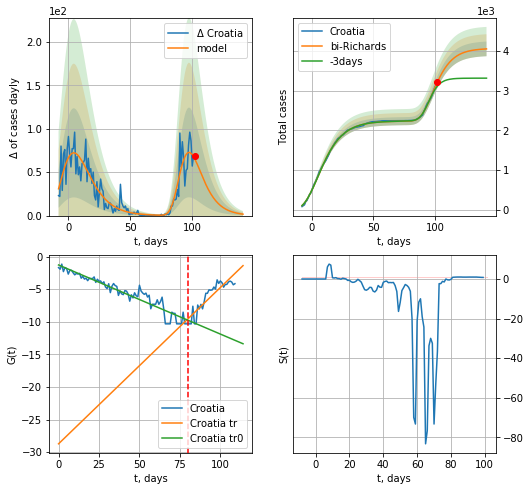

Croatia data at: 2020-07-06
+3 day model MAPE: 0.041867
model: bi-Richards
coeffs: [1.83212993e+03 2.87890978e+00 6.81646605e+01 3.81766891e-02]
rational stdev: 0.045561
forecast at the end of period: +40 days
	 deltaDaycases: 1
	 total cases: 4057 ± 184
	 total death: 142 ± 19
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.904362
 intercept: -1.281070
 slope: -0.106025
trend coefficient of determination: 0.806063
 intercept: -28.721272
 slope: 0.239815


In [353]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


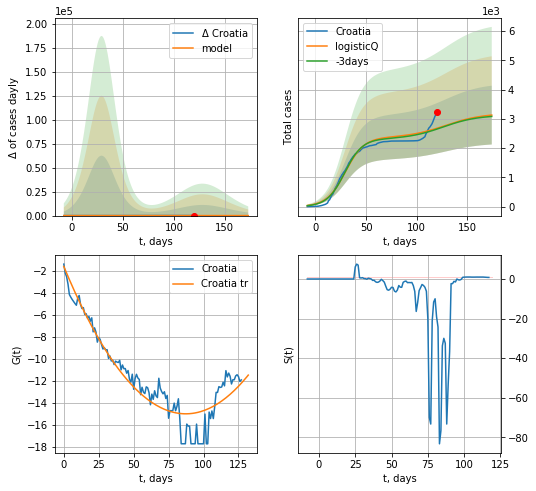

Croatia data at: 2020-07-06
+3 day model MAPE: 0.010170
model: logisticQ
coeffs: [ 2.35940318e+03  2.00940344e-07  2.94841318e+01 -5.43805709e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320988
forecast at the end of period: +54 days
	 deltaDaycases: 3
	 total cases: 3131 ± 1005
	 total death: 109 ± 104
trend coefficient of determination: 0.892989
 intercept_: -1.598311212123658
 coeffs_: [ 0.         -0.3073423   0.00176085]


In [354]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
118 2020-07-02  71299   48891  3120.0
119 2020-07-03  72711   49820  3201.0
120 2020-07-04  74035   50652  3280.0
121 2020-07-05  75253   51184  3343.0
122 2020-07-06  76222   51562  3422.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


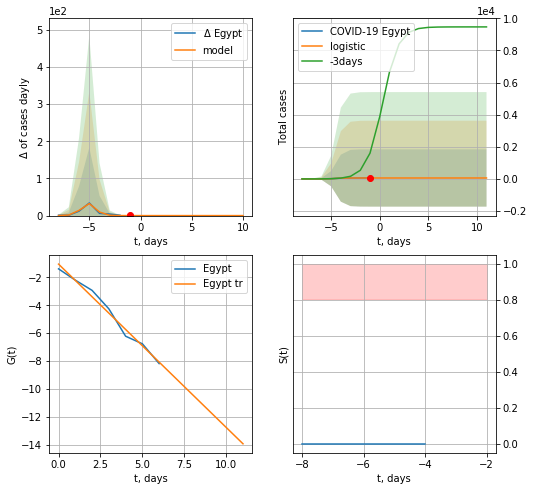

Egypt data at: 2020-07-06
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


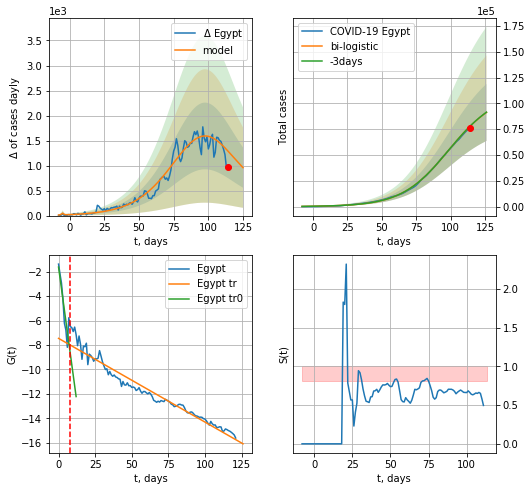

Egypt data at: 2020-07-06
+3 day model MAPE: 0.0015777394358246638
model: bi-logistic
coeffs:  [1.05274991e+05 5.94788089e-02 9.75553736e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.3025723583464175
forecast at the end of period: +12 days
	 deltaDaycases:  958
	 total cases:  91210 ± 27597
	 total death:  4094 ± 3716
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.953754
 intercept: -7.455809
 slope: -0.068420


In [355]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*16-dT)
xx = forecast2("Egypt",dfEG[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


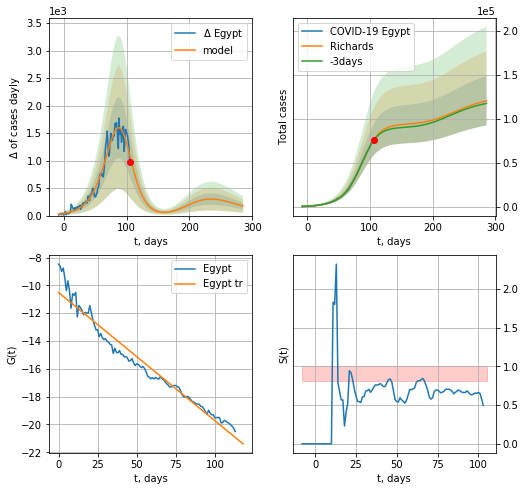

Egypt data at: 2020-07-06
+3 day model MAPE: 0.010188
model: Richards
coeffs: [9.40923491e+04 5.35738614e-02 9.27698111e+01 1.43571318e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.232617
forecast at the end of period: +180 days
	 deltaDaycases: 173
	 total cases: 120586 ± 28050
	 total death: 5413 ± 3777
trend coefficient of determination: 0.958453
 intercept: -10.516754
 slope: -0.092151


In [356]:
x = forecastRR("Egypt",dfEG[8:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


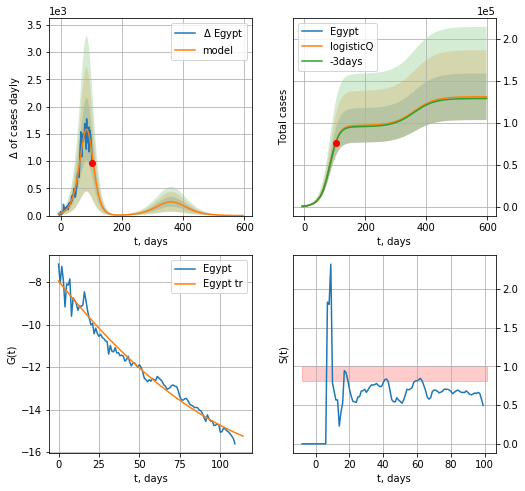

Egypt data at: 2020-07-06
+3 day model MAPE: 0.004494
model: logisticQ
coeffs: [ 9.69454985e+04  1.03719861e-04  8.27380071e+01 -5.45719455e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.211658
forecast at the end of period: +495 days
	 deltaDaycases: 0
	 total cases: 131252 ± 27780
	 total death: 5892 ± 3741
trend coefficient of determination: 0.977820
 intercept_: -7.951332618631626
 coeffs_: [ 0.         -0.09566262  0.00027785]


In [357]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active   death
121 2020-07-02  53708  23636.0  2160.0
122 2020-07-03  56020  24158.0  2262.0
123 2020-07-04  58354  24909.0  2368.0
124 2020-07-05  60479  24989.0  2473.0
125 2020-07-06  62275  24967.0  2567.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


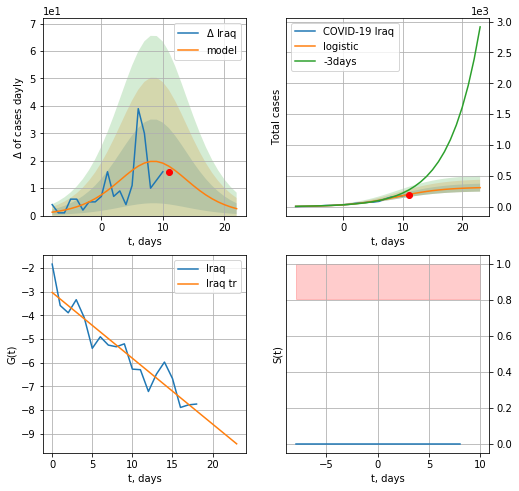

Iraq data at: 2020-07-06
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +12 days
	 deltaDaycases:  2
	 total cases:  307 ± 63
	 total death:  12 ± 7
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


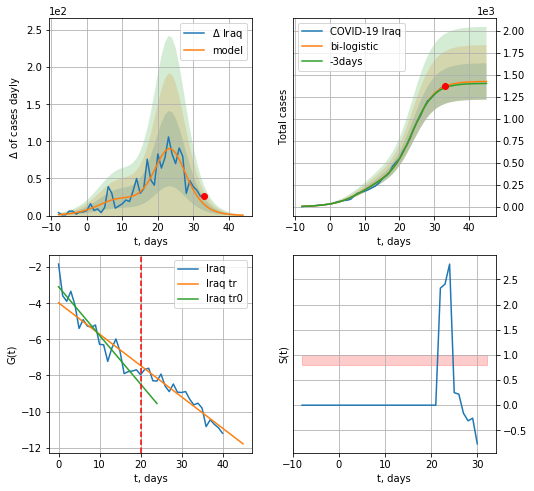

Iraq data at: 2020-07-06
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  1424 ± 207
	 total death:  58 ± 25
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


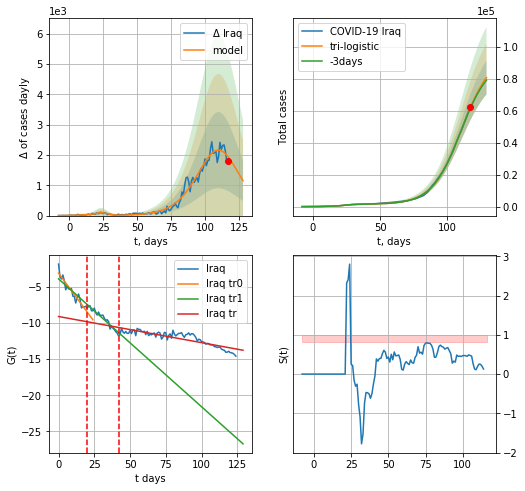

Iraq data at: 2020-07-06
+3 day model MAPE: 0.009739552334344072
model: tri-logistic
coeffs:  [9.36636571e+04 9.22251802e-02 1.10369933e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.1310435051485589
forecast at the end of period: +12 days
	 deltaDaycases:  1150
	 total cases:  80842 ± 10593
	 total death:  3332 ± 1309
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.741953
 intercept: -9.092213
 slope: -0.036227


In [358]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,16*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


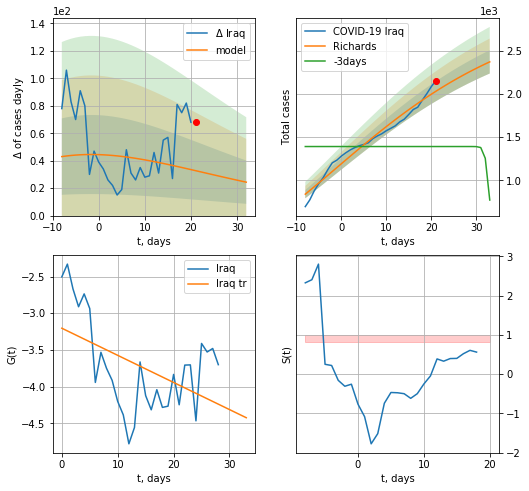

Iraq data at: 2020-07-06
+3 day model MAPE: 0.483696
model: Richards
coeffs: [ 3.05374051e+03  1.25736108e+00 -8.65808580e+01  3.20212773e-02]
rational stdev: 0.056950
forecast at the end of period: +12 days
	 deltaDaycases: 24
	 total cases: 2372 ± 135
	 total death: 97 ± 16
trend coefficient of determination: 0.238101
 intercept: -3.204366
 slope: -0.036947


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in true_divide


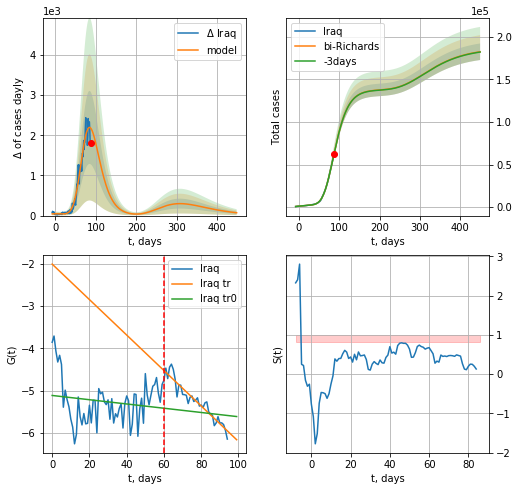

Iraq data at: 2020-07-06
+3 day model MAPE: 0.000727
model: bi-Richards
coeffs: [1.34878220e+05 2.09551703e-01 5.55045604e+01 2.35083745e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.053248
forecast at the end of period: +362 days
	 deltaDaycases: 70
	 total cases: 182427 ± 9713
	 total death: 7519 ± 1201
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.026331
 intercept: -5.110809
 slope: -0.005024
trend coefficient of determination: 0.902432
 intercept: -2.009770
 slope: -0.041878


In [359]:
vL=60+30#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,66*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

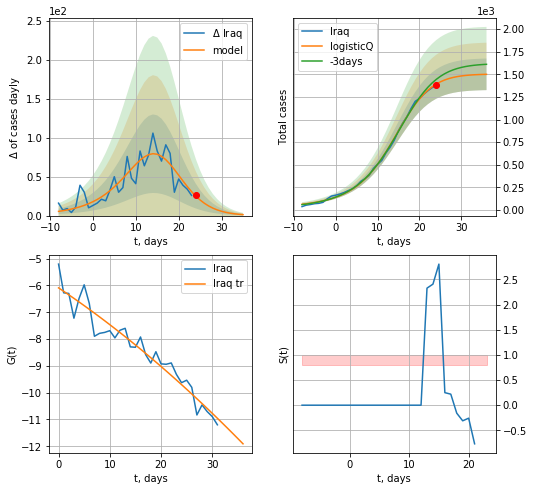

Iraq data at: 2020-07-06
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +12 days
	 deltaDaycases: 1
	 total cases: 1499 ± 174
	 total death: 61 ± 21
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


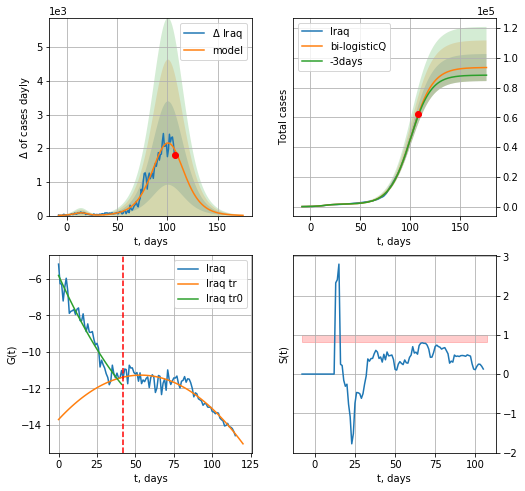

Iraq data at: 2020-07-06
+3 day model MAPE: 0.014097
model: bi-logisticQ
coeffs: [ 9.20039822e+04  1.48869278e-05  1.01004784e+02 -6.19266069e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.097373
forecast at the end of period: +68 days
	 deltaDaycases: 7
	 total cases: 93431 ± 9097
	 total death: 3851 ± 1124
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.903988
 intercept_: -13.70354833035756
 coeffs_: [ 0.          0.09076704 -0.00084862]


In [360]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [361]:
#len(dfAR)

AR
           date    cases  active  death
120 2020-07-02  14657.0  3387.0  928.0
121 2020-07-03  15070.0  3301.0  937.0
122 2020-07-04  15500.0  3373.0  946.0
123 2020-07-05  15941.0  3497.0  952.0
124 2020-07-06  16404.0  3561.0  959.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


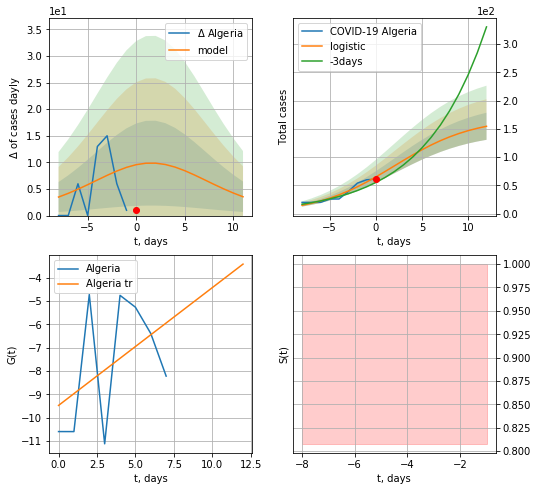

Algeria data at: 2020-07-06
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +12 days
	 deltaDaycases:  3
	 total cases:  154 ± 23
	 total death:  9 ± 4
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


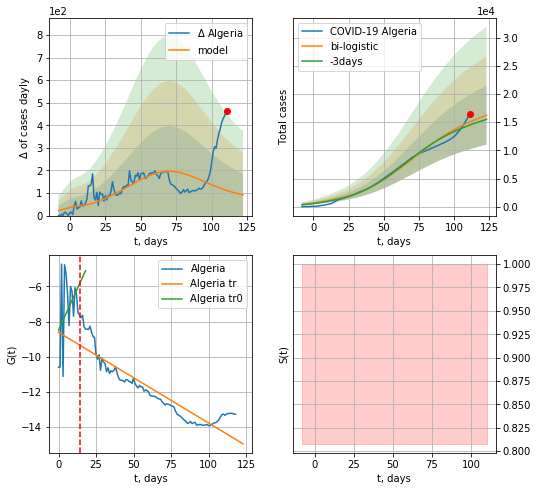

Algeria data at: 2020-07-06
+3 day model MAPE: 0.038754273863445
model: bi-logistic
coeffs:  [1.58715012e+04 4.77580277e-02 6.90116773e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3218228148384365
forecast at the end of period: +12 days
	 deltaDaycases:  92
	 total cases:  16222 ± 5220
	 total death:  948 ± 915
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.840385
 intercept: -8.615186
 slope: -0.051585


In [362]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*16-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*16-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


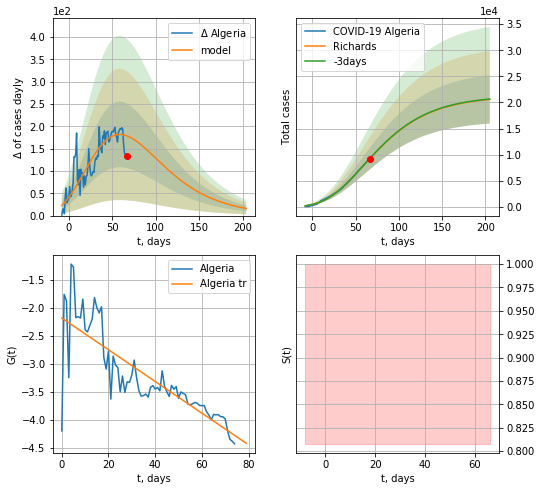

Algeria data at: 2020-07-06
+3 day model MAPE: 0.002676
model: Richards
coeffs: [ 2.12814905e+04  1.20319901e+00 -1.08693333e+02  1.95061272e-02]
rational stdev: 0.224506
forecast at the end of period: +138 days
	 deltaDaycases: 15
	 total cases: 20600 ± 4624
	 total death: 1204 ± 810
trend coefficient of determination: 0.678514
 intercept: -2.184065
 slope: -0.028199


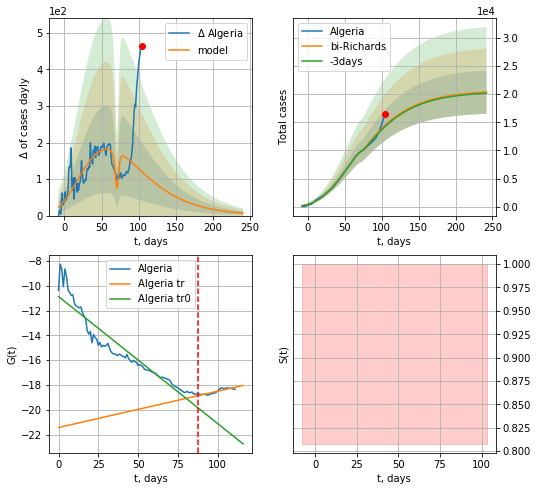

Algeria data at: 2020-07-06
+3 day model MAPE: 0.014650
model: bi-Richards
coeffs: [-6.44866093e+02  4.79846835e-01  7.19127850e+01  1.52291651e+00]
rational stdev: 0.189088
forecast at the end of period: +138 days
	 deltaDaycases: 6
	 total cases: 20348 ± 3847
	 total death: 1189 ± 674
bi-Richards approximation splitting point: 88
trend coefficient of determination: 0.902723
 intercept: -10.866195
 slope: -0.102363
trend coefficient of determination: 0.795636
 intercept: -21.425063
 slope: 0.029244


In [363]:
vL = 88+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


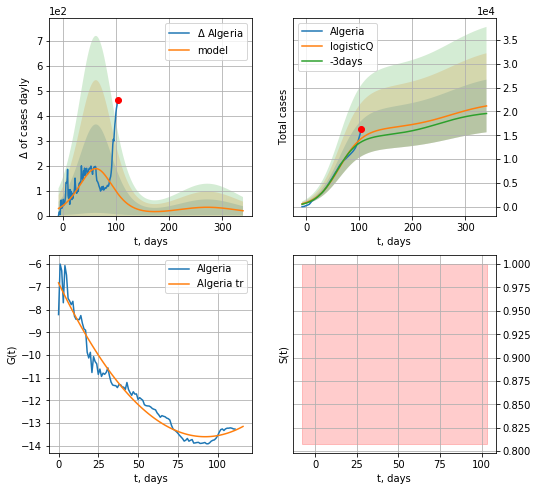

Algeria data at: 2020-07-06
+3 day model MAPE: 0.053513
model: logisticQ
coeffs: [ 1.63689551e+04  2.93721128e-07  6.25192651e+01 -1.55274319e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.260927
forecast at the end of period: +236 days
	 deltaDaycases: 19
	 total cases: 21150 ± 5518
	 total death: 1236 ± 967
trend coefficient of determination: 0.961715
 intercept_: -6.823409801174712
 coeffs_: [ 0.         -0.14720617  0.00079843]


In [364]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
112 2020-07-02   999.3   147.0   19.0
113 2020-07-03   999.6   141.0   19.0
114 2020-07-04  1002.0   144.0   19.0
115 2020-07-05  1003.0   145.0   19.0
116 2020-07-06  1004.0   146.0   19.0


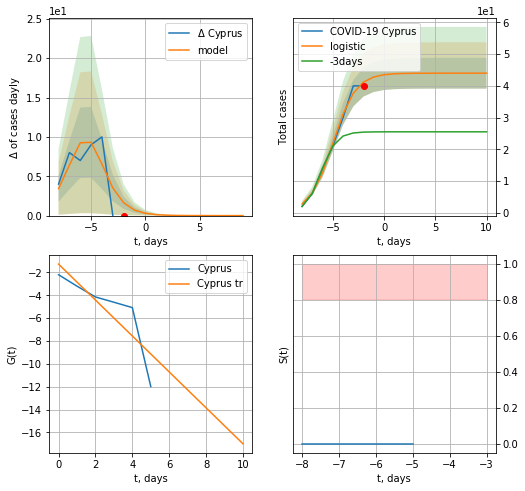

Cyprus data at: 2020-07-06
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  44 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


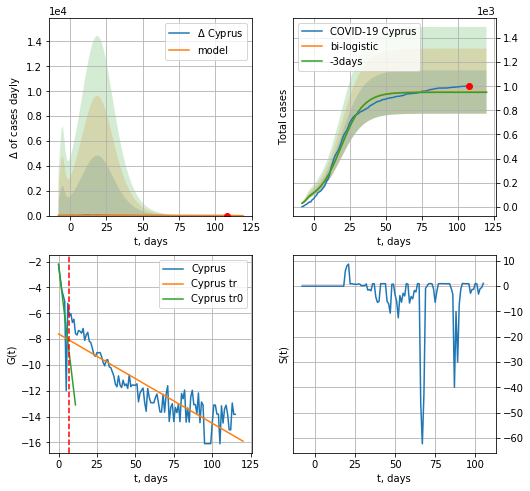

Cyprus data at: 2020-07-06
+3 day model MAPE: 0.0030269289463201172
model: bi-logistic
coeffs:  [9.08399013e+02 1.27613038e-01 1.91523793e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.1888926798273541
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  952 ± 179
	 total death:  18 ± 10
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.791980
 intercept: -7.601650
 slope: -0.069131


In [365]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*16-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


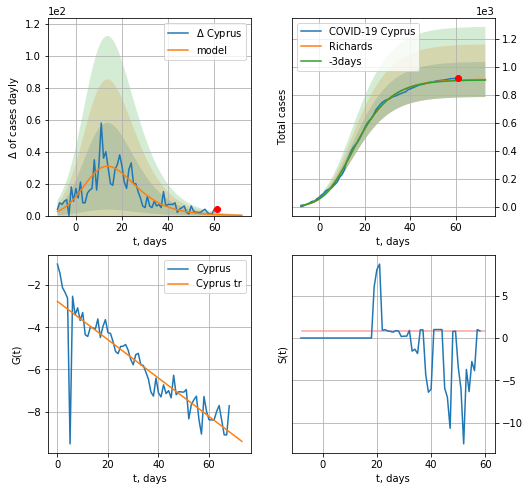

Cyprus data at: 2020-07-06
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 910 ± 125
	 total death: 17 ± 7
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


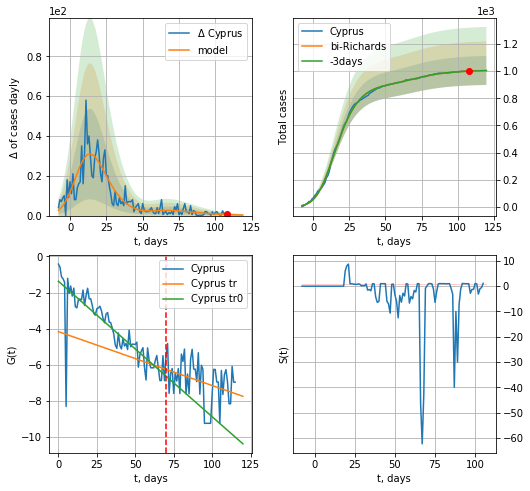

Cyprus data at: 2020-07-06
+3 day model MAPE: 0.000985
model: bi-Richards
coeffs: [ 9.72879240e+01  6.77044513e+00 -1.48171306e-01  9.69707617e-03]
rational stdev: 0.106332
forecast at the end of period: +12 days
	 deltaDaycases: 0
	 total cases: 1005 ± 106
	 total death: 19 ± 6
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.729074
 intercept: -1.375920
 slope: -0.075213
trend coefficient of determination: 0.109615
 intercept: -4.171611
 slope: -0.029922


In [366]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


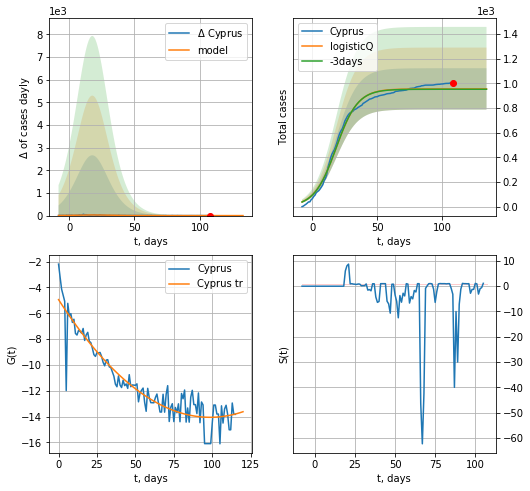

Cyprus data at: 2020-07-06
+3 day model MAPE: 0.002923
model: logisticQ
coeffs: [ 9.54590336e+02  3.40983892e-07  1.82617535e+01 -3.49743808e+05]
rational stdev: 0.175175
forecast at the end of period: +26 days
	 deltaDaycases: 0
	 total cases: 954 ± 167
	 total death: 18 ± 9
trend coefficient of determination: 0.873609
 intercept_: -4.945129697022738
 coeffs_: [ 0.         -0.18480199  0.00093771]


In [367]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
117 2020-07-02  292004  99862.0  10045.0
118 2020-07-03  295599  99521.0  10226.0
119 2020-07-04  299080  99047.0  10412.0
120 2020-07-05  302718  98172.0  10589.0
121 2020-07-06  305703  97312.0  10772.0


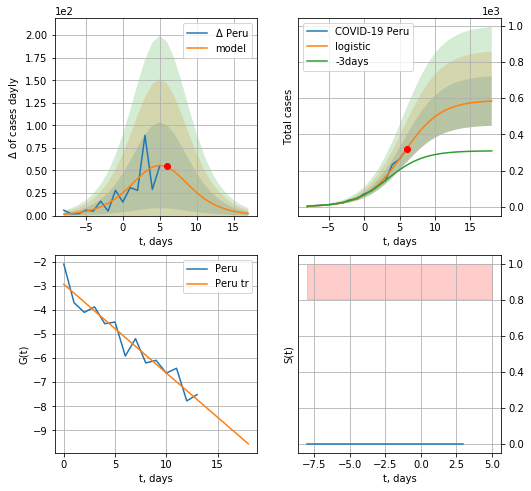

Peru data at: 2020-07-06
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +12 days
	 deltaDaycases:  2
	 total cases:  583 ± 136
	 total death:  20 ± 14
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


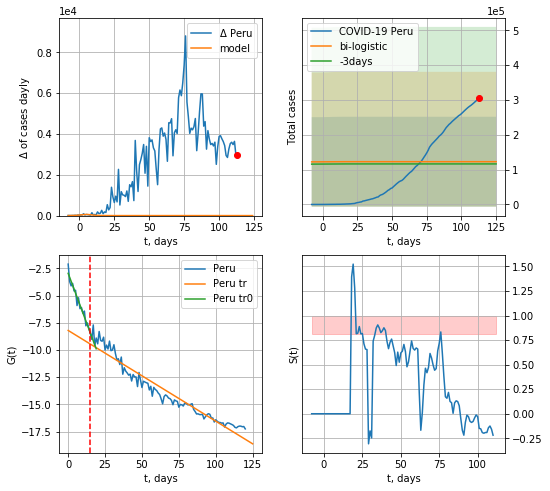

Peru data at: 2020-07-06
+3 day model MAPE: 0.055243128743736526
model: bi-logistic
coeffs:  [ 9.78137372e+04 -1.26346993e+01  3.12881201e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0504316811034793
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  122856 ± 129051
	 total death:  4329 ± 13641
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.937121
 intercept: -8.202751
 slope: -0.083438


In [368]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*16-dT)
xx = forecast2("Peru",dfPU[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


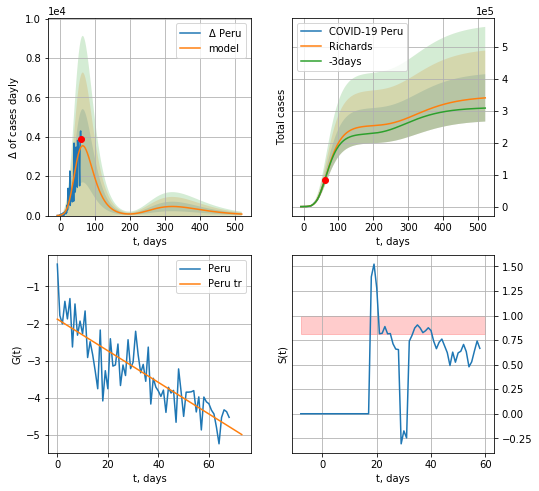

Peru data at: 2020-07-06
+3 day model MAPE: 0.004153
model: Richards
coeffs: [2.53867581e+05 3.16869248e-01 1.42807064e+01 1.27501600e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.217547
forecast at the end of period: +460 days
	 deltaDaycases: 76
	 total cases: 340166 ± 74002
	 total death: 11986 ± 7822
trend coefficient of determination: 0.729622
 intercept: -1.882679
 slope: -0.042523


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


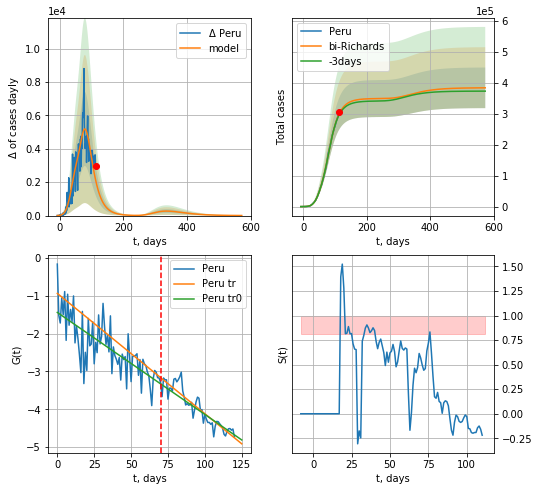

Peru data at: 2020-07-06
+3 day model MAPE: 0.011291
model: bi-Richards
coeffs: [9.57493499e+04 8.01491547e+00 6.30266017e+00 7.74298070e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.170942
forecast at the end of period: +460 days
	 deltaDaycases: 4
	 total cases: 384089 ± 65656
	 total death: 13534 ± 6940
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.545042
 intercept: -1.443575
 slope: -0.026921
trend coefficient of determination: 0.835635
 intercept: -0.941552
 slope: -0.031750


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


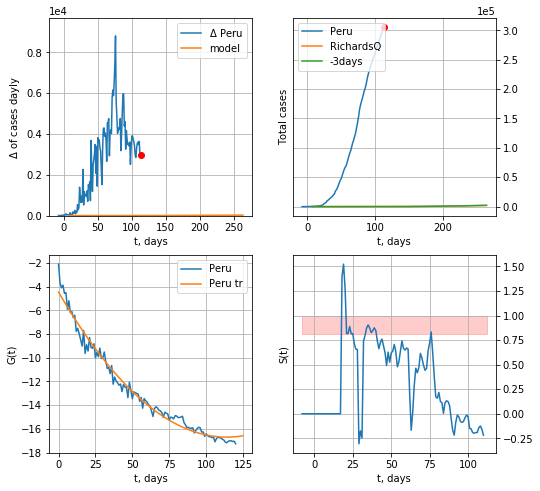

Peru data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.50045829e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +152 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [369]:
vL = 70
x = forecastRR("Peru",dfPU[:vL],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,80*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


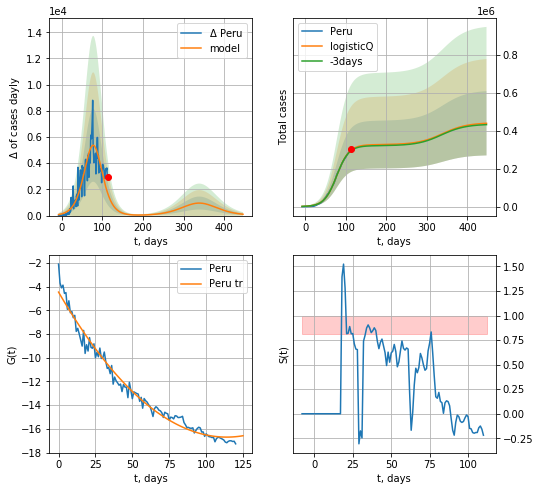

Peru data at: 2020-07-06
+3 day model MAPE: 0.010707
model: logisticQ
coeffs: [ 3.26412286e+05  8.53490153e-07  7.77076873e+01 -7.70228187e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385566
forecast at the end of period: +334 days
	 deltaDaycases: 102
	 total cases: 438892 ± 169221
	 total death: 15465 ± 17888
trend coefficient of determination: 0.978793
 intercept_: -4.46113700508586
 coeffs_: [ 0.         -0.21470013  0.00094211]


In [370]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active    death
124 2020-07-02  627168  229041.0  18225.0
125 2020-07-03  649889  236901.0  18669.0
126 2020-07-04  673904  245542.0  19279.0
127 2020-07-05  699402  254625.0  19707.0
128 2020-07-06  721310  260897.0  20184.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


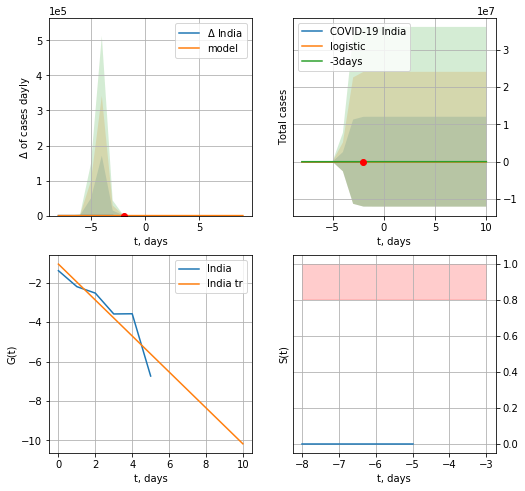

India data at: 2020-07-06
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +12 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


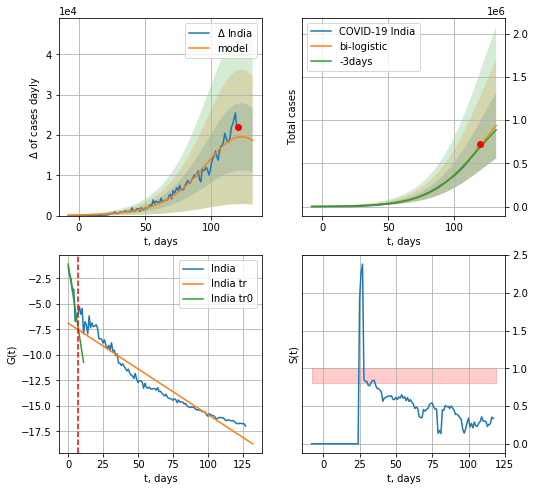

India data at: 2020-07-06
+3 day model MAPE: 0.028739678409376943
model: bi-logistic
coeffs:  [1.51359427e+06 5.13685341e-02 1.22697942e+02] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.40566918040439653
forecast at the end of period: +12 days
	 deltaDaycases:  18669
	 total cases:  938175 ± 380588
	 total death:  26252 ± 31948
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.925163
 intercept: -6.907194
 slope: -0.089526


In [371]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*16-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


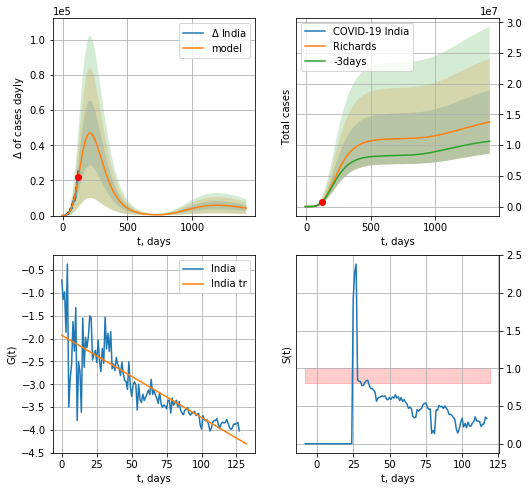

India data at: 2020-07-06
+3 day model MAPE: 0.013686
model: Richards
coeffs: [ 1.10749979e+07  3.02685841e-01 -6.59122571e+01  3.88215409e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.374897
forecast at the end of period: +1300 days
	 deltaDaycases: 4301
	 total cases: 13772572 ± 5163293
	 total death: 385389 ± 433443
trend coefficient of determination: 0.714284
 intercept: -1.926030
 slope: -0.017999


In [372]:
x = forecastRR("India",dfID[:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


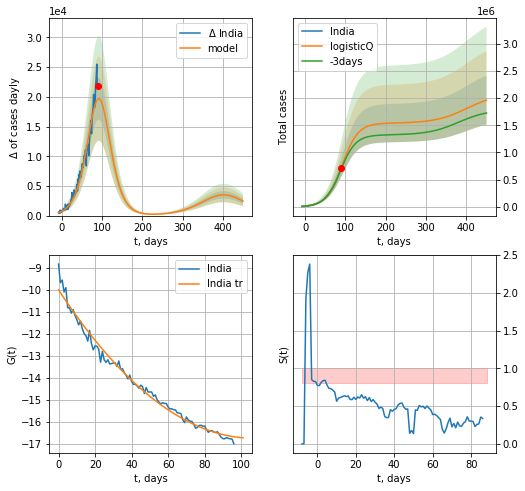

India data at: 2020-07-06
+3 day model MAPE: 0.028309
model: logisticQ
coeffs: [ 1.53804880e+06  2.81998666e-06  9.22454621e+01 -1.80536933e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.229240
forecast at the end of period: +362 days
	 deltaDaycases: 2429
	 total cases: 1961957 ± 449759
	 total death: 54900 ± 37755
trend coefficient of determination: 0.984871
 intercept_: -9.995439981426411
 coeffs_: [ 0.         -0.1261758   0.00059101]


In [373]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date    cases   active   death
120 2020-07-02  69941.0  44370.0  1385.0
121 2020-07-03  72786.0  46125.0  1437.0
122 2020-07-04  75376.0  47965.0  1481.0
123 2020-07-05  77815.0  48711.0  1507.0
124 2020-07-06  80447.0  50334.0  1582.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


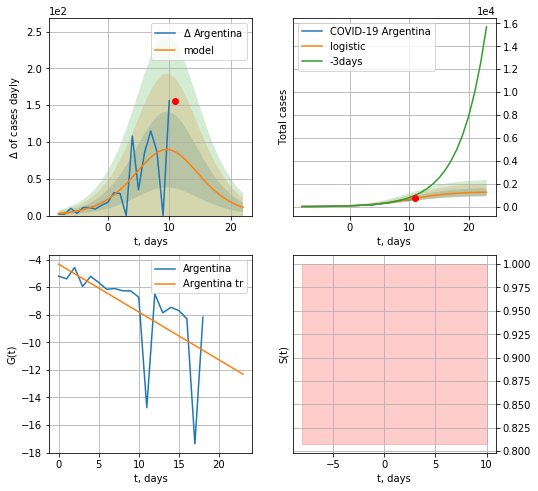

Argentina data at: 2020-07-06
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +12 days
	 deltaDaycases:  11
	 total cases:  1269 ± 352
	 total death:  24 ± 19
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


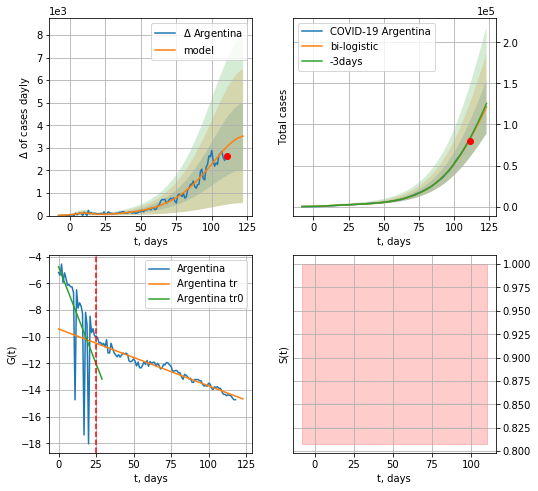

Argentina data at: 2020-07-06
+3 day model MAPE: 0.0133410771305221
model: bi-logistic
coeffs:  [2.55876019e+05 5.52784582e-02 1.25252425e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2674092901210337
forecast at the end of period: +12 days
	 deltaDaycases:  3518
	 total cases:  121345 ± 32448
	 total death:  2386 ± 1914
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.953059
 intercept: -9.423580
 slope: -0.042607


In [374]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*16-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,16*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

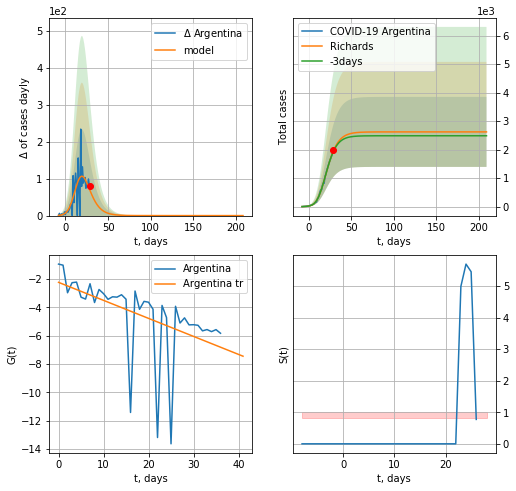

Argentina data at: 2020-07-06
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031748e+03 3.73236918e-01 1.15845148e+01 3.46306259e-01]
rational stdev: 0.468281
forecast at the end of period: +180 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 51 ± 71
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


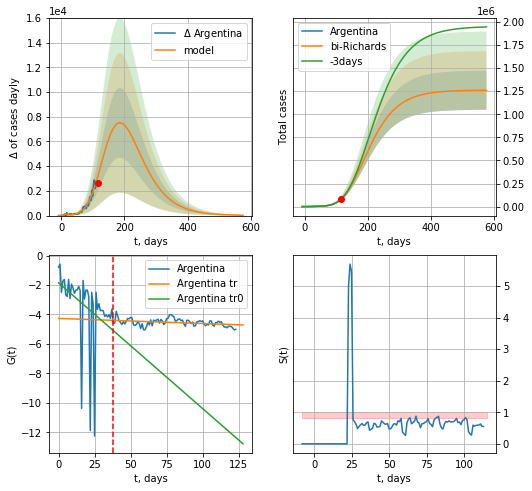

Argentina data at: 2020-07-06
+3 day model MAPE: 0.011284
model: bi-Richards
coeffs: [1.25894979e+06 1.23250921e-01 7.33878831e+01 1.40827670e-01]
rational stdev: 0.168179
forecast at the end of period: +460 days
	 deltaDaycases: 25
	 total cases: 1260117 ± 211925
	 total death: 24780 ± 12502
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.136274
 intercept: -1.852182
 slope: -0.085423
trend coefficient of determination: 0.119202
 intercept: -4.269573
 slope: -0.003453


In [375]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


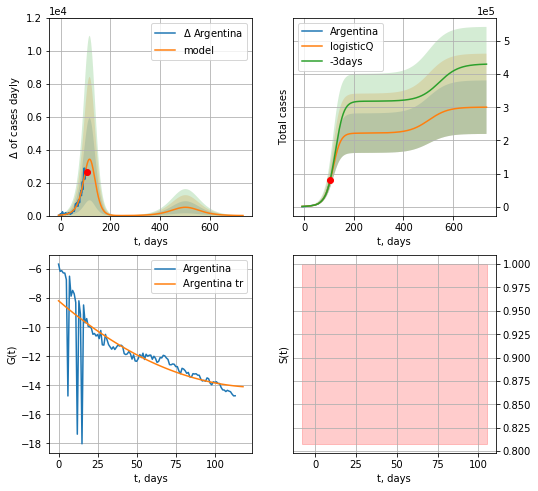

Argentina data at: 2020-07-06
+3 day model MAPE: 0.022245
model: logisticQ
coeffs: [ 2.21934912e+05  1.16579771e-04  1.15061190e+02 -4.11173500e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.269096
forecast at the end of period: +628 days
	 deltaDaycases: 4
	 total cases: 300366 ± 80827
	 total death: 5906 ± 4767
trend coefficient of determination: 0.598802
 intercept_: -8.17676187328128
 coeffs_: [ 0.         -0.09211231  0.00035583]


In [376]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


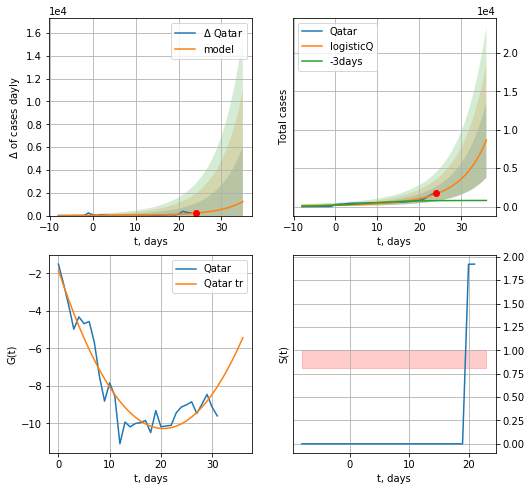

Qatar data at: 2020-07-06
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +12 days
	 deltaDaycases: 1225
	 total cases: 8657 ± 4910
	 total death: 11 ± 18
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


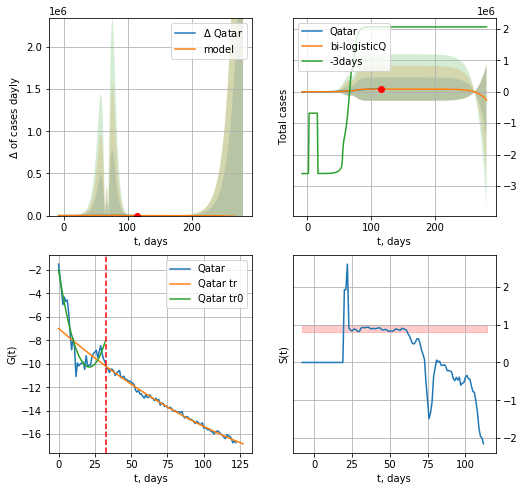

Qatar data at: 2020-07-06
+3 day model MAPE: 0.958506
model: bi-logisticQ
coeffs: [-4.59042116e+06  1.38874666e-03  6.79512746e+01 -1.08088627e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 4.319264
forecast at the end of period: +166 days
	 deltaDaycases: -22718
	 total cases: -262230 ± -1132641
	 total death: -347 ± -4496
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.991820
 intercept_: -6.991492677449685
 coeffs_: [ 0.         -0.10629659  0.00022754]


In [377]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*16-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


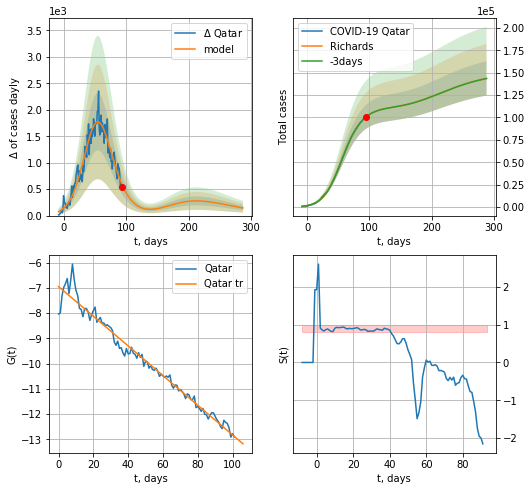

Qatar data at: 2020-07-06
+3 day model MAPE: 0.000597
model: Richards
coeffs: [1.11550839e+05 8.53251268e-02 4.82276269e+01 6.68000764e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.133443
forecast at the end of period: +194 days
	 deltaDaycases: 144
	 total cases: 143606 ± 19163
	 total death: 190 ± 76
trend coefficient of determination: 0.972155
 intercept: -6.951432
 slope: -0.058767


In [378]:
iL = 21
vL = 99 + iL
x = forecastRR('Qatar',dfQR[iL:].fillna(0),d1,42*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [379]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
138 2020-07-02  49469.0   10488  317.0
139 2020-07-03  50141.0   10670  318.0
140 2020-07-04  50857.0   10679  321.0
141 2020-07-05  51540.0   10920  323.0
142 2020-07-06  52068.0   11023  324.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


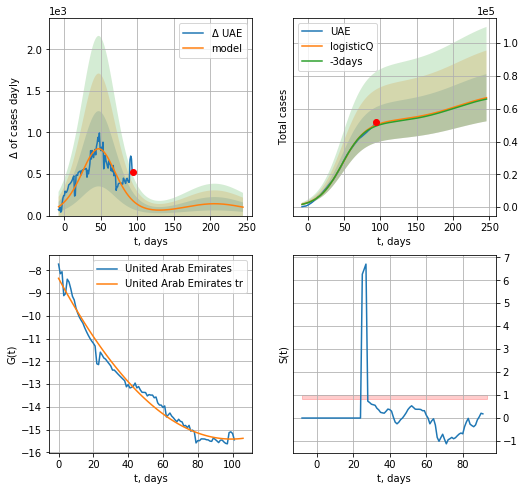

UAE data at: 2020-07-06
+3 day model MAPE: 0.012873
model: logisticQ
coeffs: [ 5.24234184e+04  6.81660951e-07  4.73761372e+01 -8.94714236e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.215683
forecast at the end of period: +152 days
	 deltaDaycases: 101
	 total cases: 66733 ± 14393
	 total death: 415 ± 268
trend coefficient of determination: 0.981547
 intercept_: -8.354728267543406
 coeffs_: [ 0.         -0.14225984  0.00071637]


In [380]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


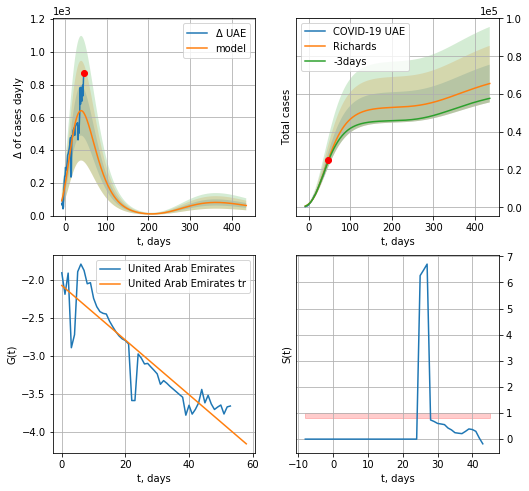

UAE data at: 2020-07-06
+3 day model MAPE: 0.028798
model: Richards
coeffs: [ 5.30737629e+04  1.10412183e+00 -6.62067699e+01  3.01726179e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.152521
forecast at the end of period: +390 days
	 deltaDaycases: 61
	 total cases: 65544 ± 9996
	 total death: 407 ± 186
trend coefficient of determination: 0.830554
 intercept: -2.075527
 slope: -0.035953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


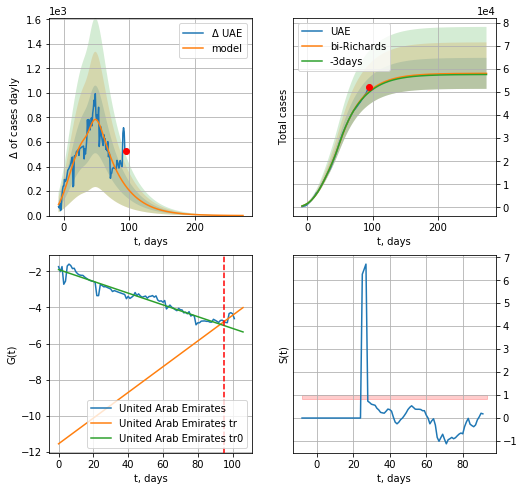

UAE data at: 2020-07-06
+3 day model MAPE: 0.008769
model: bi-Richards
coeffs: [ 5.01927804e+03  3.88559736e+01 -9.94930414e+00  2.50953296e-03]
rational stdev: 0.115569
forecast at the end of period: +180 days
	 deltaDaycases: 0
	 total cases: 58072 ± 6711
	 total death: 361 ± 125
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.941306
 intercept: -1.905428
 slope: -0.032568
trend coefficient of determination: 0.385137
 intercept: -11.551958
 slope: 0.071153


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


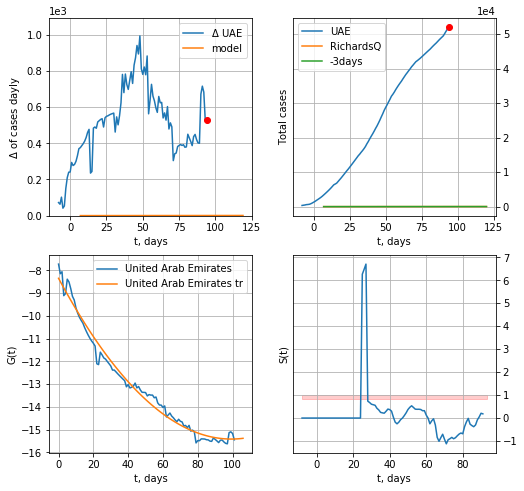

UAE data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.64994494e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +26 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [381]:
iL = 40
vL = 95 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [382]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
121 2020-07-02  197608.0   58187  1752.0
122 2020-07-03  201801.0   59385  1802.0
123 2020-07-04  205929.0   60815  1858.0
124 2020-07-05  209509.0   62357  1916.0
125 2020-07-06  213716.0   62114  1968.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


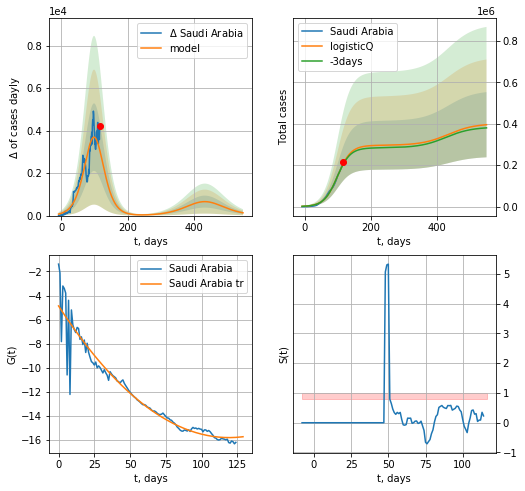

Saudi Arabia data at: 2020-07-06
+3 day model MAPE: 0.014466
model: logisticQ
coeffs: [ 2.95885672e+05  6.20748167e-07  9.93806990e+01 -8.03564525e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.398058
forecast at the end of period: +432 days
	 deltaDaycases: 130
	 total cases: 395256 ± 157334
	 total death: 3639 ± 4345
trend coefficient of determination: 0.923125
 intercept_: -4.86178317428175
 coeffs_: [ 0.         -0.18347173  0.000769  ]


In [383]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


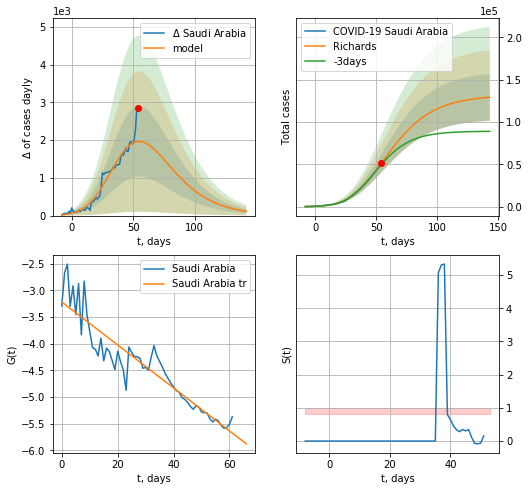

Saudi Arabia data at: 2020-07-06
+3 day model MAPE: 0.035873
model: Richards
coeffs: [1.31816759e+05 1.98591474e-01 2.23762356e+01 2.26895132e-01]
rational stdev: 0.214319
forecast at the end of period: +89 days
	 deltaDaycases: 113
	 total cases: 129313 ± 27714
	 total death: 1190 ± 765
trend coefficient of determination: 0.862734
 intercept: -3.219420
 slope: -0.040287


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


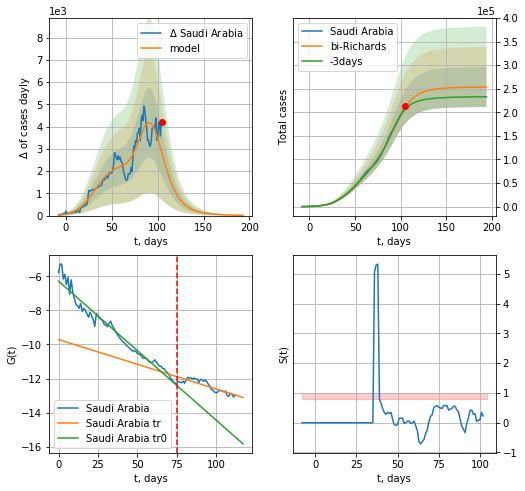

Saudi Arabia data at: 2020-07-06
+3 day model MAPE: 0.025819
model: bi-Richards
coeffs: [1.22045781e+05 1.34065043e-01 8.98704526e+01 7.35847006e-01]
rational stdev: 0.167649
forecast at the end of period: +89 days
	 deltaDaycases: 12
	 total cases: 253602 ± 42516
	 total death: 2335 ± 1174
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.962505
 intercept: -6.289108
 slope: -0.081488
trend coefficient of determination: 0.738132
 intercept: -9.709402
 slope: -0.029018


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


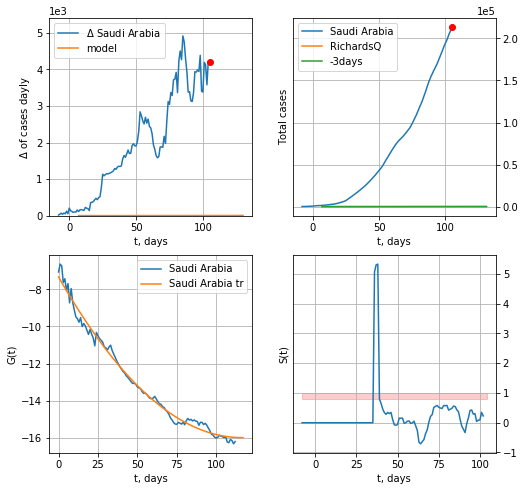

Saudi Arabia data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.80774879e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +26 days
	 deltaDaycases: 3


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [405]:
x = forecastRR('Saudi Arabia',dfSA[12:75],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
114 2020-07-02  2066.0     228   11.0
115 2020-07-03  2069.0     195   11.0
116 2020-07-04  2074.0     178   11.0
117 2020-07-05  2076.0     162   11.0
118 2020-07-06  2078.0     150   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


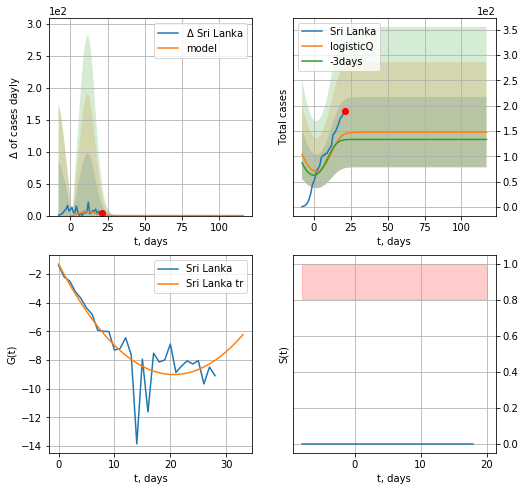

Sri Lanka data at: 2020-07-06
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +96 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


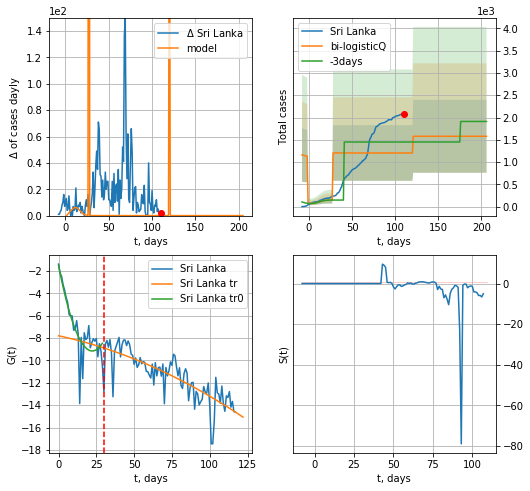

Sri Lanka data at: 2020-07-06
+3 day model MAPE: 0.169370
model: bi-logisticQ
coeffs: [1056.72954672    4.67966998   27.67872142   -1.56379325]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.518036
forecast at the end of period: +96 days
	 deltaDaycases: 0
	 total cases: 1578 ± 817
	 total death: 8 ± 12
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.640642
 intercept_: -7.796892156825312
 coeffs_: [ 0.         -0.02865556 -0.00025365]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [406]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

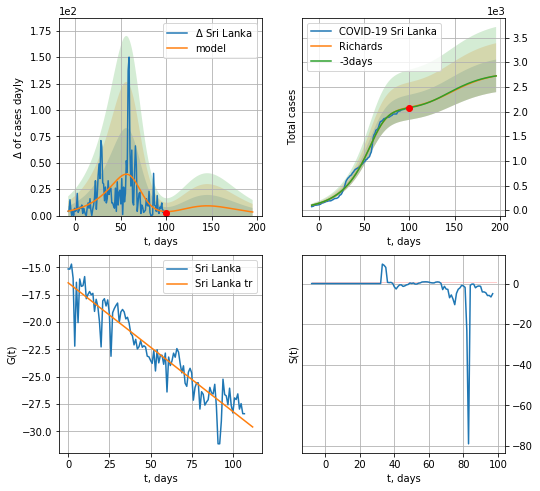

Sri Lanka data at: 2020-07-06
+3 day model MAPE: 0.004356
model: Richards
coeffs: [2.06686809e+03 4.13420464e-02 6.53097779e+01 2.80814146e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.121382
forecast at the end of period: +96 days
	 deltaDaycases: 3
	 total cases: 2723 ± 330
	 total death: 14 ± 5
trend coefficient of determination: 0.878580
 intercept: -16.422338
 slope: -0.117748


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


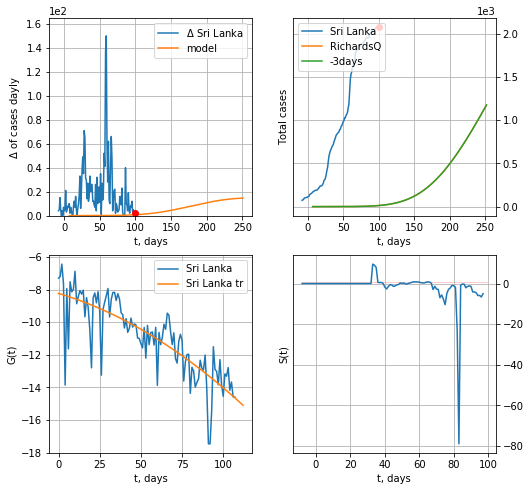

Sri Lanka data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.57221899e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +152 days
	 deltaDaycases: 14


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [407]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,28*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
126 2020-07-02  221896.0  103722  4551.0
127 2020-07-03  225283.0   95570  4619.0
128 2020-07-04  228474.0   93932  4712.0
129 2020-07-05  231818.0   95407  4762.0
130 2020-07-06  234509.0   94713  4839.0


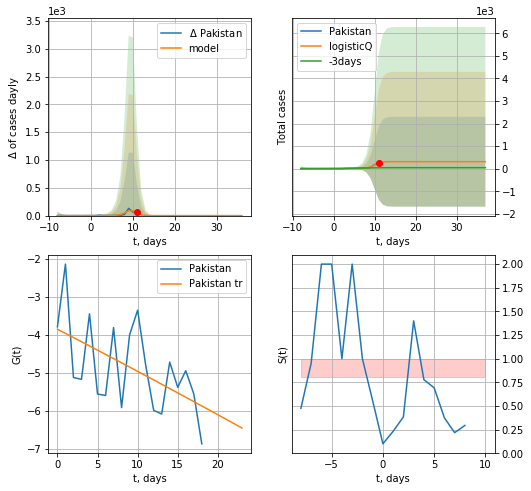

Pakistan data at: 2020-07-06
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +26 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


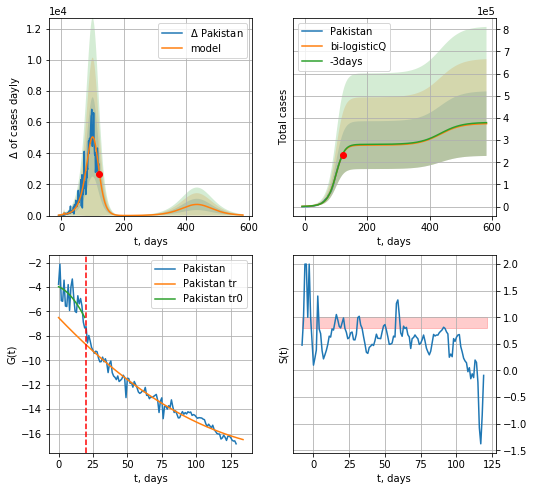

Pakistan data at: 2020-07-06
+3 day model MAPE: 0.004832
model: bi-logisticQ
coeffs: [ 2.76765230e+05  1.88712806e-04  9.94225511e+01 -2.85647300e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.389035
forecast at the end of period: +460 days
	 deltaDaycases: 34
	 total cases: 373974 ± 145488
	 total death: 7716 ± 9005
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.966175
 intercept_: -6.50402793597419
 coeffs_: [ 0.         -0.11761551  0.00032184]


In [408]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


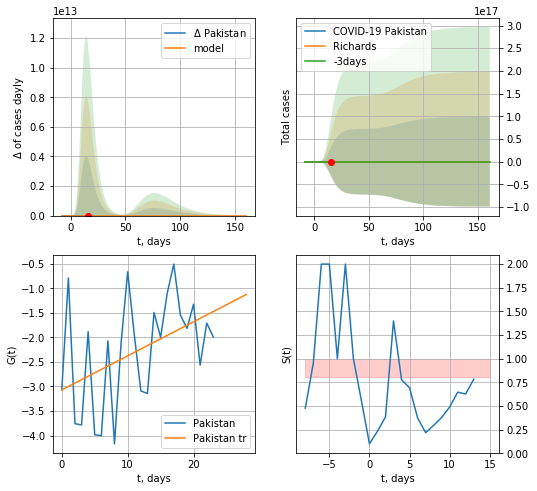

Pakistan data at: 2020-07-06
+3 day model MAPE: 0.118161
model: Richards
coeffs: [ 1.63793589e+03  6.01089634e+00 -3.06352612e+00  3.22292207e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 44401640452651.890625
forecast at the end of period: +145 days
	 deltaDaycases: 0
	 total cases: 2229 ± 98985066271506528
	 total death: 46 ± 6127426382465961
trend coefficient of determination: 0.194246
 intercept: -3.069579
 slope: 0.069356


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


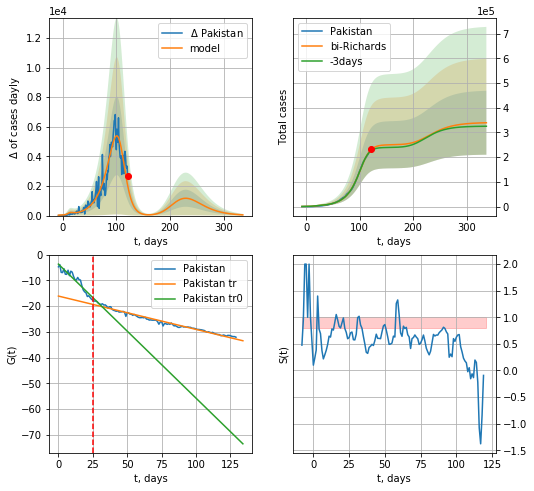

Pakistan data at: 2020-07-06
+3 day model MAPE: 0.020375
model: bi-Richards
coeffs: [2.48638863e+05 5.30784452e-02 1.08051063e+02 2.23223240e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.381035
forecast at the end of period: +215 days
	 deltaDaycases: 47
	 total cases: 339222 ± 129255
	 total death: 6999 ± 8000
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.892249
 intercept: -3.648583
 slope: -0.521116
trend coefficient of determination: 0.975747
 intercept: -16.068321
 slope: -0.129550


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


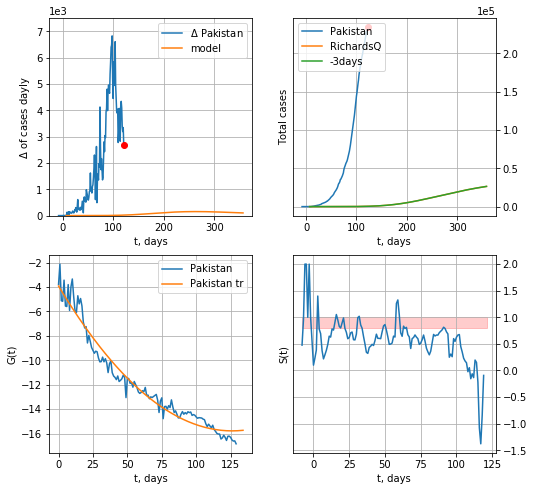

Pakistan data at: 2020-07-06
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.68498873e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +236 days
	 deltaDaycases: 101


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [409]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,45*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
115 2020-07-01  149258.0   85262  1888.0
116 2020-07-02  153277.0   84909  1926.0
117 2020-07-03  156391.0   86375  1968.0
118 2020-07-04  159679.0   86961  1997.0
119 2020-07-05  165618.0   87373  2096.0


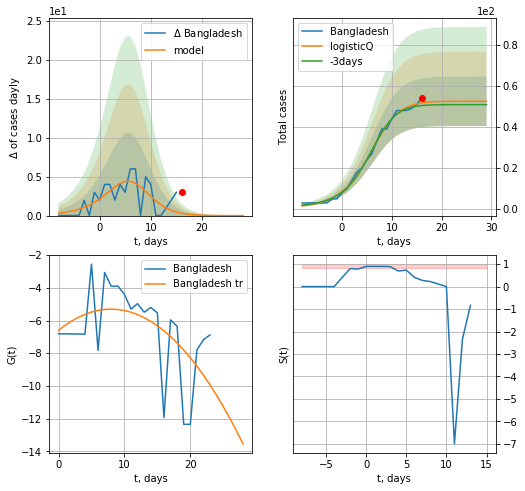

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


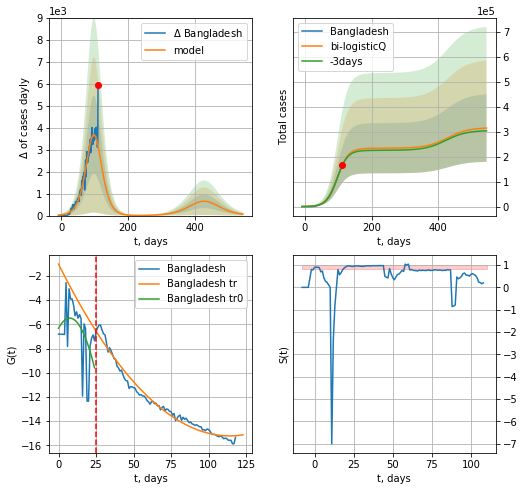

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.012059
model: bi-logisticQ
coeffs: [ 2.33643082e+05  1.66646858e-06  9.80189271e+01 -3.77143103e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.429489
forecast at the end of period: +433 days
	 deltaDaycases: 62
	 total cases: 314439 ± 135048
	 total death: 3979 ± 5126
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.977144
 intercept_: -1.026215909253727
 coeffs_: [ 0.         -0.2488912   0.00109099]


In [860]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


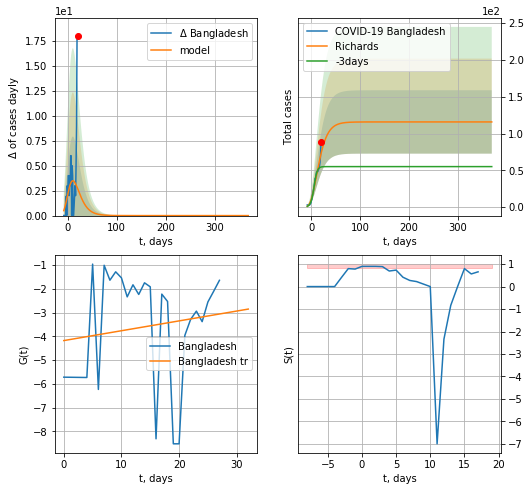

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +349 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


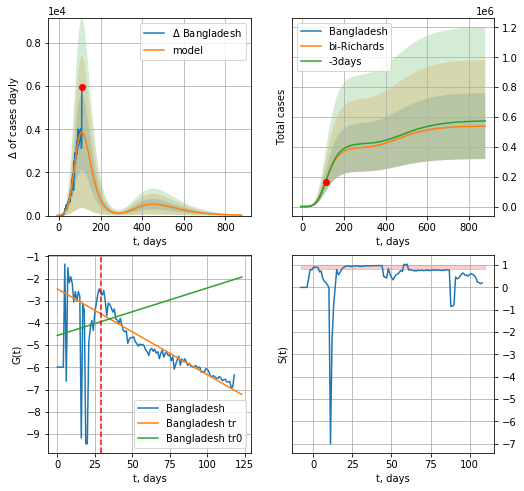

Bangladesh data at: 2020-07-05
+3 day model MAPE: 0.003949
model: bi-Richards
coeffs: [3.97257985e+05 1.18796148e-01 6.39500578e+01 2.50437223e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.410138
forecast at the end of period: +769 days
	 deltaDaycases: 18
	 total cases: 539480 ± 221261
	 total death: 6827 ± 8400
bi-Richards approximation splitting point: 29
trend coefficient of determination: 0.006220
 intercept: -4.561614
 slope: 0.021393
trend coefficient of determination: 0.894886
 intercept: -2.461406
 slope: -0.038703


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: operands could not be broadcast together with shapes (120,) (119,) 

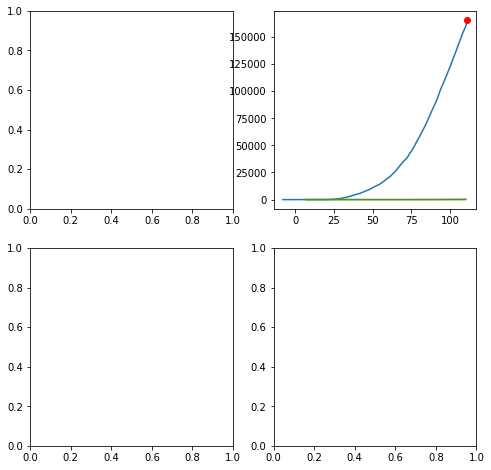

In [861]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,124*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,14*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
128 2020-07-01  46940.0    8867  358.0
129 2020-07-02  47859.0    9110  359.0
130 2020-07-03  48672.0    9036  360.0
131 2020-07-04  49303.0    8995  365.0
132 2020-07-05  49941.0    9110  368.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


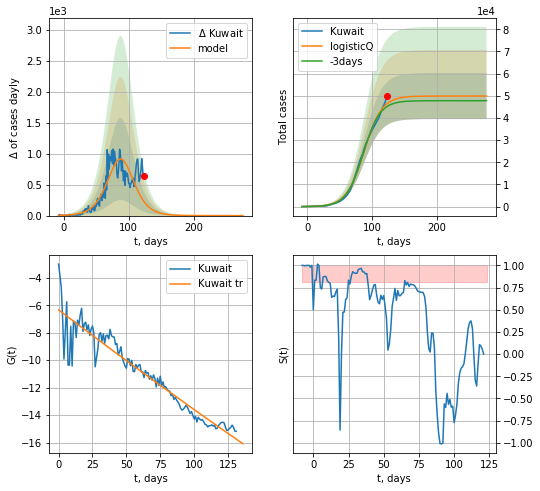

Kuwait data at: 2020-07-05
+3 day model MAPE: 0.029539
model: logisticQ
coeffs: [ 4.98870319e+04  5.35100635e-07  8.79279981e+01 -1.36839982e+05]
rational stdev: 0.208351
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 49886 ± 10394
	 total death: 367 ± 229
trend coefficient of determination: 0.905509
 intercept_: -6.332377971914351
 coeffs_: [ 0.00000000e+00 -7.52127349e-02  2.55058302e-05]


In [862]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


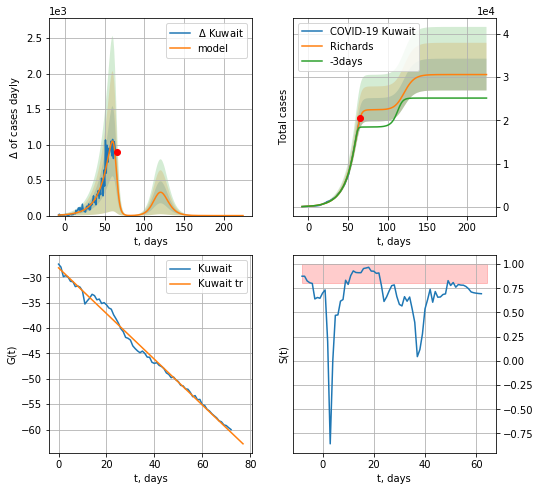

Kuwait data at: 2020-07-05
+3 day model MAPE: 0.136559
model: Richards
coeffs: [2.24365721e+04 7.66634185e-02 6.43548410e+01 5.72971743e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.119998
forecast at the end of period: +160 days
	 deltaDaycases: 0
	 total cases: 30568 ± 3668
	 total death: 225 ± 80
trend coefficient of determination: 0.993036
 intercept: -28.143718
 slope: -0.450232


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


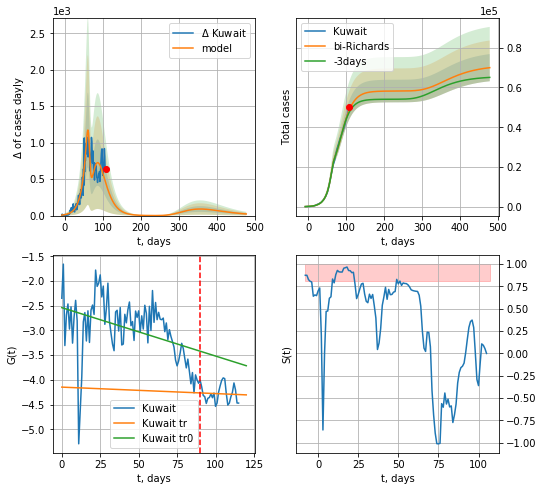

Kuwait data at: 2020-07-05
+3 day model MAPE: 0.024930
model: bi-Richards
coeffs: [3.57905227e+04 5.42376471e+00 4.11156802e+00 1.02205054e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.097699
forecast at the end of period: +370 days
	 deltaDaycases: 22
	 total cases: 69966 ± 6835
	 total death: 515 ± 150
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.169358
 intercept: -2.537551
 slope: -0.009804
trend coefficient of determination: 0.003237
 intercept: -4.147217
 slope: -0.001308


In [864]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,67*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
122 2020-07-01  33387.0   14729  754.0
123 2020-07-02  34197.0   15291  765.0
124 2020-07-03  35148.0   15981  775.0
125 2020-07-04  36184.0   16796  786.0
126 2020-07-05  37425.0   17688  794.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


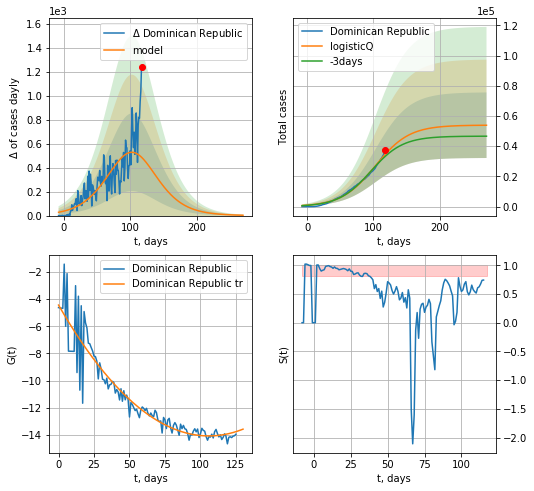

Dominican Republic data at: 2020-07-05
+3 day model MAPE: 0.043743
model: logisticQ
coeffs: [ 5.39375671e+04  3.36327027e-07  1.02857814e+02 -1.16192287e+05]
rational stdev: 0.402764
forecast at the end of period: +153 days
	 deltaDaycases: 2
	 total cases: 53863 ± 21694
	 total death: 1142 ± 1379
trend coefficient of determination: 0.882274
 intercept_: -4.439267294392643
 coeffs_: [ 0.         -0.18174935  0.00085816]


In [865]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


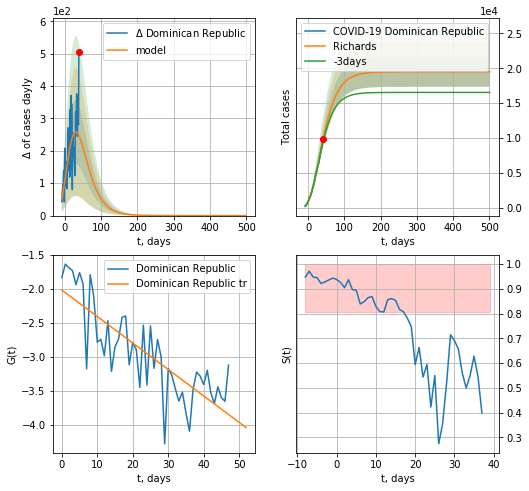

Dominican Republic data at: 2020-07-05
+3 day model MAPE: 0.031616
model: Richards
coeffs: [ 1.94891313e+04  2.23734826e+00 -8.23176807e+01  1.62469201e-02]
rational stdev: 0.109843
forecast at the end of period: +461 days
	 deltaDaycases: 0
	 total cases: 19489 ± 2140
	 total death: 413 ± 136
trend coefficient of determination: 0.650419
 intercept: -2.014545
 slope: -0.039027


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


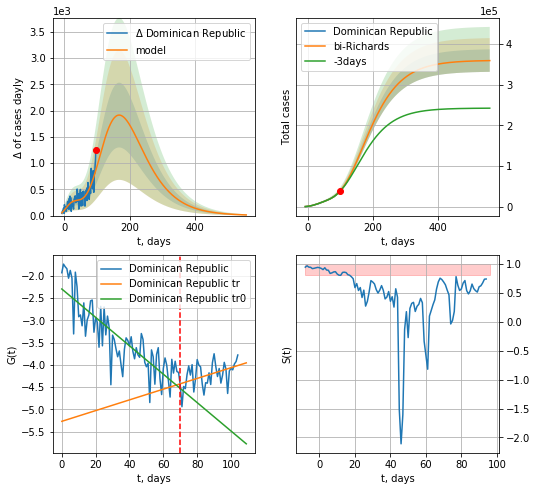

Dominican Republic data at: 2020-07-05
+3 day model MAPE: 0.012168
model: bi-Richards
coeffs: [ 3.40348963e+05  4.38945832e-01 -4.69583267e+01  3.53378385e-02]
rational stdev: 0.076896
forecast at the end of period: +461 days
	 deltaDaycases: 12
	 total cases: 359029 ± 27607
	 total death: 7617 ± 1757
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.717829
 intercept: -2.298698
 slope: -0.031840
trend coefficient of determination: 0.199644
 intercept: -5.265197
 slope: 0.012022


In [866]:
vL = 70+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active  death
116 2020-07-01  16898.0    6755  549.0
117 2020-07-02  17150.0    6744  560.0
118 2020-07-03  17445.0    6780  572.0
119 2020-07-04  17672.0    6696  580.0
120 2020-07-05  17814.0    6511  585.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


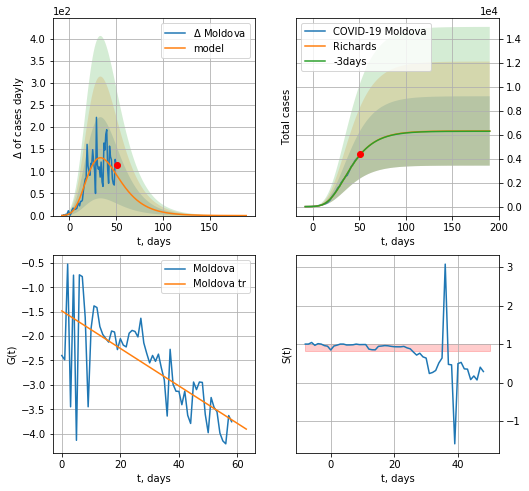

Moldova data at: 2020-07-05
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
rational stdev: 0.458349
forecast at the end of period: +139 days
	 deltaDaycases: 0
	 total cases: 6304 ± 2889
	 total death: 207 ± 284
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


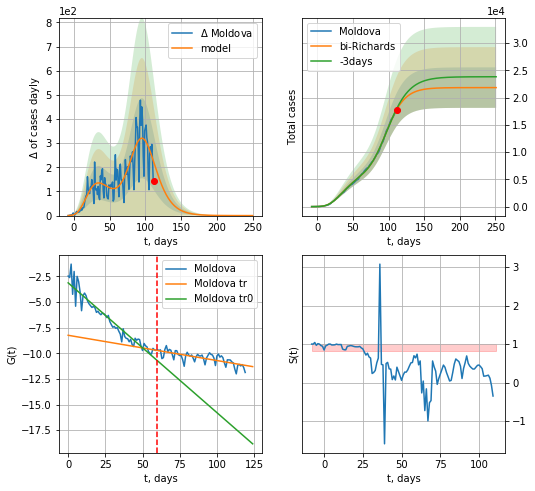

Moldova data at: 2020-07-05
+3 day model MAPE: 0.012460
model: bi-Richards
coeffs: [1.55329230e+04 1.01403281e-01 9.15981169e+01 7.19337052e-01]
rational stdev: 0.170054
forecast at the end of period: +139 days
	 deltaDaycases: 0
	 total cases: 21838 ± 3713
	 total death: 717 ± 365
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.918147
 intercept: -3.129135
 slope: -0.126643
trend coefficient of determination: 0.537018
 intercept: -8.244690
 slope: -0.024639


In [867]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [868]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
118 2020-07-01  159333.0   80559  2749.0
119 2020-07-02  168061.0   83218  2844.0
120 2020-07-03  177124.0   87874  2952.0
121 2020-07-04  187977.0   93724  3026.0
122 2020-07-05  196750.0  100236  3199.0


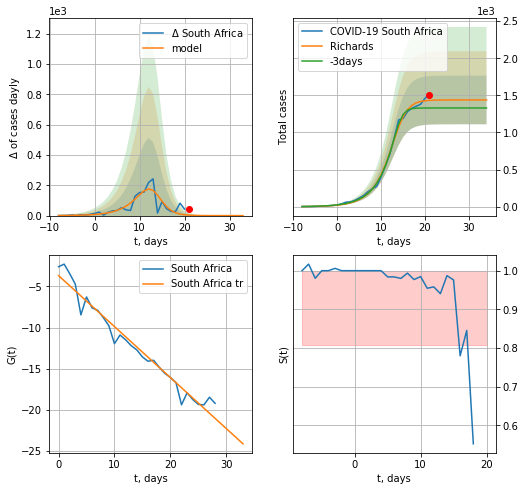

South Africa data at: 2020-07-05
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832007e+03 3.09188728e-01 1.37785508e+01 2.13840807e+00]
rational stdev: 0.227967
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 23 ± 15
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


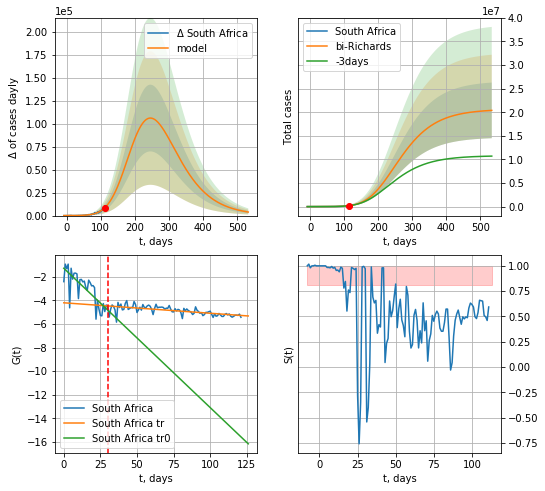

South Africa data at: 2020-07-05
+3 day model MAPE: 0.021335
model: bi-Richards
coeffs: [2.06409419e+07 8.02067813e-02 1.37873241e+02 1.90942207e-01]
rational stdev: 0.289179
forecast at the end of period: +419 days
	 deltaDaycases: 3870
	 total cases: 20389686 ± 5896278
	 total death: 331520 ± 287606
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.567995
 intercept: -1.282071
 slope: -0.118091
trend coefficient of determination: 0.429905
 intercept: -4.208992
 slope: -0.008859


In [870]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [350]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [5]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,773,544",North America,\nNorth America\n,,"+5,870",499,"+4,604",,"18,382",,"3,561,764","176,637","1,611,583",,
1,,\n,,,"795,271",South America,\nSouth America\n,,"+1,212",42,"+93,876",,"13,569",,"2,550,729","94,967","1,660,491",,
2,,\n,,,"790,195",Asia,\nAsia\n,,"+6,511",133,"+4,692",,"19,406",,"2,636,628","63,426","1,783,007",,
3,,\n,,,"857,600",Europe,\nEurope\n,,"+7,007",222,"+10,575",,"5,552",,"2,499,811","194,211","1,448,000",,
4,,\n,,,"244,450",Africa,\nAfrica\n,,"+2,324",46,"+1,425",,956,,"496,034","11,695","239,889",,
5,,\n,,,"1,224",Australia/Oceania,\nOceania\n,,173,,37,,10,,"10,406",128,"9,054",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,462,339",All,World,69.4,"+23,097",942,"+115,209",,"57,879",,"11,756,093","541,079","6,752,675",,"1,508"
8,1,109,"2,489",9,"1,582,988",North America,USA,402,202,2,119,"331,034,037","15,198","115,452","3,041,035","132,981","1,325,066","38,218,637","9,186"
9,2,131,"3,243",49,"488,286",South America,Brazil,308,,,"+93,614","212,582,910","8,318","20,304","1,626,071","65,556","1,072,229","4,316,284","7,649"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,773,544",North America,\nNorth America\n,,"+5,870",499,"+4,604",,"18,382",,"3,561,764","176,637","1,611,583",,
1,,\n,,,"795,271",South America,\nSouth America\n,,"+1,212",42,"+93,876",,"13,569",,"2,550,729","94,967","1,660,491",,
2,,\n,,,"790,195",Asia,\nAsia\n,,"+6,511",133,"+4,692",,"19,406",,"2,636,628","63,426","1,783,007",,
3,,\n,,,"857,600",Europe,\nEurope\n,,"+7,007",222,"+10,575",,"5,552",,"2,499,811","194,211","1,448,000",,
4,,\n,,,"244,450",Africa,\nAfrica\n,,"+2,324",46,"+1,425",,956,,"496,034","11,695","239,889",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
120,113,"1,478","34,447",6,215,Europe,Lithuania,29,,,,"2,721,314",15,"162,933","1,841",79,"1,547","443,391",677
353,114,"1,478","34,447",6,215,Europe,Lithuania,29,5,,2,"2,721,314",15,"162,933","1,841",79,"1,547","443,391",677
585,114,"1,482","34,447",6,212,Europe,Lithuania,29,5,,,"2,721,314",15,"161,853","1,836",79,"1,545","440,453",675


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [9]:
df.head(45)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,773,544",North America,\nNorth America\n,,"+5,870",499,"+4,604",,"18,382",,"3,561,764","176,637","1,611,583",,
1,,\n,,,"795,271",South America,\nSouth America\n,,"+1,212",42,"+93,876",,"13,569",,"2,550,729","94,967","1,660,491",,
2,,\n,,,"790,195",Asia,\nAsia\n,,"+6,511",133,"+4,692",,"19,406",,"2,636,628","63,426","1,783,007",,
3,,\n,,,"857,600",Europe,\nEurope\n,,"+7,007",222,"+10,575",,"5,552",,"2,499,811","194,211","1,448,000",,
4,,\n,,,"244,450",Africa,\nAfrica\n,,"+2,324",46,"+1,425",,956,,"496,034","11,695","239,889",,
5,,\n,,,"1,224",Australia/Oceania,\nOceania\n,,173,,37,,10,,"10,406",128,"9,054",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,462,339",All,World,69.4,"+23,097",942,"+115,209",,"57,879",,"11,756,093","541,079","6,752,675",,"1,508"
8,1,109,"2,489",9,"1,582,988",North America,USA,402,202,2,119,"331,034,037","15,198","115,452","3,041,035","132,981","1,325,066","38,218,637","9,186"
9,2,131,"3,243",49,"488,286",South America,Brazil,308,,,"+93,614","212,582,910","8,318","20,304","1,626,071","65,556","1,072,229","4,316,284","7,649"


In [10]:
df.at[15, 'TotalRecovered'] = 0
df.at[13, 'TotalRecovered'] = 0
df.at[31, 'TotalRecovered'] = 0
df.at[38, 'TotalRecovered'] = 0
df.at[15,"ActiveCases"] = 0
df.at[13,"ActiveCases"] = 0
df.at[31,"ActiveCases"] = 0
df.at[38,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1773544,North America,\nNorth America\n,NaN,5870.0,499.0,"+4,604",,18382.0,NaN,3561764,176637.0,1611583.0,NaN,NaN
1,,\n,,,795271,South America,\nSouth America\n,NaN,1212.0,42.0,"+93,876",,13569.0,NaN,2550729,94967.0,1660491.0,NaN,NaN
2,,\n,,,790195,Asia,\nAsia\n,NaN,6511.0,133.0,"+4,692",,19406.0,NaN,2636628,63426.0,1783007.0,NaN,NaN
3,,\n,,,857600,Europe,\nEurope\n,NaN,7007.0,222.0,"+10,575",,5552.0,NaN,2499811,194211.0,1448000.0,NaN,NaN
4,,\n,,,244450,Africa,\nAfrica\n,NaN,2324.0,46.0,"+1,425",,956.0,NaN,496034,11695.0,239889.0,NaN,NaN
5,,\n,,,1224,Australia/Oceania,\nOceania\n,NaN,173.0,NaN,37,,10.0,NaN,10406,128.0,9054.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,4462339,All,World,69.4,23097.0,942.0,"+115,209",,57879.0,NaN,11756093,541079.0,6752675.0,NaN,1508.0
8,1,109,"2,489",9,1582988,North America,USA,402.0,202.0,2.0,119,"331,034,037",15198.0,115452.0,3041035,132981.0,1325066.0,38218637.0,9186.0
9,2,131,"3,243",49,488286,South America,Brazil,308.0,NaN,NaN,"+93,614","212,582,910",8318.0,20304.0,1626071,65556.0,1072229.0,4316284.0,7649.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,857600,Europe,Total:,NaN,7007.0,222.0,"+10,575",,5552.0,NaN,2499811,194211.0,1448000.0,NaN,NaN
227,,,,,244450,Africa,Total:,NaN,2324.0,46.0,"+1,425",,956.0,NaN,496034,11695.0,239889.0,NaN,NaN
228,,,,,1224,Australia/Oceania,Total:,NaN,173.0,NaN,,,10.0,NaN,10406,128.0,9054.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,162595,Europe,European Union,300.606054,75.0,3.0,NaN,NaN,2208.0,67994.288716,1310539,133845.0,631461.0,30274492.0,2943.37448


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1773544,North America,North America,NaN,5870.0,499.0,"+4,604",,18382.0,NaN,3561764,176637.0,1611583.0,NaN,NaN
1,,\n,,,795271,South America,South America,NaN,1212.0,42.0,"+93,876",,13569.0,NaN,2550729,94967.0,1660491.0,NaN,NaN
2,,\n,,,790195,Asia,Asia,NaN,6511.0,133.0,"+4,692",,19406.0,NaN,2636628,63426.0,1783007.0,NaN,NaN
3,,\n,,,857600,Europe,Europe,NaN,7007.0,222.0,"+10,575",,5552.0,NaN,2499811,194211.0,1448000.0,NaN,NaN
4,,\n,,,244450,Africa,Africa,NaN,2324.0,46.0,"+1,425",,956.0,NaN,496034,11695.0,239889.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1773544,North America,North America,NaN,5870.0,499.0,"+4,604",,18382.0,NaN,3561764,176637.0,1611583.0,NaN,NaN
1,,\n,,,795271,South America,South America,NaN,1212.0,42.0,"+93,876",,13569.0,NaN,2550729,94967.0,1660491.0,NaN,NaN
2,,\n,,,790195,Asia,Asia,NaN,6511.0,133.0,"+4,692",,19406.0,NaN,2636628,63426.0,1783007.0,NaN,NaN
3,,\n,,,857600,Europe,Europe,NaN,7007.0,222.0,"+10,575",,5552.0,NaN,2499811,194211.0,1448000.0,NaN,NaN
4,,\n,,,244450,Africa,Africa,NaN,2324.0,46.0,"+1,425",,956.0,NaN,496034,11695.0,239889.0,NaN,NaN
5,,\n,,,1224,Australia/Oceania,Oceania,NaN,173.0,NaN,37,,10.0,NaN,10406,128.0,9054.0,NaN,NaN
7,,\n,,,4462339,All,World,69.4,23097.0,942.0,"+115,209",,57879.0,NaN,11756093,541079.0,6752675.0,NaN,1508.0
8,1,109,"2,489",9,1582988,North America,USA,402.0,202.0,2.0,119,"331,034,037",15198.0,115452.0,3041035,132981.0,1325066.0,38218637.0,9186.0
9,2,131,"3,243",49,488286,South America,Brazil,308.0,NaN,NaN,"+93,614","212,582,910",8318.0,20304.0,1626071,65556.0,1072229.0,4316284.0,7649.0
10,3,"1,913","68,381",135,260897,Asia,India,15.0,964.0,10.0,79,"1,380,196,747",8944.0,7398.0,721310,20184.0,440229.0,10211092.0,523.0


In [17]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Iran IN
Moldova MD
Slovenia SV
Bangladesh BN
S. Korea KR
Lithuania LT
Czechia CH
Hungary HG
Serbia SB
Dominican Republic DM
Canada CA
Sweden SW
Estonia ES
Israel IS
Malaysia ML
Poland PL
Finland FI
China CN
Turkey TR
Latvia LV
Iceland IC
Colombia CB
Denmark DK
Philippines PH
Italy IT
India ID
European Union EU
Romania RM
Indonesia IE
Argentina AG
Pakistan PS
Germany GR
Spain SP
Netherlands NL
Ireland IR
Bulgaria BL
Russia RS
Switzerland SZ
UK GB
Portugal PT
Japan JP
Egypt EG
Chile CL
Morocco MR
Iraq IQ
Algeria AR
Mexico MX
USA US
Singapore SG
Cyprus CP
Greece GC
Thailand TH
France FR
South Africa AF
Norway NG
Qatar QR
Belarus BR
New Zealand ZL
Malta MT
Australia AS
Ukraine Ukr
UAE UAE
Slovakia SL
Kuwait KW
Saudi Arabia SA
Luxembourg LX
Croatia CT
Sri Lanka Sri
Brazil BZ
Ecuador ED
Peru PU
Belgium BG
Austria AT
Panama PM
World World


In [19]:
len(countryDic)

75

In [20]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-07-06,3561764,1773544,176637.0
South America
South America 2020-07-06,2550729,795271,94967.0
Asia
Asia 2020-07-06,2636628,790195,63426.0
Europe
Europe 2020-07-06,2499811,857600,194211.0
Africa
Africa 2020-07-06,496034,244450,11695.0
Oceania
Oceania 2020-07-06,10406,1224,128.0
World
World 2020-07-06,11756093,4462339,541079.0
USA
USA 2020-07-06,3041035,1582988,132981.0
Brazil
Brazil 2020-07-06,1626071,488286,65556.0
India
India 2020-07-06,721310,260897,20184.0
Russia
Russia 2020-07-06,694230,219856,10494.0
Peru
Peru 2020-07-06,305703,97312,10772.0
Spain
Spain 2020-07-06,298869,0,28388.0
Chile
Chile 2020-07-06,298557,27802,6384.0
UK
UK 2020-07-06,285768,0,44236.0
Mexico
Mexico 2020-07-06,261750,70974,31119.0
Iran
Iran 2020-07-06,243051,27237,11731.0
Italy
Italy 2020-07-06,241819,14709,34869.0
Pakistan
Pakistan 2020-07-06,234509,94713,4839.0
Saudi Arabia
Saudi Arabia 2020-07-06,213716,62114,1968.0
Turkey
Turkey 2020-07-06,206844,18608,5241.0
South Africa
So

Vatican City
Vatican City 2020-07-06,12,0,nan
Montserrat
Montserrat 2020-07-06,11,0,1.0
Papua New Guinea
Papua New Guinea 2020-07-06,11,3,nan
Western Sahara
Western Sahara 2020-07-06,10,1,1.0
MS Zaandam
MS Zaandam 2020-07-06,9,7,2.0
British Virgin Islands
British Virgin Islands 2020-07-06,8,0,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-07-06,7,0,nan
St. Barth
St. Barth 2020-07-06,6,0,nan
Anguilla
Anguilla 2020-07-06,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-07-06,1,0,nan
China
China 2020-07-06,83565,403,4634.0
Total:
Total: 2020-07-06,3561764,1773544,176637.0
Total:
Total: 2020-07-06,3561764,1773544,176637.0
Total:
Total: 2020-07-06,3561764,1773544,176637.0
Total:
Total: 2020-07-06,3561764,1773544,176637.0
Total:
Total: 2020-07-06,3561764,1773544,176637.0
Total:
Total: 2020-07-06,3561764,1773544,176637.0
Total:
Total: 2020-07-06,3561764,1773544,176637.0
European Union
European Union 2020-07-06,1310539,162595,133845.0


In [21]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [22]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaIN.csv 2020-07-06,243051,27237,11731.0

append data/coronaMD.csv 2020-07-06,17906,6267,592.0

append data/coronaSV.csv 2020-07-06,1716,221,111.0

append data/coronaBN.csv 2020-07-06,165618,87373,2096.0

append data/coronaKR.csv 2020-07-06,13181,982,285.0

append data/coronaLT.csv 2020-07-06,1841,215,79.0

append data/coronaCH.csv 2020-07-06,12566,4343,350.0

append data/coronaHG.csv 2020-07-06,4205,742,589.0

append data/coronaSB.csv 2020-07-06,16420,2737,317.0

append data/coronaDM.csv 2020-07-06,38128,17835,804.0

append data/coronaCA.csv 2020-07-06,105935,27672,8693.0

append data/coronaSW.csv 2020-07-06,73061,0,5433.0

append data/coronaES.csv 2020-07-06,1995,46,69.0

append data/coronaIS.csv 2020-07-06,31186,12717,338.0

append data/coronaML.csv 2020-07-06,8668,71,121.0

append data/coronaPL.csv 2020-07-06,36155,10668,1521.0

append data/coronaFI.csv 2020-07-06,7257,228,329.0

append data/coronaCN.csv 2020-07-06,83565,403,4634.0

append data/coronaTR.csv 2020-07-

In [32]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [467]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China"         
]

In [468]:
len(CList)

72

In [469]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5577035987

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400